In [1]:
# Import libraries

#Data analysis libraries
import numpy as np 
import pandas as pd 
import itertools
from pandas import Series,DataFrame

#Visualization and statistics libraries
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.pyplot import style
from scipy import fftpack
import seaborn as sns
style.use('seaborn')
%matplotlib inline

# Model related libraries
from kneed import KneeLocator
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.cluster import OPTICS
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler
import sklearn.metrics as metrics
from kneed import KneeLocator

In [5]:
#Get the data set after cleaning from previous Classification assignment
df_96f = pd.read_csv("df_96features.csv", low_memory=False)

In [7]:
pd.set_option('display.max_columns',111)
df_96f.columns

Index(['hert_std', 'hert_median', 'hert_max', 'hert_min', 'hert_entropy',
       'hert_impulse', 'hert_margin', 'hert_frequence', 'hert_MS_F',
       'hert_RMQ_F', 'hert_RV_F', 'hert_crest_F', 'w_std', 'w_median', 'w_max',
       'w_min', 'w_entropy', 'w_impulse', 'w_margin', 'w_frequence', 'w_MS_F',
       'w_RMQ_F', 'w_RV_F', 'w_crest_F', 'a1_x_std', 'a1_x_median', 'a1_x_max',
       'a1_x_min', 'a1_x_entropy', 'a1_x_impulse', 'a1_x_margin',
       'a1_x_frequence', 'a1_x_MS_F', 'a1_x_RMQ_F', 'a1_x_RV_F',
       'a1_x_crest_F', 'a2_x_std', 'a2_x_median', 'a2_x_max', 'a2_x_min',
       'a2_x_entropy', 'a2_x_impulse', 'a2_x_margin', 'a2_x_frequence',
       'a2_x_MS_F', 'a2_x_RMQ_F', 'a2_x_RV_F', 'a2_x_crest_F', 'a1_y_std',
       'a1_y_median', 'a1_y_max', 'a1_y_min', 'a1_y_entropy', 'a1_y_impulse',
       'a1_y_margin', 'a1_y_frequence', 'a1_y_MS_F', 'a1_y_RMQ_F', 'a1_y_RV_F',
       'a1_y_crest_F', 'a2_y_std', 'a2_y_median', 'a2_y_max', 'a2_y_min',
       'a2_y_entropy', 'a2_y_impul

In [12]:
# Take only 100 first experiments from the false 
df96f_false = df_96f.head(100)

Text(0, 0.5, 'Y-axis on Bearing 2 [m/s^2]')

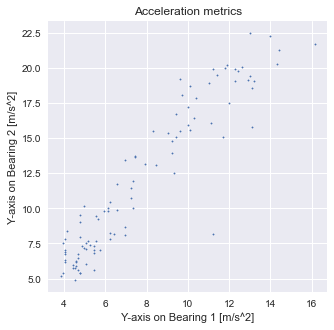

In [13]:
# plot size metrics
fig=plt.figure(figsize=(5,5))
plt.scatter(df96f_false['a1_y_max'], df96f_false['a2_y_max'], s=2)
plt.title("Acceleration metrics")
plt.xlabel("Y-axis on Bearing 1 [m/s^2]")
plt.ylabel("Y-axis on Bearing 2 [m/s^2]")

In [16]:
#Generate sub-datasets: MAX, MEDIAN, MIN, STANDARD DEVIATION... 
df_max = df96f_false[['a1_x_max','a1_y_max','a1_z_max','a2_x_max','a2_y_max','a2_z_max','hert_max','w_max']]
df_min = df96f_false[['a1_x_min','a1_y_min','a1_z_min','a2_x_min','a2_y_min','a2_z_min','hert_max','w_min']]
df_median = df96f_false[['a1_x_median','a1_y_median','a1_z_median','a2_x_median','a2_y_median','a2_z_median','hert_median','w_median']]
#df_STD = df96f_false[['a1_x_STD','a1_y_STD','a1_z_STD','a2_x_STD','a2_y_STD','a2_z_STD','hert_STD','w_STD']]

df_max.describe()

,a1_x_max,a1_y_max,a1_z_max,a2_x_max,a2_y_max,a2_z_max,hert_max,w_max
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000
mean,8.336128,7.760212,9.060772,10.703507,11.911450,12.011228,25.216706,1.354279
std,2.414101,3.251864,1.279370,3.549050,5.346749,3.336773,0.082070,0.160039
min,4.057317,3.840452,7.092118,5.572633,4.903932,6.134114,24.793388,1.236802
25%,6.654617,4.857772,8.340533,7.814735,7.186590,9.546985,25.210084,1.269065
50%,7.520383,6.774121,8.916724,9.443209,9.997862,12.112866,25.210084,1.285352
75%,9.588604,10.133646,9.588948,13.148578,16.509442,13.931404,25.210084,1.359929
max,15.600872,16.142936,16.311181,19.166852,22.492407,21.180641,25.423729,2.308108


In [17]:
# Generate other sub dataset of Crest factor, Entropy,
df_crestfactor = df96f_false[['a1_x_crest_F','a1_y_crest_F','a1_z_crest_F','a2_x_crest_F','a2_y_crest_F','a2_z_crest_F','hert_crest_F','w_crest_F']]
df_entropy = df96f_false[['a1_x_entropy','a1_y_entropy','a1_z_entropy','a2_x_entropy','a2_y_entropy','a2_z_entropy','hert_entropy','w_entropy']]
df_impulse_factor = df96f_false[['a1_x_impulse','a1_y_impulse','a1_z_impulse','a2_x_impulse','a2_y_impulse','a2_z_impulse','hert_impulse','w_impulse']]
df_margin_factor = df96f_false[['a1_x_margin','a1_y_margin','a1_z_margin','a2_x_margin','a2_y_margin','a2_z_margin','hert_margin','w_margin']]
df_frequence_centre = df96f_false[['a1_x_frequence','a1_y_frequence','a1_z_frequence','a2_x_frequence','a2_y_frequence','a2_z_frequence','hert_frequence','w_frequence']]
df_mean_square_frequency = df96f_false[['a1_x_MS_F','a1_y_MS_F','a1_z_MS_F','a2_x_MS_F','a2_y_MS_F','a2_z_MS_F','hert_MS_F','w_MS_F']]
df_RMQ_frequency = df96f_false[['a1_x_RMQ_F','a1_y_RMQ_F','a1_z_RMQ_F','a2_x_RMQ_F','a2_y_RMQ_F','a2_z_RMQ_F','hert_RMQ_F','w_RMQ_F']]


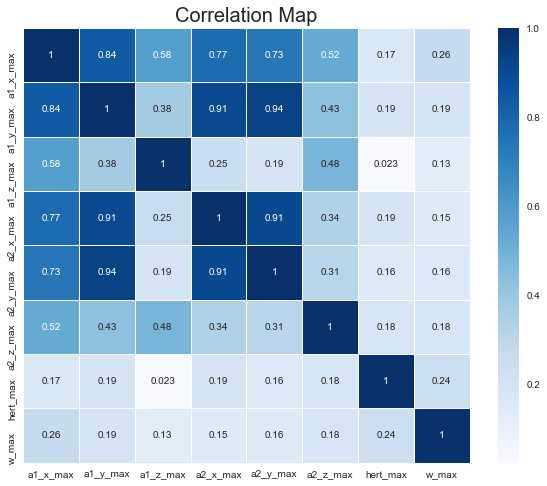

In [18]:
# Correlation map
plt.rcParams['figure.figsize']=(10,8)
heat_map = sns.heatmap(df_max.corr(), annot = True, linewidths=1, cmap='Blues')
heat_map.set_title(label='Correlation Map', fontsize=20)
heat_map;

## Features selection

### Considering 2 features, no Label available


In [ ]:
# Make new dataframe with relevant metrics 
#=====with MAX sub dataset====== 

#df_metrics = df_max[['a1_x_max','a2_x_max']]  #Got max silhouette score of 0.61 with 2 cluster
#df_metrics = df_max[['a1_y_max','a2_y_max']] #Got max silhouette score of 0.67 with 2 cluster
#df_metrics = df_max[['a1_z_max','a2_z_max']]#Got max silhouette score of 0.42 with 3 cluster

#df_metrics = df_max[['a1_x_max','a2_y_max']]  #Got max silhouette score of 0.60 with 2 cluster
#df_metrics = df_max[['a1_x_max','a2_z_max']]  #Got max silhouette score of 0.47 with 4 cluster
#df_metrics = df_max[['a1_y_max','a2_z_max']]  #Got max silhouette score of 0.47 with 2 cluster
#df_metrics = df_max[['a2_y_max','a1_z_max']]  #Got max silhouette score of 0.54 with 3 cluster
#df_metrics = df_max[['a2_y_max','a2_z_max']]  #Got max silhouette score of 0.46 with 2,3,4 cluster

#df_metrics = df_max[['a1_x_max','hert_max']]#Got max silhouette score of 0.67 with 4 cluster
#df_metrics = df_max[['a2_x_max','hert_max']]#Got max silhouette score of 0.64 with 4 cluster

#df_metrics = df_max[['a1_y_max','hert_max']]#Got max silhouette score of 0.67 with 4 cluster
#df_metrics = df_max[['a2_y_max','hert_max']]#Got max silhouette score of 0.68 with 4 cluster

#
df_metrics = df_max[['a1_z_max','hert_max']]#***Got max silhouette score of 0.73 with 4 cluster
#df_metrics = df_max[['a2_z_max','hert_max']]#Got max silhouette score of 0.6 with 11 cluster

# Option1: z-score normalisation  
#df_metrics_normalized =(df_metrics - df_metrics.mean())/df_metrics.std()
#df_metrics_normalized = df_metrics_normalized.rename(columns=lambda x: x+'_zscore')

# Option2: StandarScaler
scl = StandardScaler()
df_metrics_normalized = scl.fit_transform(df_metrics)
df_metrics_normalized = pd.DataFrame(df_metrics_normalized)


# add cluster index to dataframe
#cluster_labels = pd.Series(kmeans.labels_, name='cluster')
#df_metrics_normalized = df_metrics_normalized.join(cluster_labels.to_frame())

# Generate a list of Silhouette coefficients correspoding to k (nr of clusters) values
silhouette_coeffs = []
for k in range (2, 15):
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state = 42)
    kmeans.fit(df_metrics_normalized)

    cluster_centers = kmeans.cluster_centers_
    labels = kmeans.labels_
    predict= kmeans.predict(df_metrics_normalized)
    score = round(metrics.silhouette_score(df_metrics_normalized, labels),2)
    silhouette_coeffs.append(score)
    
plt.plot(range(2, 15), silhouette_coeffs)
plt.title('K-Means - Silhouette_coefficients method')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette_coefficients')
plt.show()
print(f'Silhouette_coefficients: {silhouette_coeffs}')
# Generate a list of SSE (Sum of Squared Errors) values correspoding to k (nr of clusters) values
SSEs = []
for k in range(1, 13):
    kmeans = KMeans(n_clusters = k,
                    init = 'k-means++',
                    random_state = 42)
    kmeans.fit(df_metrics_normalized)
    inertia = round(kmeans.inertia_,0)
    SSEs.append(inertia) #inertia_ is the formula used to segregate the data points into clusters
plt.plot(range(1, 13), SSEs)
plt.title('K-Means - the Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Sum of Squared Errors')

# Get the optimal clusters
kl = KneeLocator(range(1,13), SSEs, curve = 'convex', direction = 'decreasing')
print(f'Optimal number of clusters: {kl.elbow}')


### With automated functions run on each subdataset
#### Apply Kmean method

[('a1_x_max', 'a1_y_max'), ('a1_x_max', 'a1_z_max'), ('a1_x_max', 'a2_x_max'), ('a1_x_max', 'a2_y_max'), ('a1_x_max', 'a2_z_max'), ('a1_x_max', 'hert_max'), ('a1_x_max', 'w_max'), ('a1_y_max', 'a1_z_max'), ('a1_y_max', 'a2_x_max'), ('a1_y_max', 'a2_y_max'), ('a1_y_max', 'a2_z_max'), ('a1_y_max', 'hert_max'), ('a1_y_max', 'w_max'), ('a1_z_max', 'a2_x_max'), ('a1_z_max', 'a2_y_max'), ('a1_z_max', 'a2_z_max'), ('a1_z_max', 'hert_max'), ('a1_z_max', 'w_max'), ('a2_x_max', 'a2_y_max'), ('a2_x_max', 'a2_z_max'), ('a2_x_max', 'hert_max'), ('a2_x_max', 'w_max'), ('a2_y_max', 'a2_z_max'), ('a2_y_max', 'hert_max'), ('a2_y_max', 'w_max'), ('a2_z_max', 'hert_max'), ('a2_z_max', 'w_max'), ('hert_max', 'w_max')]
With 2-features combination of: a1_x_max, a1_y_max
for n_clusters = 2 The average silhouette_score is : 0.6116759149718186
for n_clusters = 3 The average silhouette_score is : 0.5322651239052065
for n_clusters = 4 The average silhouette_score is : 0.43682624854142127
for n_clusters = 5 The a

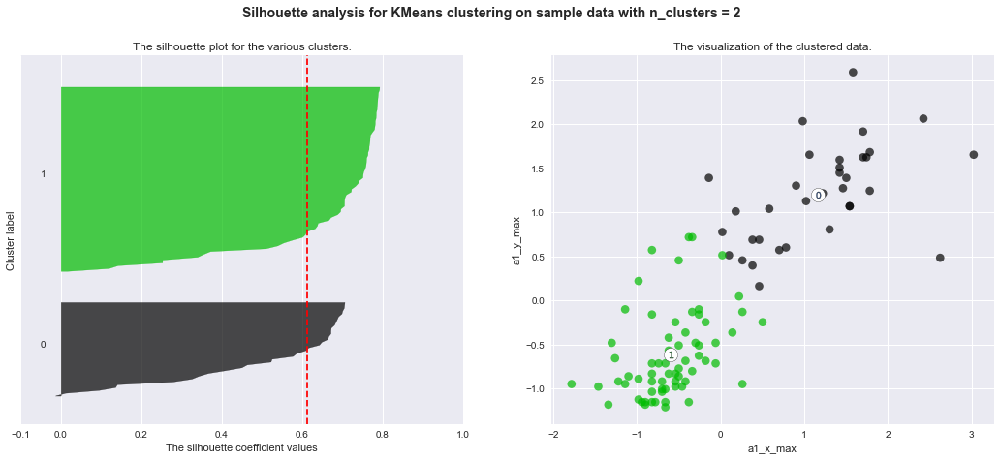

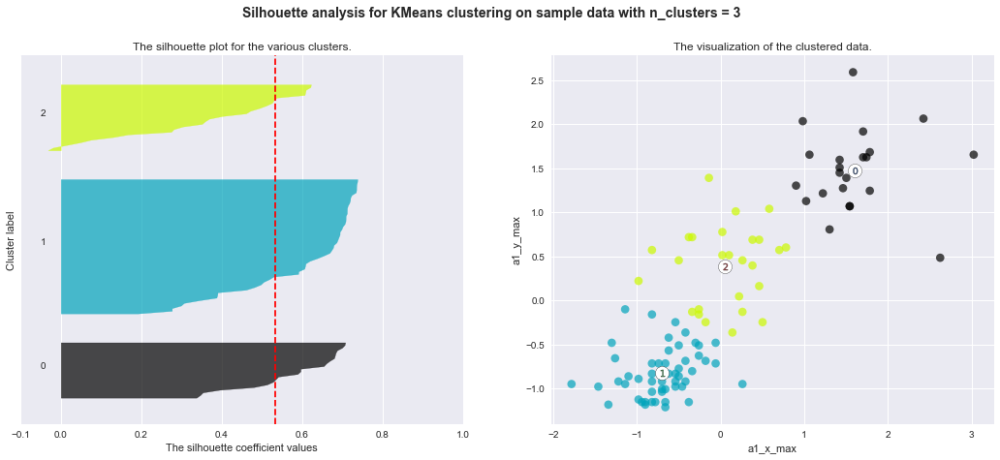

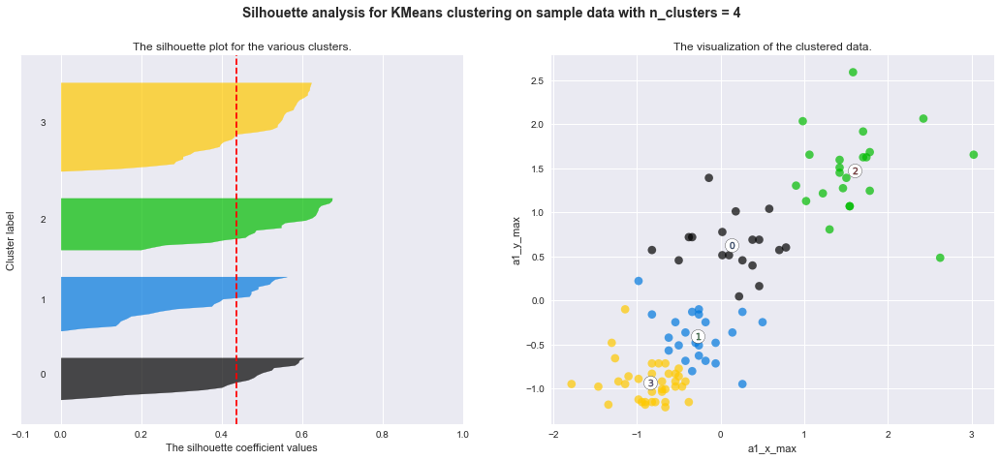

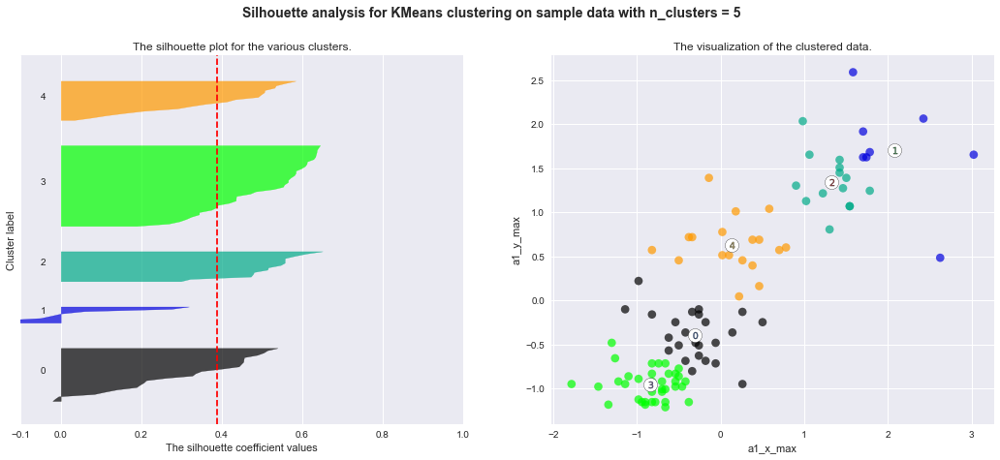

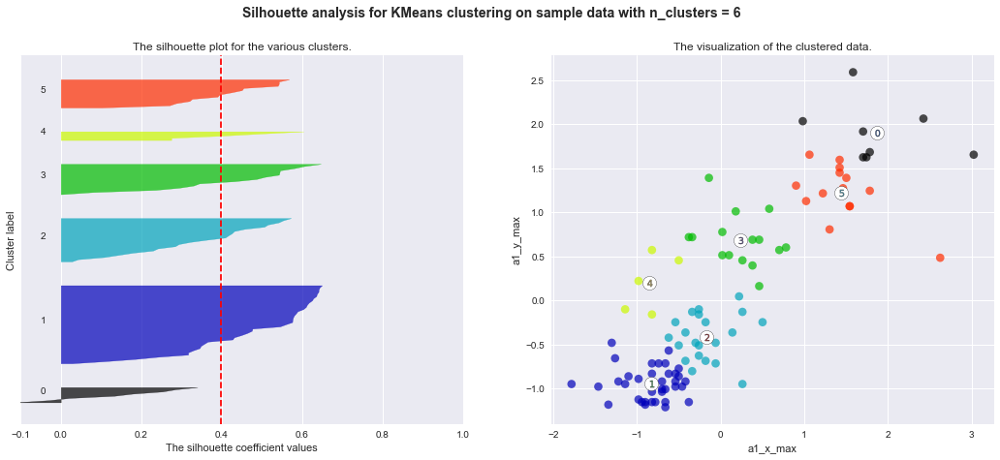

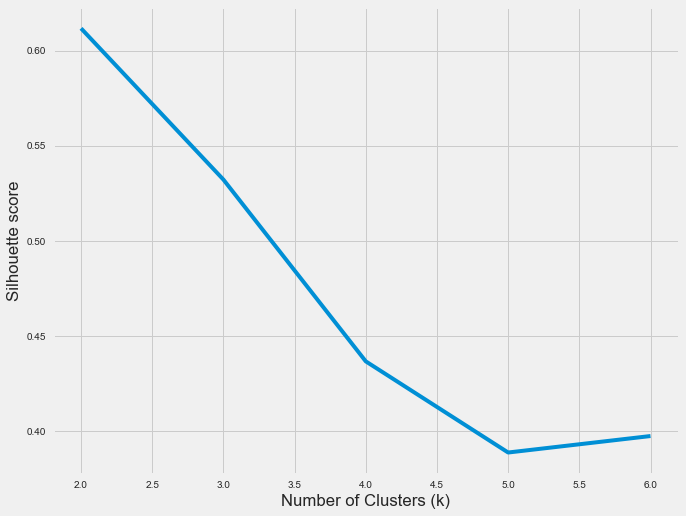

With 2-features combination of: a1_x_max, a1_z_max
for n_clusters = 2 The average silhouette_score is : 0.5278985940039364
for n_clusters = 3 The average silhouette_score is : 0.5248085360630029
for n_clusters = 4 The average silhouette_score is : 0.40154028581367435
for n_clusters = 5 The average silhouette_score is : 0.4077905447849842
for n_clusters = 6 The average silhouette_score is : 0.40791214081399135


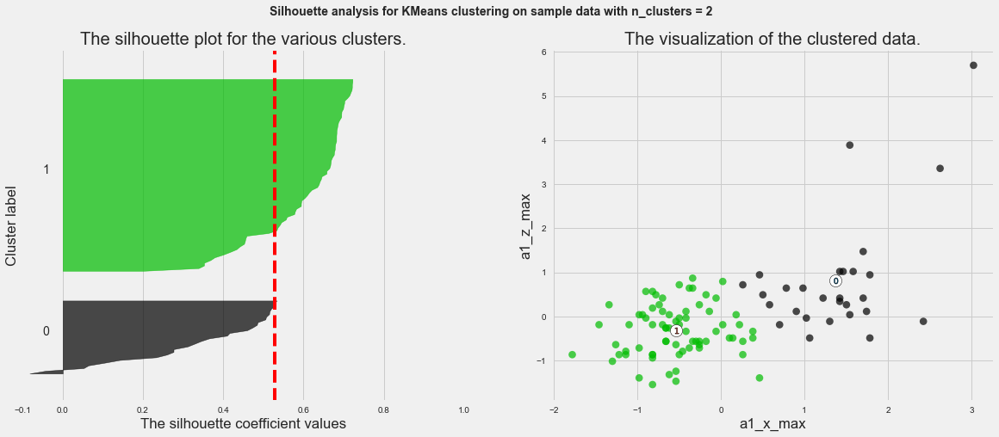

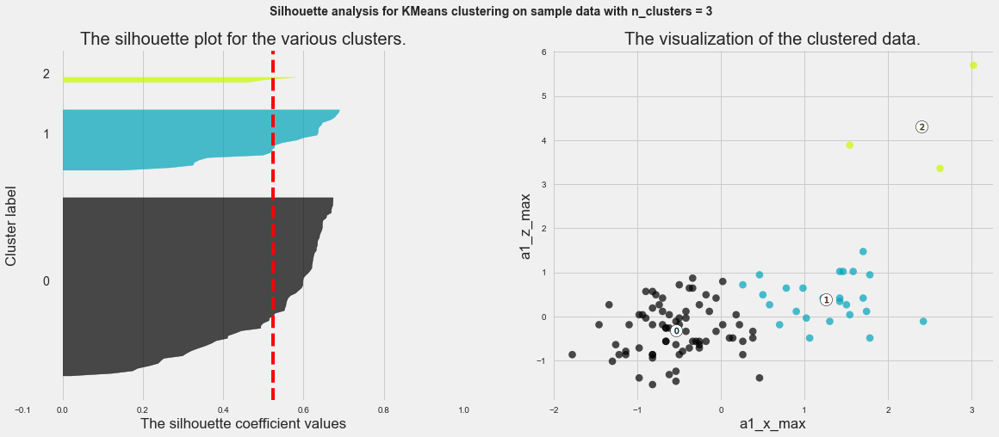

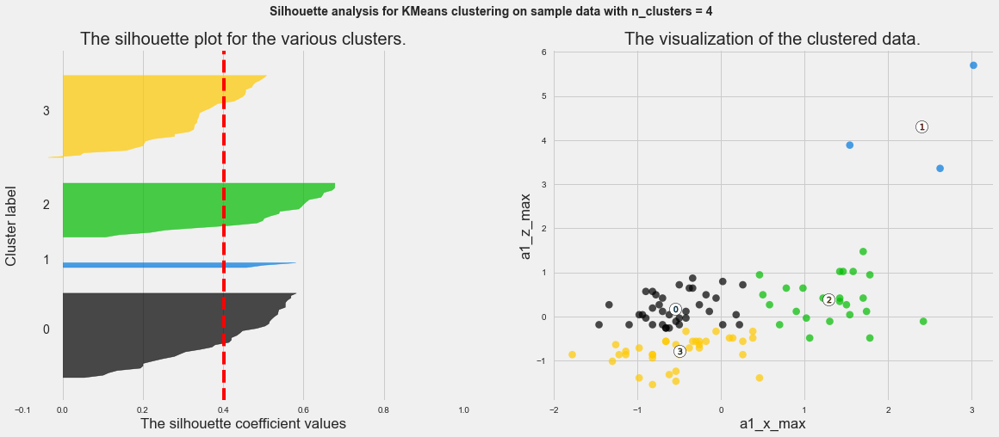

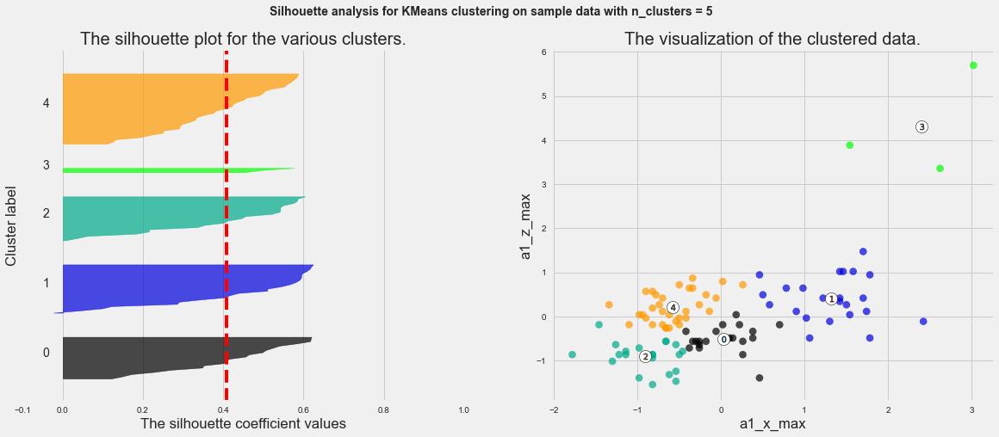

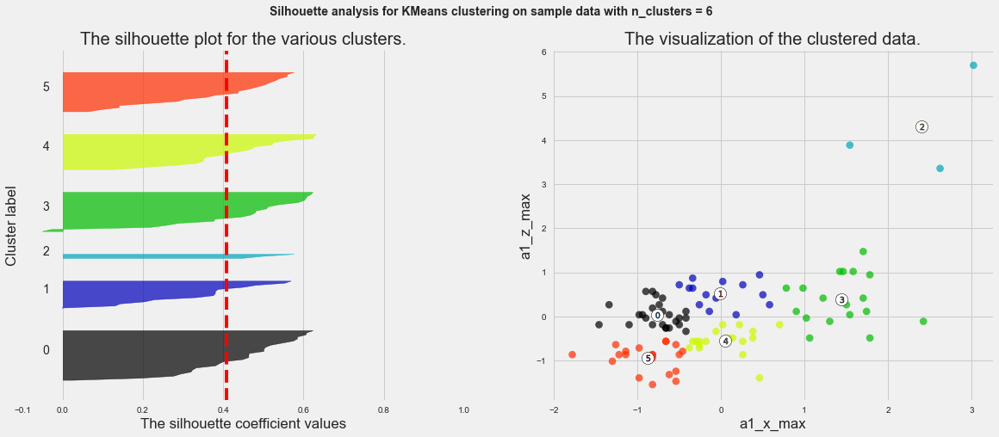

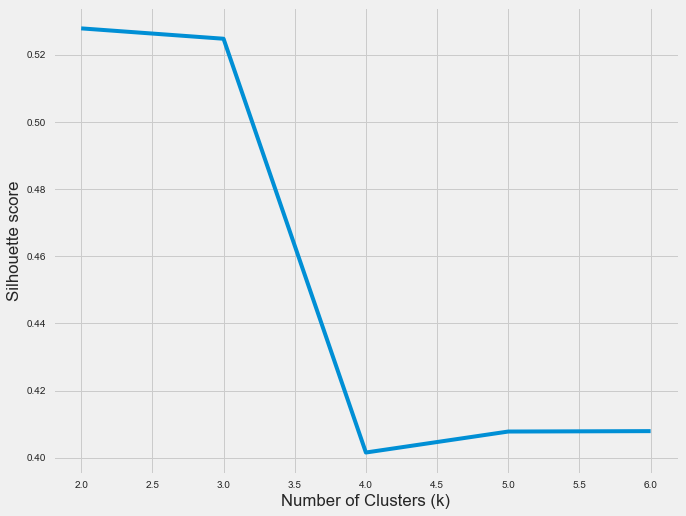

With 2-features combination of: a1_x_max, a2_x_max
for n_clusters = 2 The average silhouette_score is : 0.6130428789272578
for n_clusters = 3 The average silhouette_score is : 0.49992567944394795
for n_clusters = 4 The average silhouette_score is : 0.49028560911988195
for n_clusters = 5 The average silhouette_score is : 0.3925340386092289
for n_clusters = 6 The average silhouette_score is : 0.4006377213044706


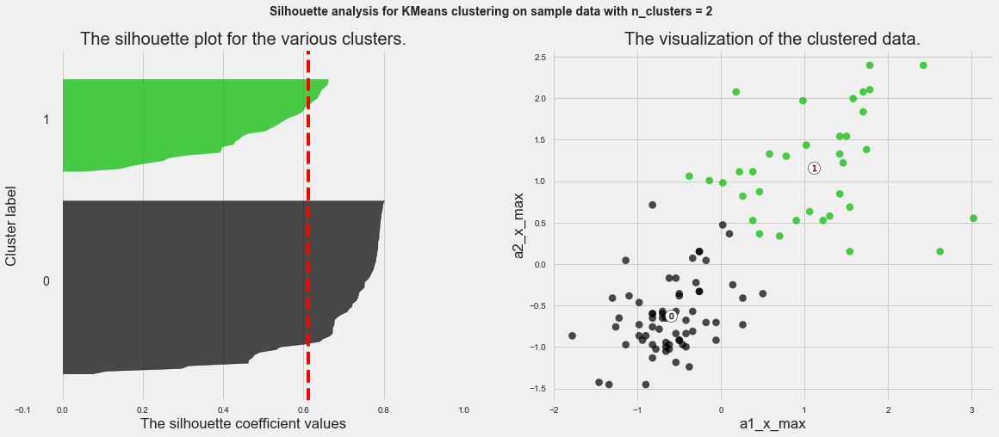

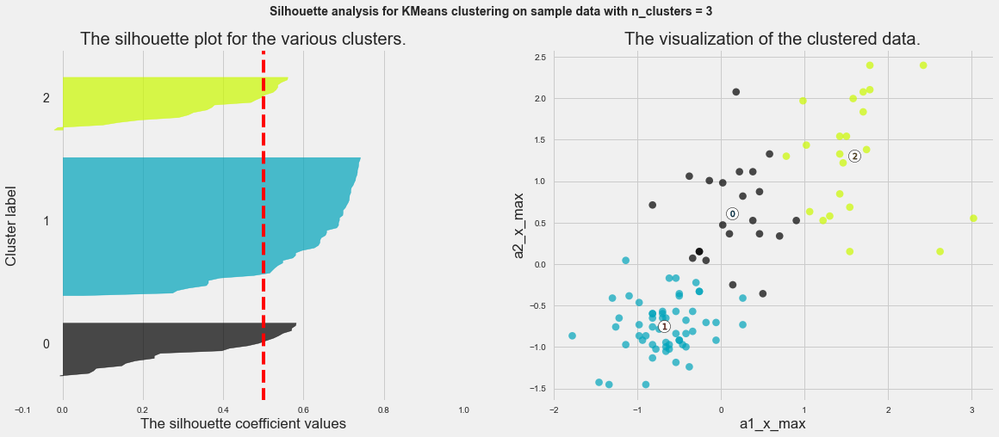

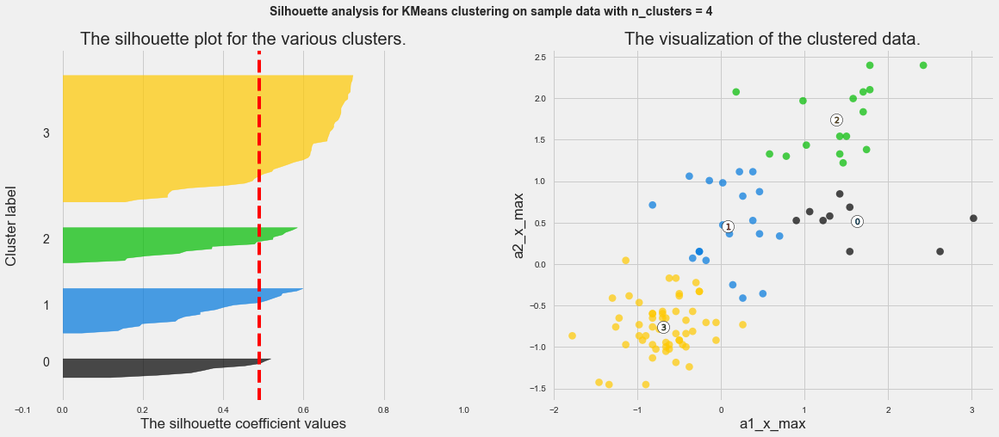

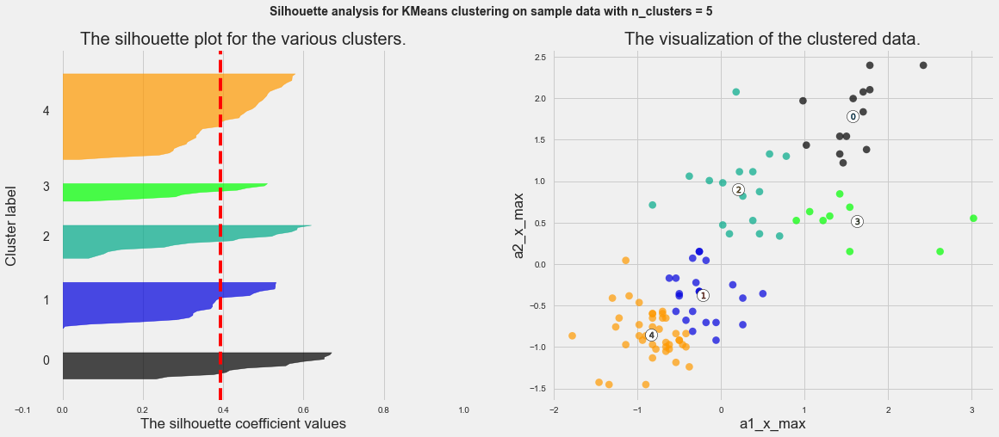

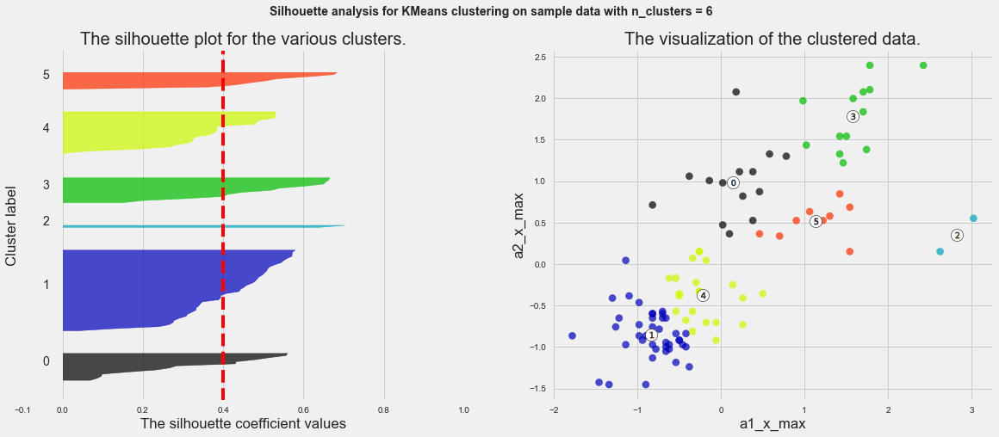

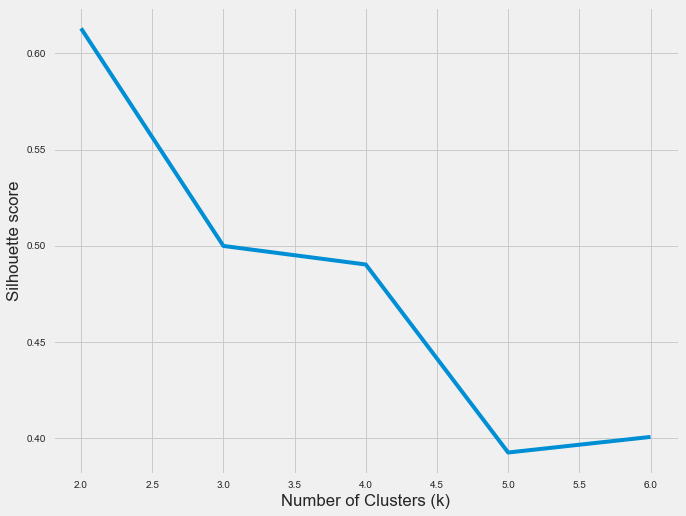

With 2-features combination of: a1_x_max, a2_y_max
for n_clusters = 2 The average silhouette_score is : 0.599900281800714
for n_clusters = 3 The average silhouette_score is : 0.5325223149220912
for n_clusters = 4 The average silhouette_score is : 0.5406206790587468
for n_clusters = 5 The average silhouette_score is : 0.4104632104673793
for n_clusters = 6 The average silhouette_score is : 0.4106818732195069


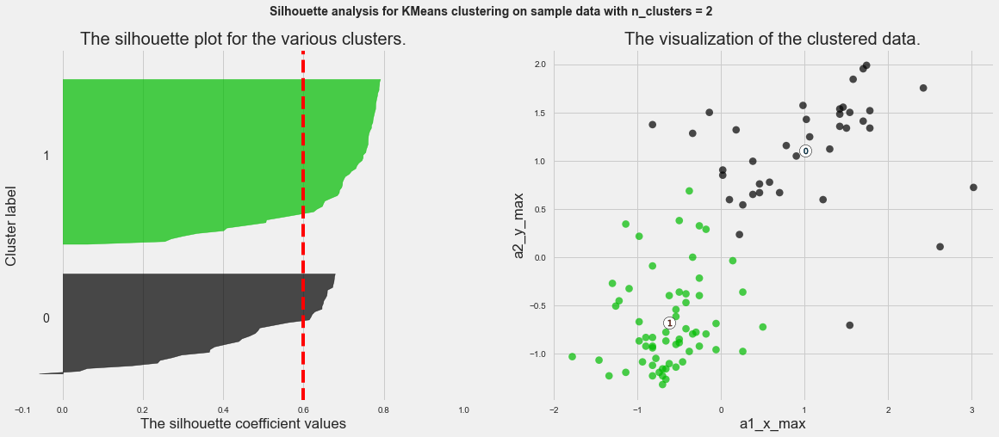

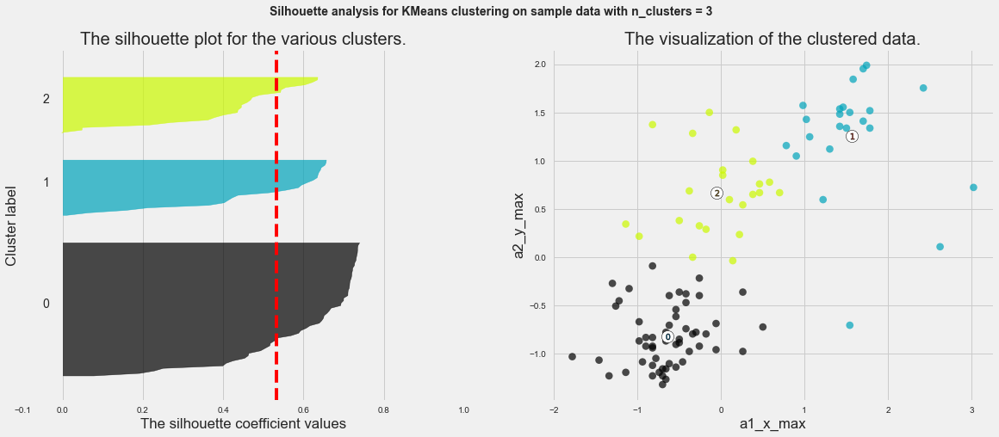

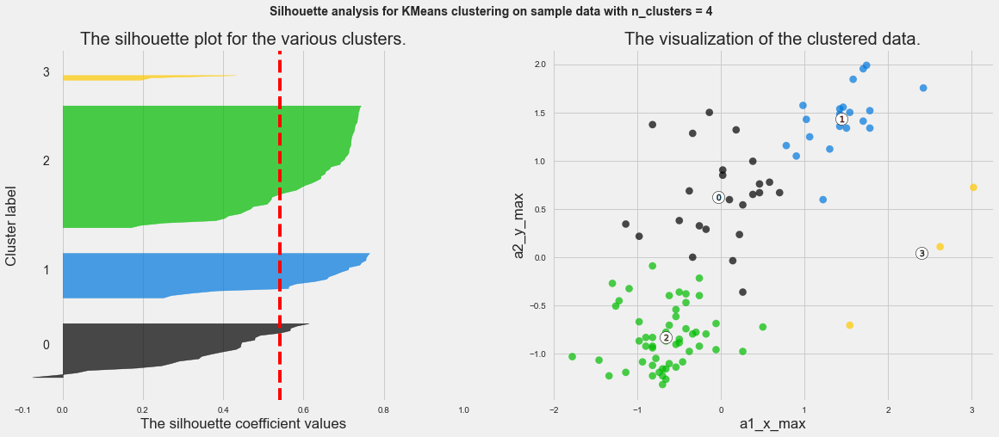

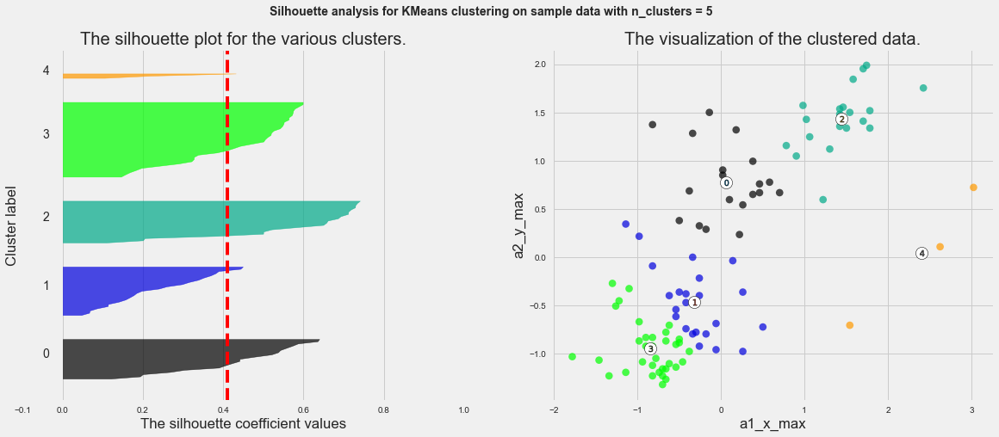

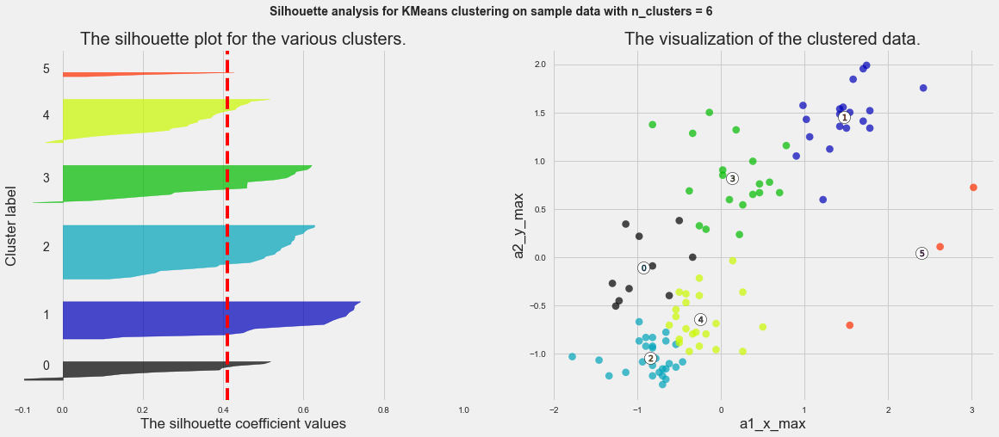

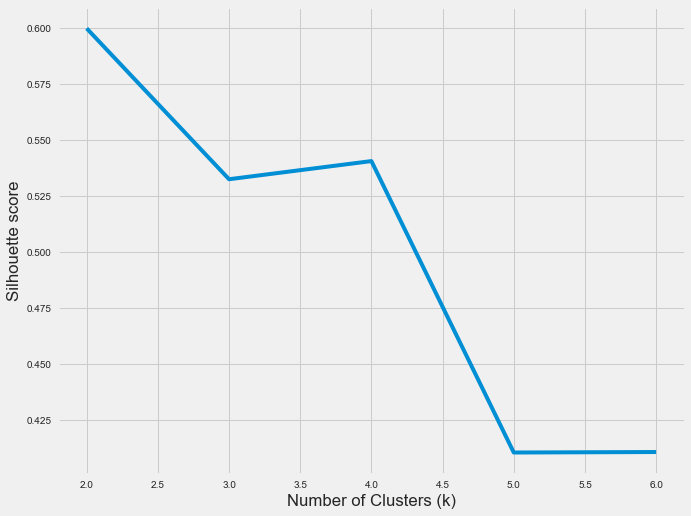

With 2-features combination of: a1_x_max, a2_z_max
for n_clusters = 2 The average silhouette_score is : 0.43156910555851247
for n_clusters = 3 The average silhouette_score is : 0.42659887429265786
for n_clusters = 4 The average silhouette_score is : 0.46646768703982117
for n_clusters = 5 The average silhouette_score is : 0.3984902013937202
for n_clusters = 6 The average silhouette_score is : 0.3842035285926896


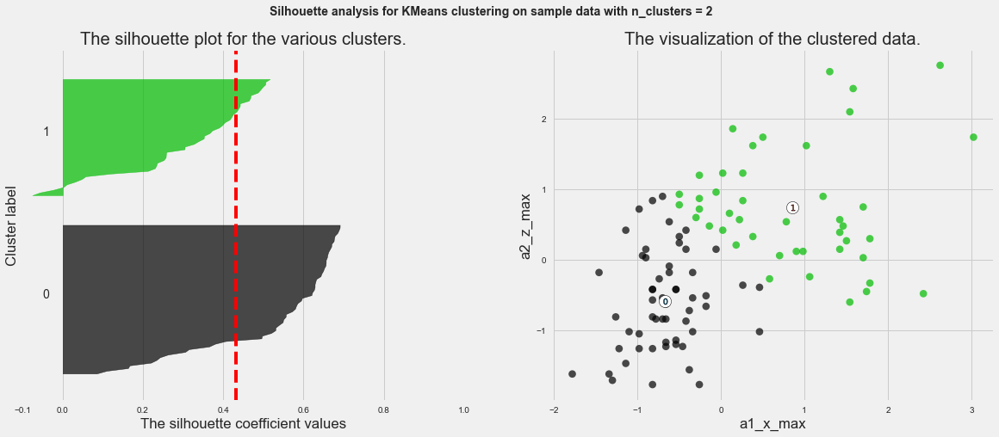

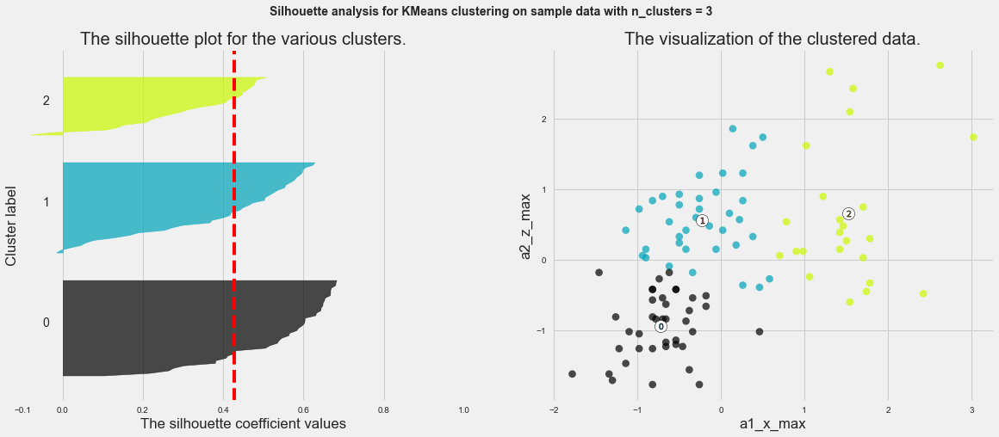

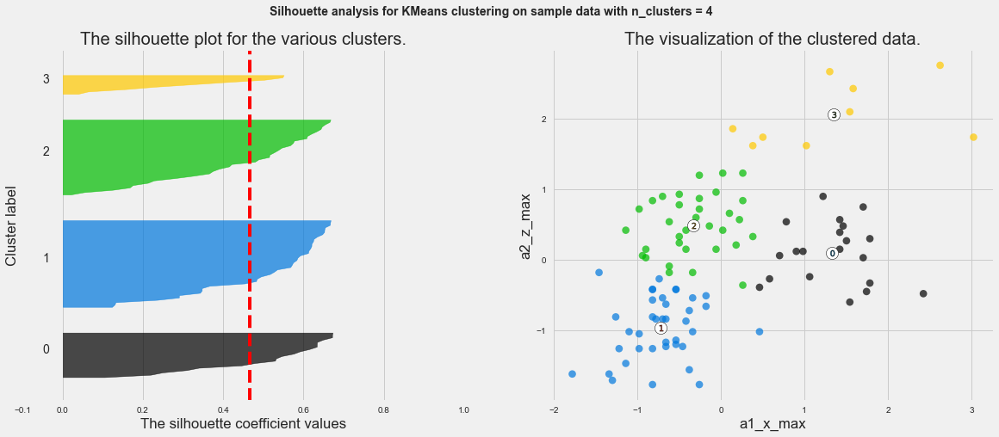

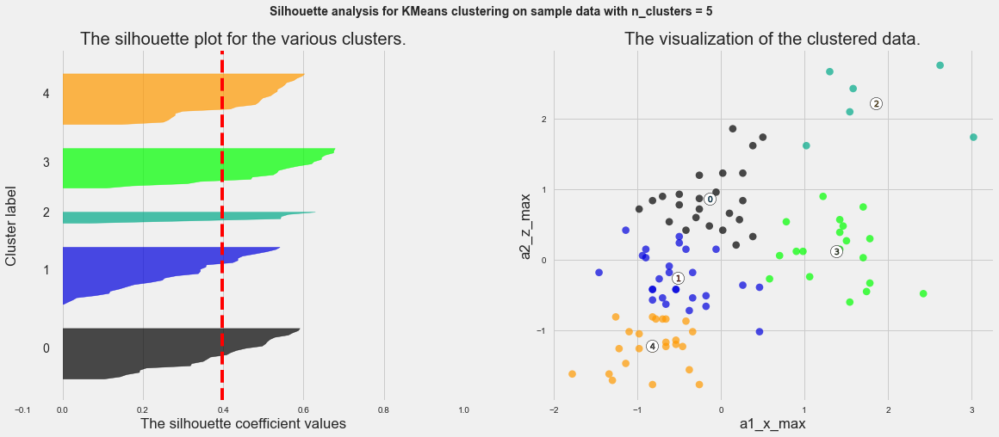

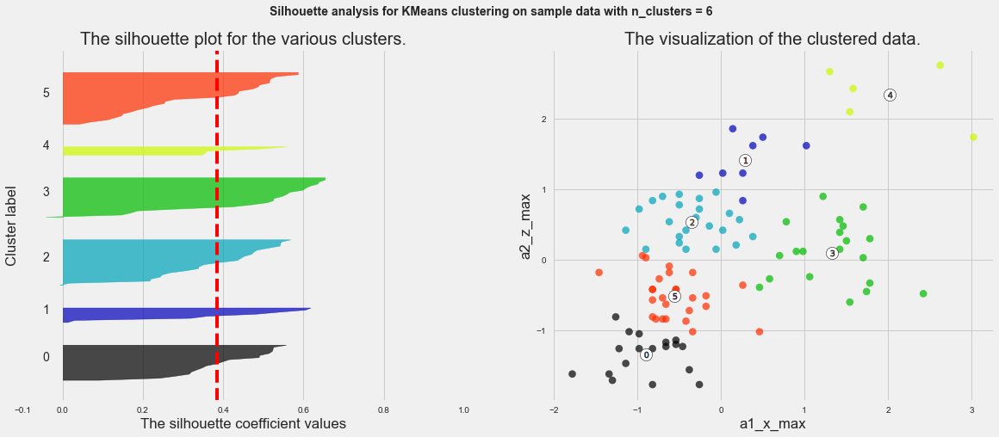

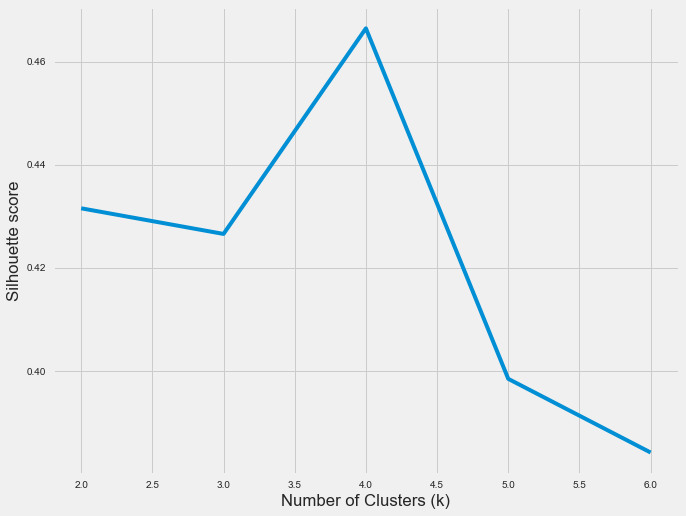

With 2-features combination of: a1_x_max, hert_max
for n_clusters = 2 The average silhouette_score is : 0.5390731102797196
for n_clusters = 3 The average silhouette_score is : 0.6047560932029186
for n_clusters = 4 The average silhouette_score is : 0.6691112426488093
for n_clusters = 5 The average silhouette_score is : 0.5807063300437171
for n_clusters = 6 The average silhouette_score is : 0.5721249707815512


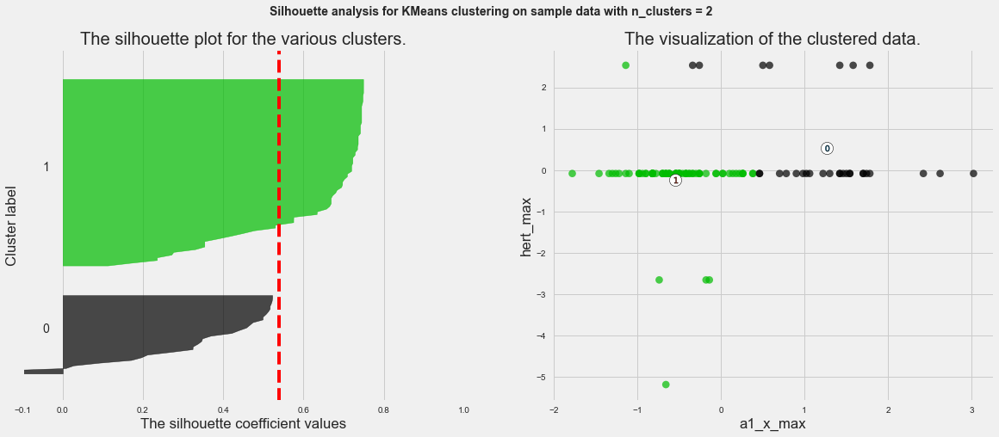

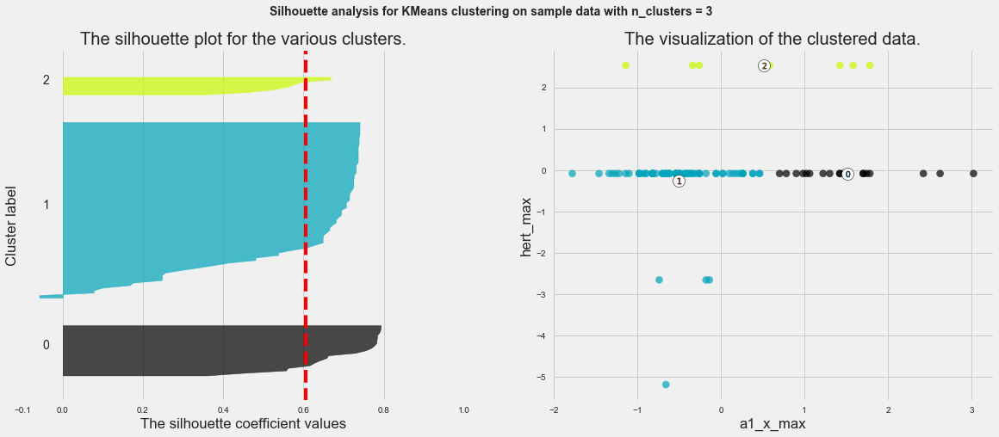

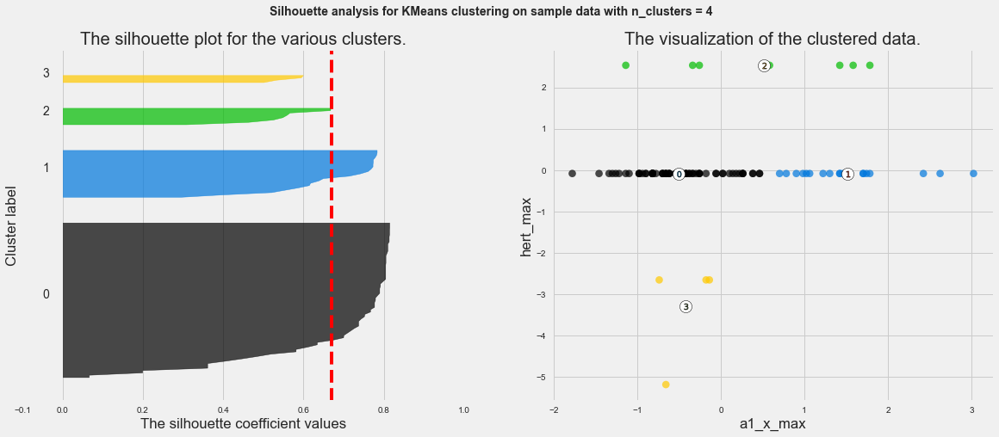

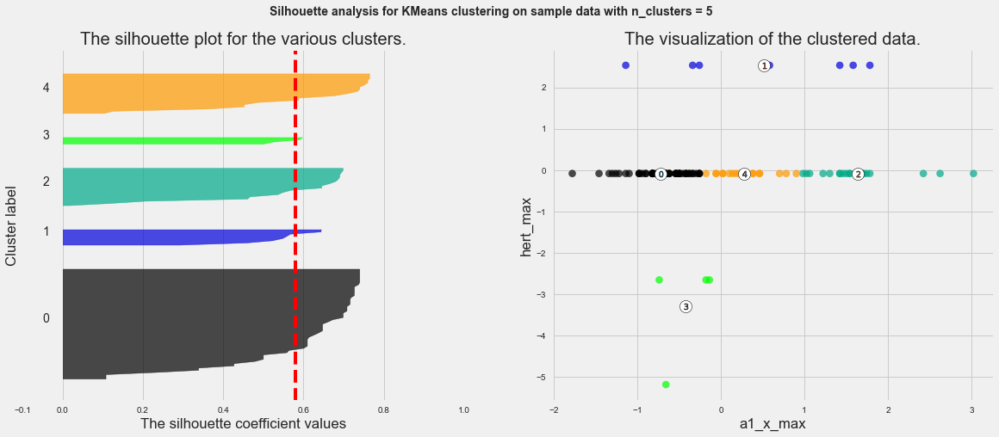

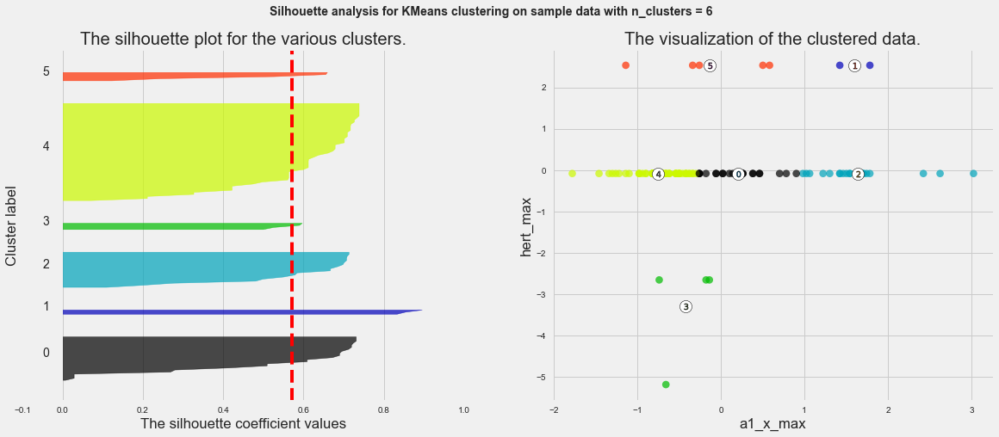

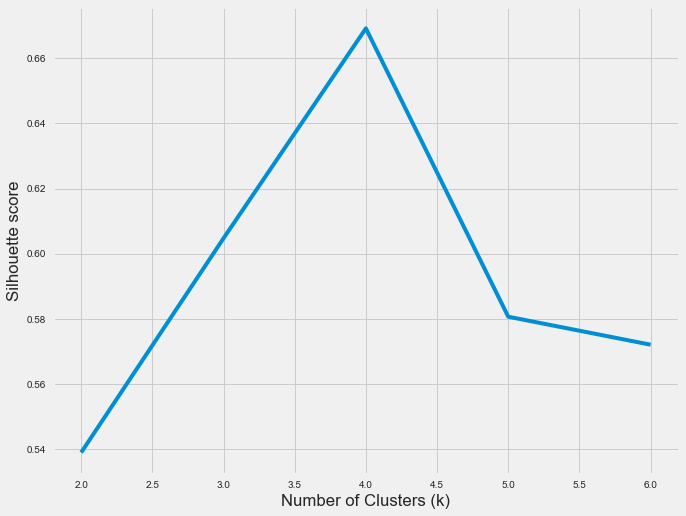

With 2-features combination of: a1_x_max, w_max
for n_clusters = 2 The average silhouette_score is : 0.5034034369536873
for n_clusters = 3 The average silhouette_score is : 0.5673871218776931
for n_clusters = 4 The average silhouette_score is : 0.5699244923449374
for n_clusters = 5 The average silhouette_score is : 0.5660494212437132
for n_clusters = 6 The average silhouette_score is : 0.4472992894337523


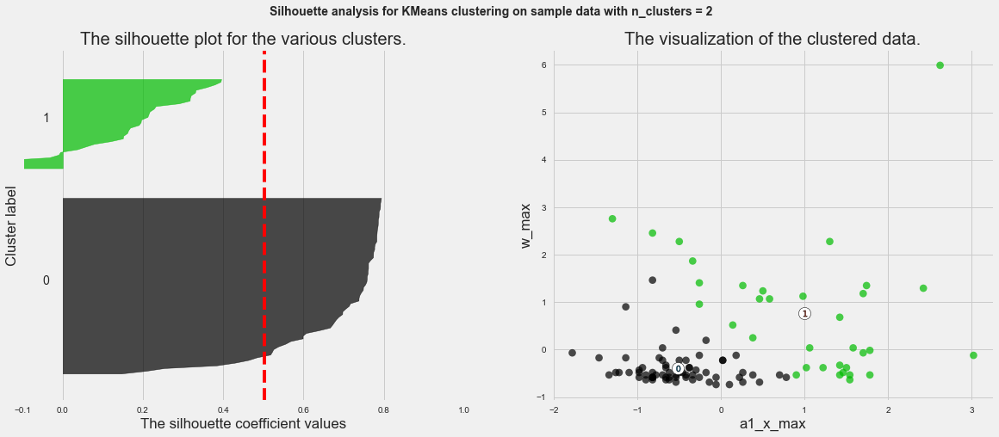

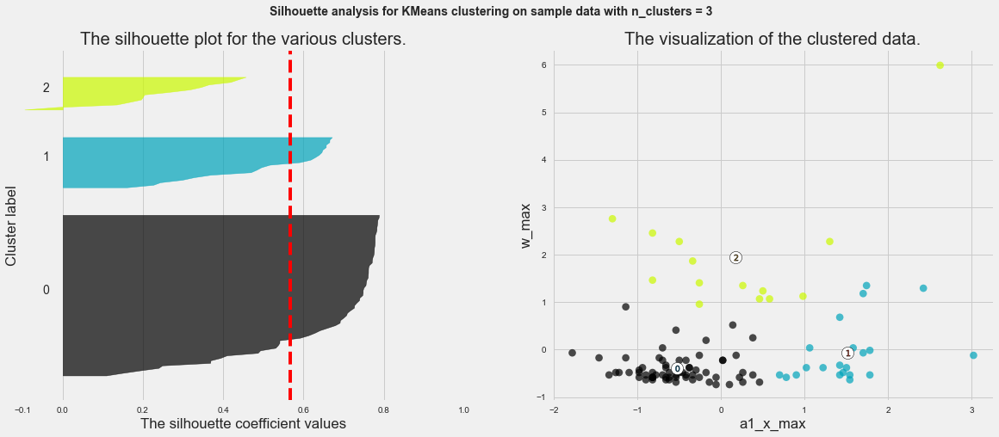

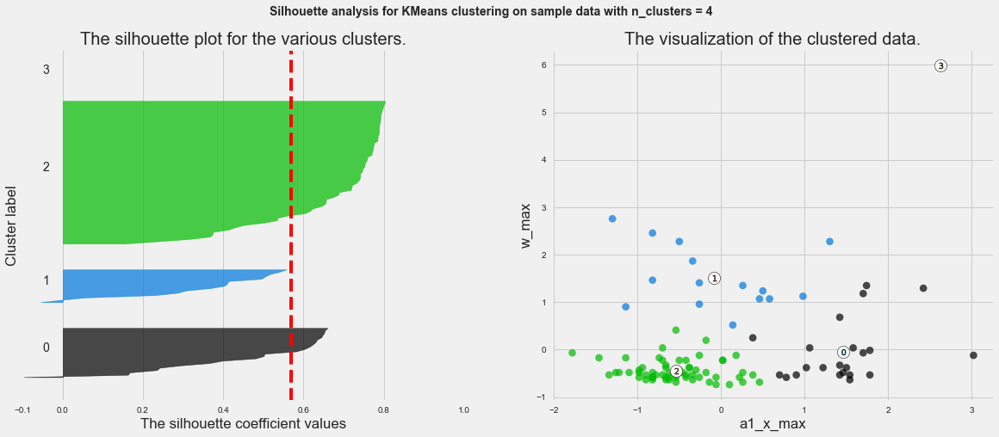

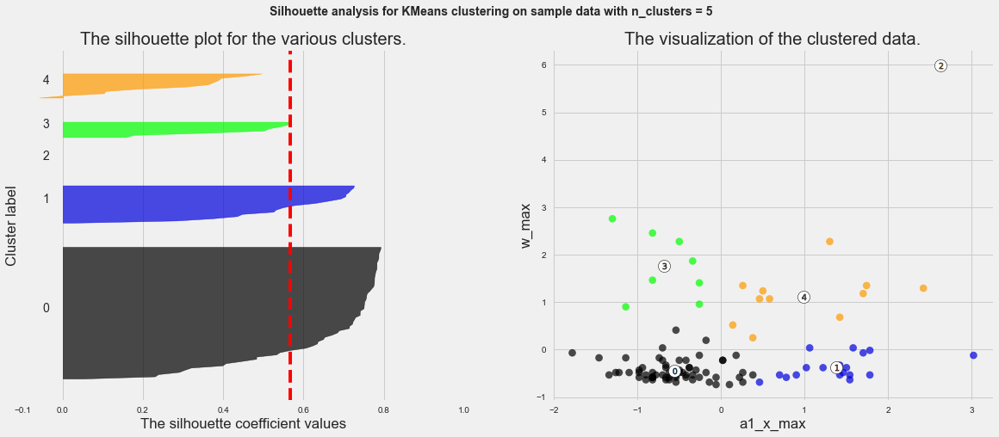

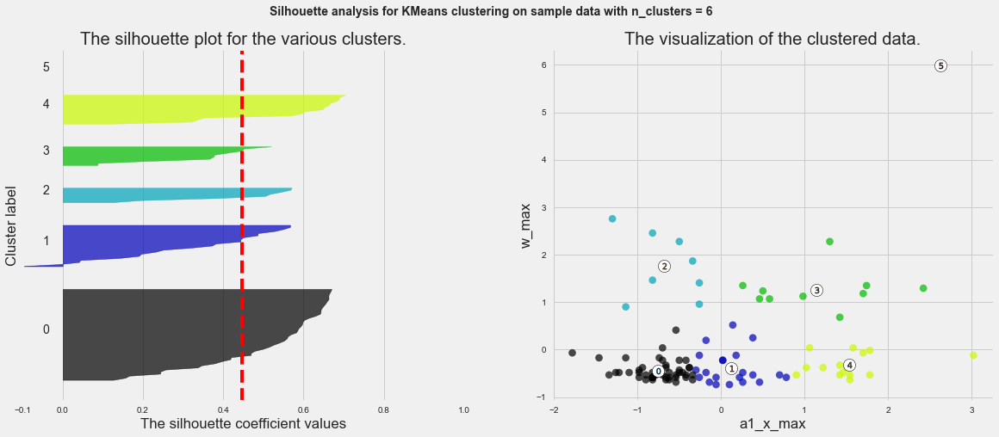

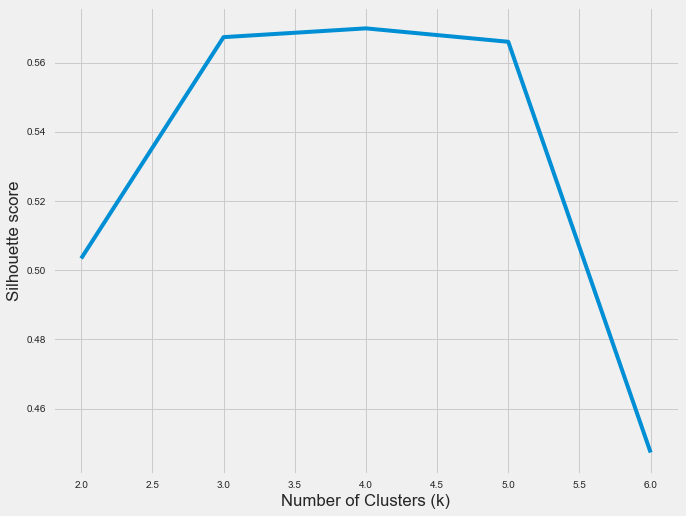

With 2-features combination of: a1_y_max, a1_z_max
for n_clusters = 2 The average silhouette_score is : 0.5200552487834499
for n_clusters = 3 The average silhouette_score is : 0.5379157285017018
for n_clusters = 4 The average silhouette_score is : 0.4489582695514704
for n_clusters = 5 The average silhouette_score is : 0.4065714383970316
for n_clusters = 6 The average silhouette_score is : 0.4173775504241137


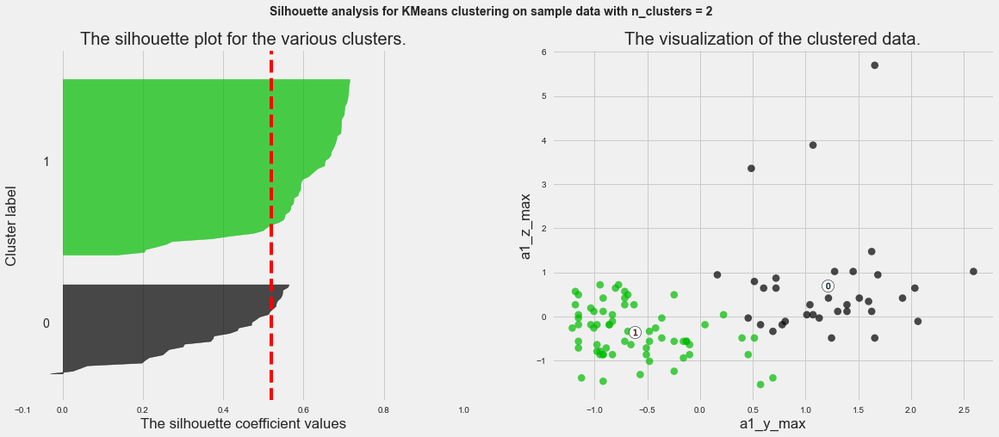

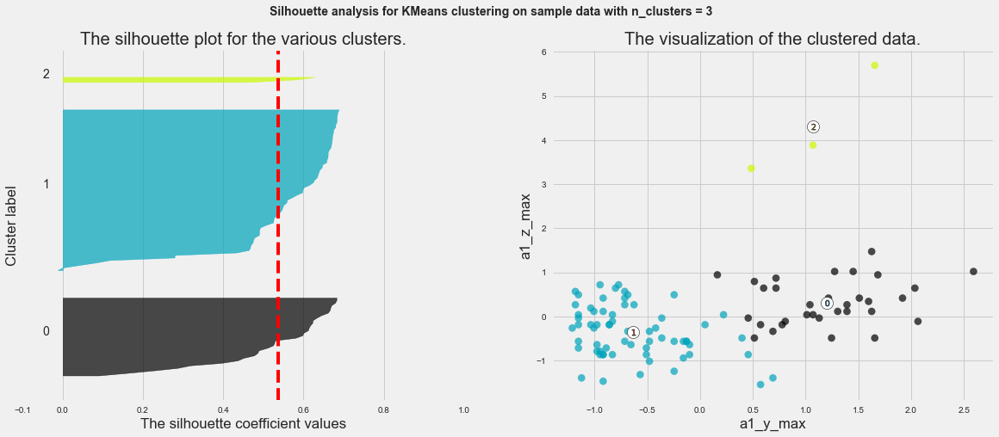

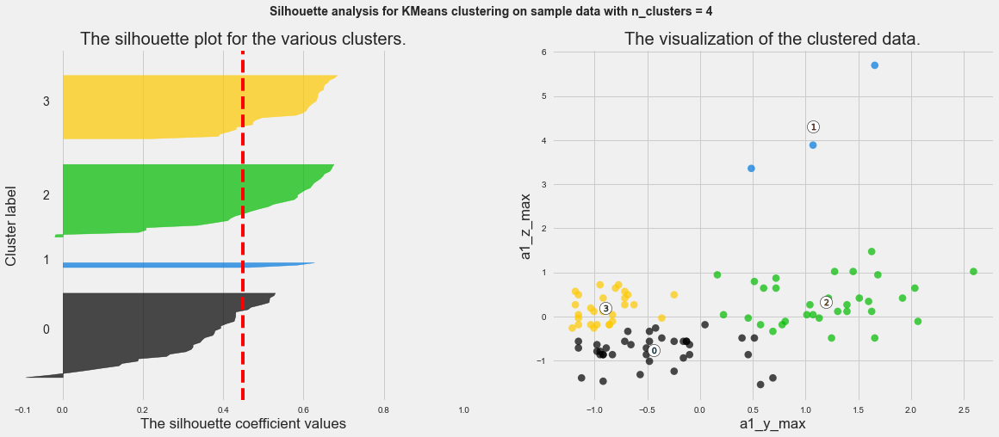

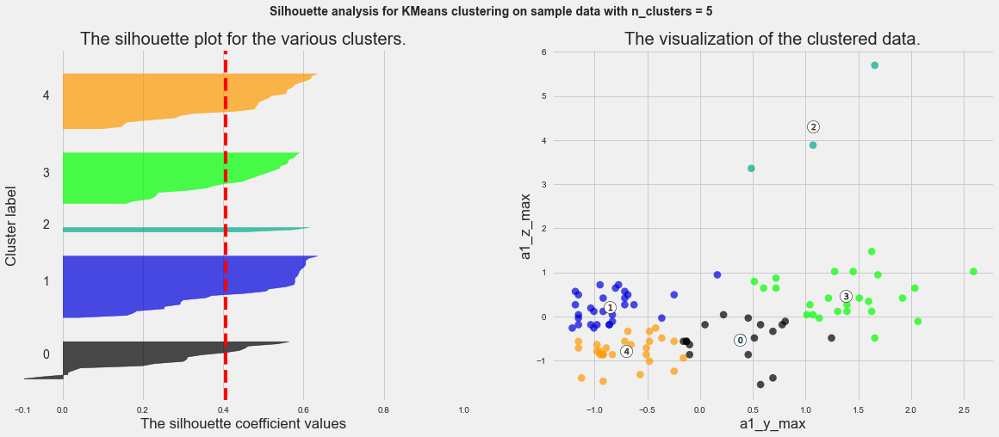

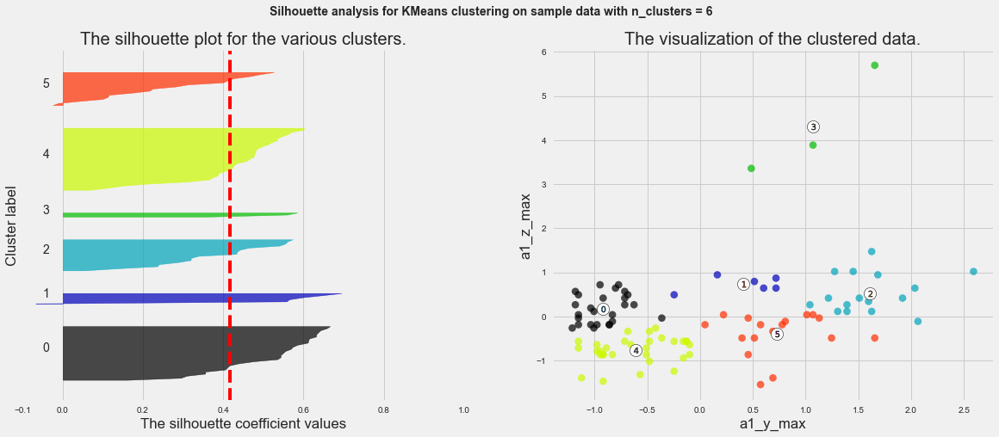

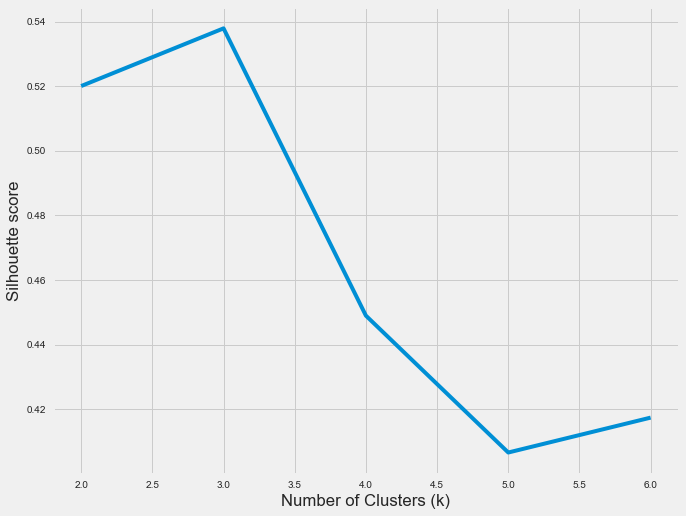

With 2-features combination of: a1_y_max, a2_x_max
for n_clusters = 2 The average silhouette_score is : 0.6644005173572229
for n_clusters = 3 The average silhouette_score is : 0.5669765626692144
for n_clusters = 4 The average silhouette_score is : 0.4869057029211013
for n_clusters = 5 The average silhouette_score is : 0.47397120113820485
for n_clusters = 6 The average silhouette_score is : 0.4783253991575528


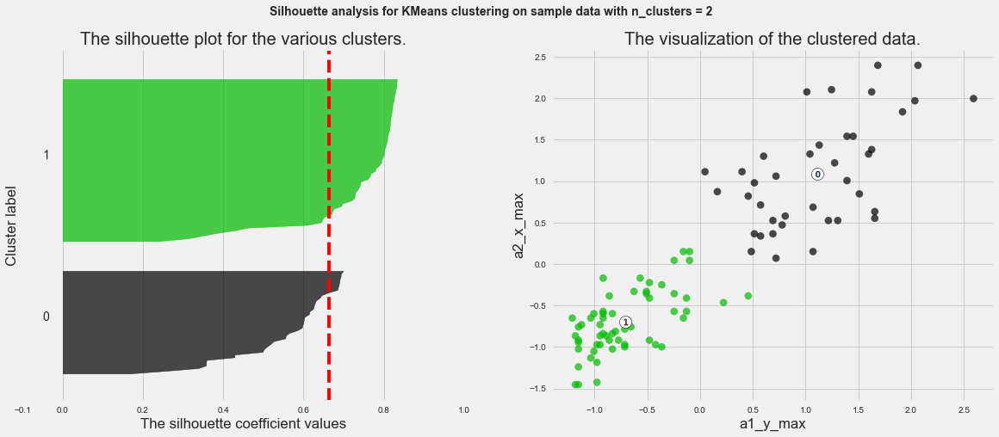

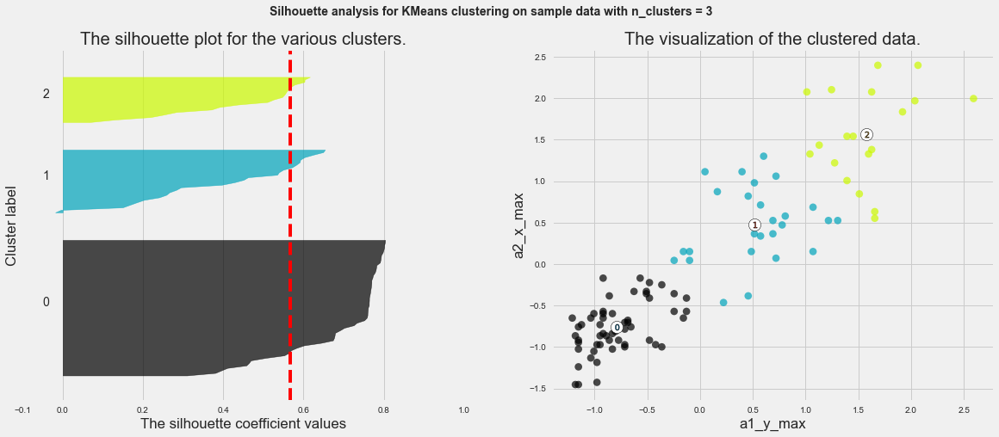

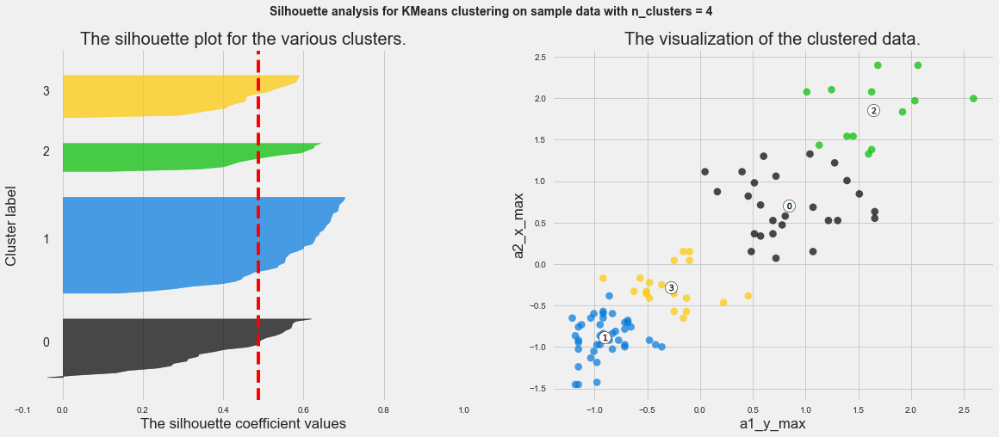

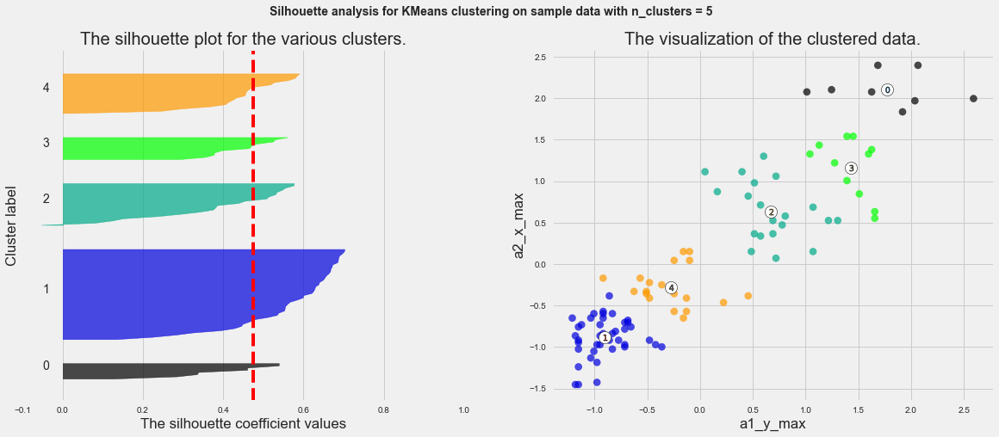

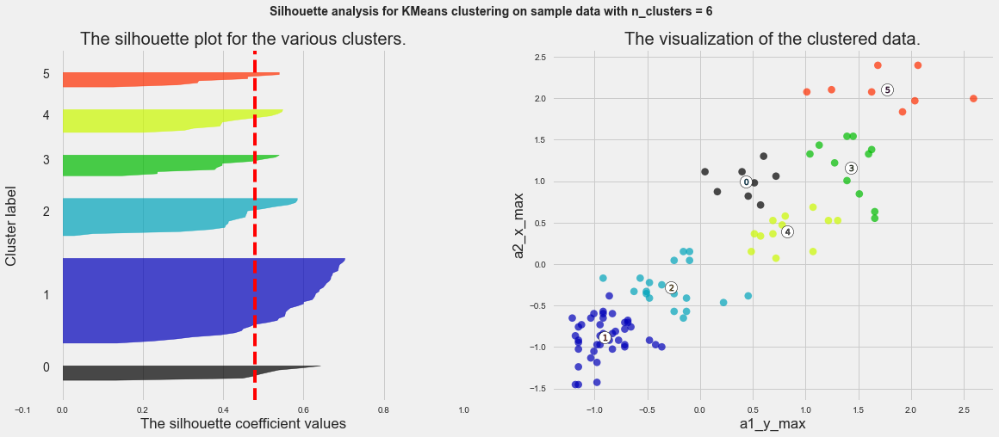

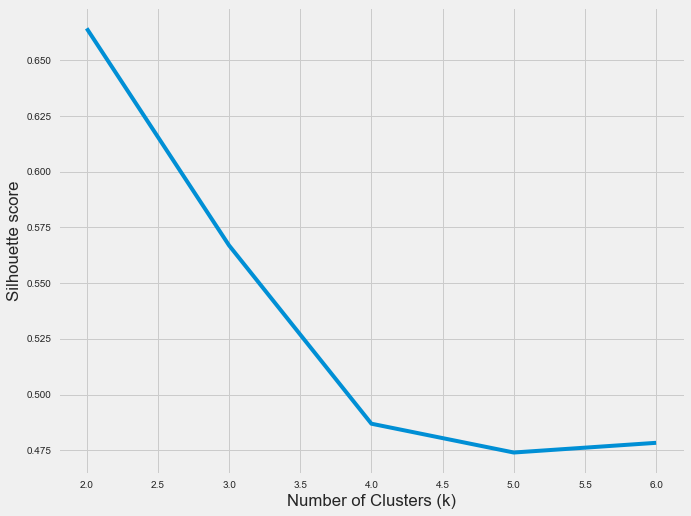

With 2-features combination of: a1_y_max, a2_y_max
for n_clusters = 2 The average silhouette_score is : 0.6712986262202711
for n_clusters = 3 The average silhouette_score is : 0.5971145249870582
for n_clusters = 4 The average silhouette_score is : 0.5188733059800936
for n_clusters = 5 The average silhouette_score is : 0.46961741896959225
for n_clusters = 6 The average silhouette_score is : 0.4538833529919269


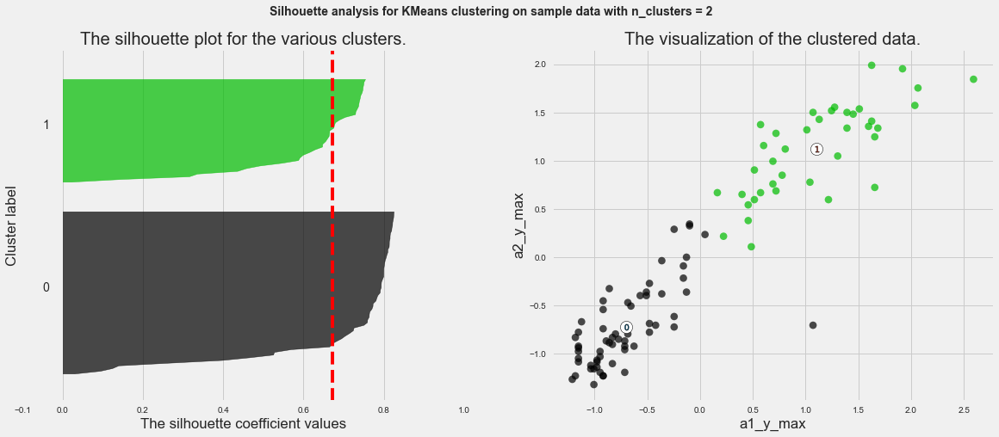

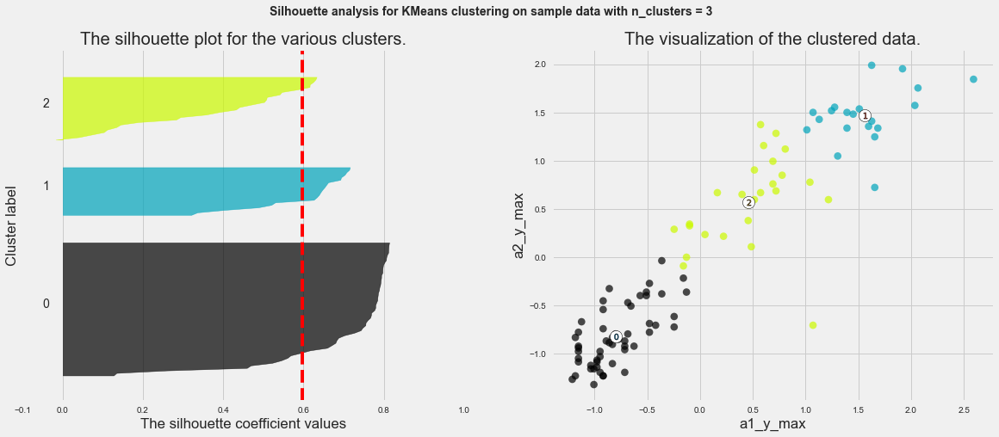

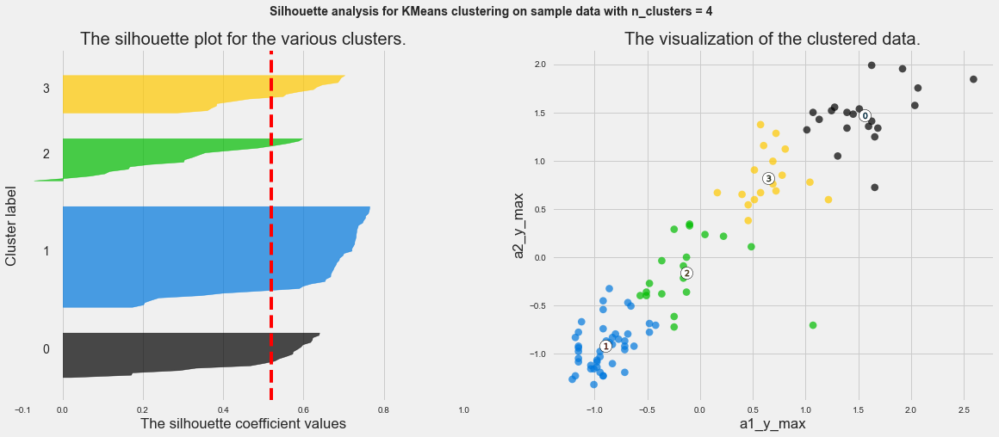

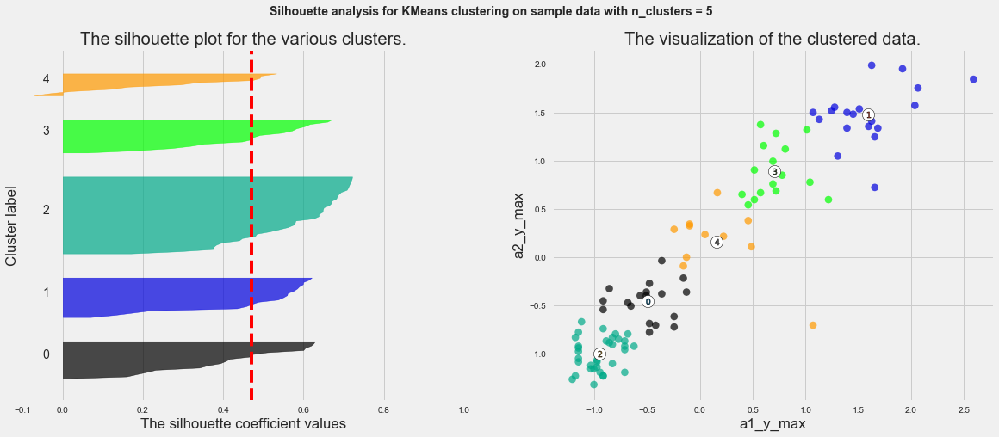

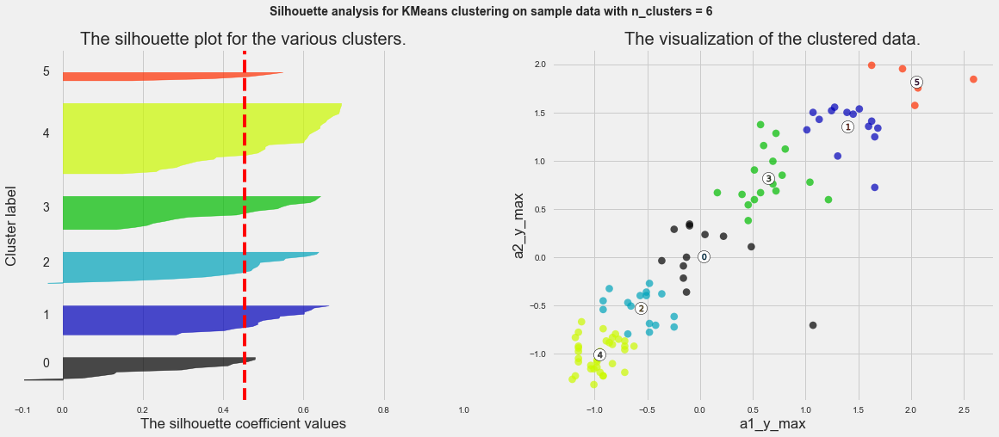

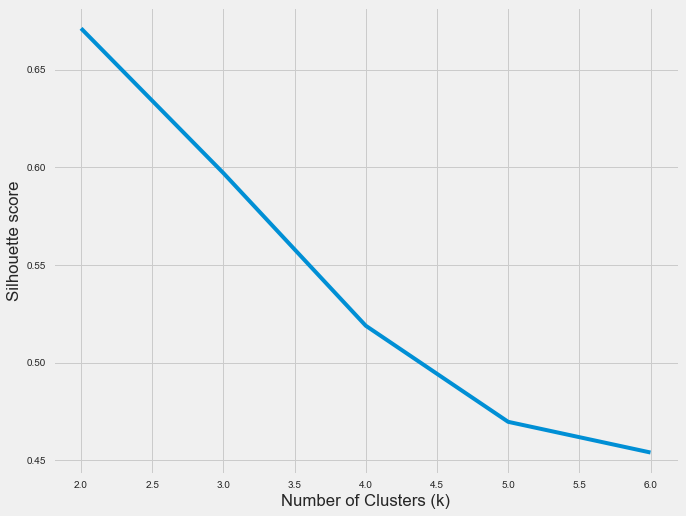

With 2-features combination of: a1_y_max, a2_z_max
for n_clusters = 2 The average silhouette_score is : 0.4661990910998632
for n_clusters = 3 The average silhouette_score is : 0.45195348871859353
for n_clusters = 4 The average silhouette_score is : 0.4545493475908873
for n_clusters = 5 The average silhouette_score is : 0.407211384467229
for n_clusters = 6 The average silhouette_score is : 0.39059147038632736


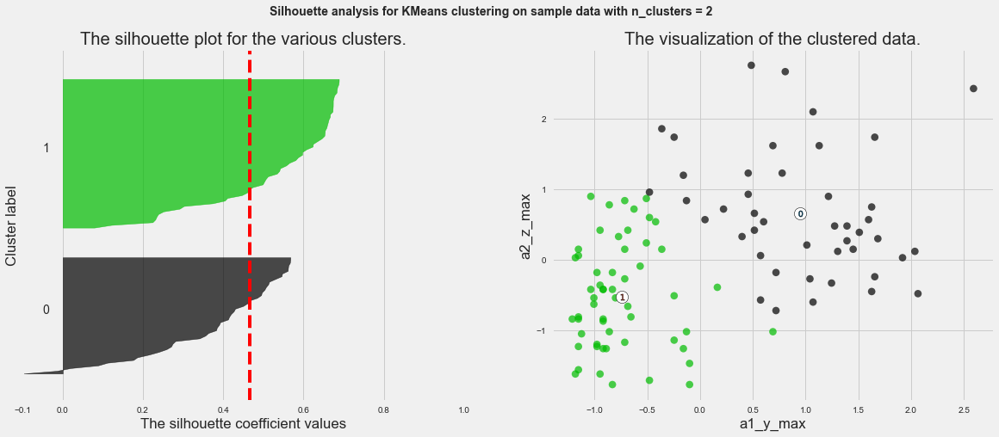

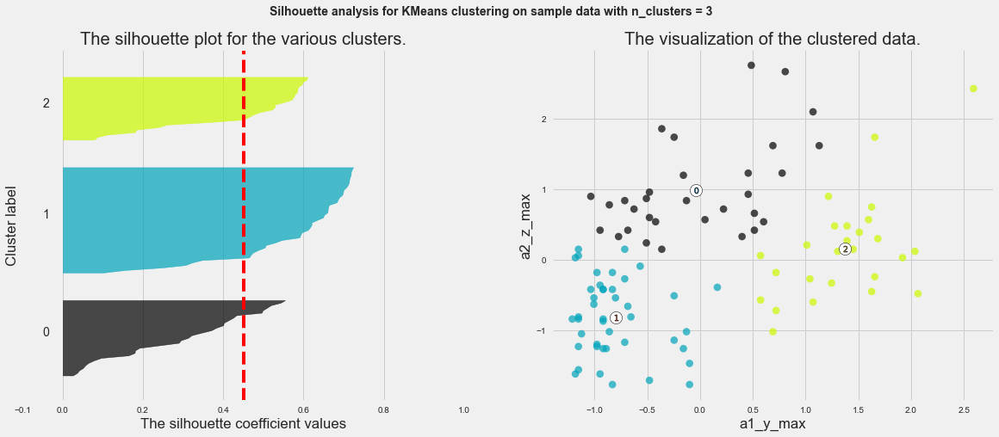

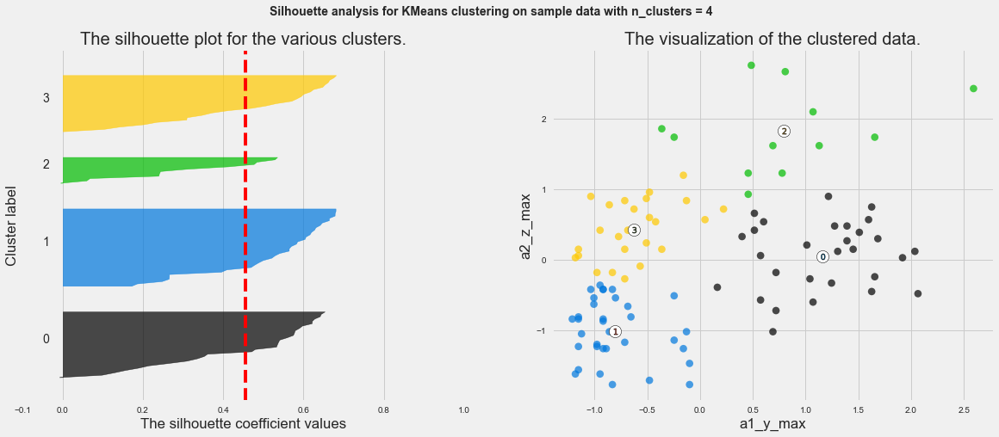

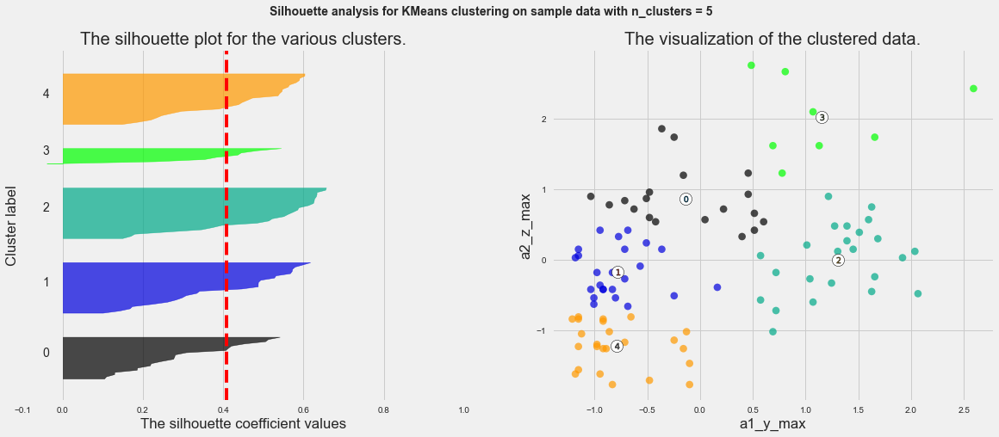

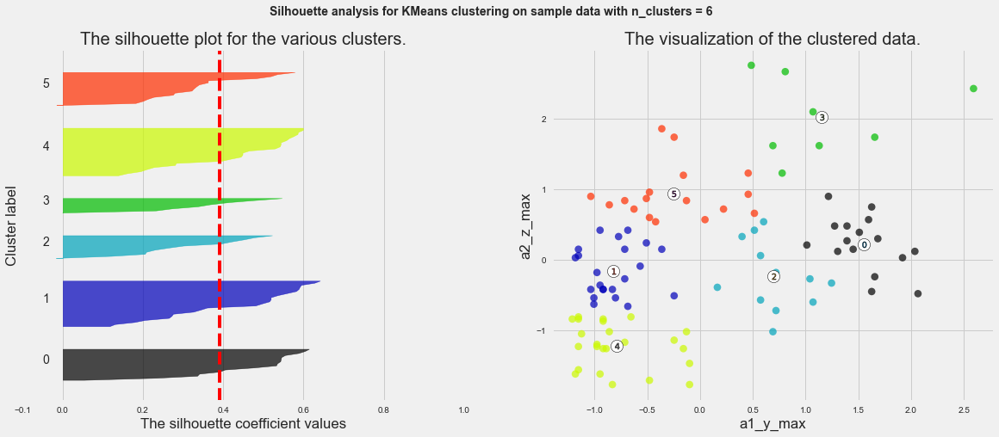

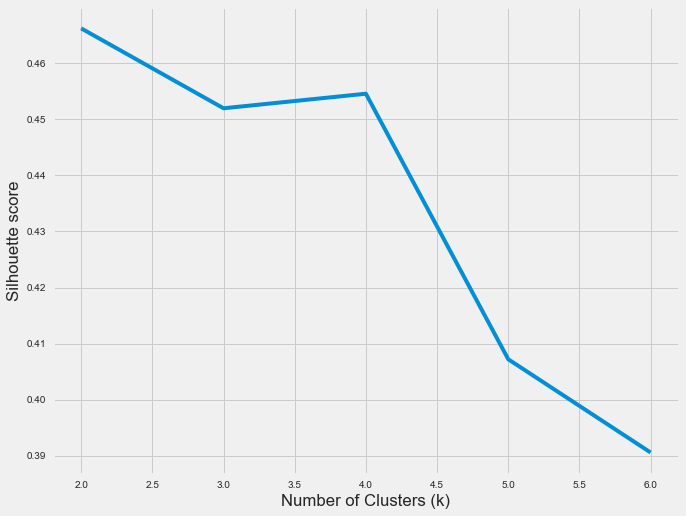

With 2-features combination of: a1_y_max, hert_max
for n_clusters = 2 The average silhouette_score is : 0.5402952183672316
for n_clusters = 3 The average silhouette_score is : 0.6212865490273828
for n_clusters = 4 The average silhouette_score is : 0.6740967753614772
for n_clusters = 5 The average silhouette_score is : 0.691859377418933
for n_clusters = 6 The average silhouette_score is : 0.6447614549242421


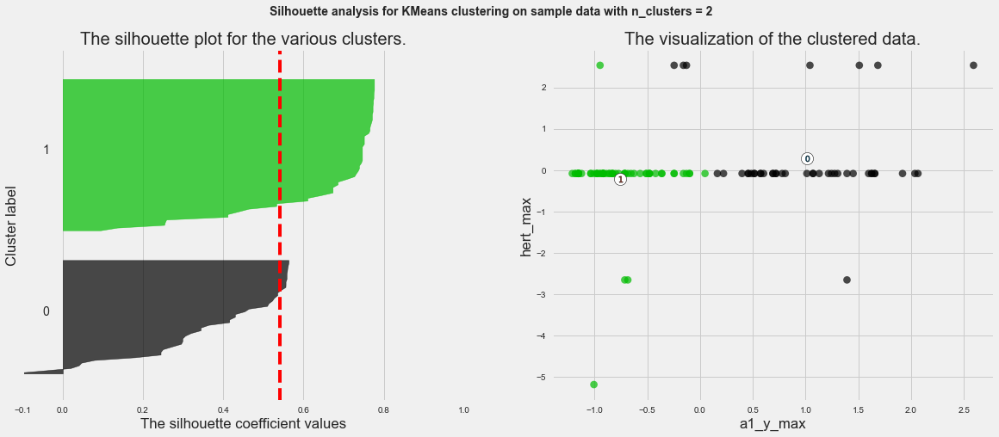

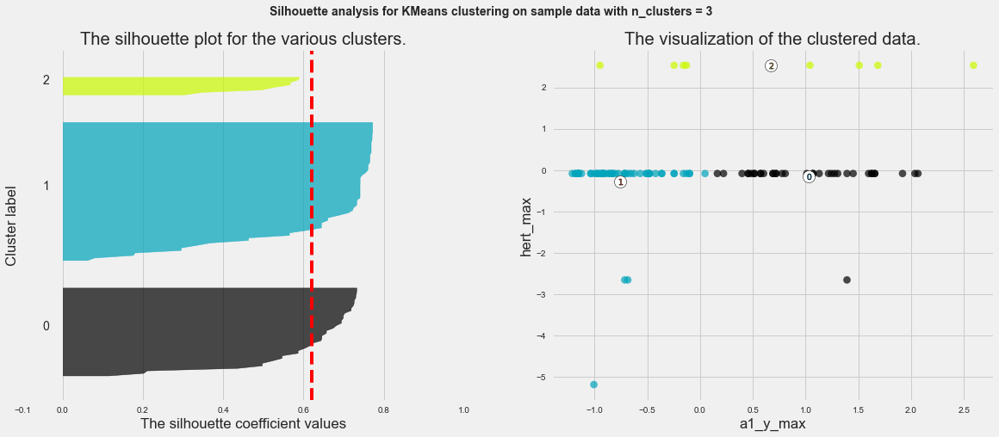

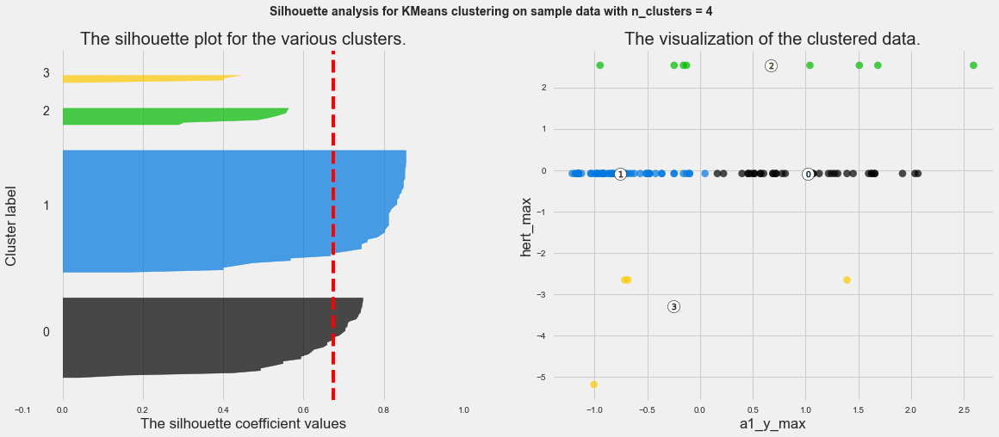

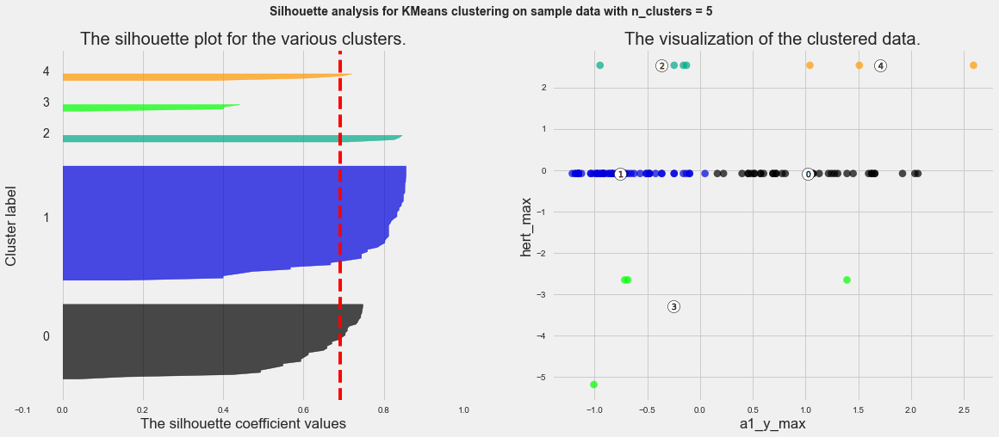

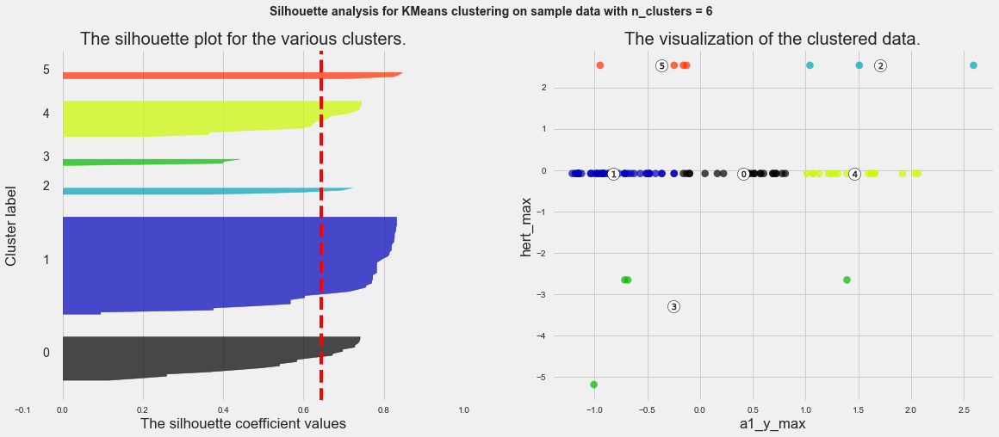

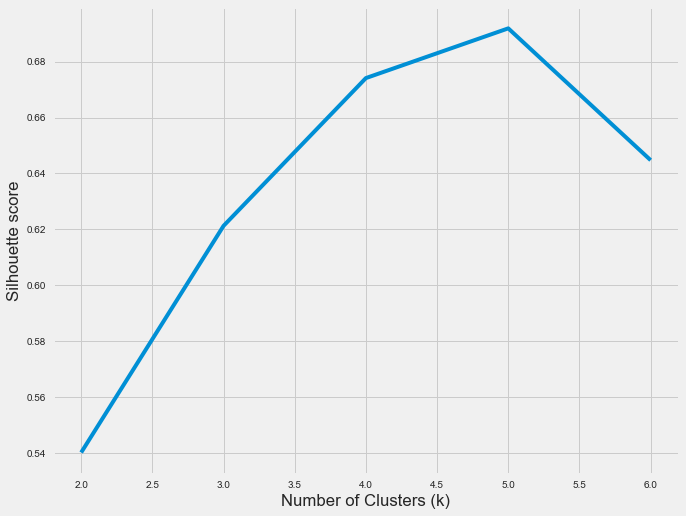

With 2-features combination of: a1_y_max, w_max
for n_clusters = 2 The average silhouette_score is : 0.49373454385837917
for n_clusters = 3 The average silhouette_score is : 0.5790865049030396
for n_clusters = 4 The average silhouette_score is : 0.5842247320402513
for n_clusters = 5 The average silhouette_score is : 0.5694639682075917
for n_clusters = 6 The average silhouette_score is : 0.539013991933459


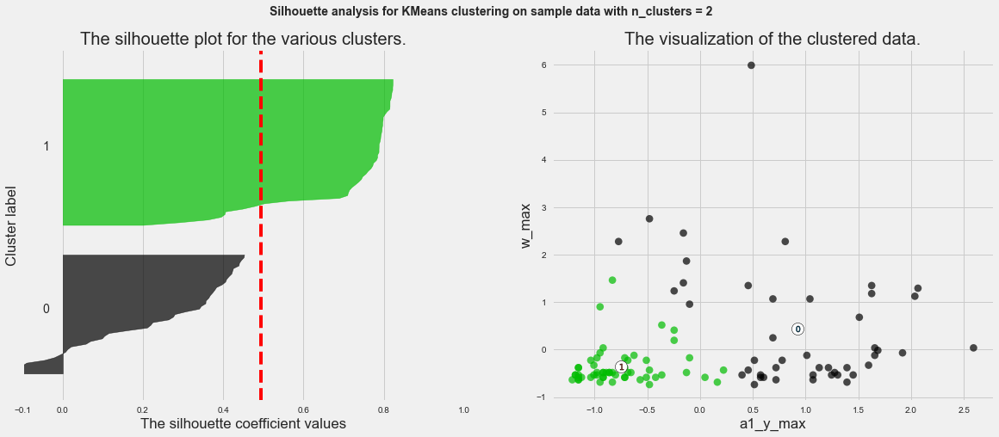

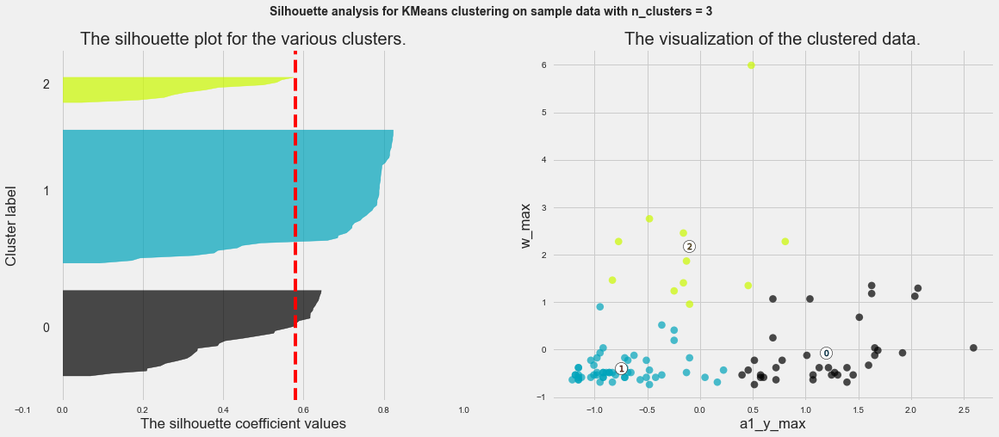

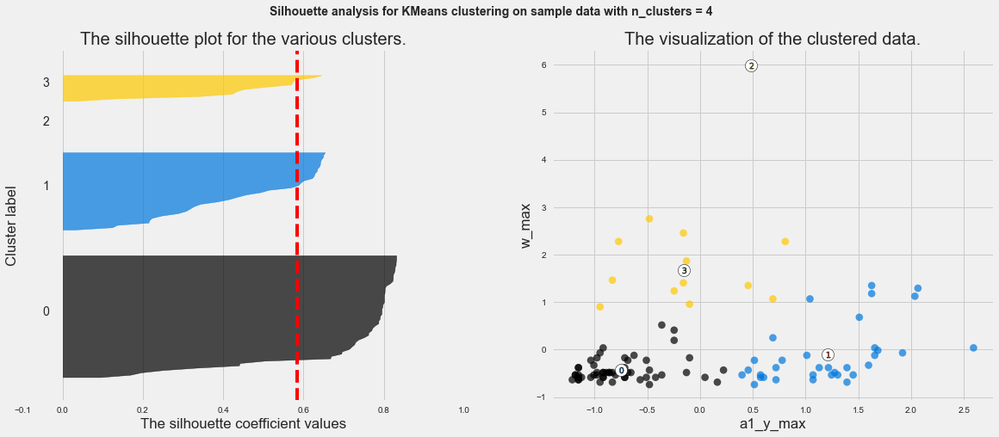

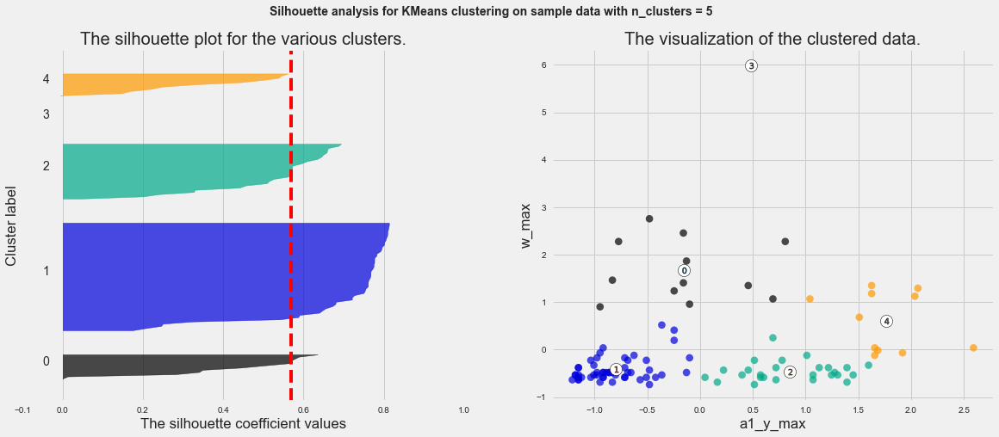

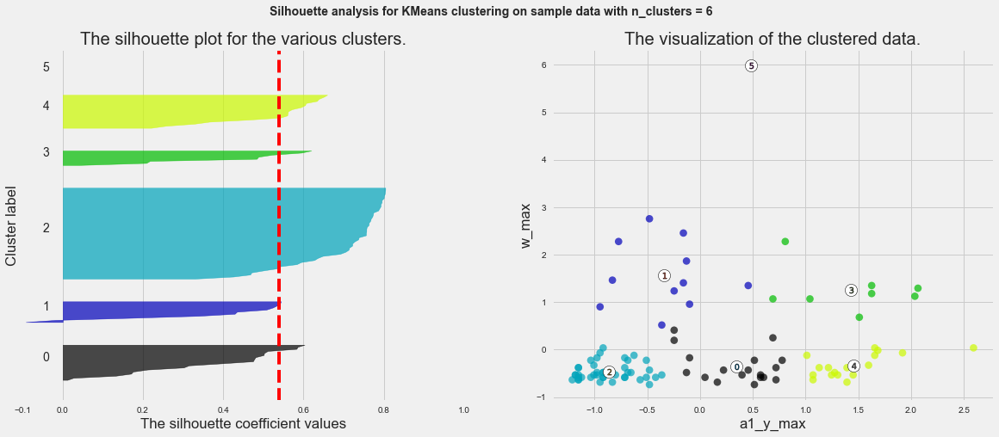

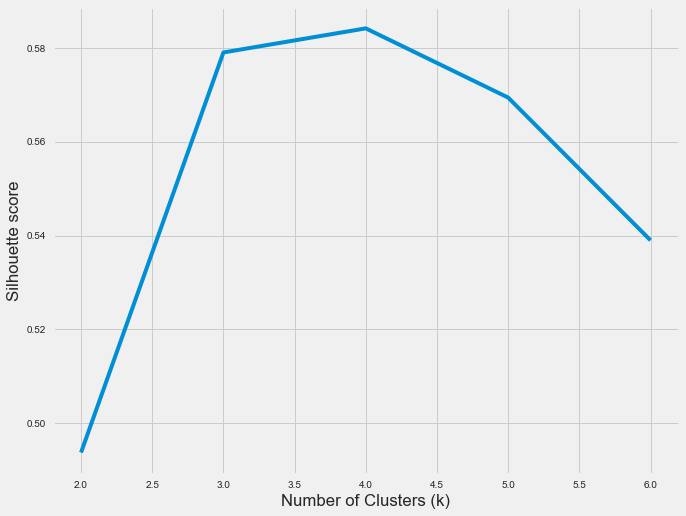

With 2-features combination of: a1_z_max, a2_x_max
for n_clusters = 2 The average silhouette_score is : 0.5123749542000792
for n_clusters = 3 The average silhouette_score is : 0.530914114636865
for n_clusters = 4 The average silhouette_score is : 0.43068119744054273
for n_clusters = 5 The average silhouette_score is : 0.4139863068806259
for n_clusters = 6 The average silhouette_score is : 0.3523010097898775


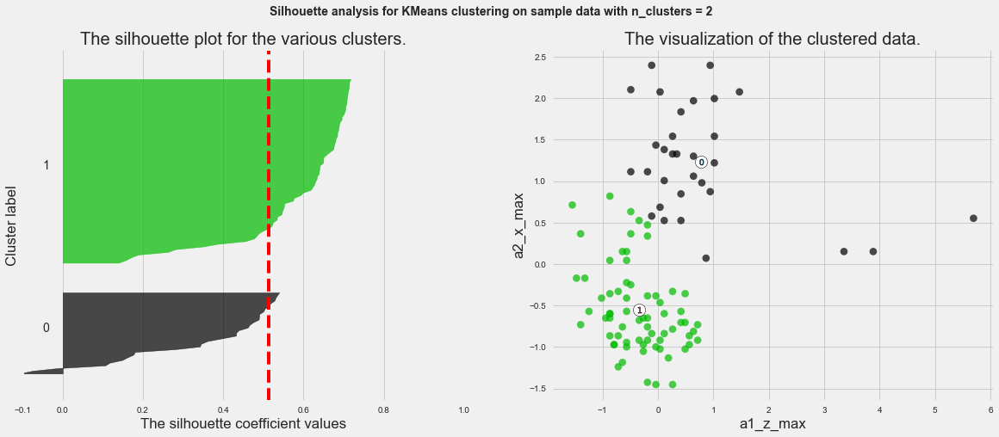

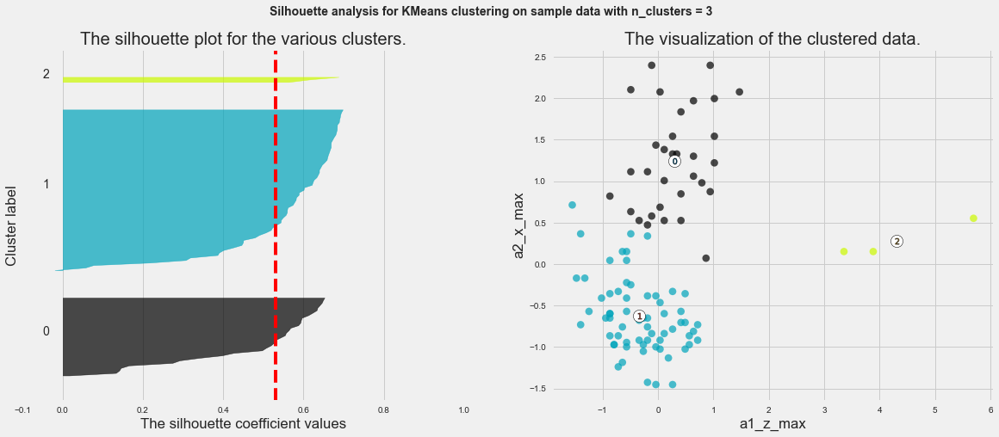

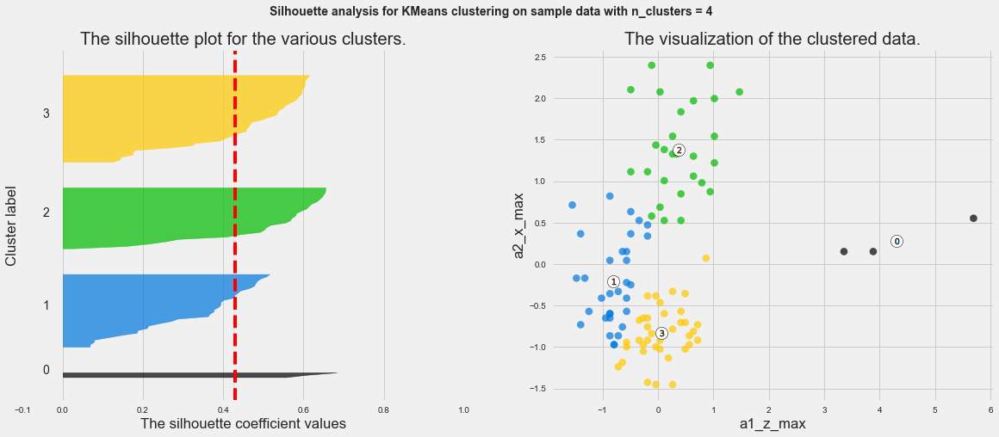

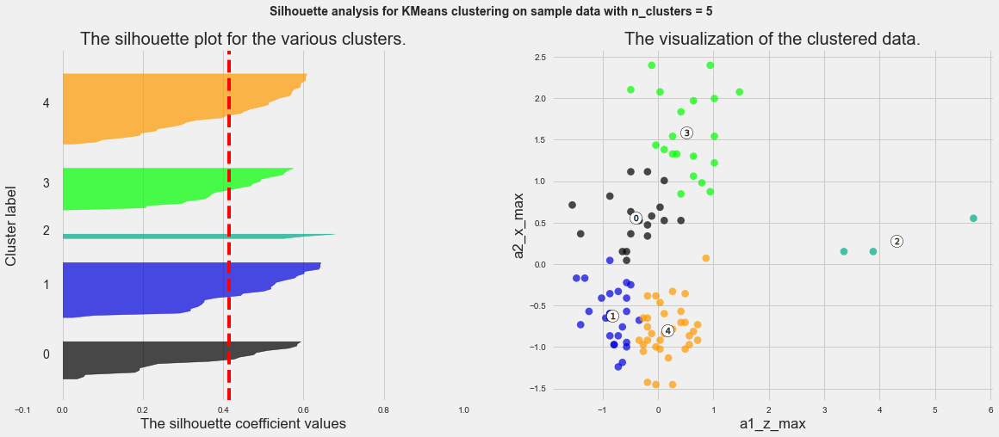

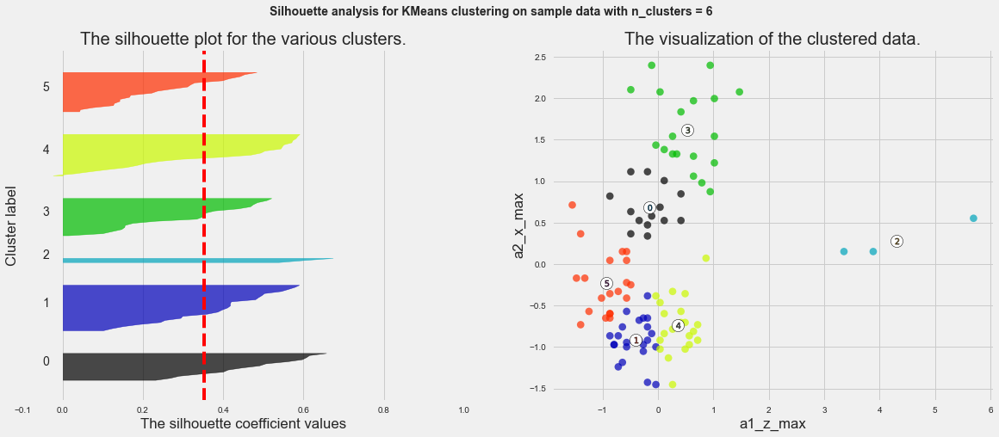

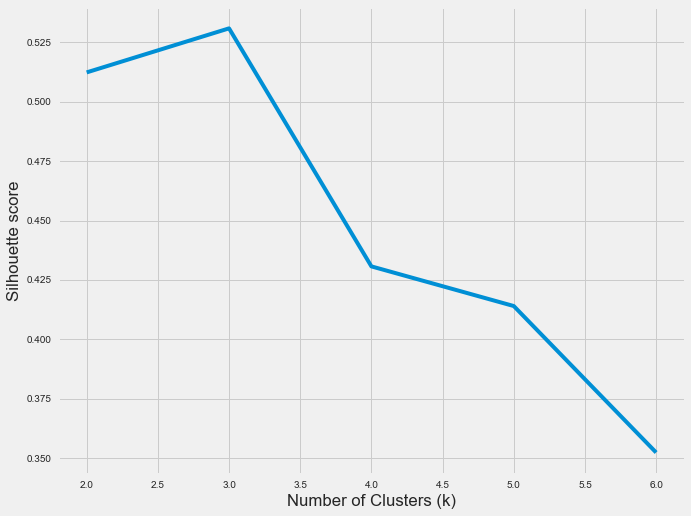

With 2-features combination of: a1_z_max, a2_y_max
for n_clusters = 2 The average silhouette_score is : 0.5087476583661663
for n_clusters = 3 The average silhouette_score is : 0.5372173709740337
for n_clusters = 4 The average silhouette_score is : 0.4570981020699356
for n_clusters = 5 The average silhouette_score is : 0.4346953292291289
for n_clusters = 6 The average silhouette_score is : 0.4163066230604816


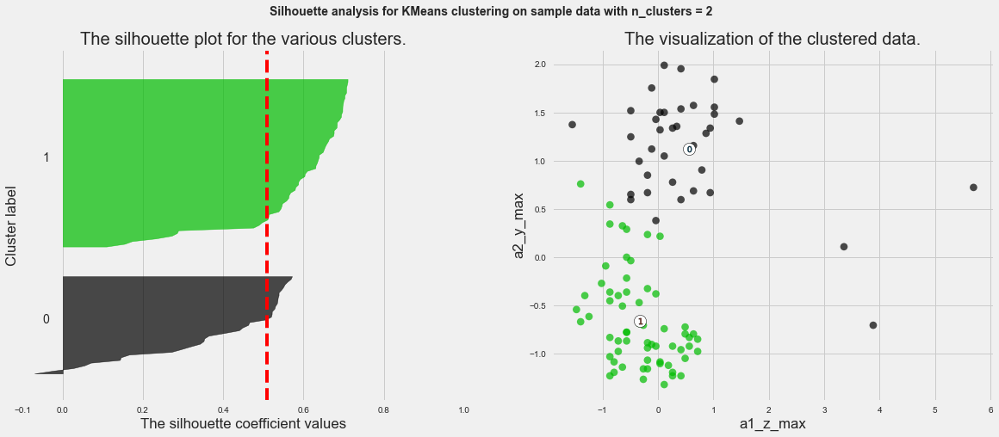

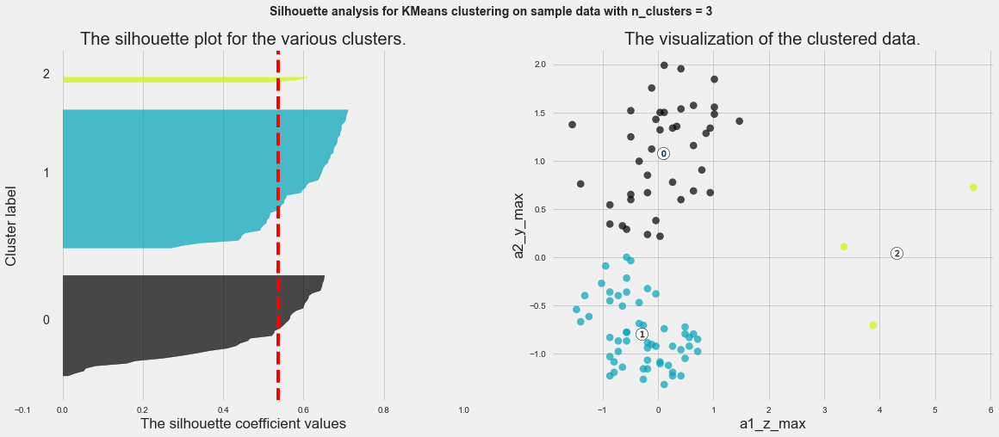

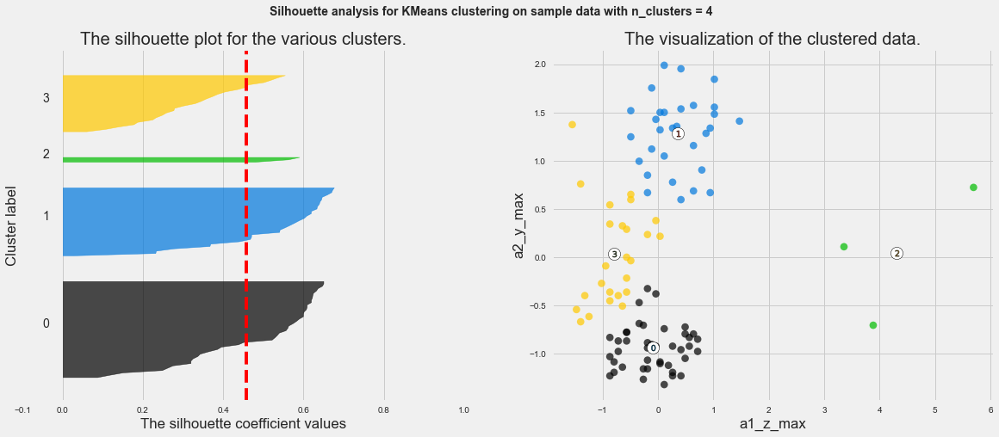

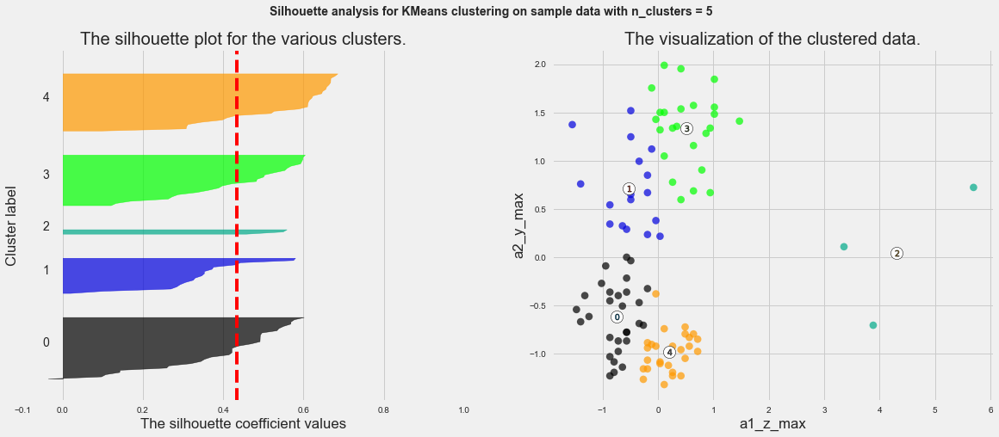

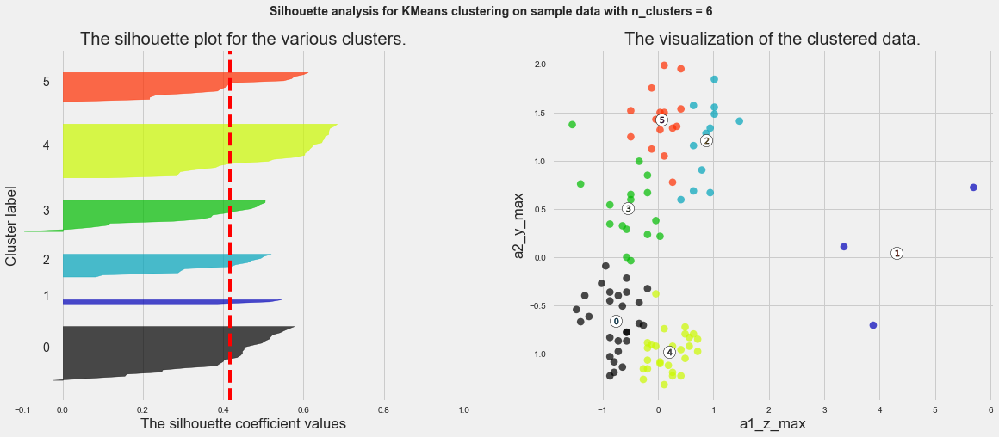

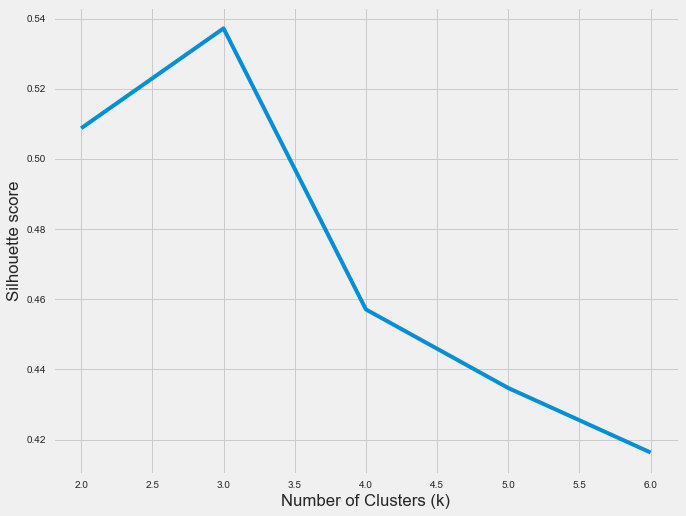

With 2-features combination of: a1_z_max, a2_z_max
for n_clusters = 2 The average silhouette_score is : 0.3774166461629819
for n_clusters = 3 The average silhouette_score is : 0.4225316842838862
for n_clusters = 4 The average silhouette_score is : 0.4103751068424426
for n_clusters = 5 The average silhouette_score is : 0.37460401303724916
for n_clusters = 6 The average silhouette_score is : 0.4007840541484777


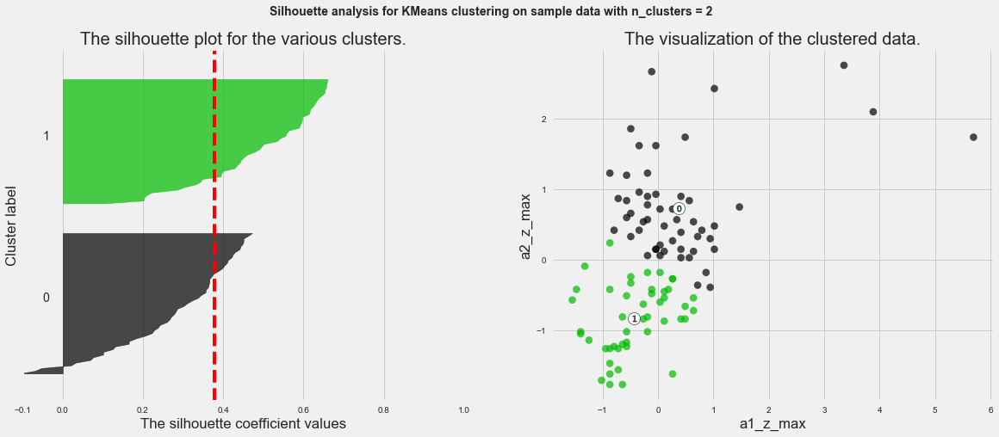

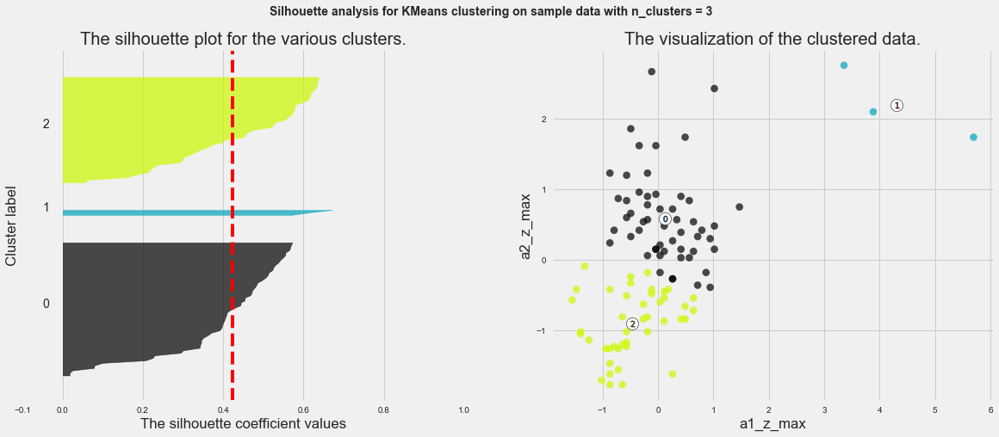

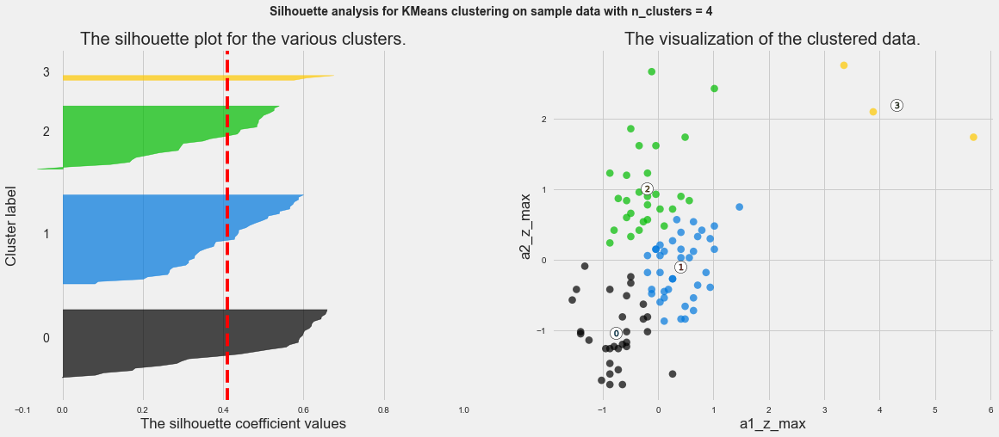

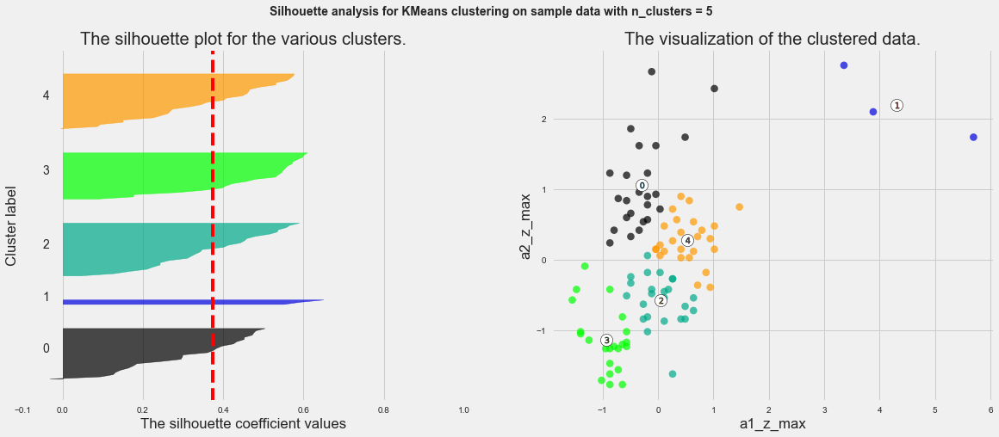

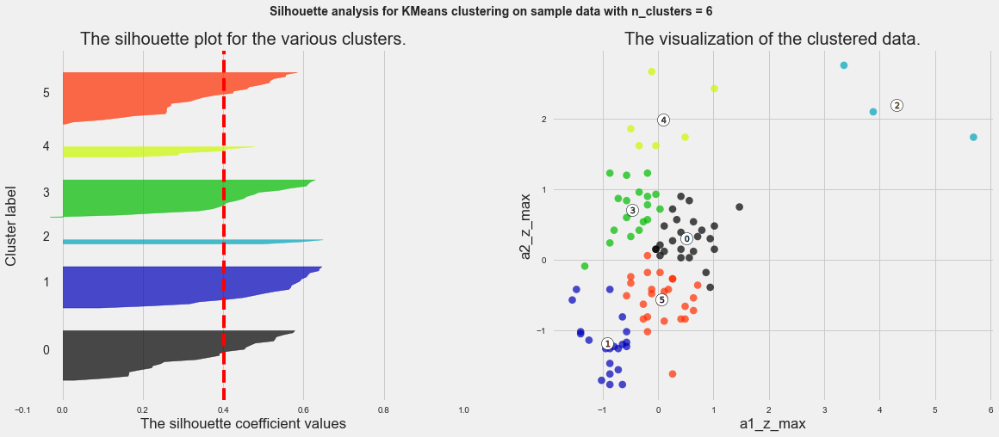

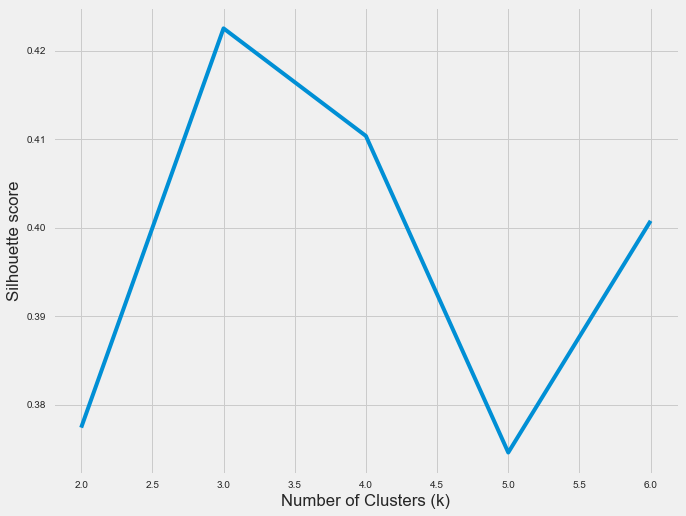

With 2-features combination of: a1_z_max, hert_max
for n_clusters = 2 The average silhouette_score is : 0.6697546599750946
for n_clusters = 3 The average silhouette_score is : 0.6849772743086541
for n_clusters = 4 The average silhouette_score is : 0.7267730750502794
for n_clusters = 5 The average silhouette_score is : 0.5674786701397263
for n_clusters = 6 The average silhouette_score is : 0.5849864936319514


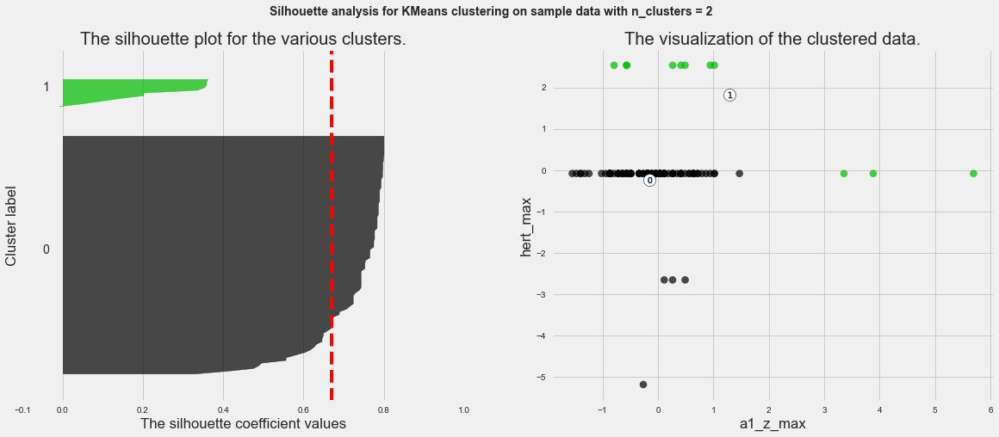

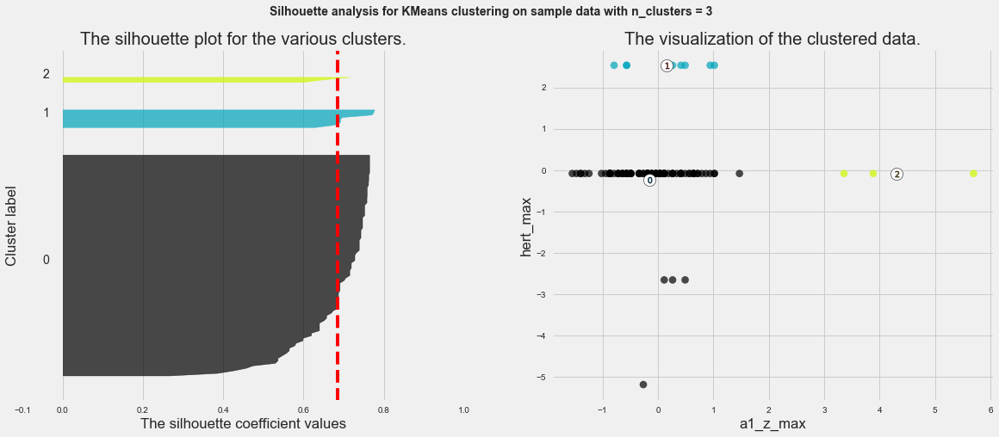

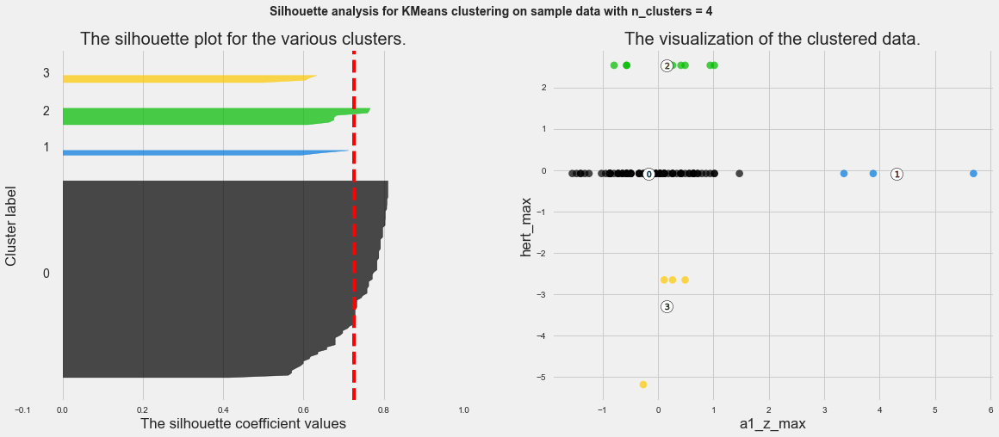

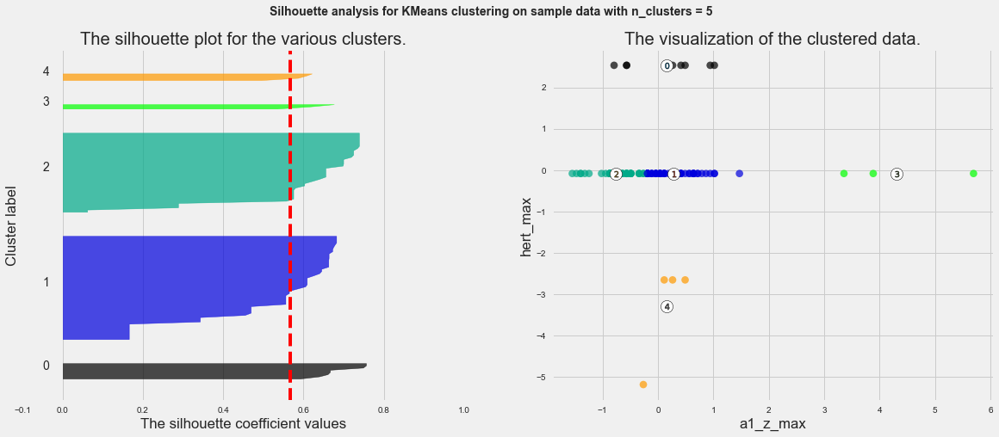

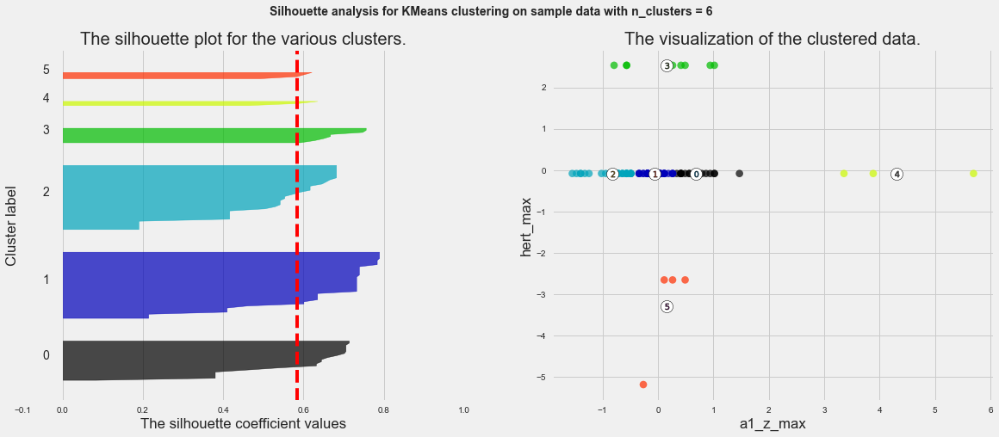

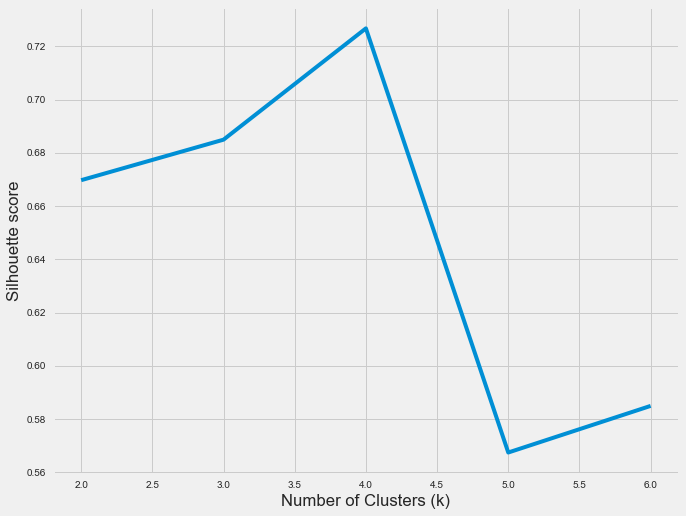

With 2-features combination of: a1_z_max, w_max
for n_clusters = 2 The average silhouette_score is : 0.5512914830386747
for n_clusters = 3 The average silhouette_score is : 0.5486452962878594
for n_clusters = 4 The average silhouette_score is : 0.5596183982774349
for n_clusters = 5 The average silhouette_score is : 0.4269783159949319
for n_clusters = 6 The average silhouette_score is : 0.4310706607118739


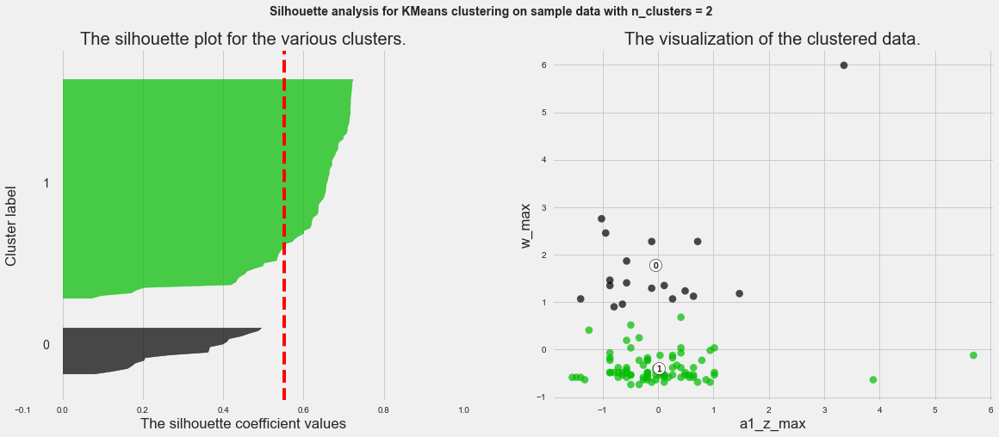

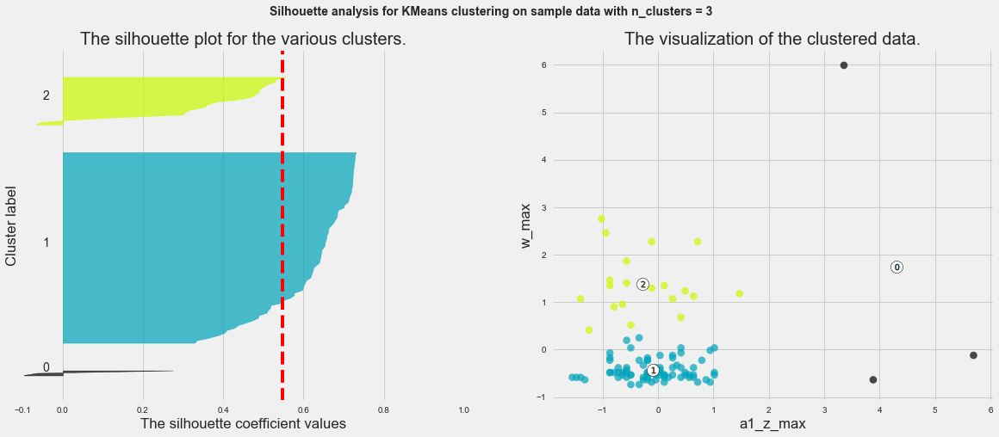

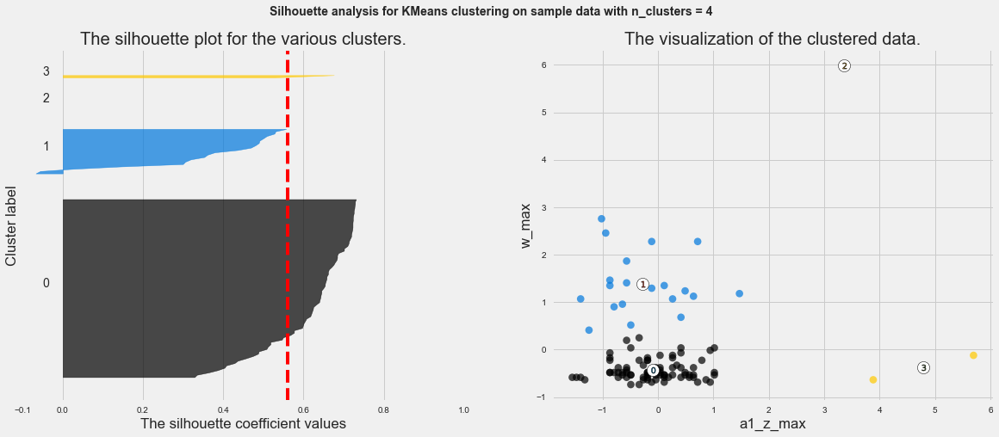

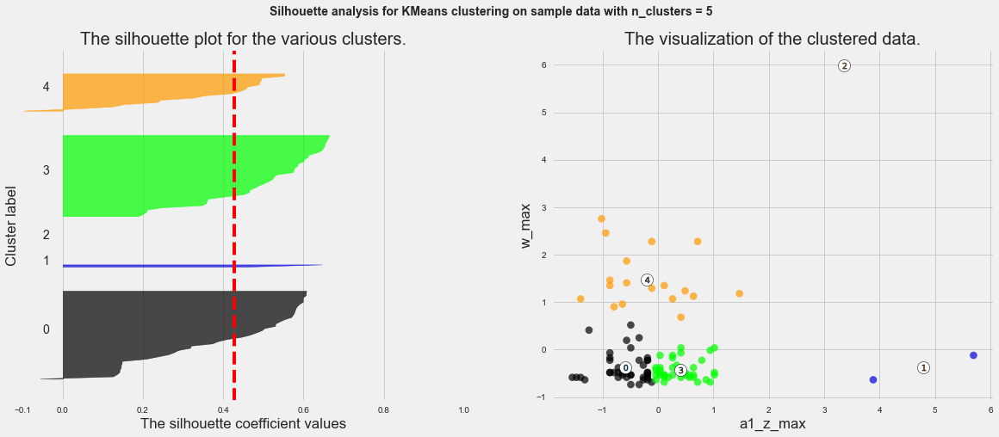

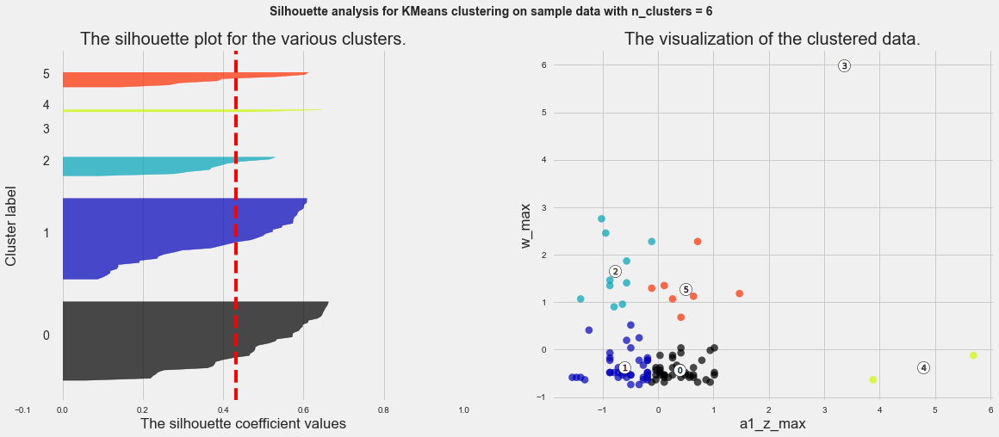

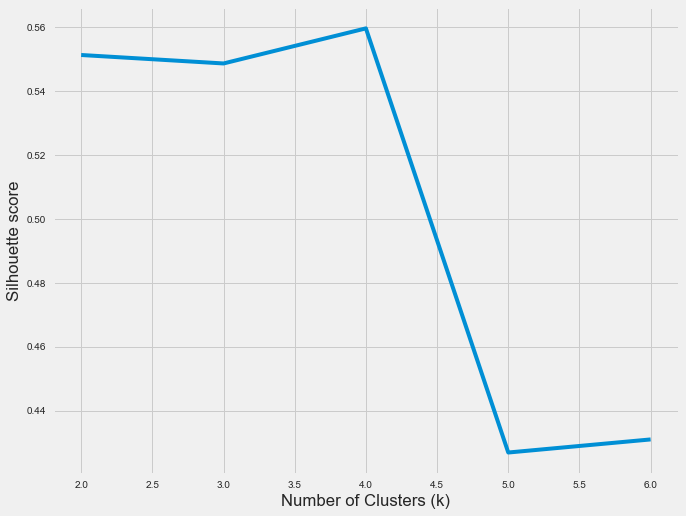

With 2-features combination of: a2_x_max, a2_y_max
for n_clusters = 2 The average silhouette_score is : 0.6663566954206039
for n_clusters = 3 The average silhouette_score is : 0.577017394702234
for n_clusters = 4 The average silhouette_score is : 0.4989639054795102
for n_clusters = 5 The average silhouette_score is : 0.466747427407268
for n_clusters = 6 The average silhouette_score is : 0.4351711489246011


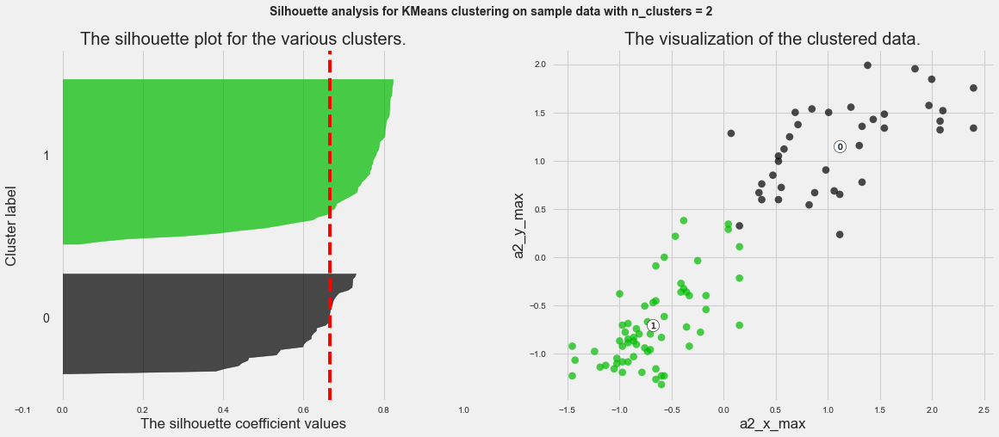

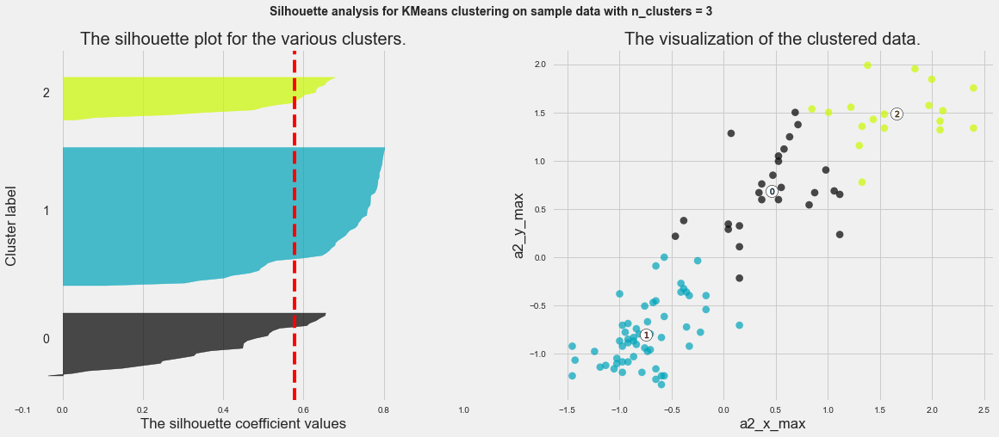

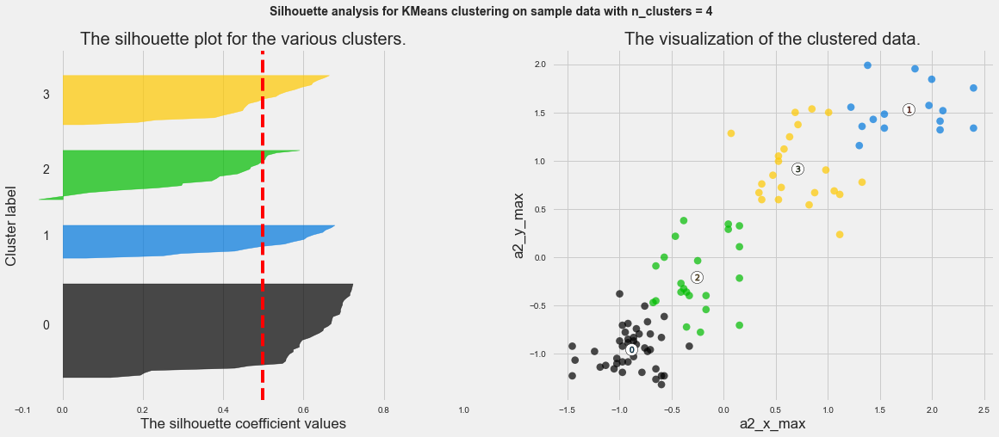

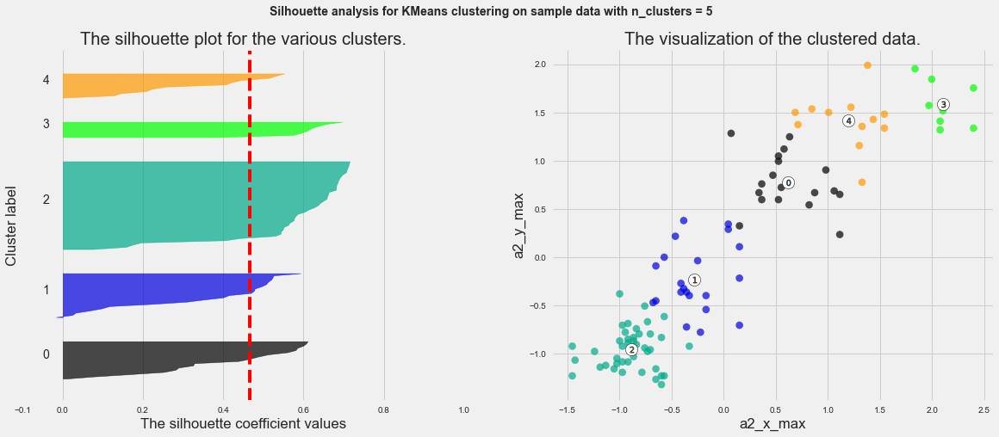

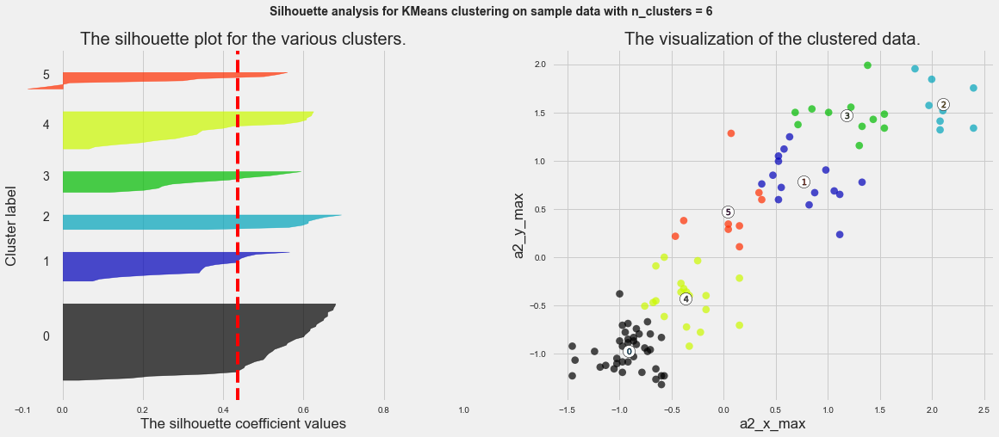

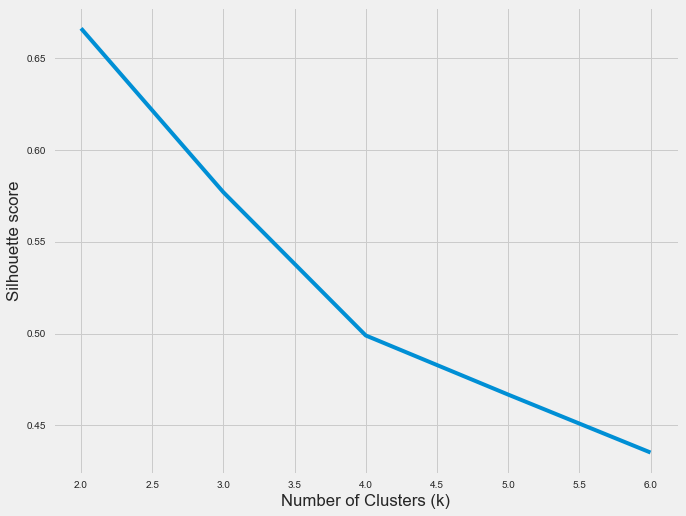

With 2-features combination of: a2_x_max, a2_z_max
for n_clusters = 2 The average silhouette_score is : 0.44074825090948394
for n_clusters = 3 The average silhouette_score is : 0.4624992707171046
for n_clusters = 4 The average silhouette_score is : 0.454755671242687
for n_clusters = 5 The average silhouette_score is : 0.44388440893943987
for n_clusters = 6 The average silhouette_score is : 0.3819257564315173


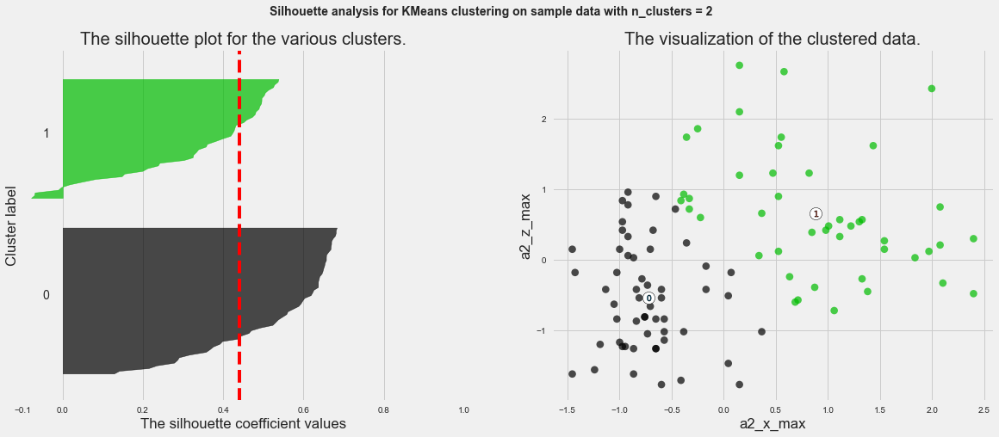

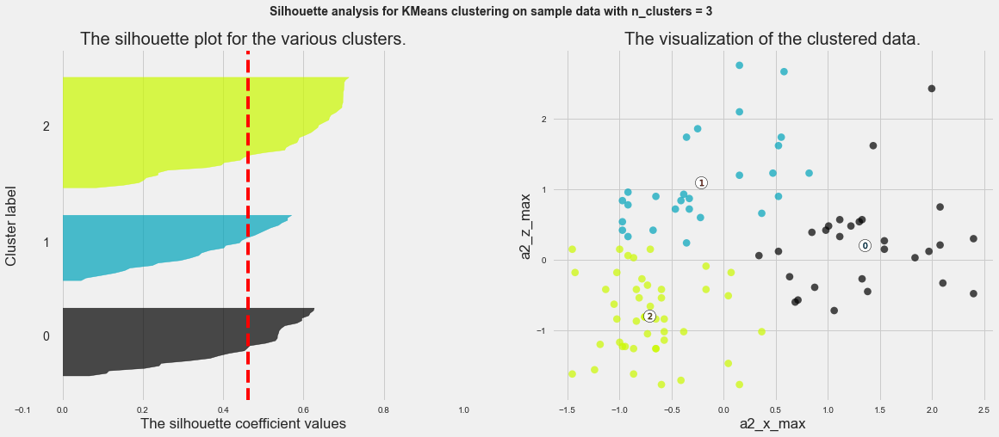

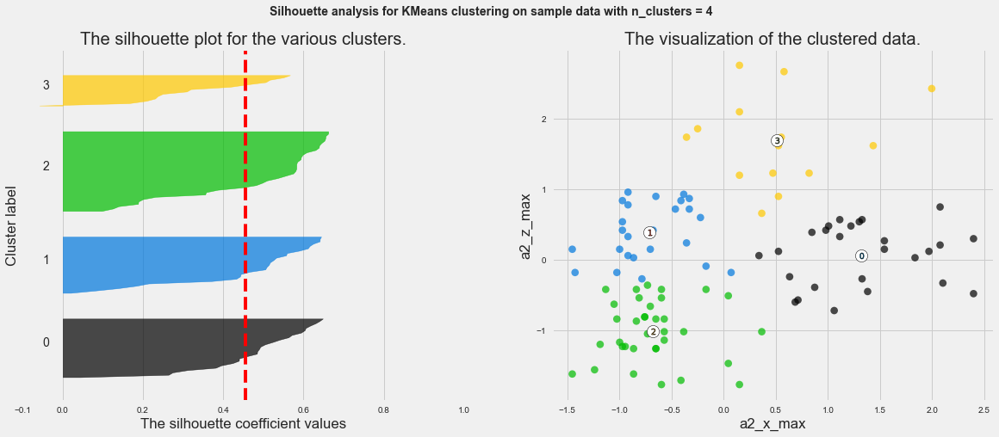

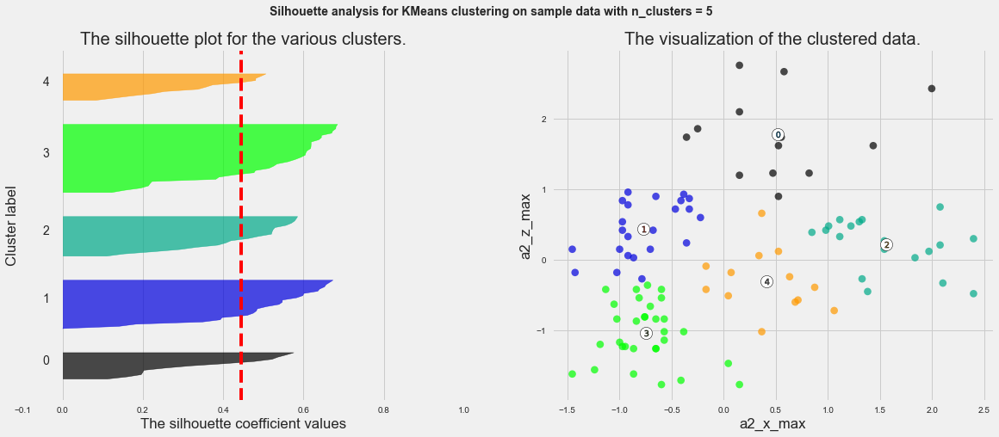

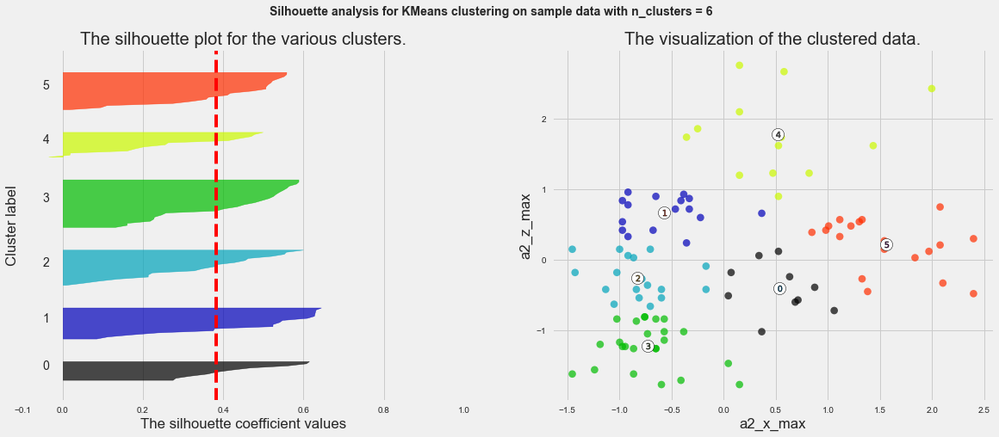

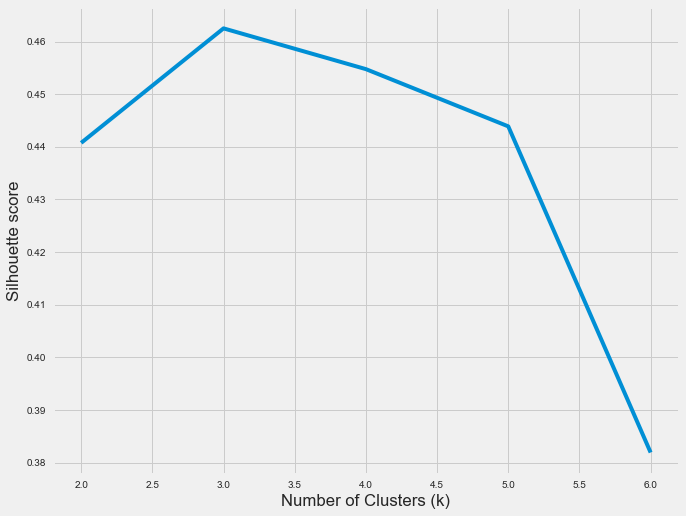

With 2-features combination of: a2_x_max, hert_max
for n_clusters = 2 The average silhouette_score is : 0.5128138688720775
for n_clusters = 3 The average silhouette_score is : 0.5834171141701762
for n_clusters = 4 The average silhouette_score is : 0.6374364300695557
for n_clusters = 5 The average silhouette_score is : 0.6049120457845681
for n_clusters = 6 The average silhouette_score is : 0.610398192701346


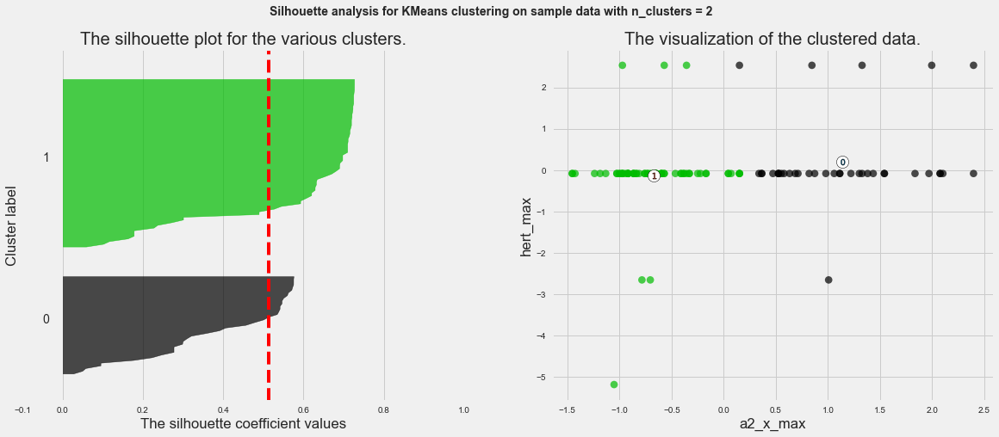

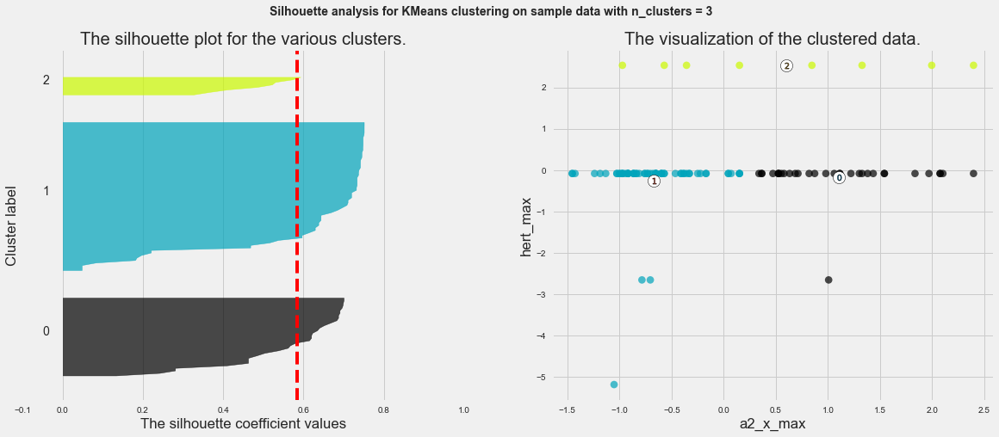

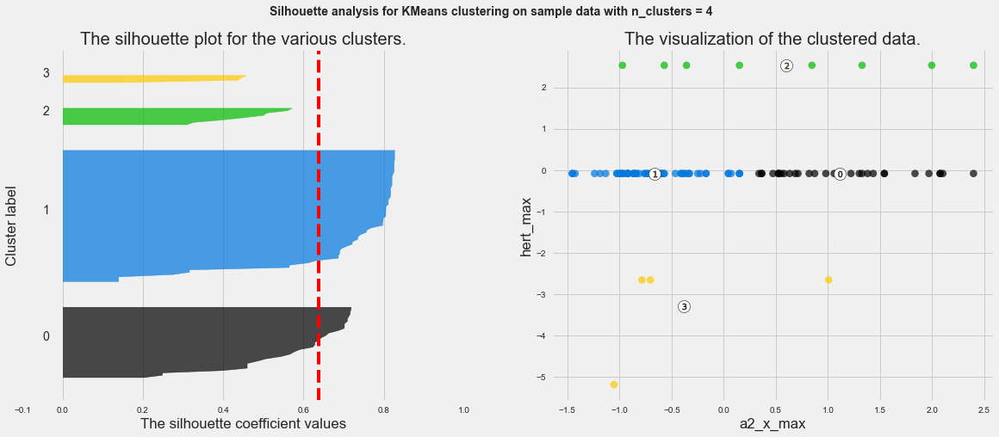

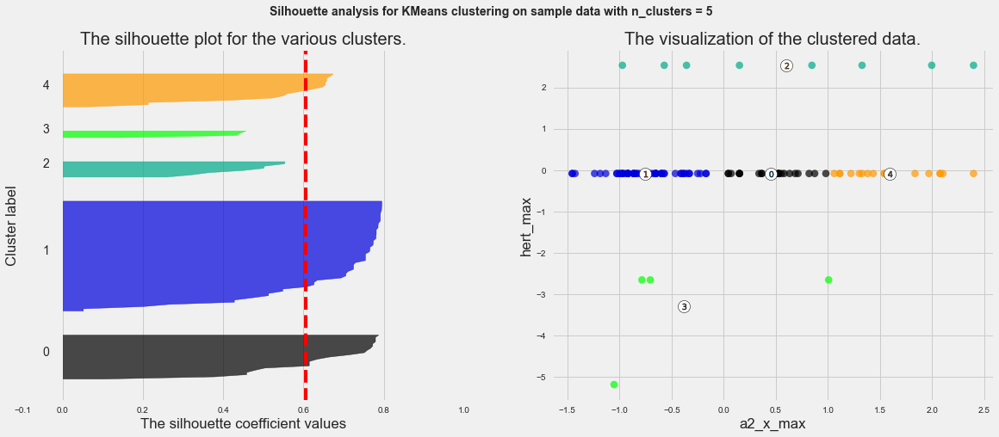

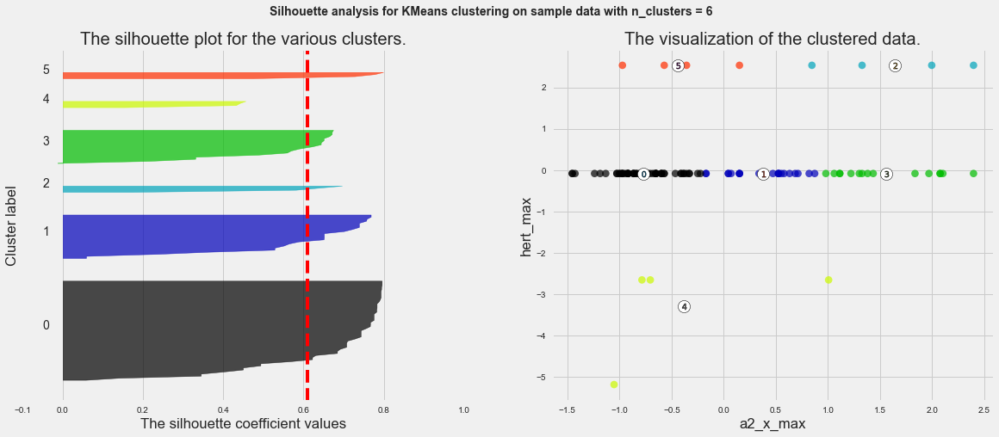

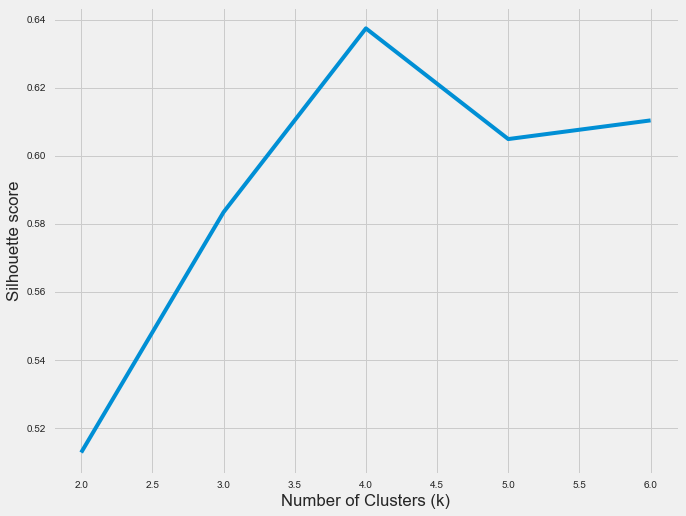

With 2-features combination of: a2_x_max, w_max
for n_clusters = 2 The average silhouette_score is : 0.4724386664050467
for n_clusters = 3 The average silhouette_score is : 0.5583890575872732
for n_clusters = 4 The average silhouette_score is : 0.5613155447636025
for n_clusters = 5 The average silhouette_score is : 0.5435037149013191
for n_clusters = 6 The average silhouette_score is : 0.48826122903561514


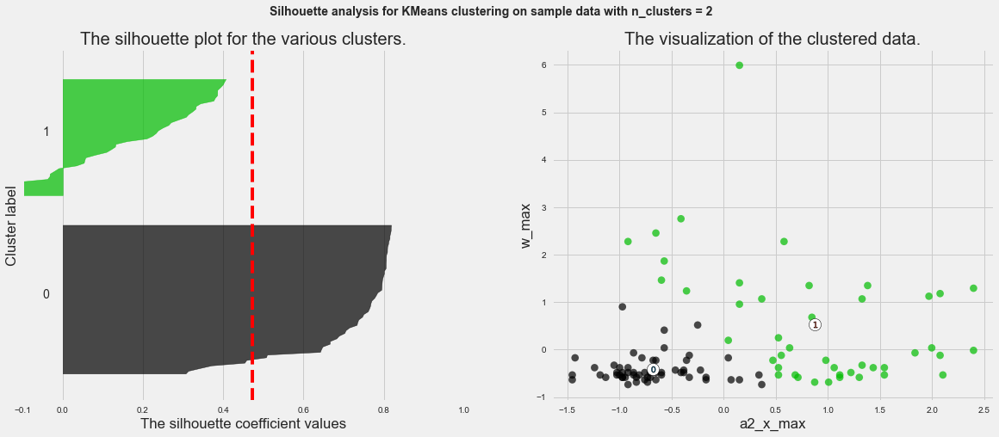

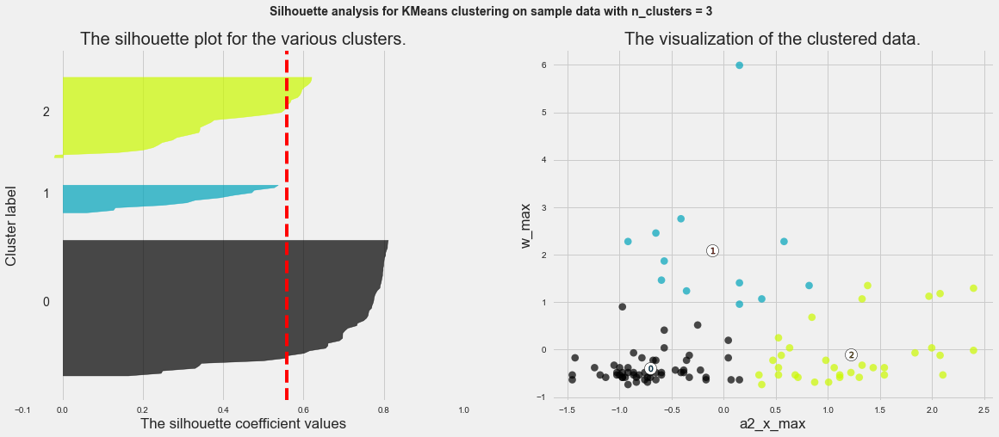

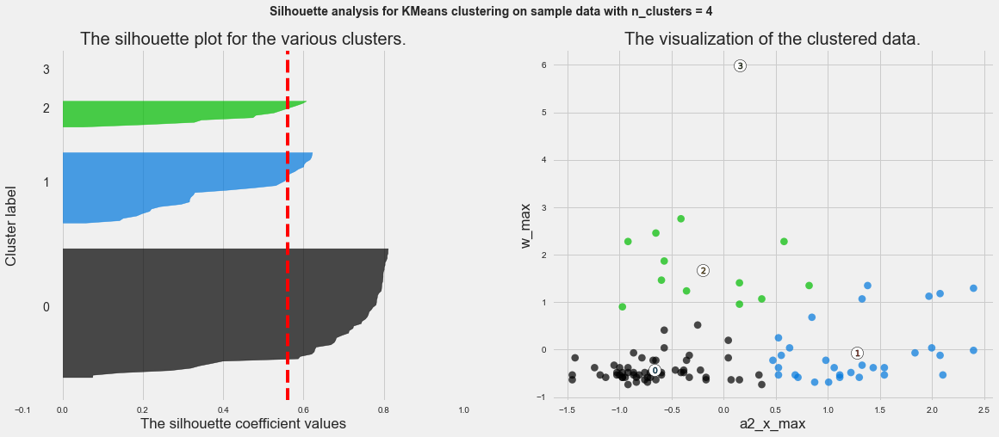

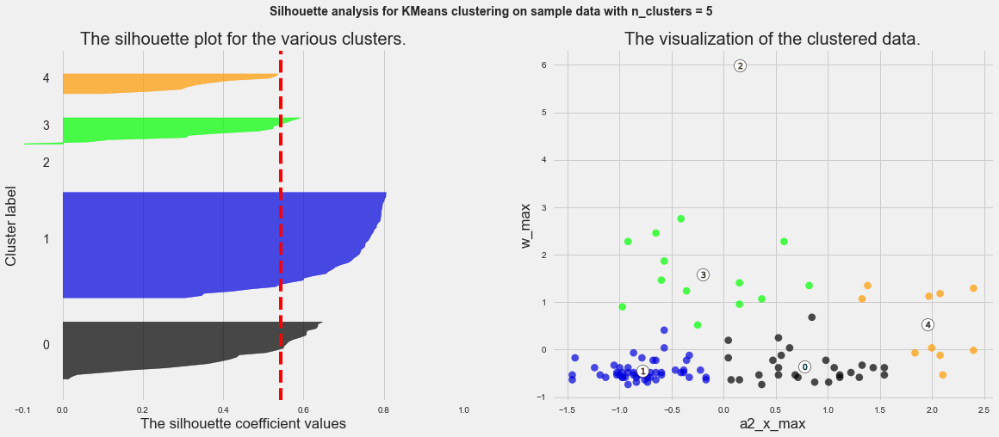

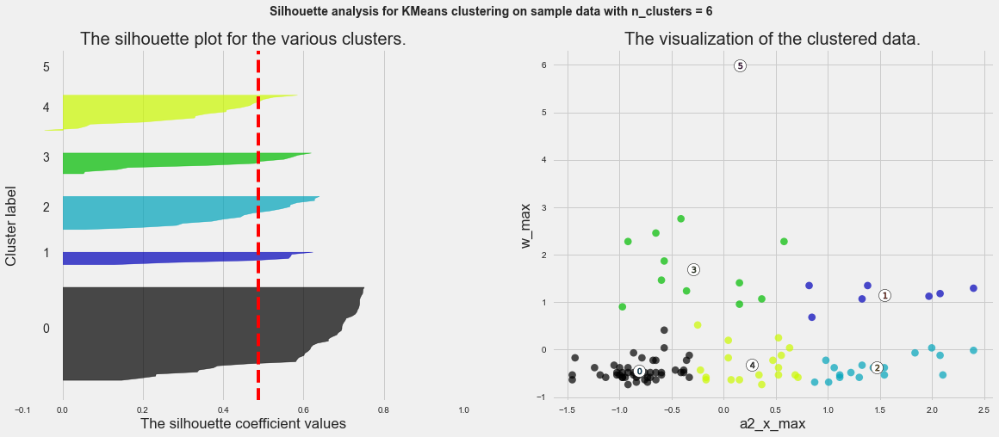

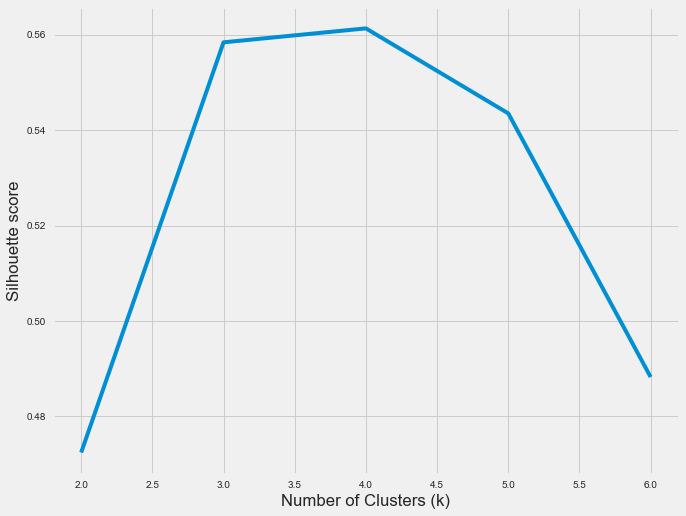

With 2-features combination of: a2_y_max, a2_z_max
for n_clusters = 2 The average silhouette_score is : 0.45951270231878655
for n_clusters = 3 The average silhouette_score is : 0.45960358077972285
for n_clusters = 4 The average silhouette_score is : 0.46264258145666987
for n_clusters = 5 The average silhouette_score is : 0.4135106317229262
for n_clusters = 6 The average silhouette_score is : 0.393031863264907


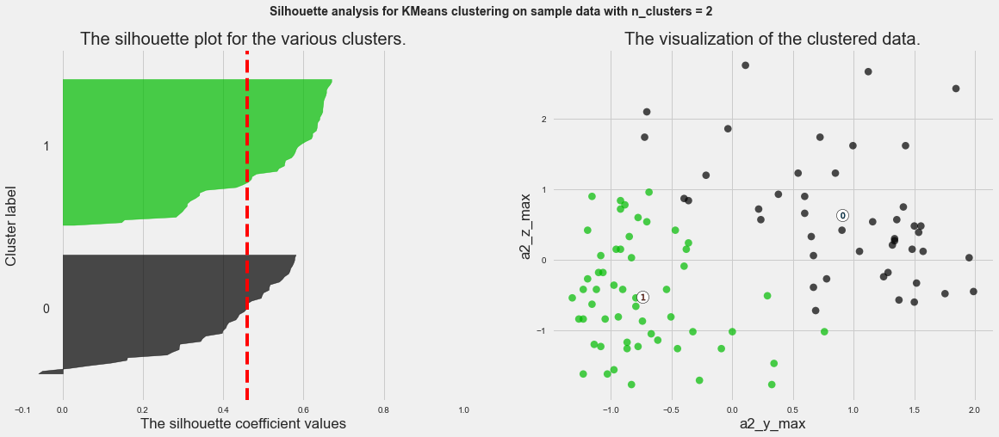

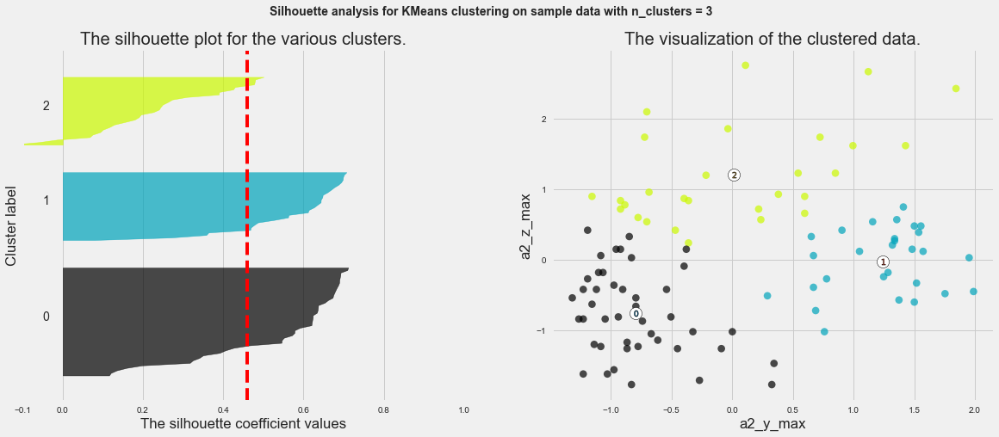

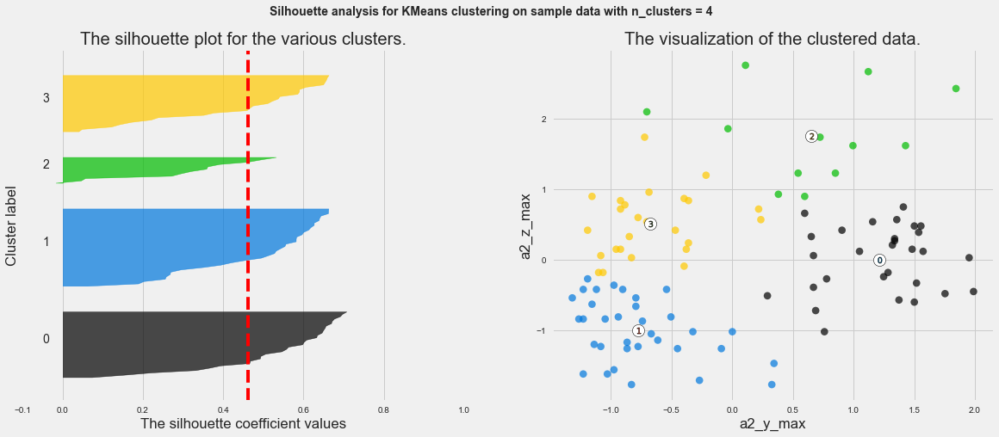

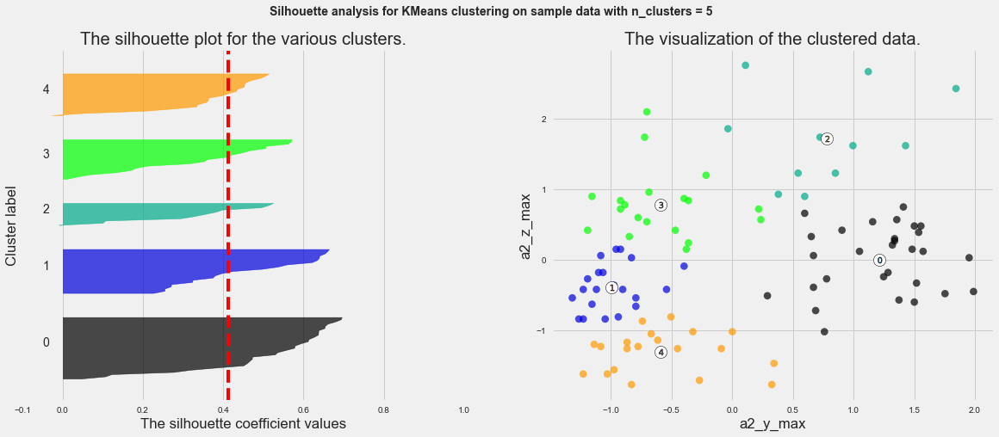

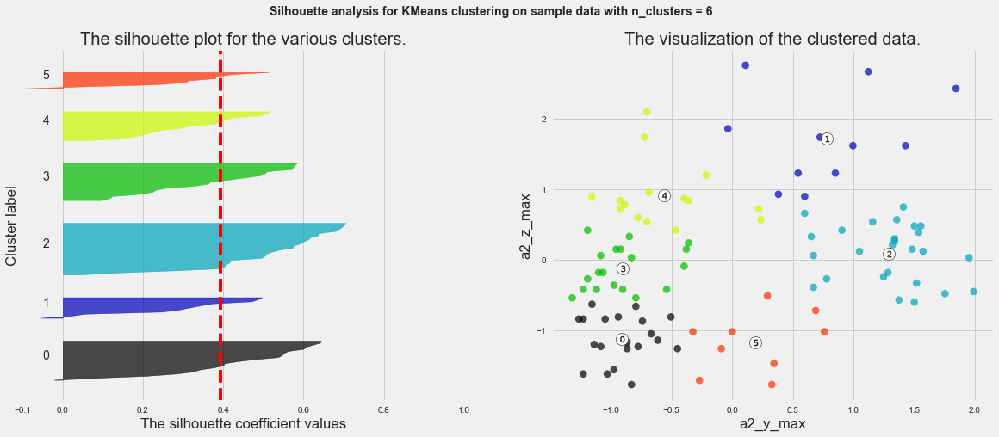

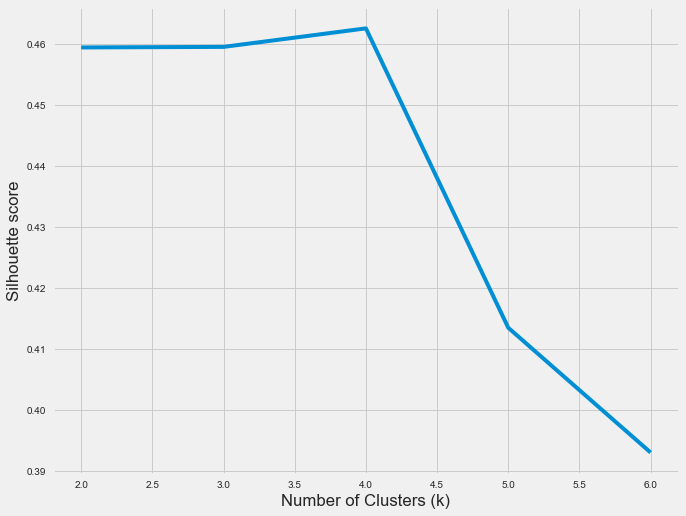

With 2-features combination of: a2_y_max, hert_max
for n_clusters = 2 The average silhouette_score is : 0.5469470521171297
for n_clusters = 3 The average silhouette_score is : 0.6325498812670888
for n_clusters = 4 The average silhouette_score is : 0.6783169185881732
for n_clusters = 5 The average silhouette_score is : 0.6293920146457329
for n_clusters = 6 The average silhouette_score is : 0.6417147530720766


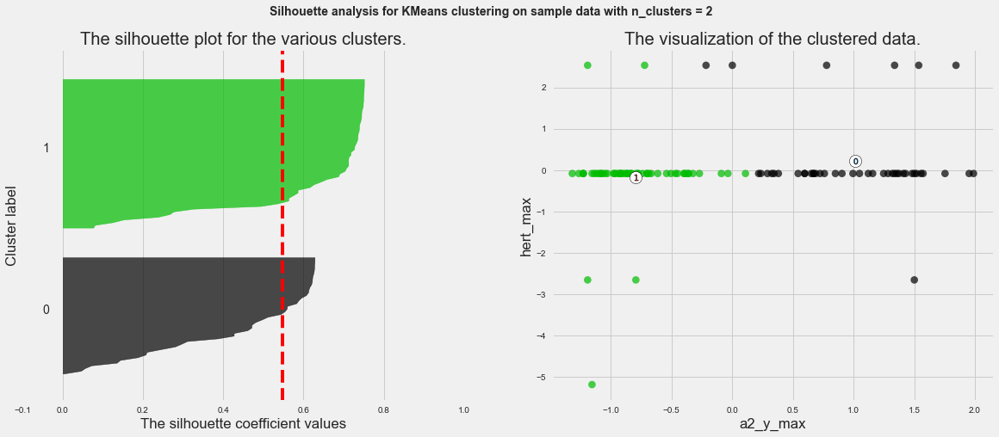

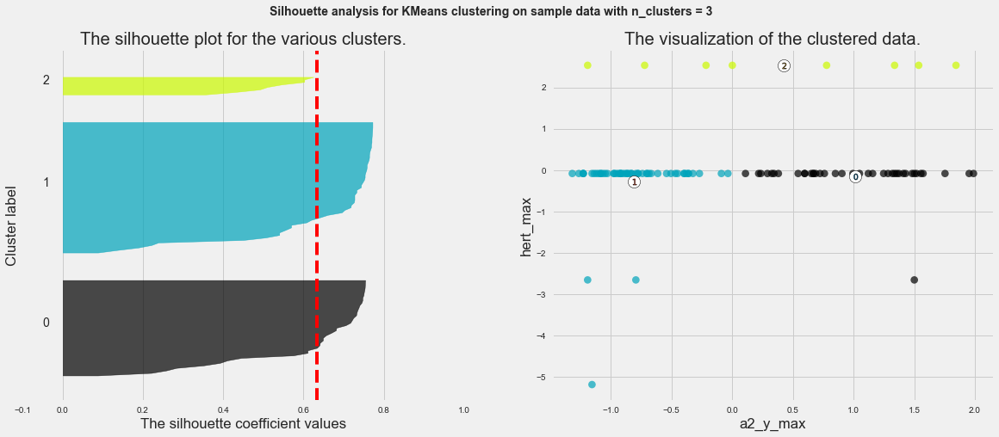

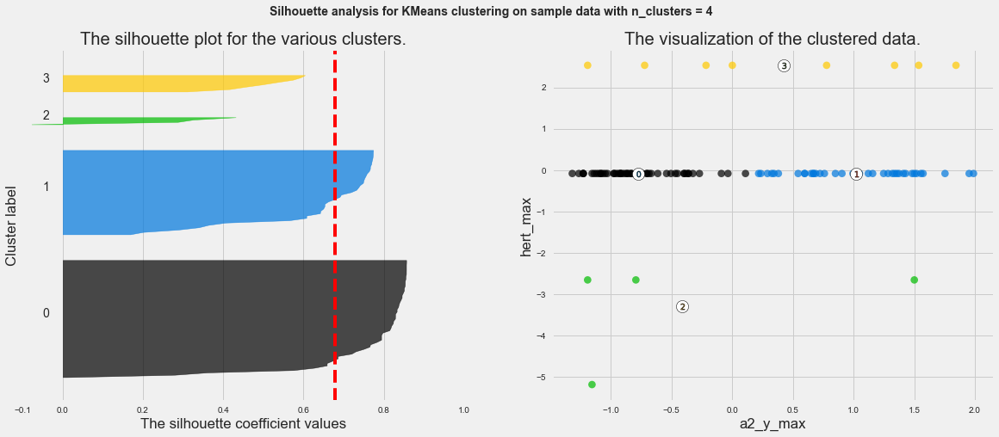

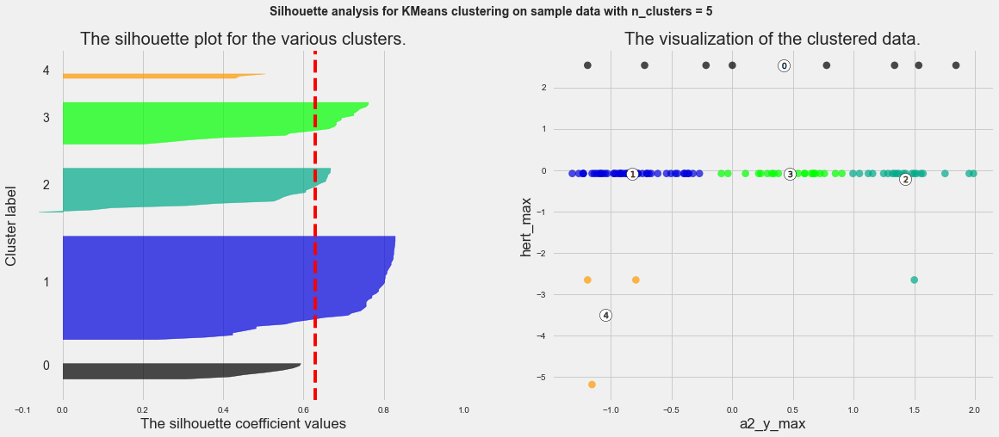

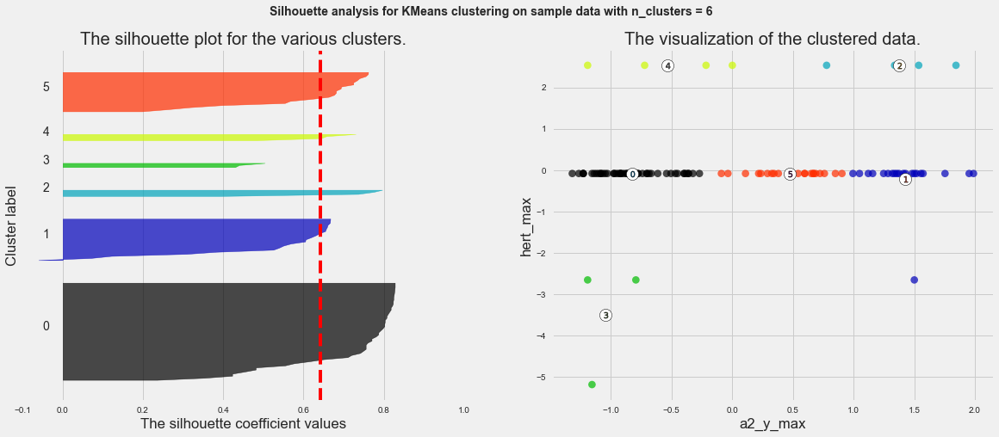

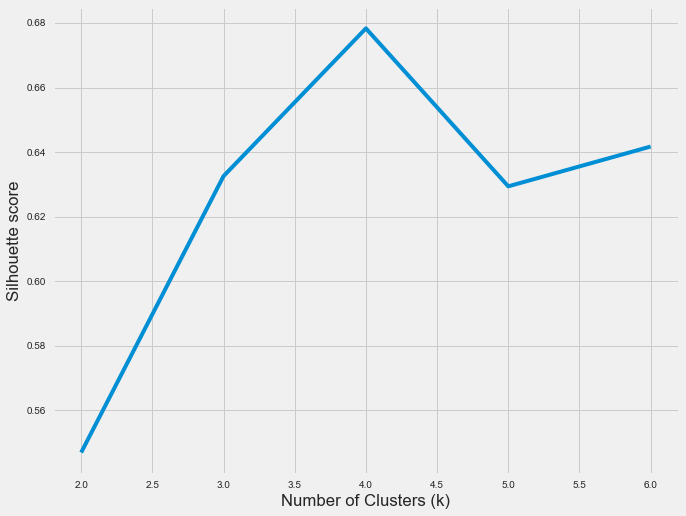

With 2-features combination of: a2_y_max, w_max
for n_clusters = 2 The average silhouette_score is : 0.51310297929801
for n_clusters = 3 The average silhouette_score is : 0.5874058139804648
for n_clusters = 4 The average silhouette_score is : 0.6030723203302886
for n_clusters = 5 The average silhouette_score is : 0.6104628103788852
for n_clusters = 6 The average silhouette_score is : 0.5628122915218526


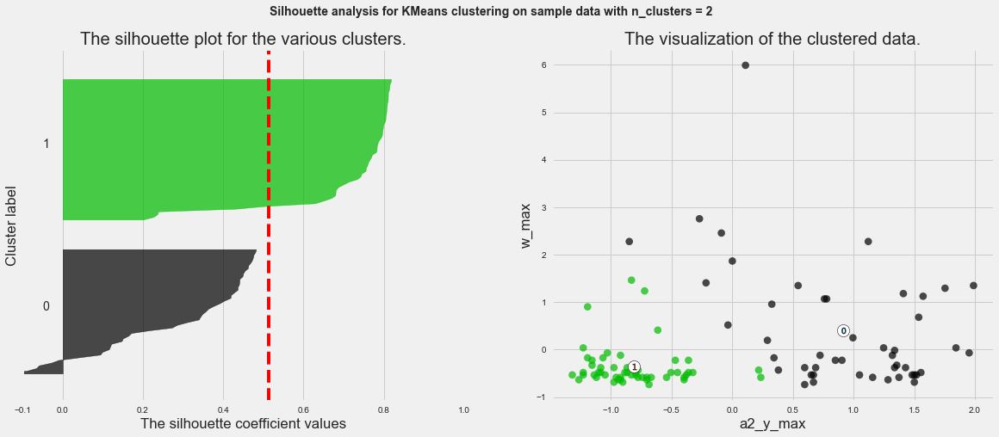

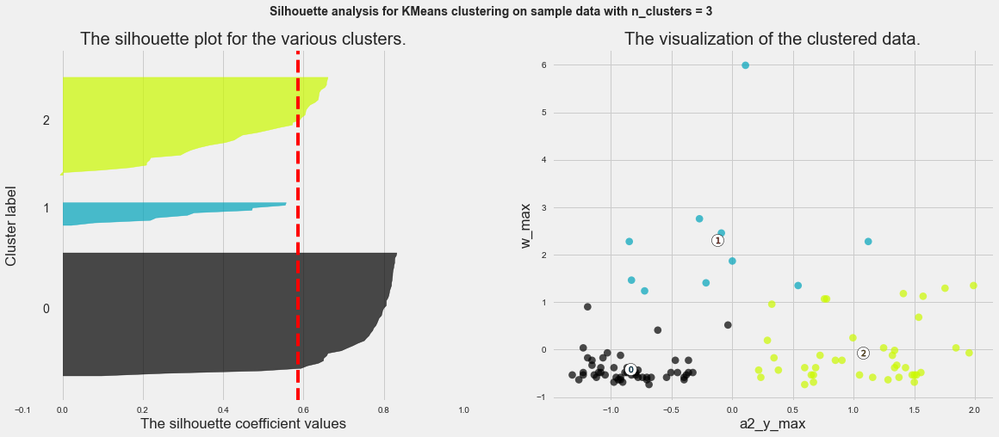

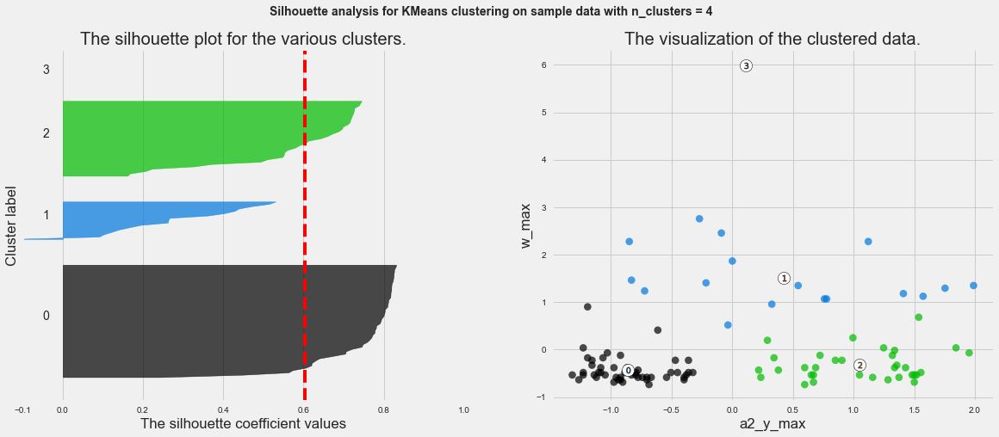

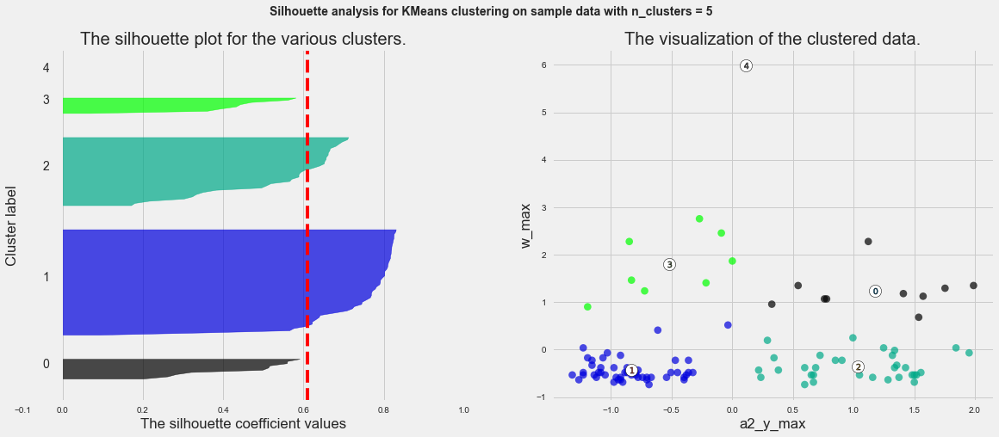

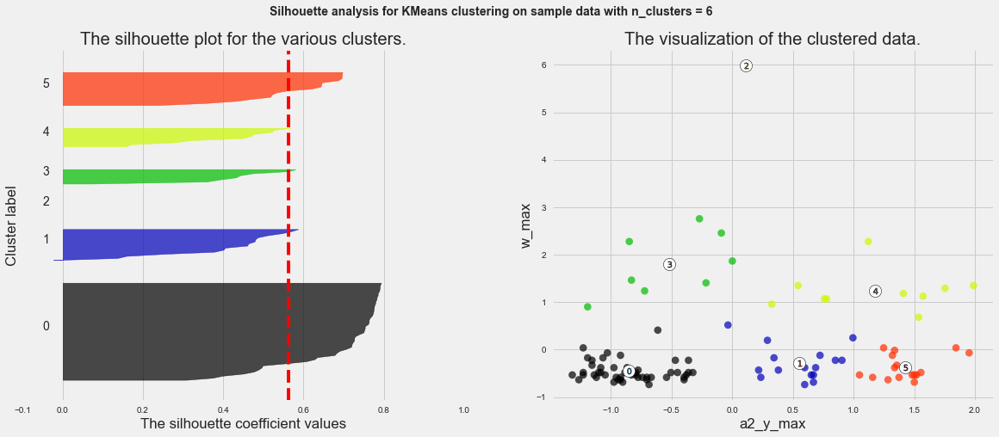

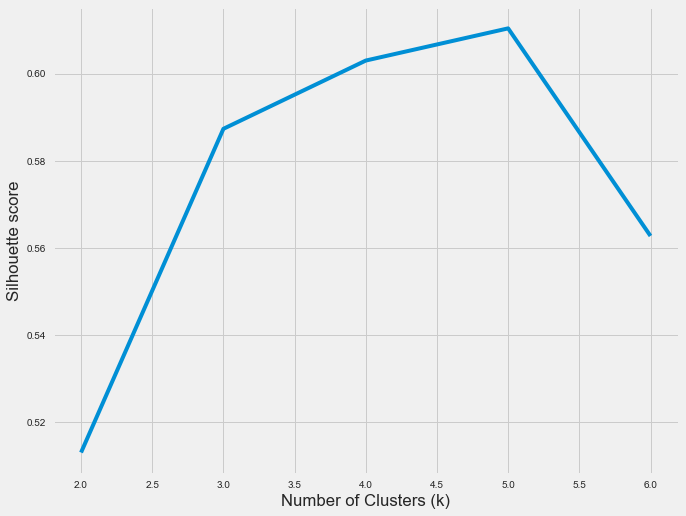

With 2-features combination of: a2_z_max, hert_max
for n_clusters = 2 The average silhouette_score is : 0.4182198954209884
for n_clusters = 3 The average silhouette_score is : 0.5090667539829183
for n_clusters = 4 The average silhouette_score is : 0.5679439825573835
for n_clusters = 5 The average silhouette_score is : 0.5650704155302502
for n_clusters = 6 The average silhouette_score is : 0.5631362499983689


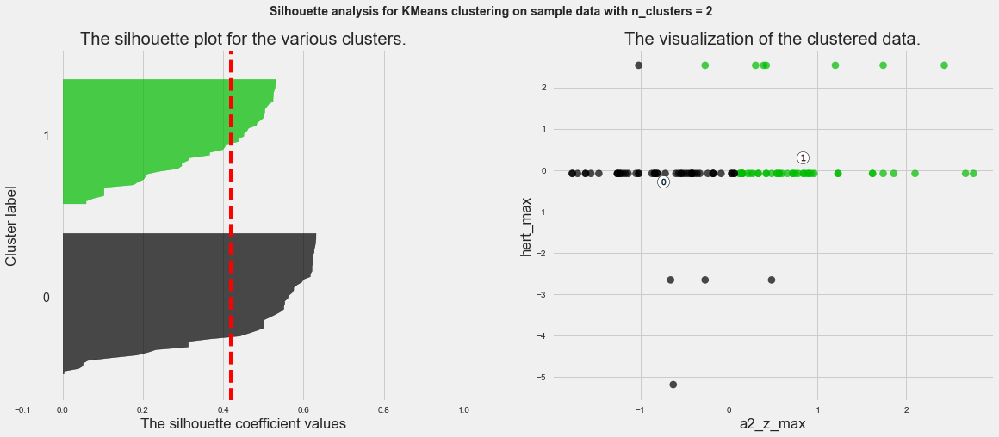

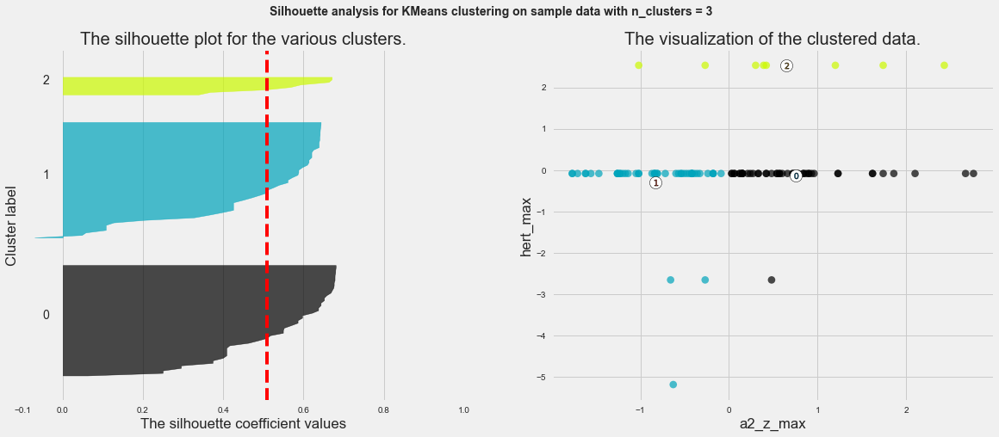

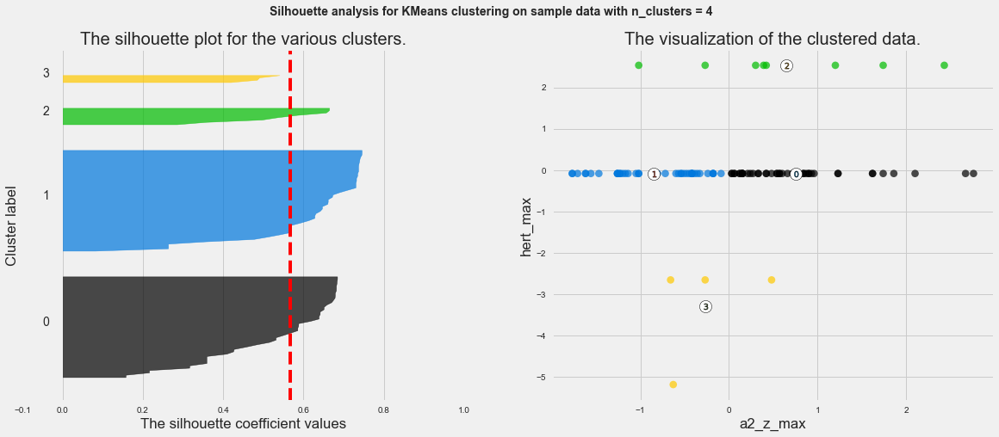

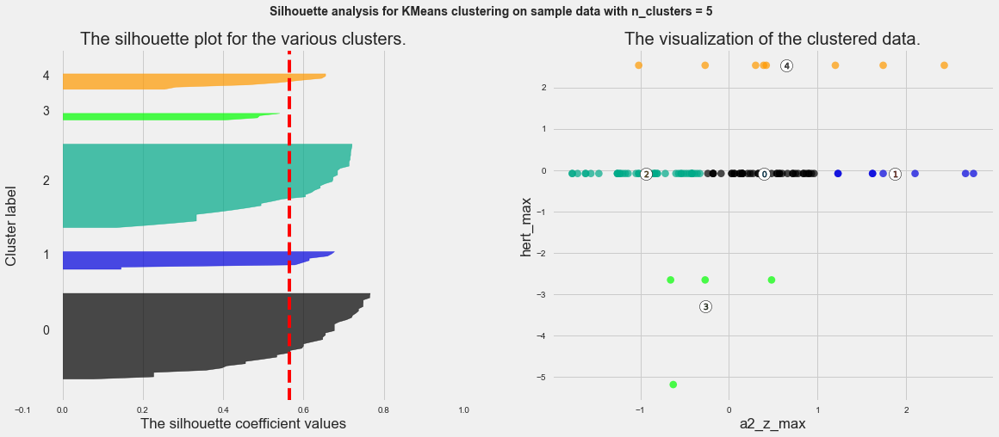

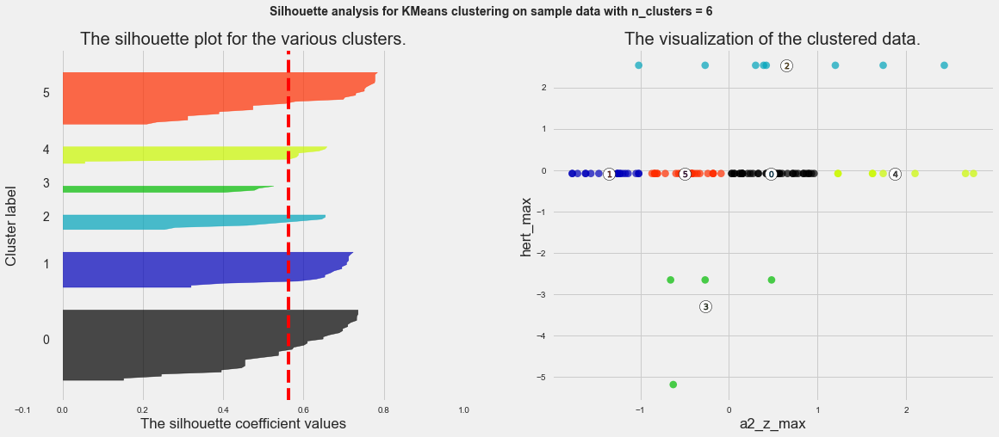

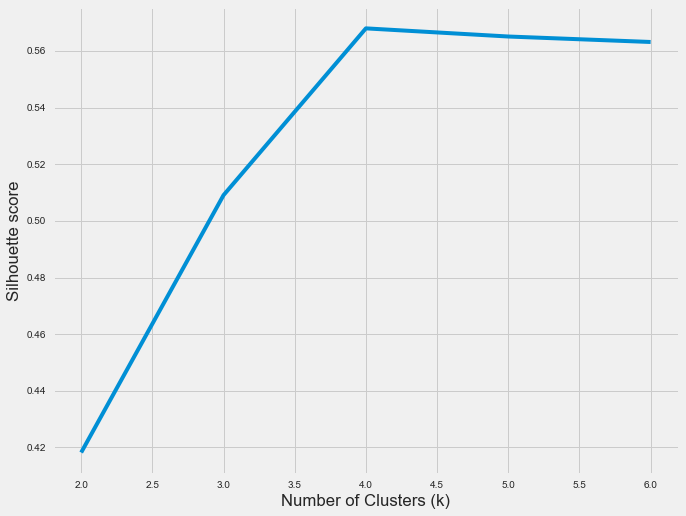

With 2-features combination of: a2_z_max, w_max
for n_clusters = 2 The average silhouette_score is : 0.5015570826523593
for n_clusters = 3 The average silhouette_score is : 0.4295795229148226
for n_clusters = 4 The average silhouette_score is : 0.4356014872837678
for n_clusters = 5 The average silhouette_score is : 0.46662490135024576
for n_clusters = 6 The average silhouette_score is : 0.47067116119864333


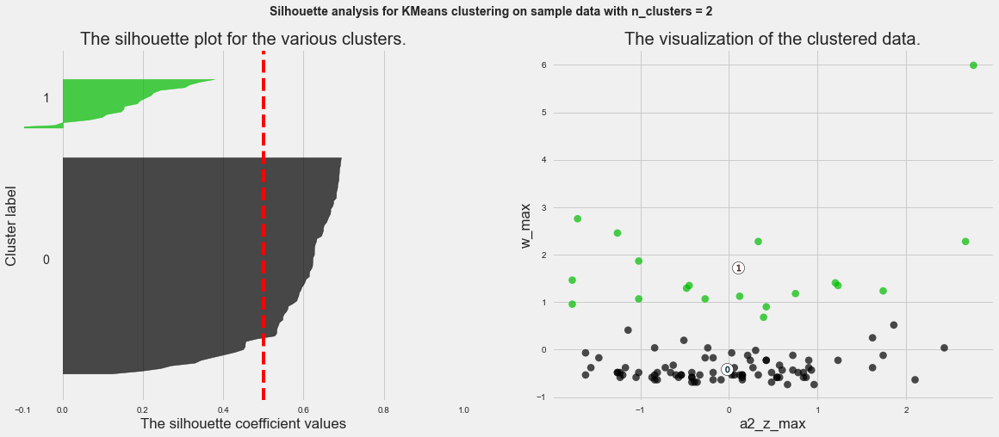

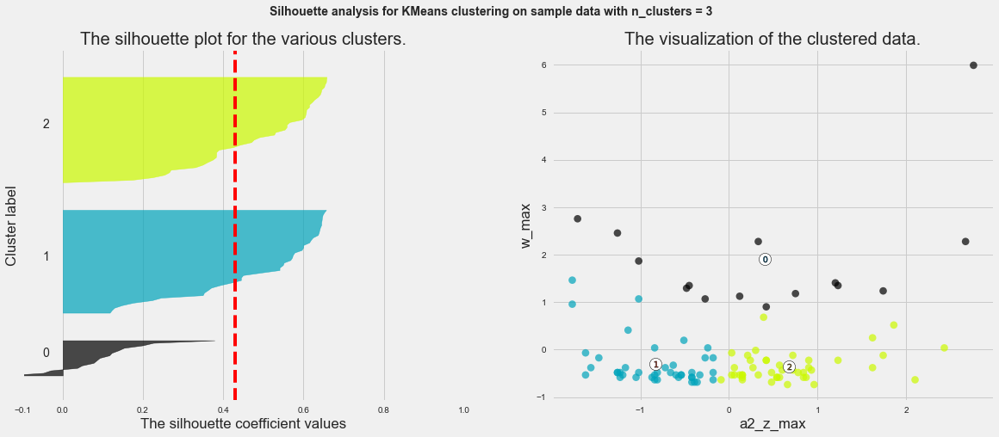

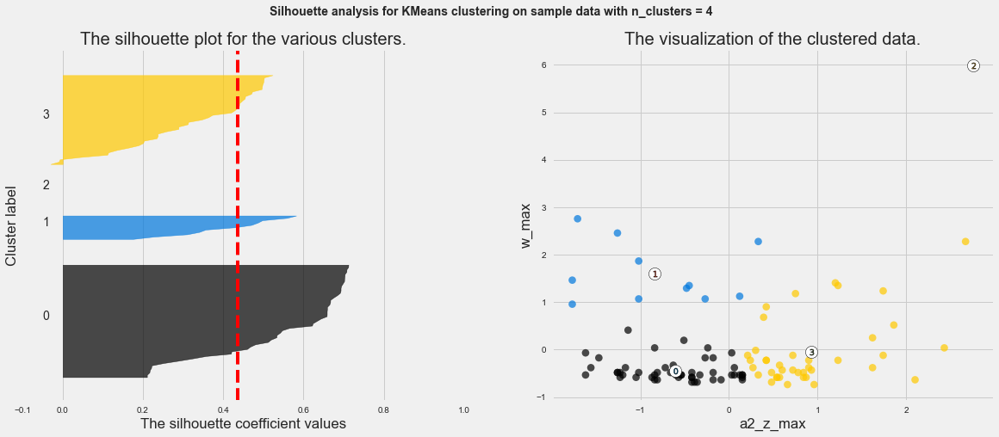

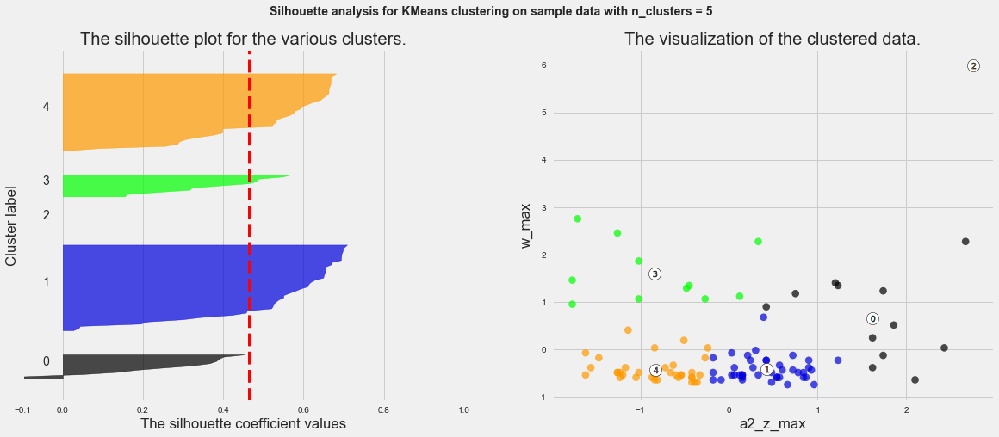

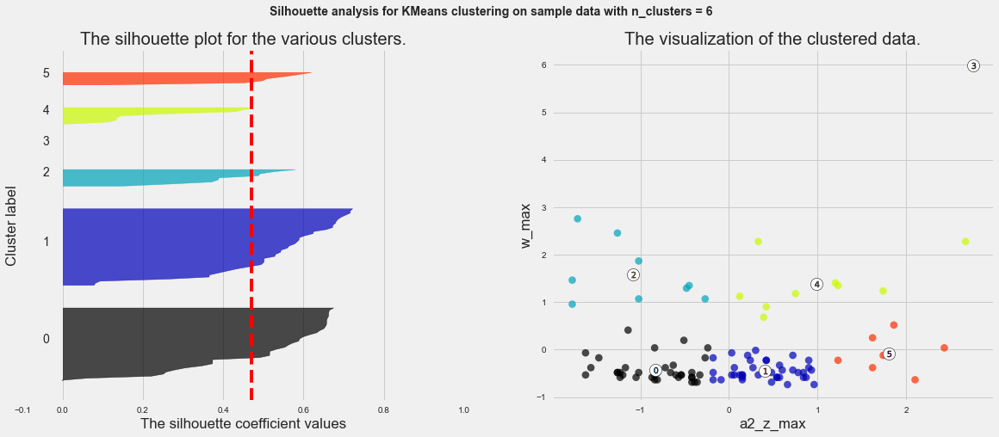

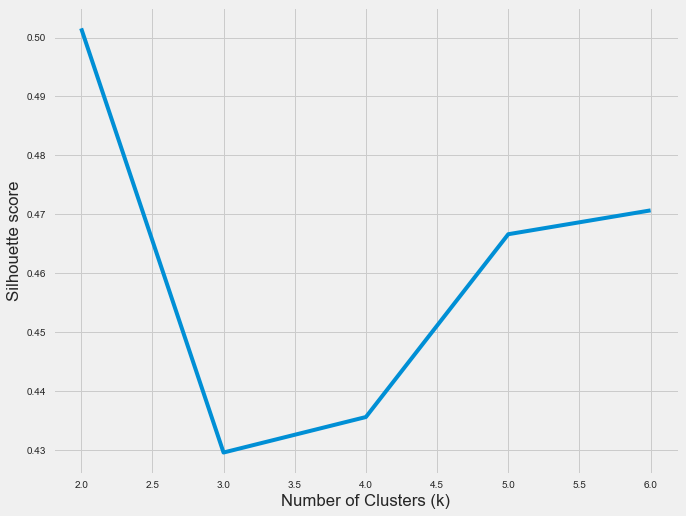

With 2-features combination of: hert_max, w_max
for n_clusters = 2 The average silhouette_score is : 0.6837706259732981
for n_clusters = 3 The average silhouette_score is : 0.7439116012036173
for n_clusters = 4 The average silhouette_score is : 0.8008903364432405
for n_clusters = 5 The average silhouette_score is : 0.8009820080893228
for n_clusters = 6 The average silhouette_score is : 0.8043545814093176


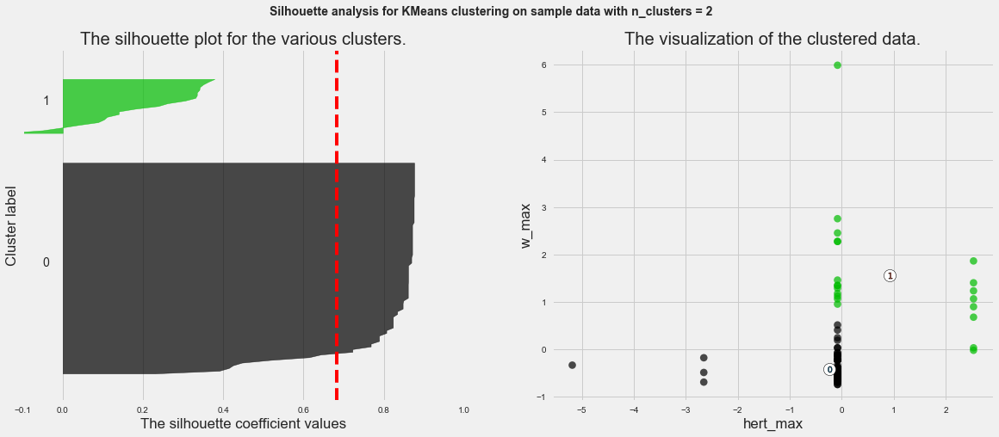

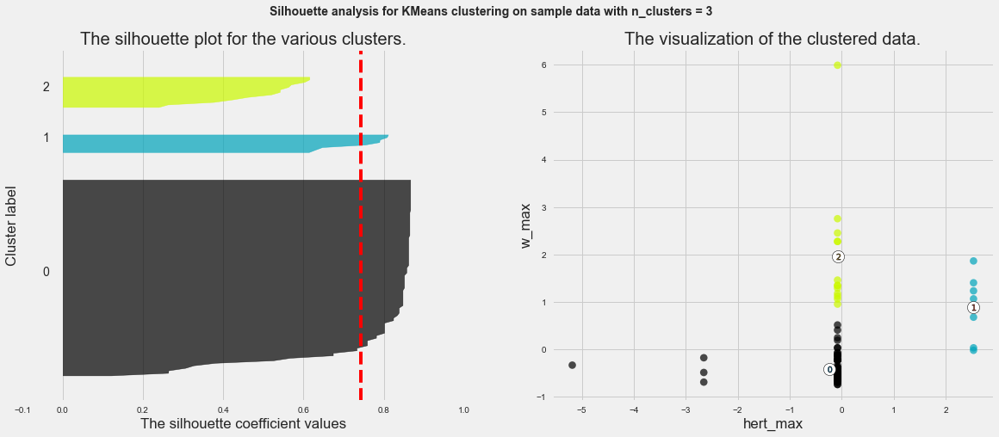

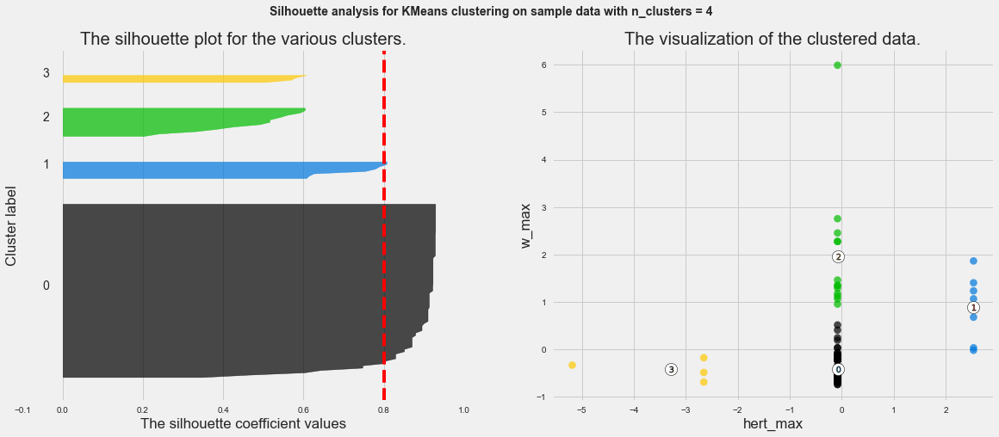

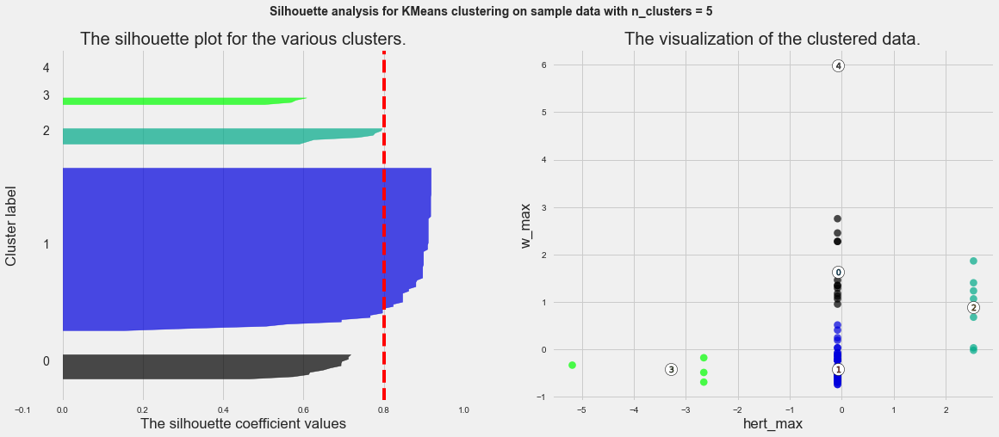

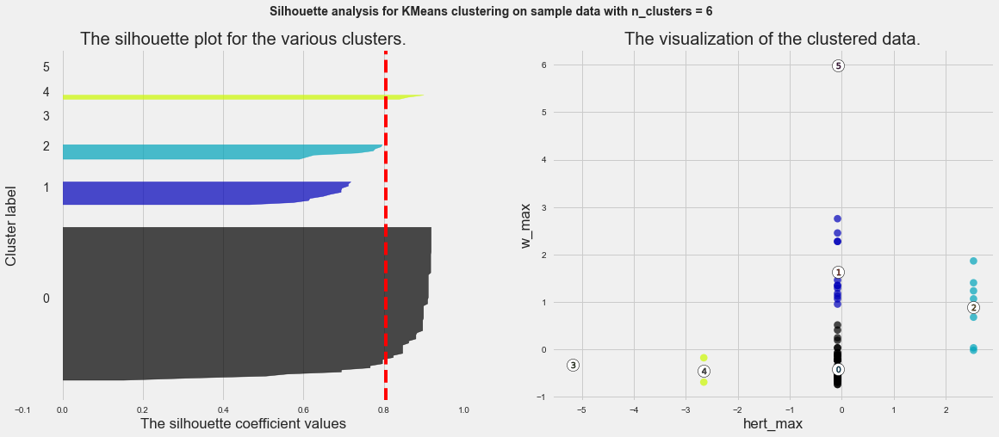

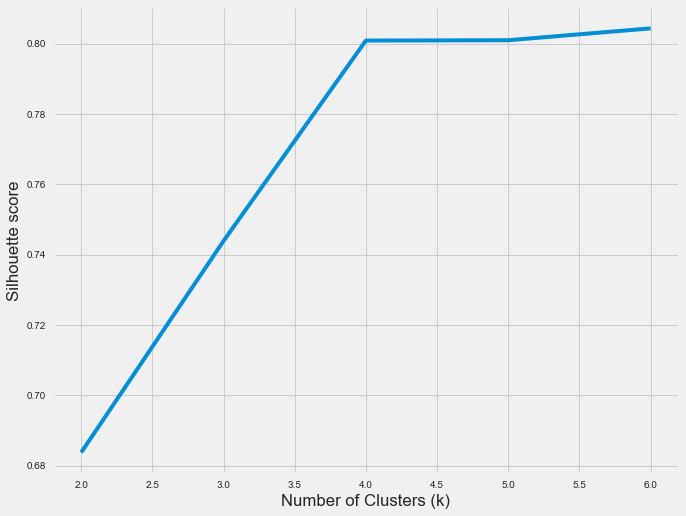

In [19]:
#Get combination of two columns within subdataset 'df_max'
combinations = list(itertools.combinations(df_max.columns,2))
print(combinations)

#Standardize the features
bearing = df_max
scaler = StandardScaler()
bearing = pd.DataFrame(scaler.fit_transform(bearing), index=bearing.index, columns=bearing.columns)

#Run for loop to see the optimal 'silhouette scores' corresponding to the number of features
for feature1, feature2 in combinations:    
    X = bearing[[feature1, feature2]].values

    range_n_clusters = [2, 3, 4, 5, 6]
    silhouette_avg_n_clusters = []
    
    print(f'With 2-features combination of: {feature1}, {feature2}')
    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, random_state=42)
        cluster_labels = clusterer.fit_predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print("for n_clusters =", n_clusters, 
              "The average silhouette_score is :", silhouette_avg)

        silhouette_avg_n_clusters.append(silhouette_avg)
        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(X[:, 0], X[:, 1], marker='.', s=300, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

        # Labeling the clusters
        centers = clusterer.cluster_centers_
        # Draw white circles at cluster centers
        ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                    c="white", alpha=1, s=200, edgecolor='k')

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                        s=50, edgecolor='k')

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel(feature1)
        ax2.set_ylabel(feature2)

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')
    plt.show()

    style.use("fivethirtyeight")
    plt.plot(range_n_clusters, silhouette_avg_n_clusters)
    plt.xlabel("Number of Clusters (k)")
    plt.ylabel("Silhouette score")
    plt.show()

#### Conclusion For the Max subdataset
+ The optimal Silhouette score found in combination of features: 
   - With 2-features combination of: a1_z_max, hert_max
    + for n_clusters = 2 The average silhouette_score is : **0.8221495628031819**
    + for n_clusters = 3 The average silhouette_score is : 0.5504890613905714
    + for n_clusters = 4 The average silhouette_score is : 0.5483138824552221
    + for n_clusters = 5 The average silhouette_score is : 0.5462880455413778
    + for n_clusters = 6 The average silhouette_score is : 0.5681644395943416

[('a1_x_median', 'a1_y_median'), ('a1_x_median', 'a1_z_median'), ('a1_x_median', 'a2_x_median'), ('a1_x_median', 'a2_y_median'), ('a1_x_median', 'a2_z_median'), ('a1_x_median', 'hert_median'), ('a1_x_median', 'w_median'), ('a1_y_median', 'a1_z_median'), ('a1_y_median', 'a2_x_median'), ('a1_y_median', 'a2_y_median'), ('a1_y_median', 'a2_z_median'), ('a1_y_median', 'hert_median'), ('a1_y_median', 'w_median'), ('a1_z_median', 'a2_x_median'), ('a1_z_median', 'a2_y_median'), ('a1_z_median', 'a2_z_median'), ('a1_z_median', 'hert_median'), ('a1_z_median', 'w_median'), ('a2_x_median', 'a2_y_median'), ('a2_x_median', 'a2_z_median'), ('a2_x_median', 'hert_median'), ('a2_x_median', 'w_median'), ('a2_y_median', 'a2_z_median'), ('a2_y_median', 'hert_median'), ('a2_y_median', 'w_median'), ('a2_z_median', 'hert_median'), ('a2_z_median', 'w_median'), ('hert_median', 'w_median')]
With 2-features combination of: a1_x_median, a1_y_median
for n_clusters = 2 The average silhouette_score is : 0.831734114505

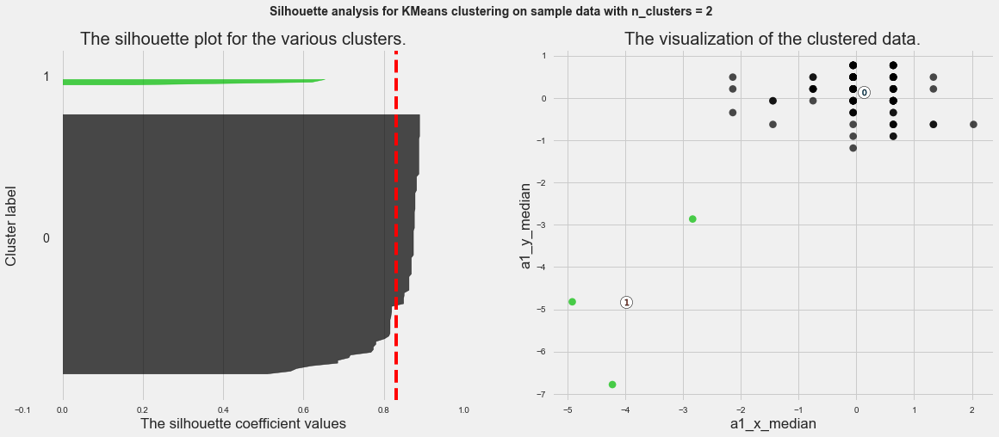

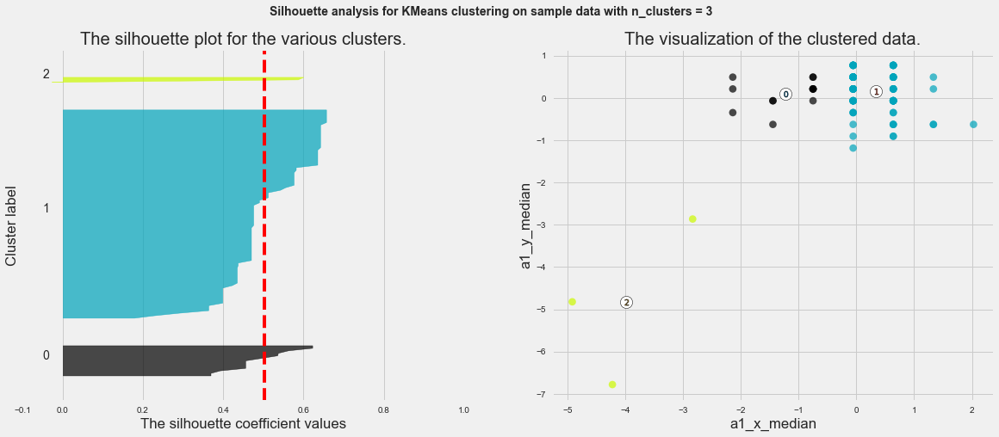

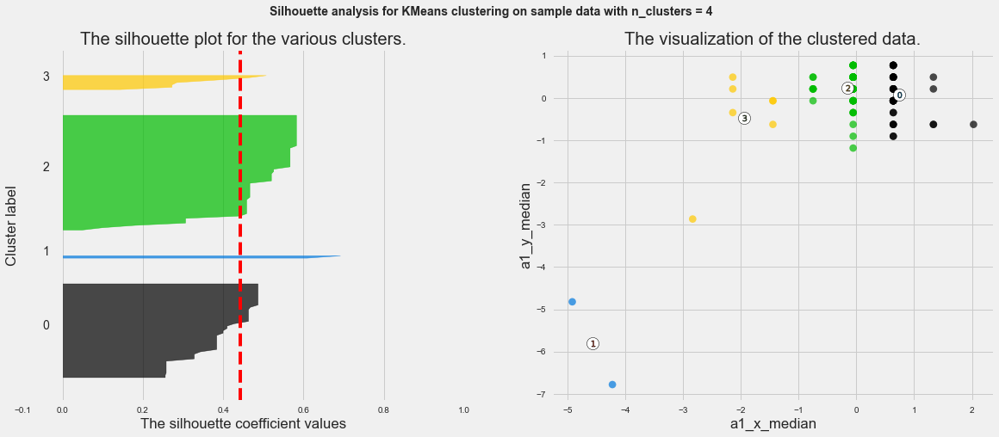

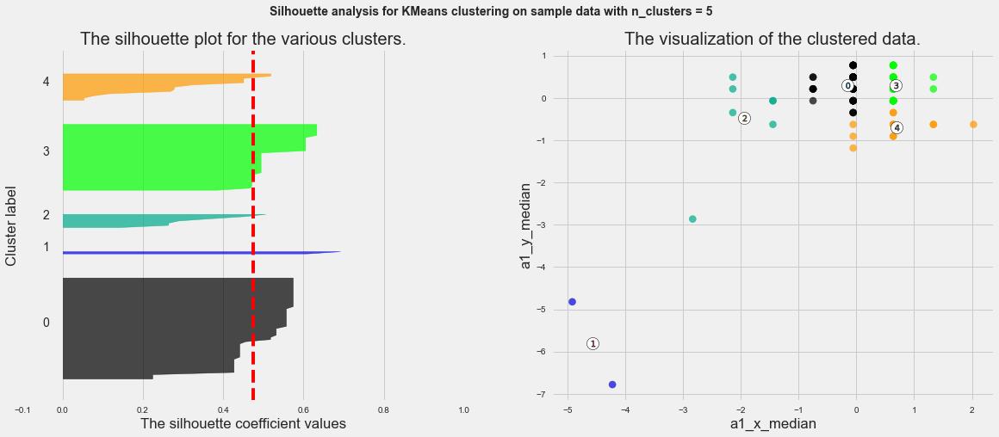

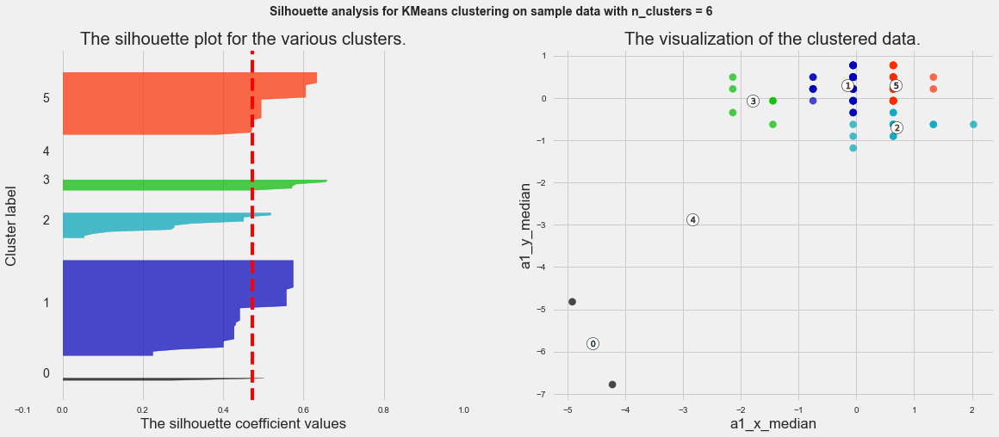

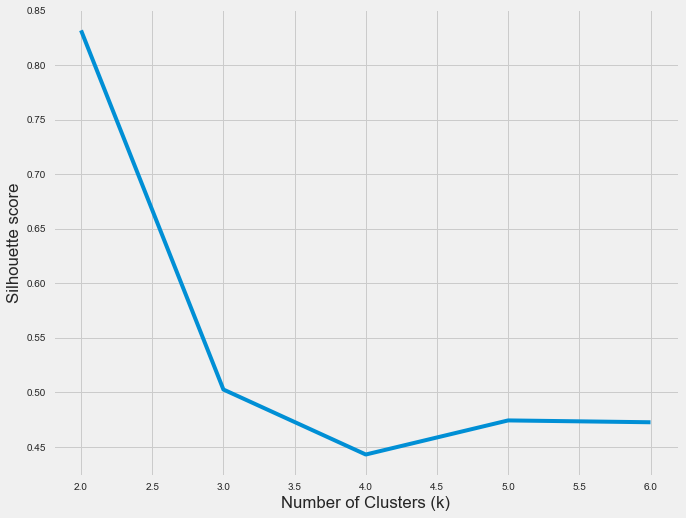

With 2-features combination of: a1_x_median, a1_z_median
for n_clusters = 2 The average silhouette_score is : 0.7736801258110159
for n_clusters = 3 The average silhouette_score is : 0.5288907416721346
for n_clusters = 4 The average silhouette_score is : 0.5540111307829307
for n_clusters = 5 The average silhouette_score is : 0.5700434364392802
for n_clusters = 6 The average silhouette_score is : 0.5691906501721042


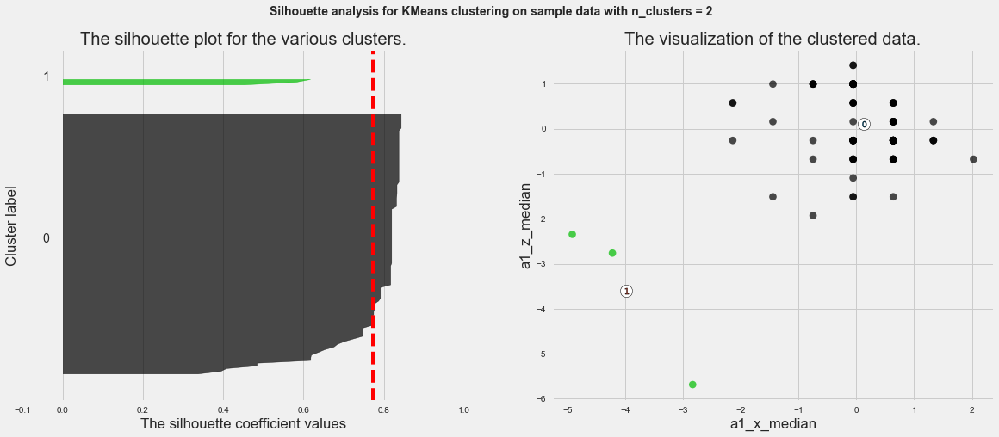

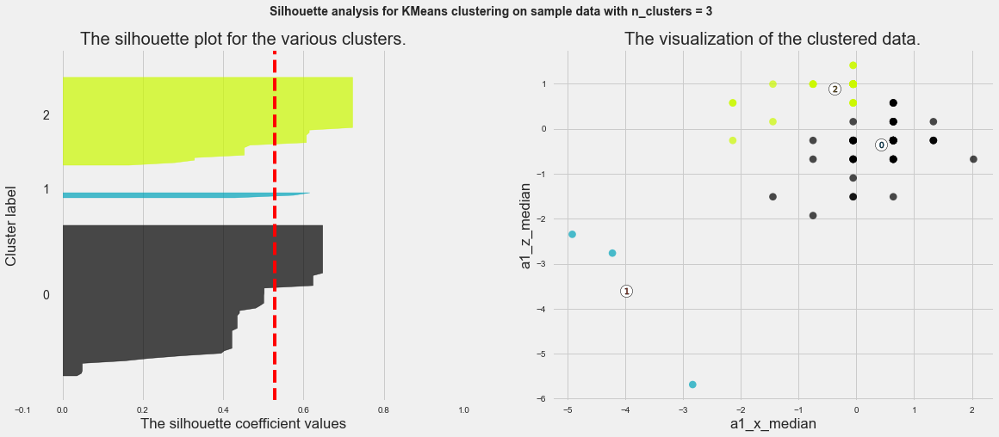

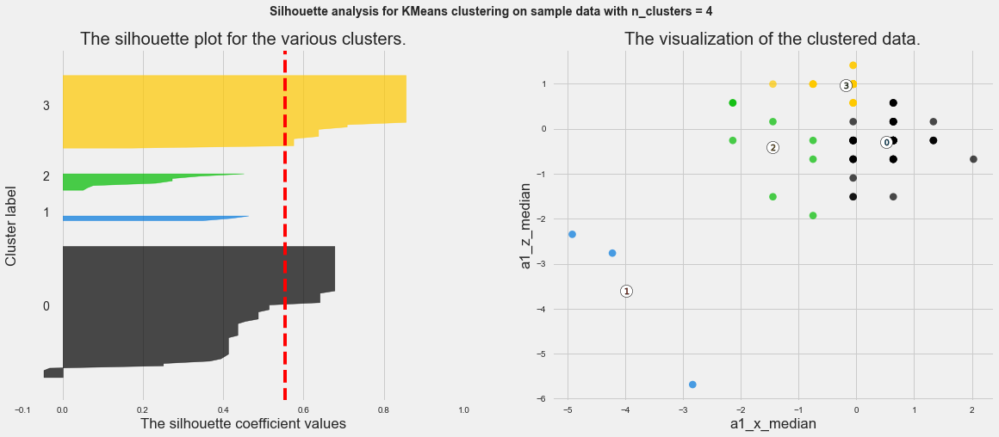

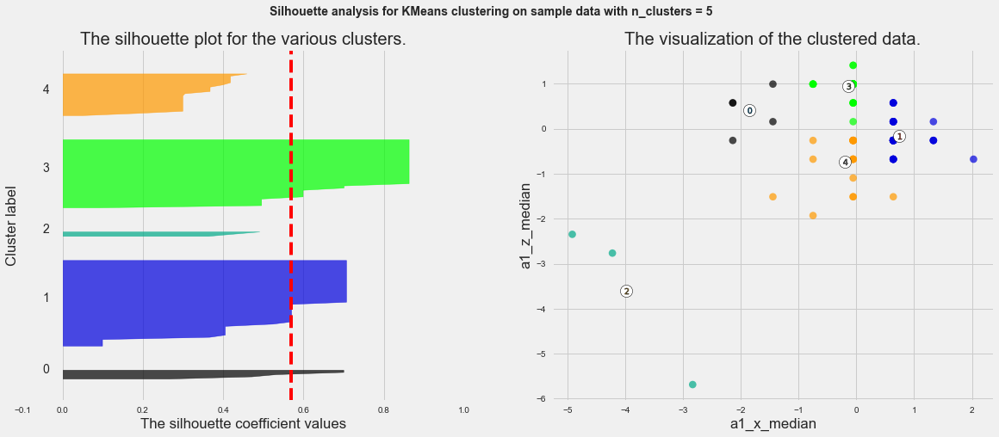

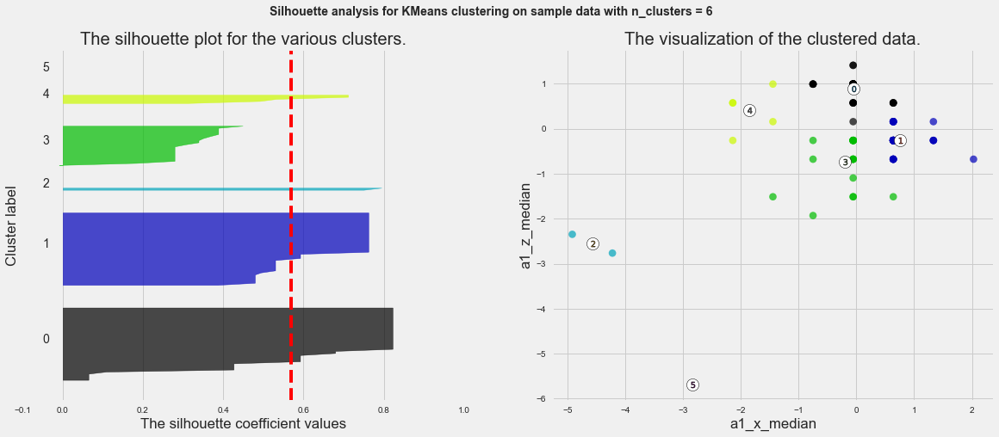

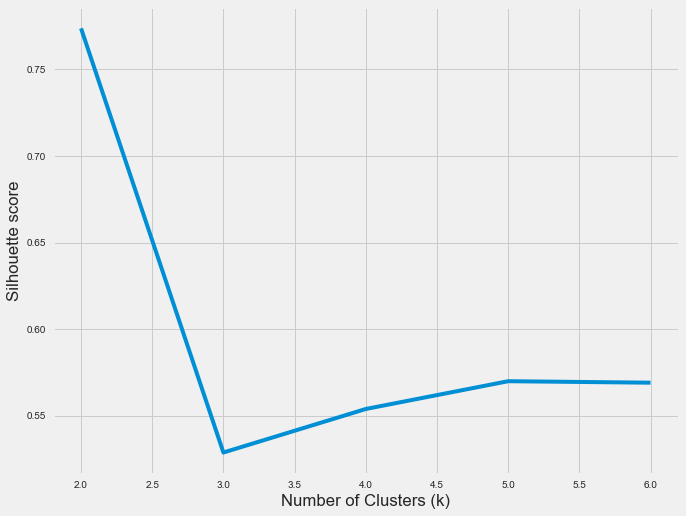

With 2-features combination of: a1_x_median, a2_x_median
for n_clusters = 2 The average silhouette_score is : 0.38281954007454955
for n_clusters = 3 The average silhouette_score is : 0.44210326535573863
for n_clusters = 4 The average silhouette_score is : 0.4201808312111491
for n_clusters = 5 The average silhouette_score is : 0.4296790648882605
for n_clusters = 6 The average silhouette_score is : 0.41298067736628724


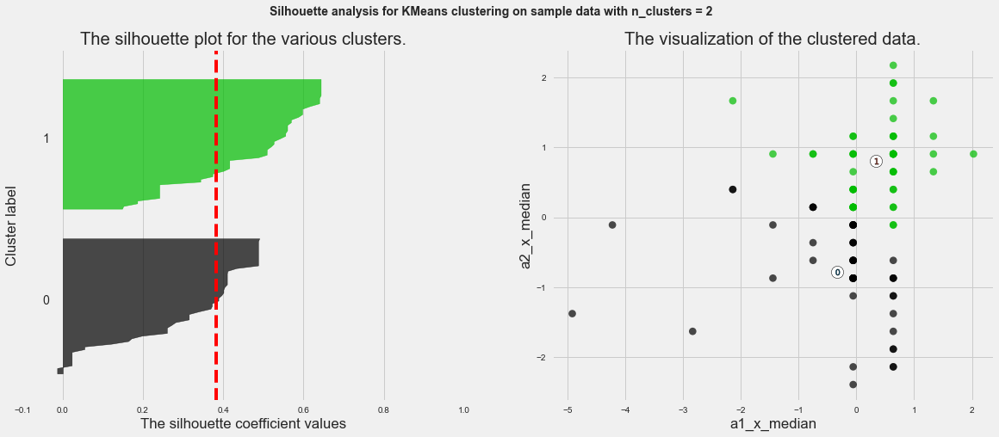

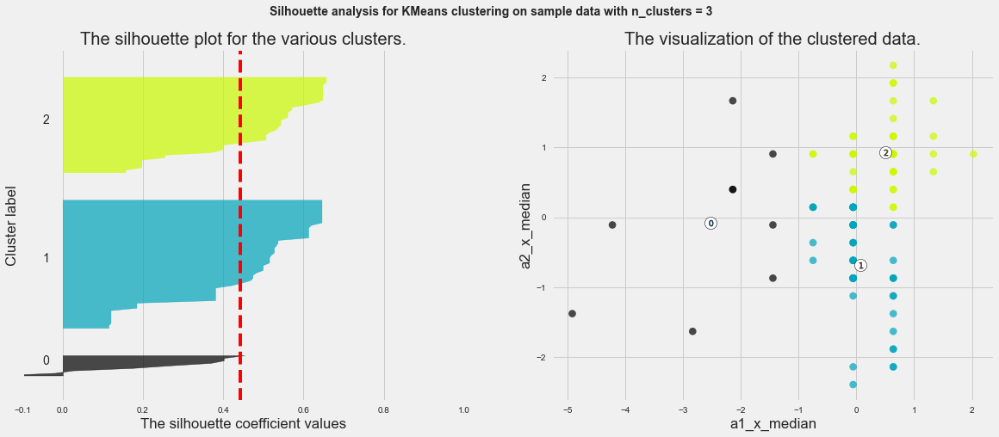

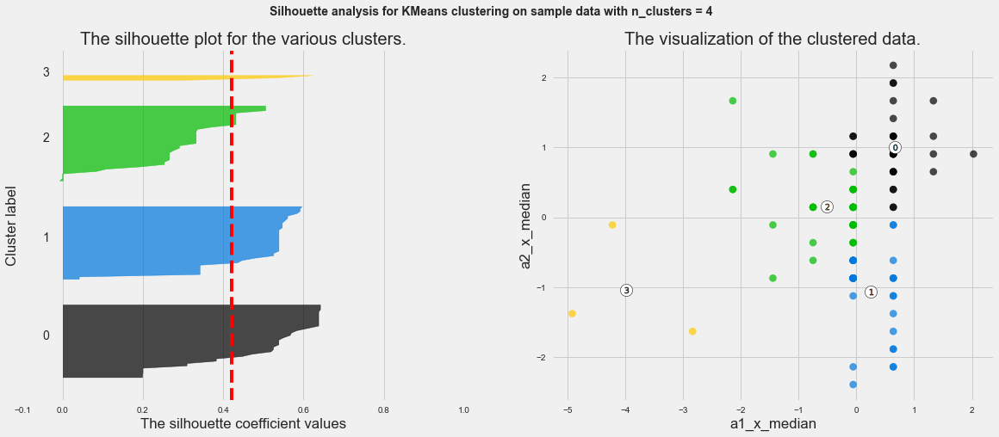

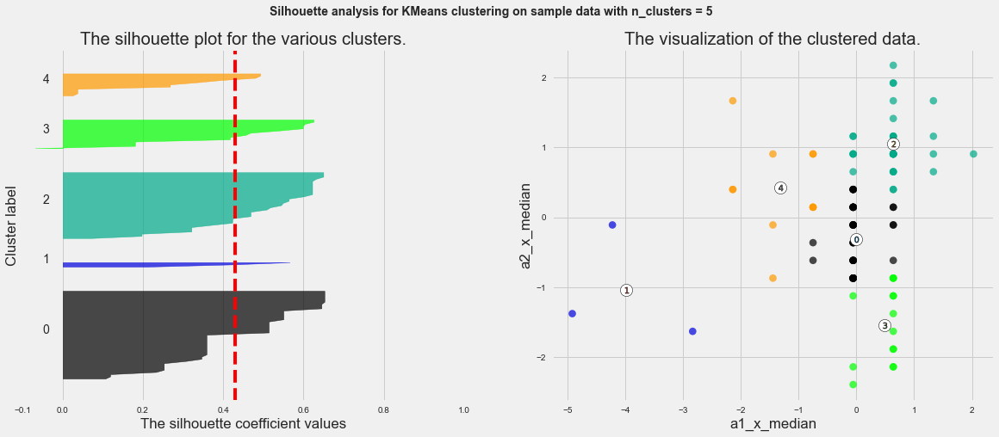

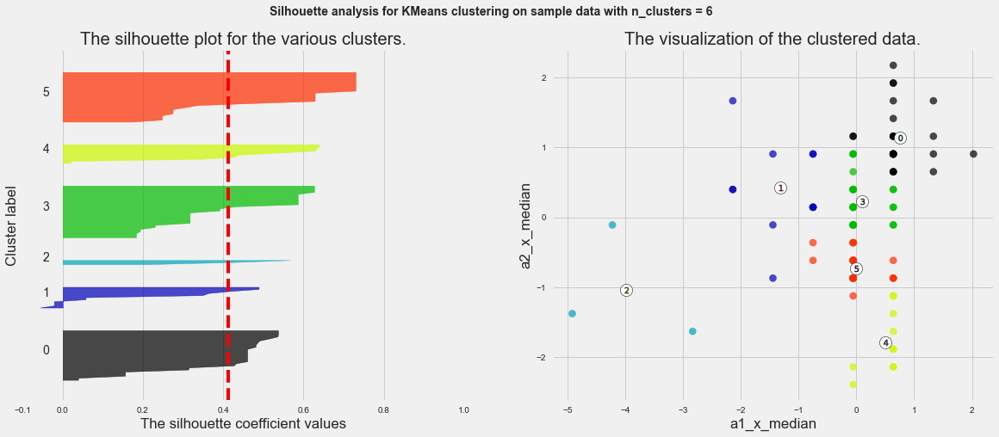

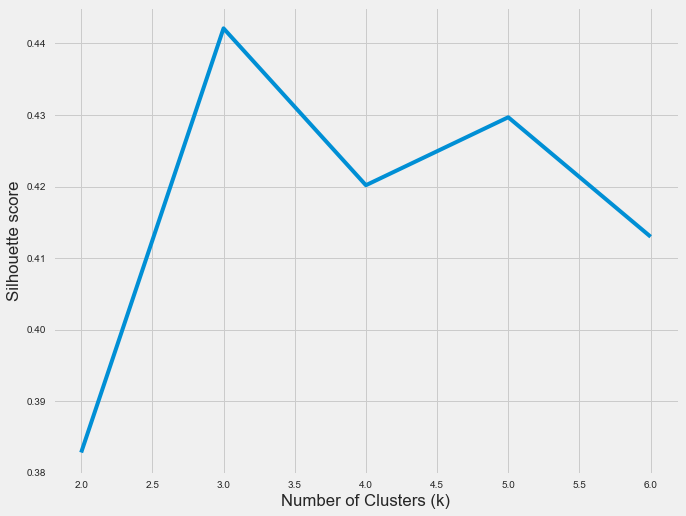

With 2-features combination of: a1_x_median, a2_y_median
for n_clusters = 2 The average silhouette_score is : 0.8323914420174643
for n_clusters = 3 The average silhouette_score is : 0.42341962012470286
for n_clusters = 4 The average silhouette_score is : 0.4454577701138064
for n_clusters = 5 The average silhouette_score is : 0.45153608523259625
for n_clusters = 6 The average silhouette_score is : 0.5416511071588552


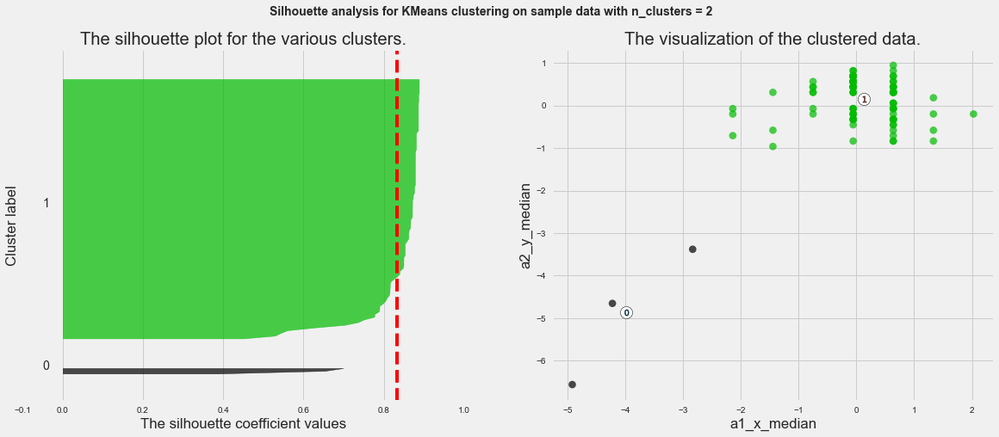

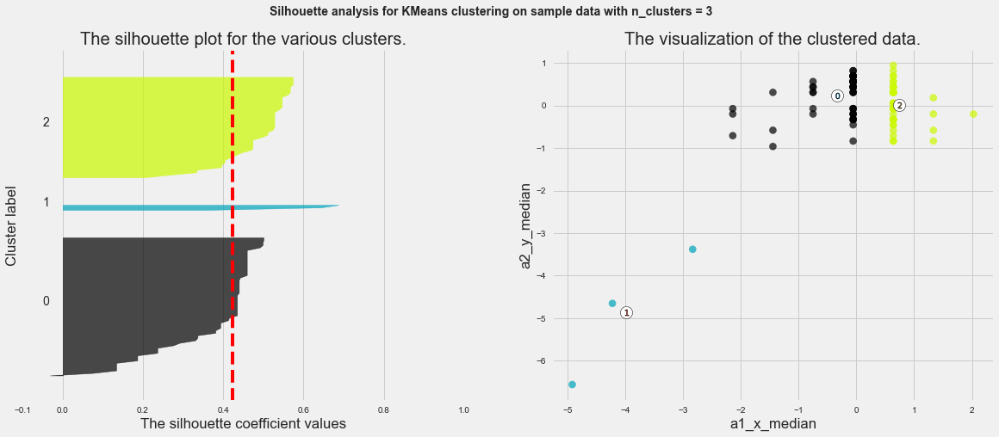

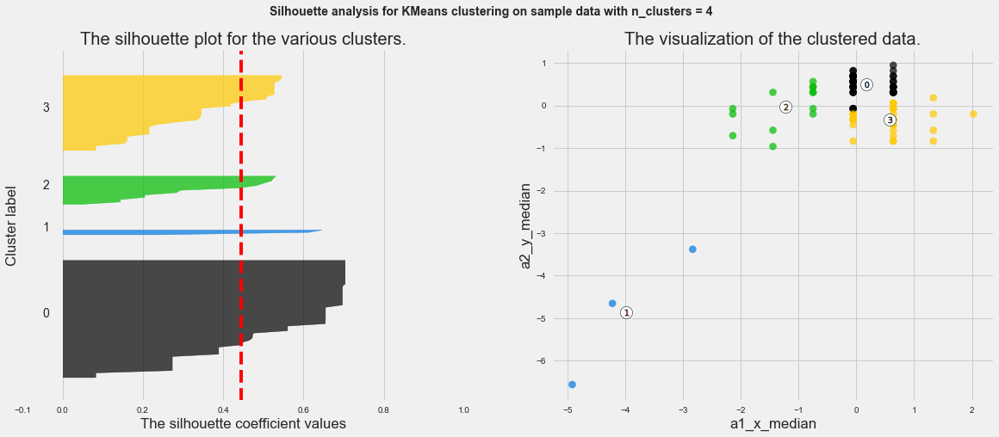

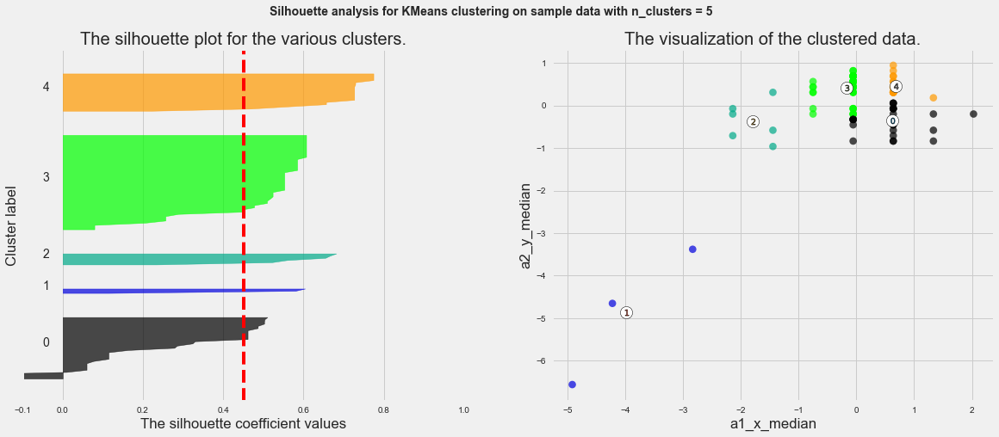

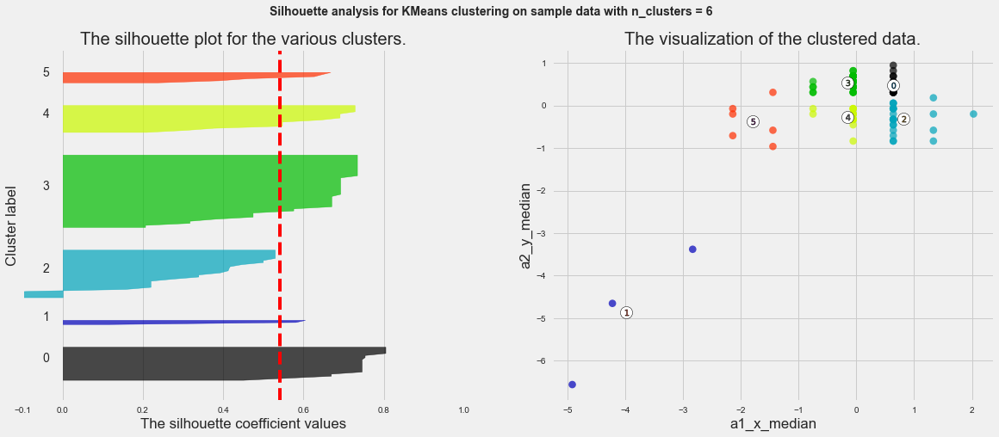

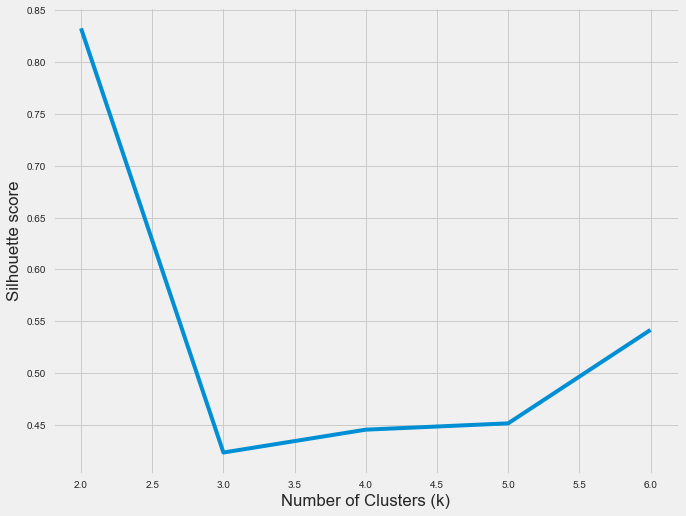

With 2-features combination of: a1_x_median, a2_z_median
for n_clusters = 2 The average silhouette_score is : 0.8135455780022088
for n_clusters = 3 The average silhouette_score is : 0.5559619688413272
for n_clusters = 4 The average silhouette_score is : 0.46209353153366906
for n_clusters = 5 The average silhouette_score is : 0.4652037697000944
for n_clusters = 6 The average silhouette_score is : 0.45789952921365973


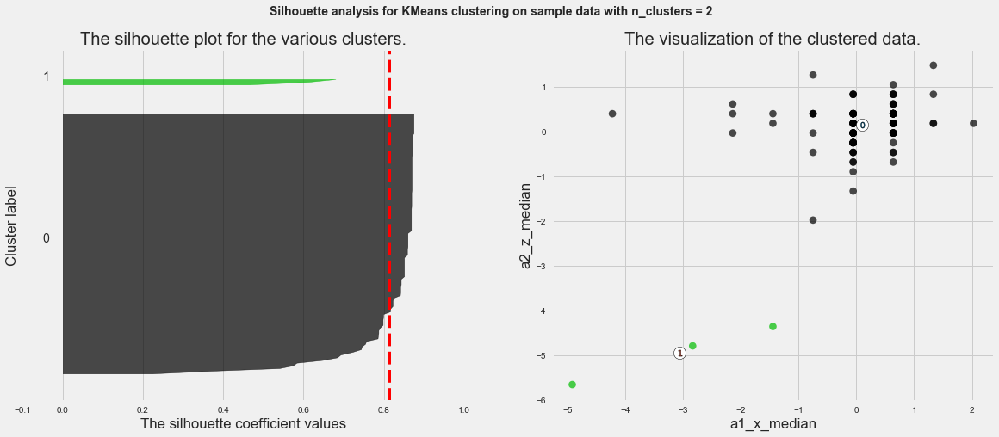

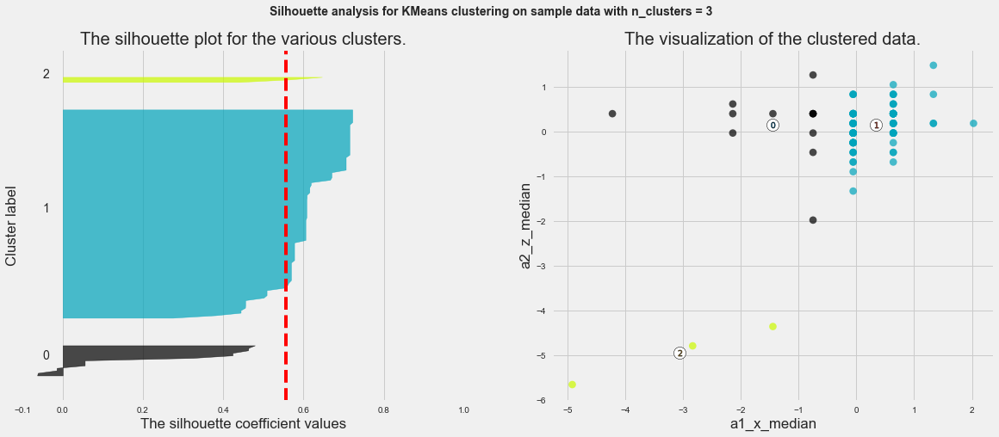

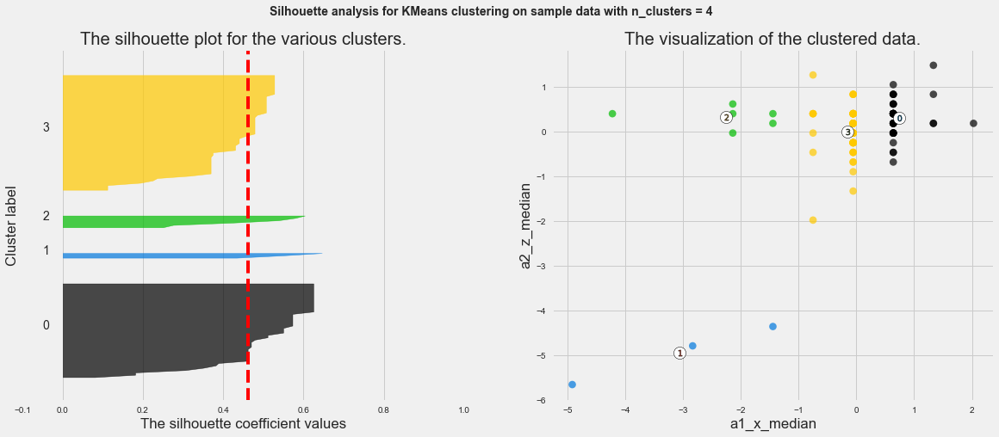

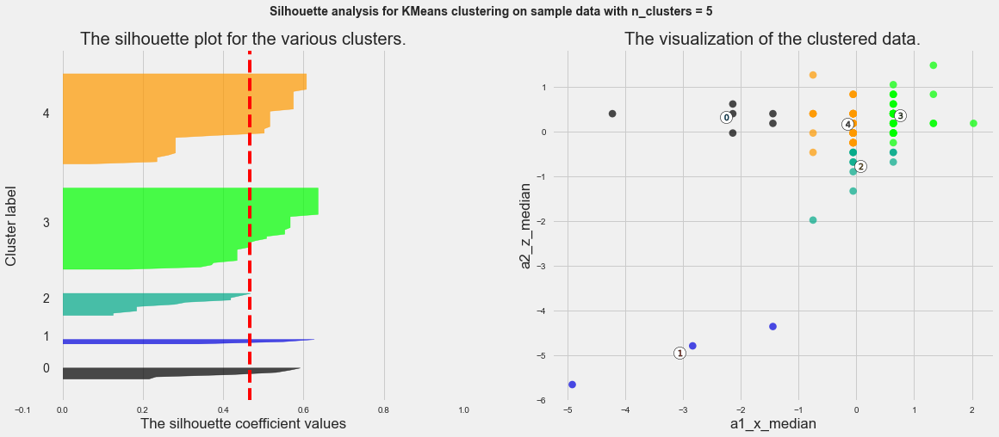

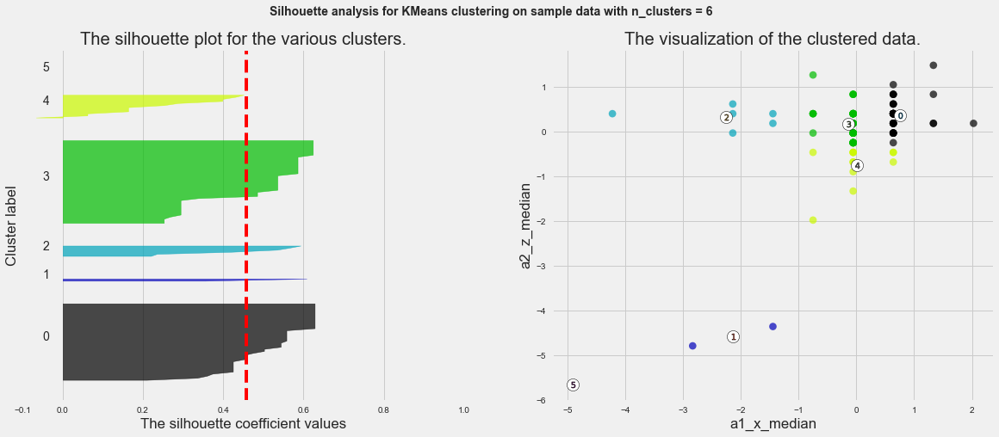

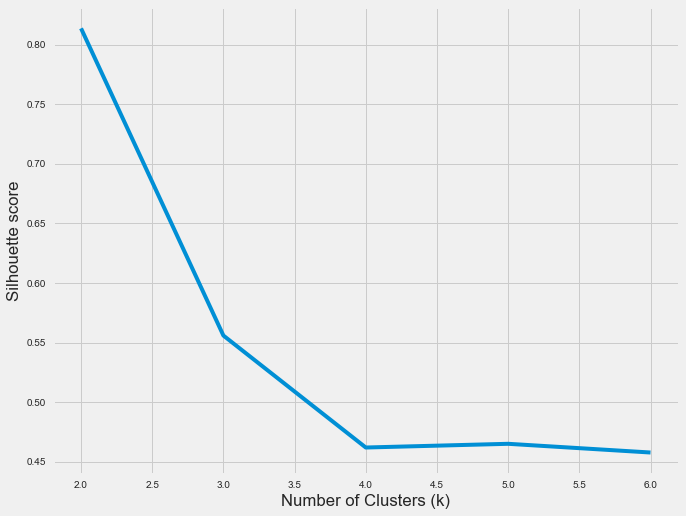

With 2-features combination of: a1_x_median, hert_median
for n_clusters = 2 The average silhouette_score is : 0.6388494373265885
for n_clusters = 3 The average silhouette_score is : 0.6873437811487918
for n_clusters = 4 The average silhouette_score is : 0.7380627613438745
for n_clusters = 5 The average silhouette_score is : 0.7335877006713207
for n_clusters = 6 The average silhouette_score is : 0.7695810418881976


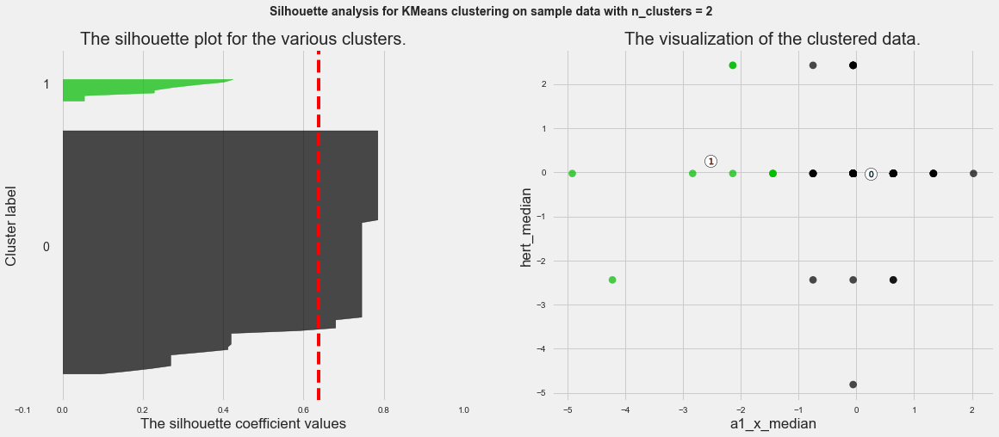

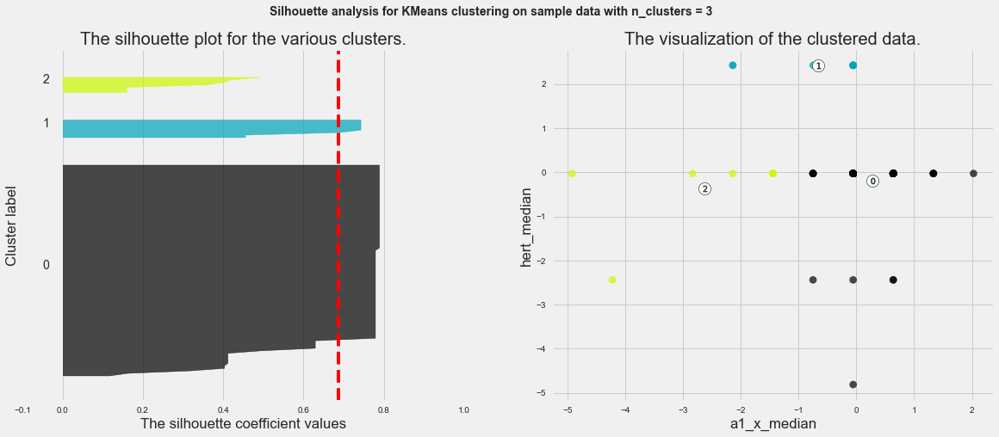

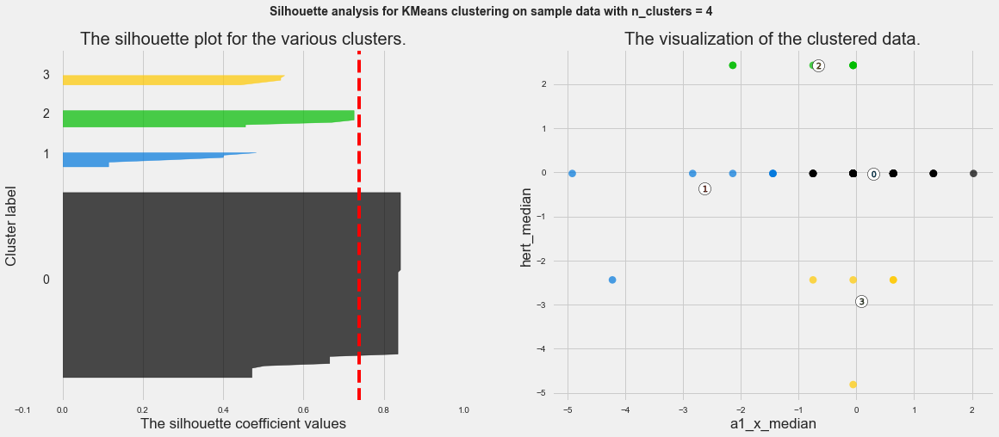

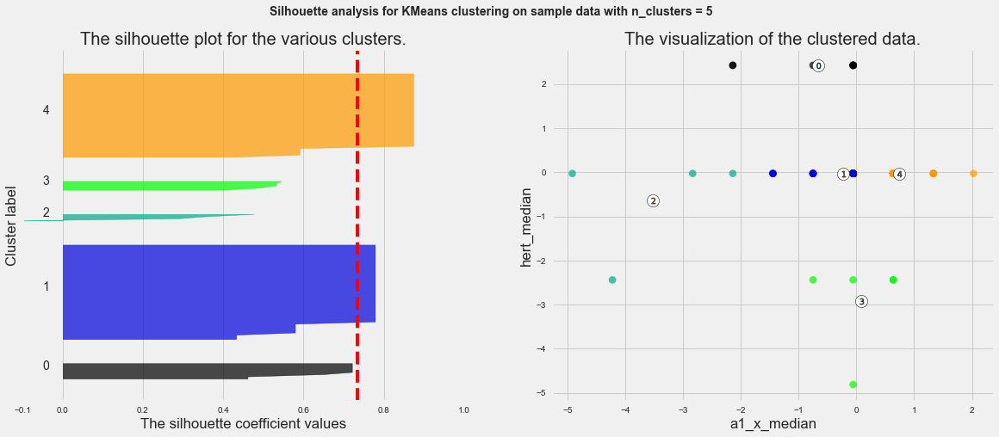

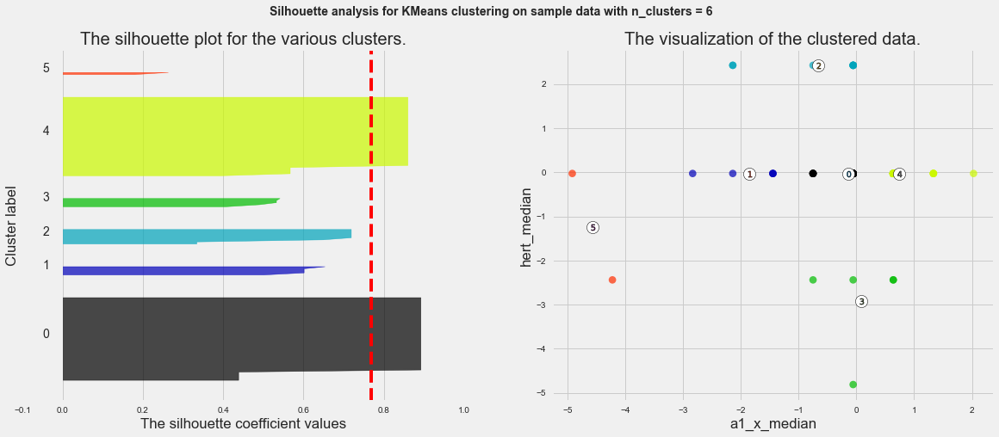

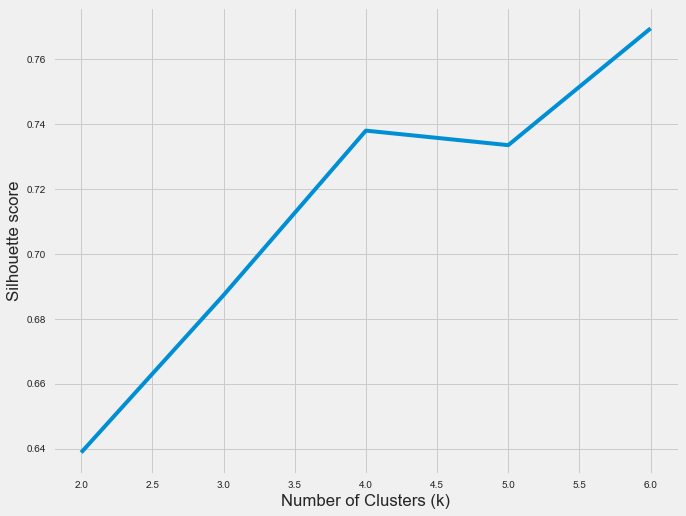

With 2-features combination of: a1_x_median, w_median
for n_clusters = 2 The average silhouette_score is : 0.5184036866842817
for n_clusters = 3 The average silhouette_score is : 0.520040275649457
for n_clusters = 4 The average silhouette_score is : 0.4409832299166209
for n_clusters = 5 The average silhouette_score is : 0.44591557421074945
for n_clusters = 6 The average silhouette_score is : 0.4789941190219574


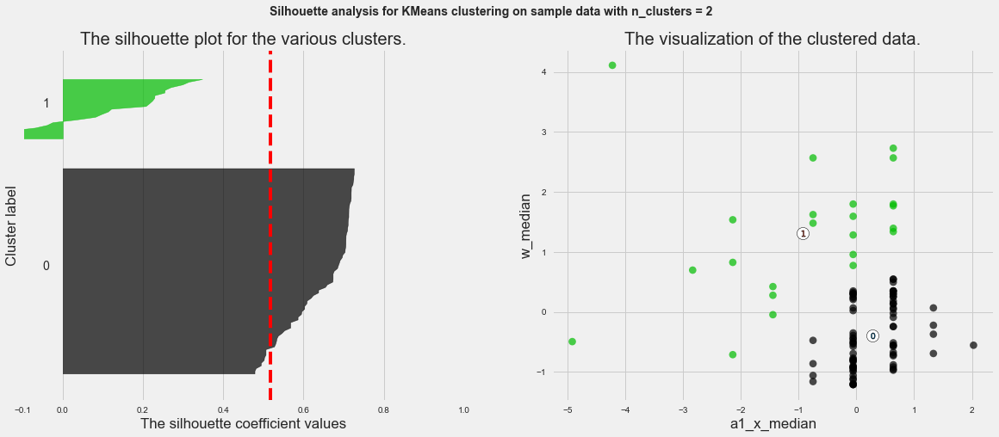

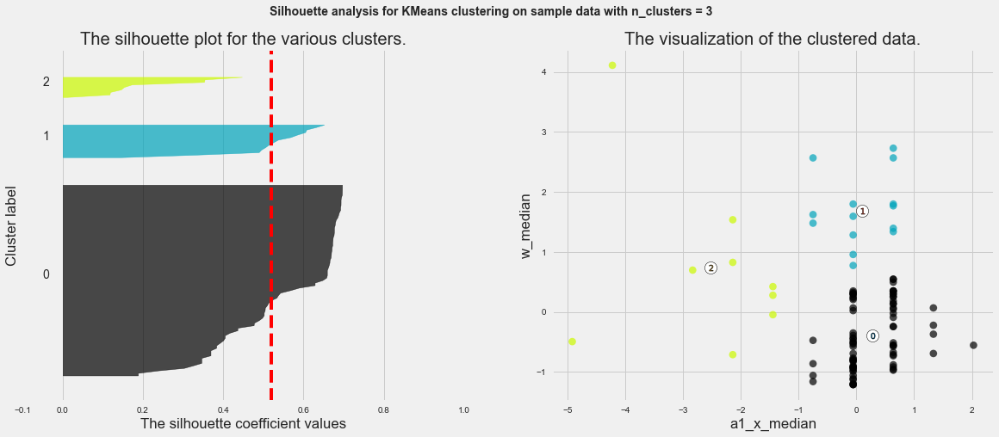

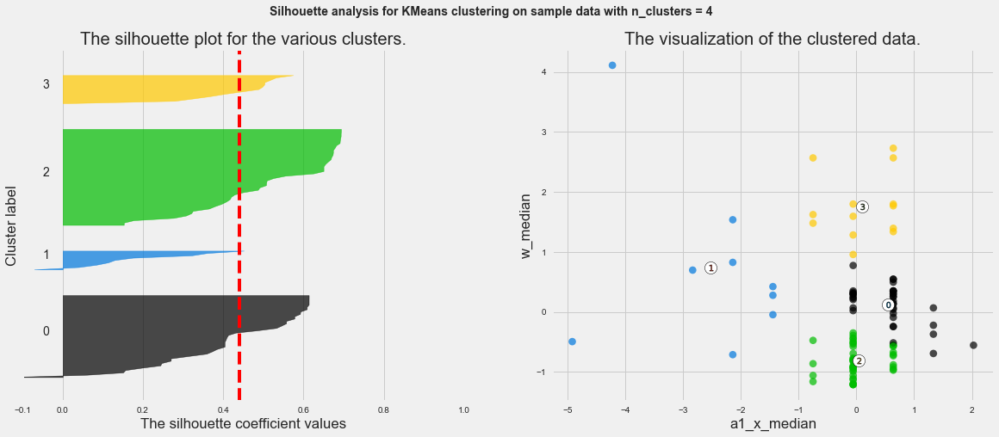

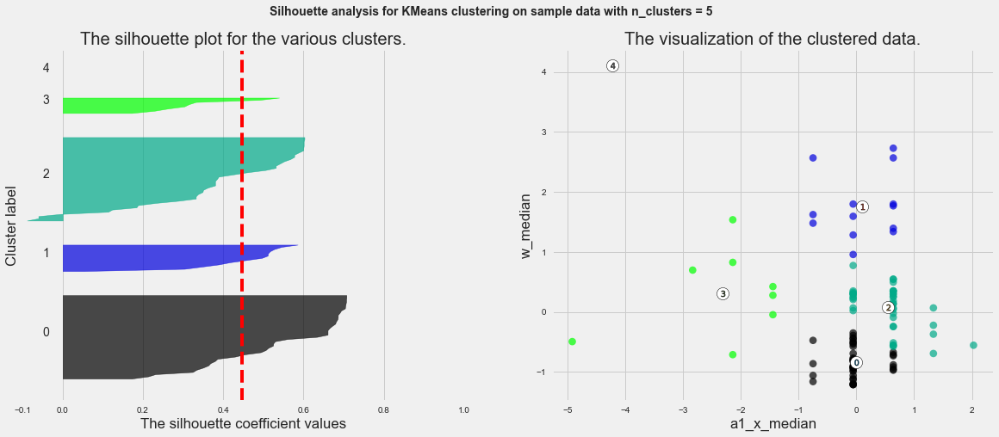

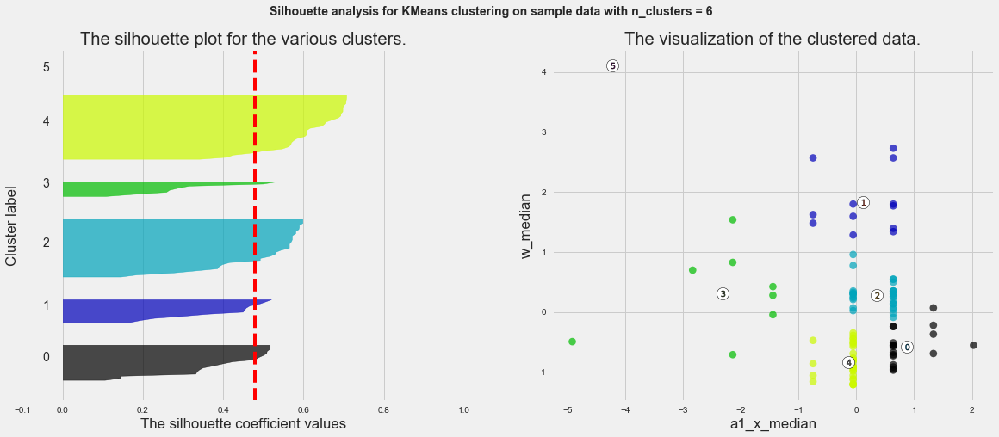

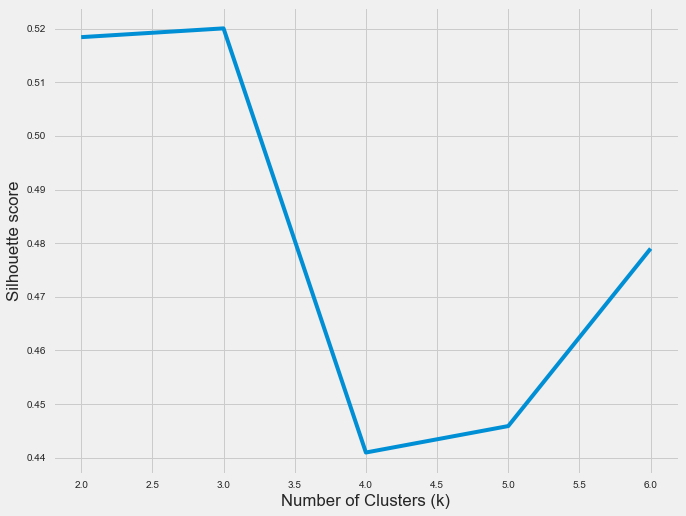

With 2-features combination of: a1_y_median, a1_z_median
for n_clusters = 2 The average silhouette_score is : 0.8220635933571497
for n_clusters = 3 The average silhouette_score is : 0.5299332901388436
for n_clusters = 4 The average silhouette_score is : 0.5286846543342937
for n_clusters = 5 The average silhouette_score is : 0.46112006287128415
for n_clusters = 6 The average silhouette_score is : 0.5273247479094054


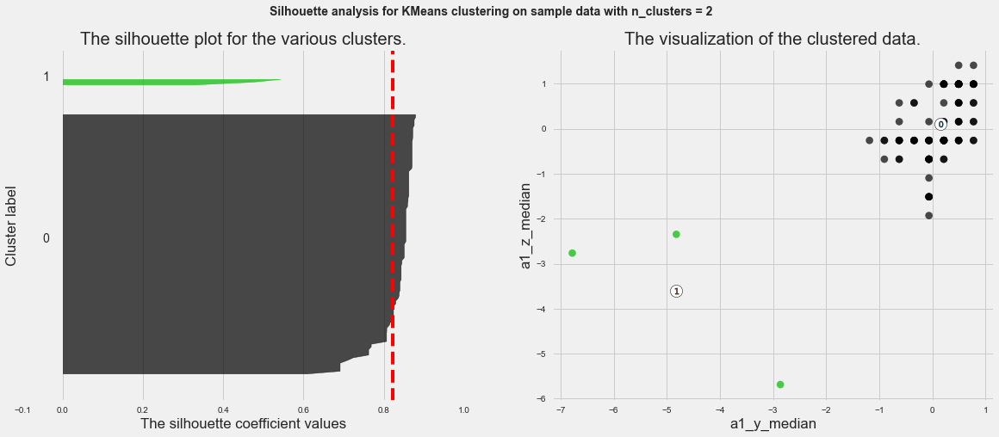

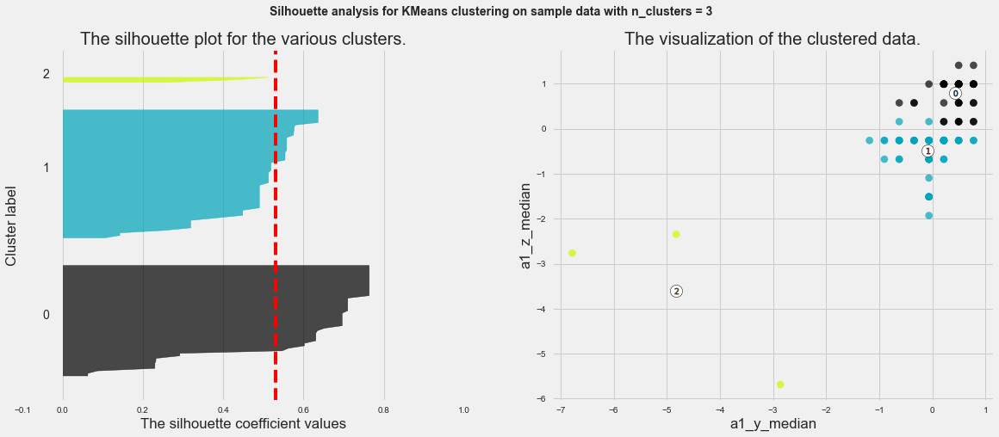

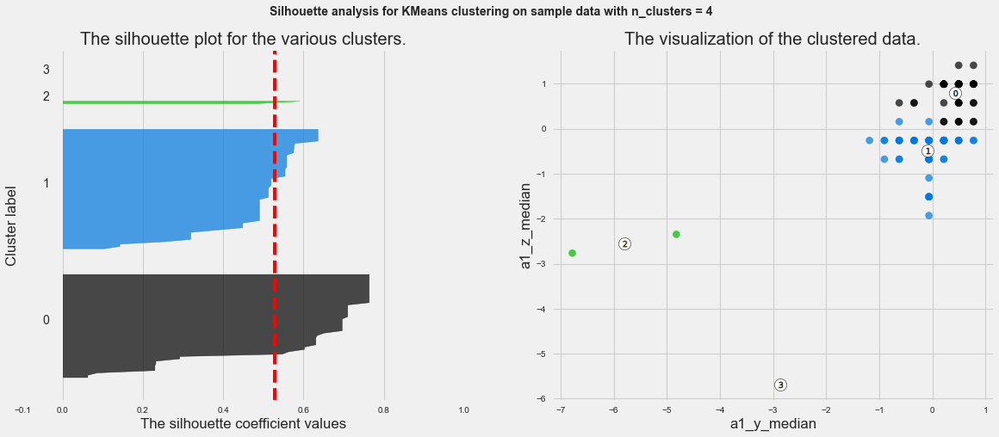

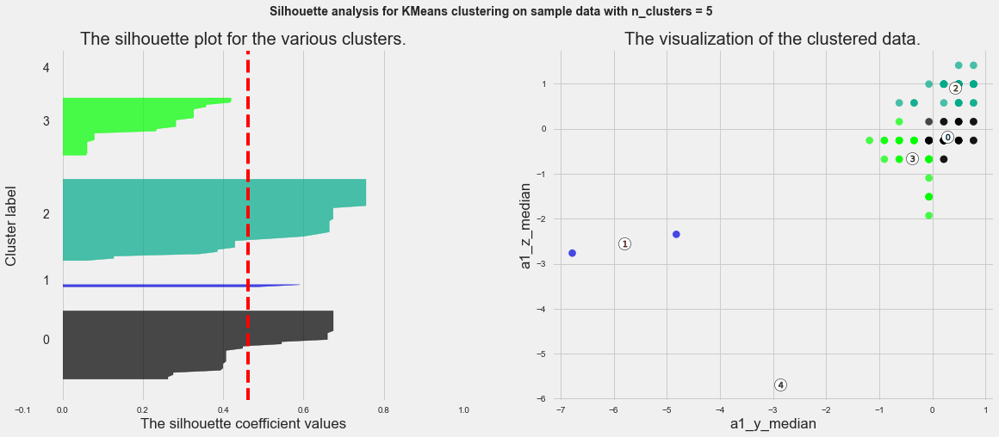

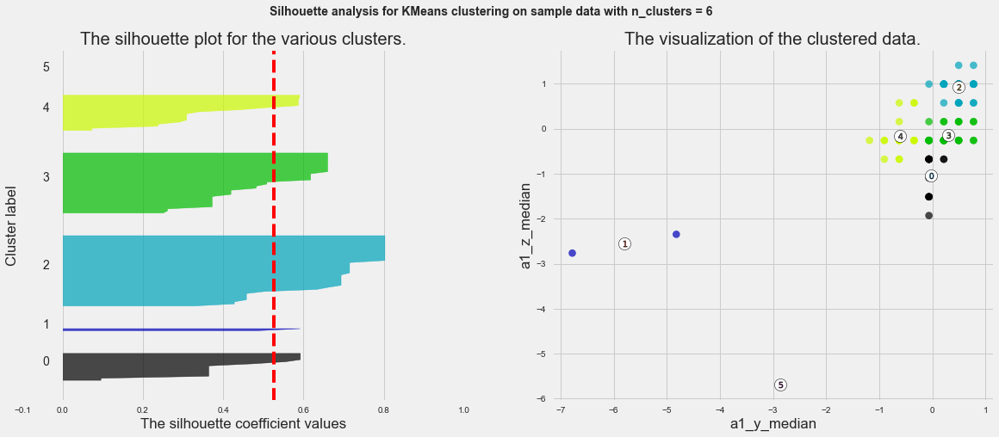

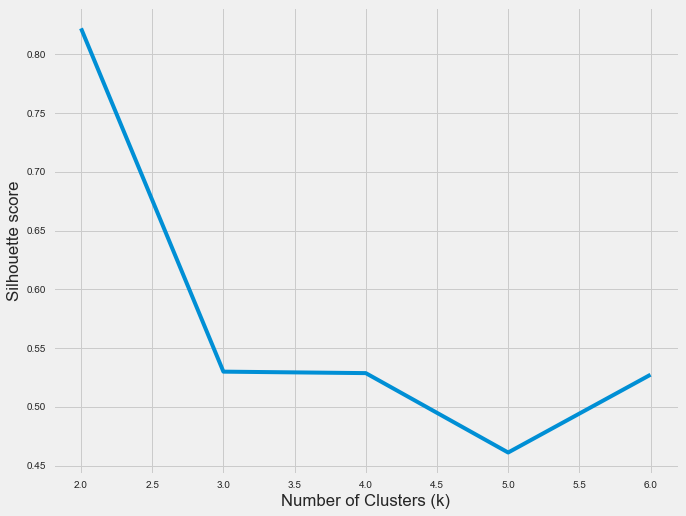

With 2-features combination of: a1_y_median, a2_x_median
for n_clusters = 2 The average silhouette_score is : 0.7318364956967623
for n_clusters = 3 The average silhouette_score is : 0.45460109593683135
for n_clusters = 4 The average silhouette_score is : 0.42059182708143167
for n_clusters = 5 The average silhouette_score is : 0.39685304687337813
for n_clusters = 6 The average silhouette_score is : 0.40467051683099947


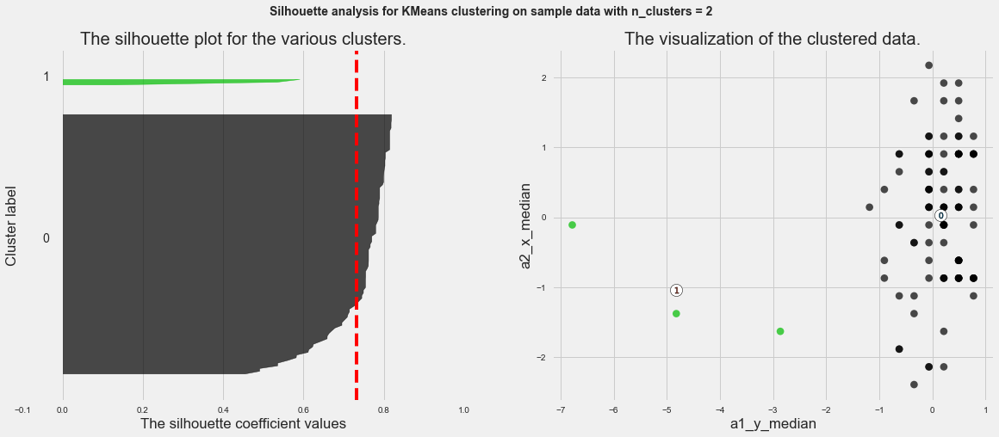

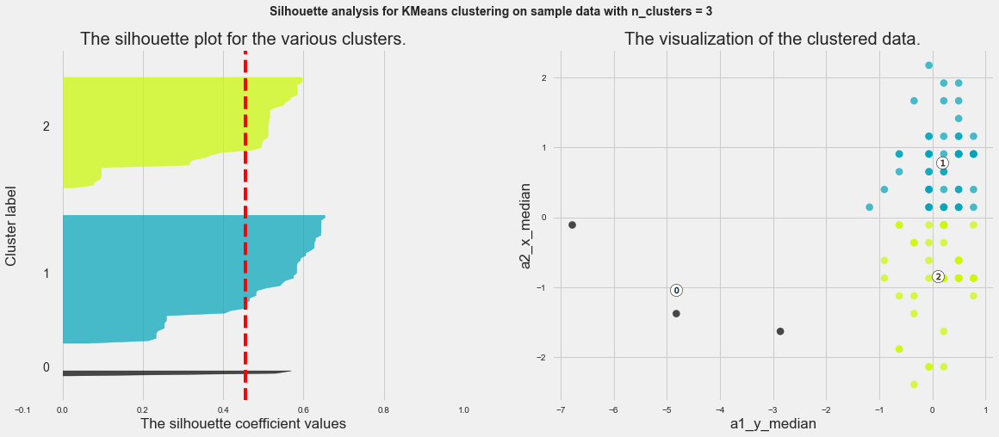

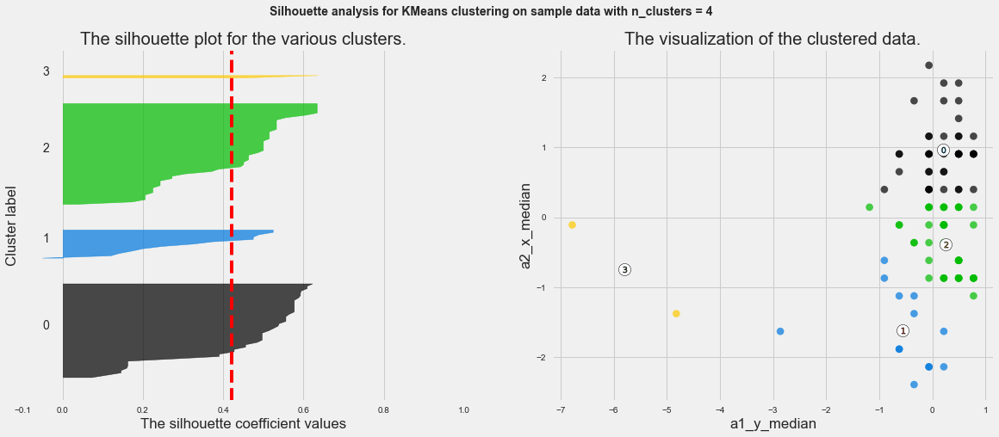

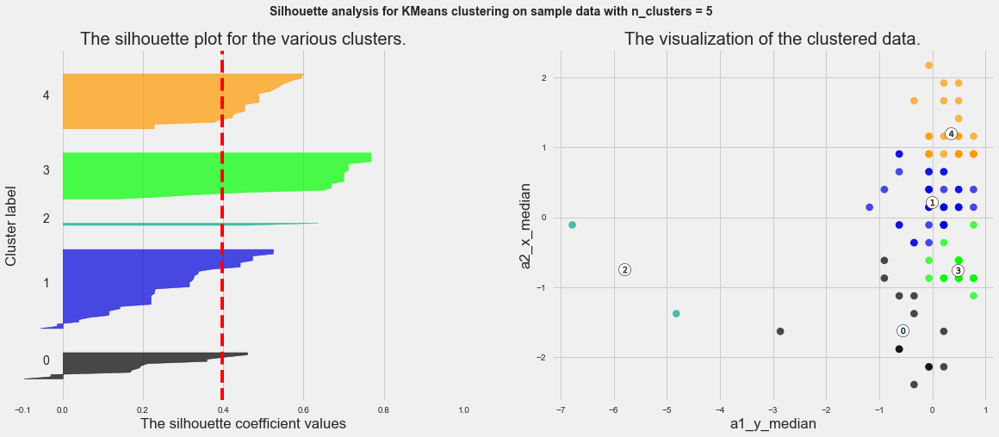

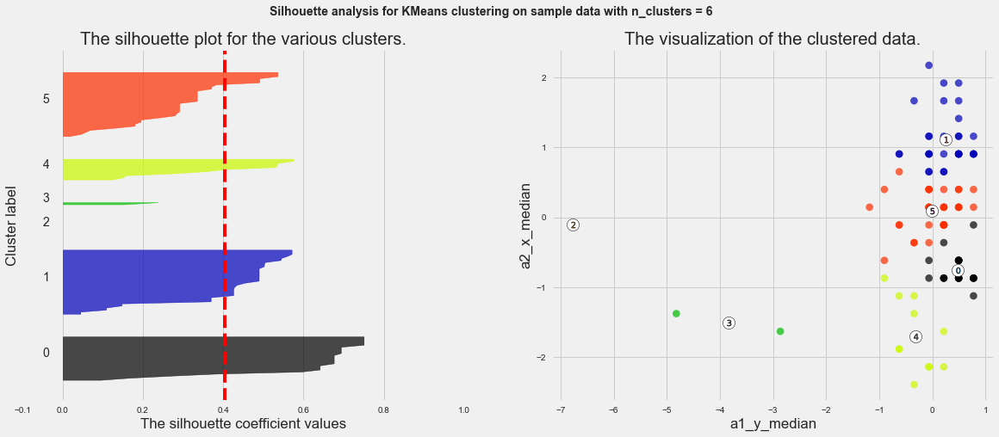

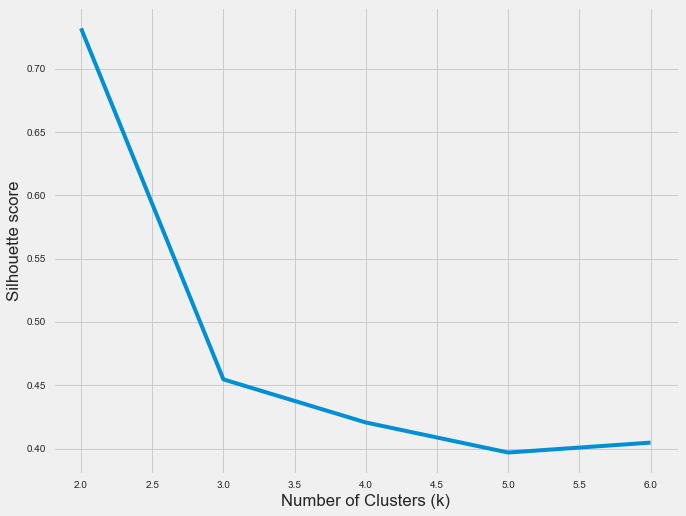

With 2-features combination of: a1_y_median, a2_y_median
for n_clusters = 2 The average silhouette_score is : 0.8732143955216094
for n_clusters = 3 The average silhouette_score is : 0.5507969392577704
for n_clusters = 4 The average silhouette_score is : 0.5450956820078522
for n_clusters = 5 The average silhouette_score is : 0.539056614069156
for n_clusters = 6 The average silhouette_score is : 0.4682222311009865


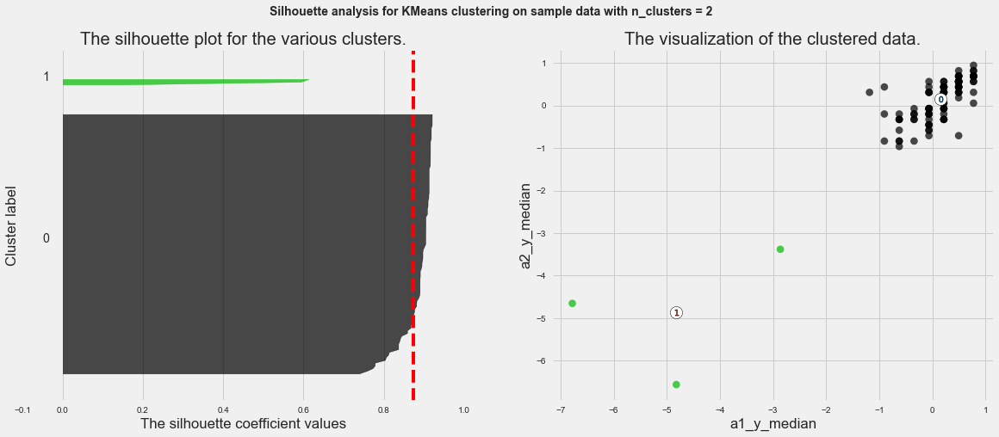

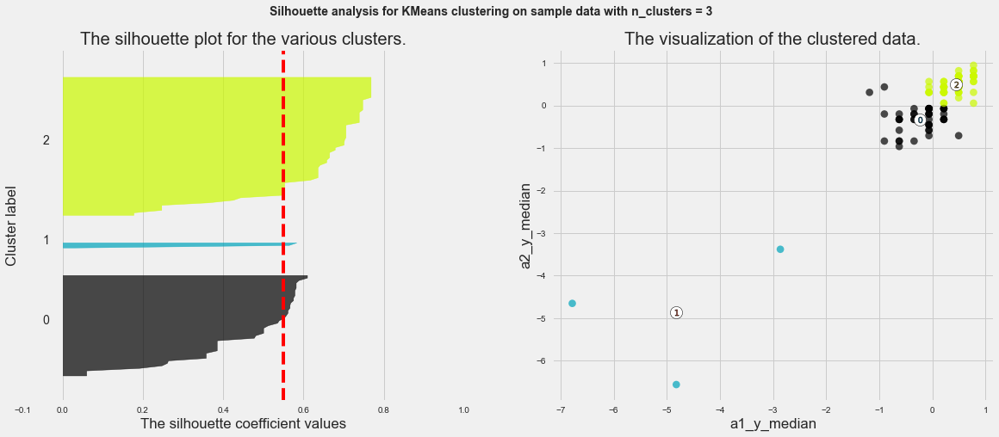

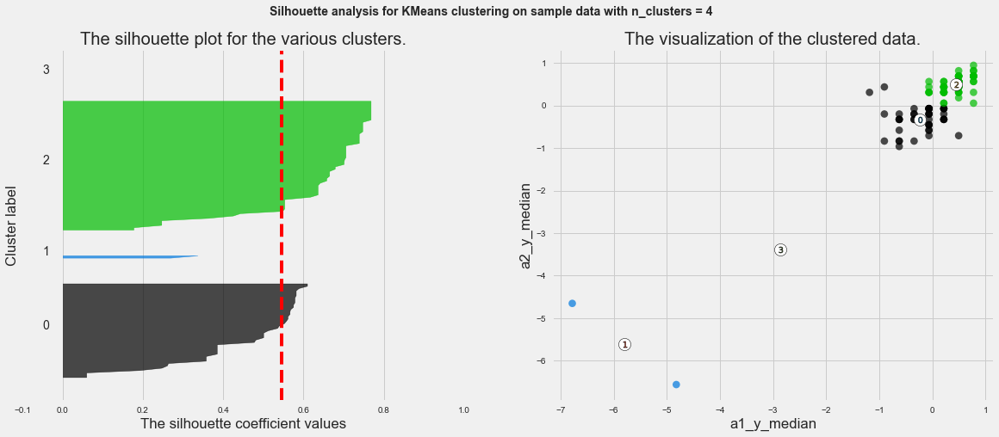

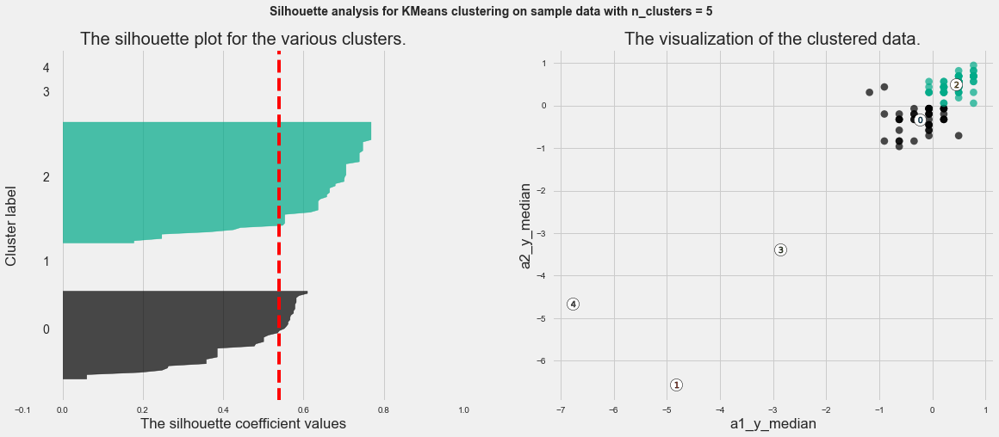

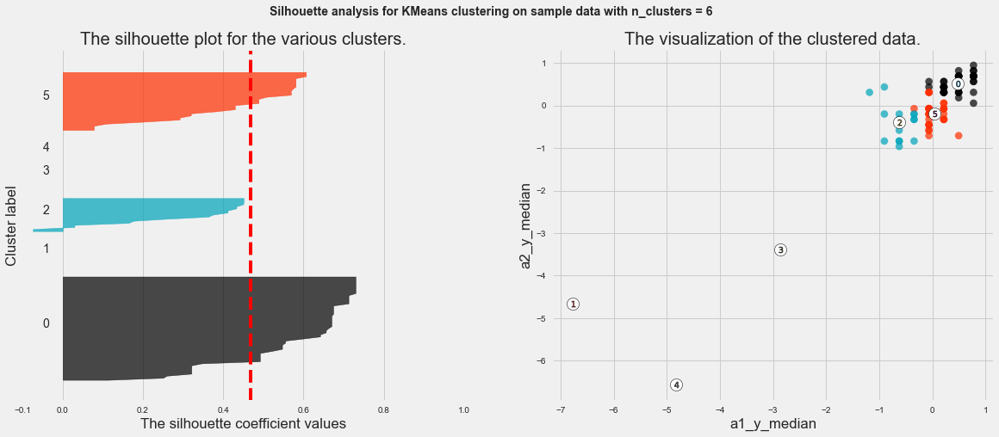

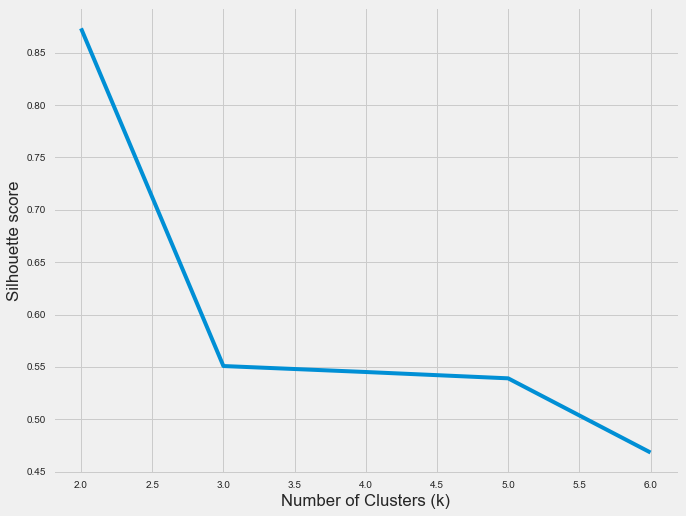

With 2-features combination of: a1_y_median, a2_z_median
for n_clusters = 2 The average silhouette_score is : 0.838948060129746
for n_clusters = 3 The average silhouette_score is : 0.838091305686501
for n_clusters = 4 The average silhouette_score is : 0.4042514195940462
for n_clusters = 5 The average silhouette_score is : 0.41228546406173466
for n_clusters = 6 The average silhouette_score is : 0.37969454807720576


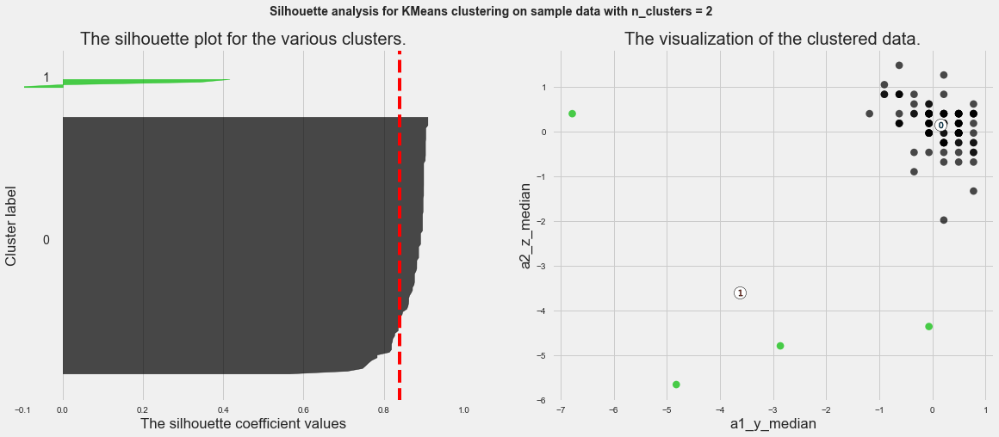

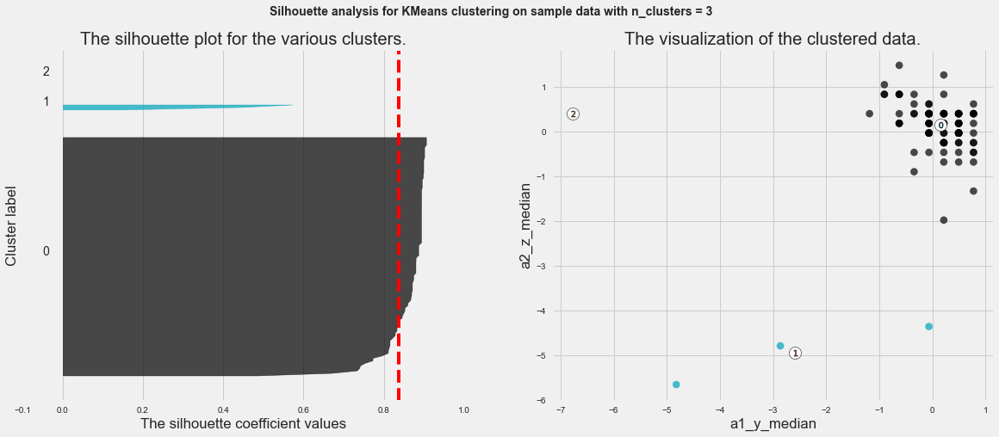

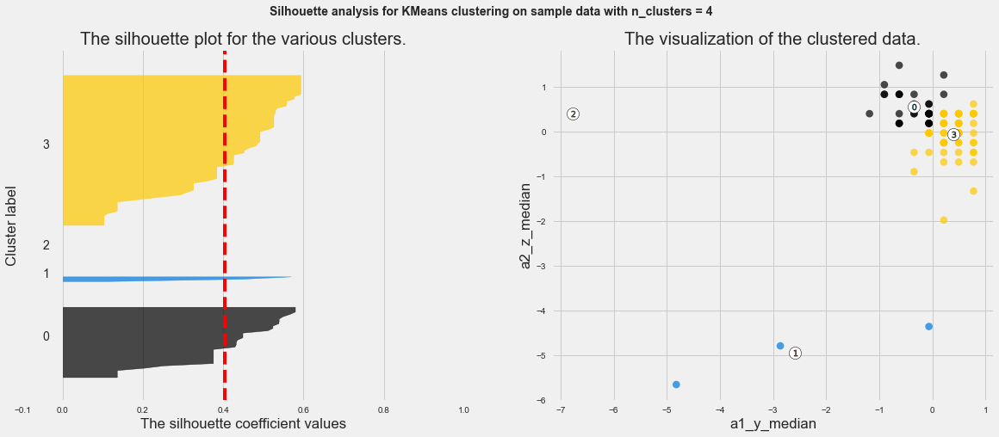

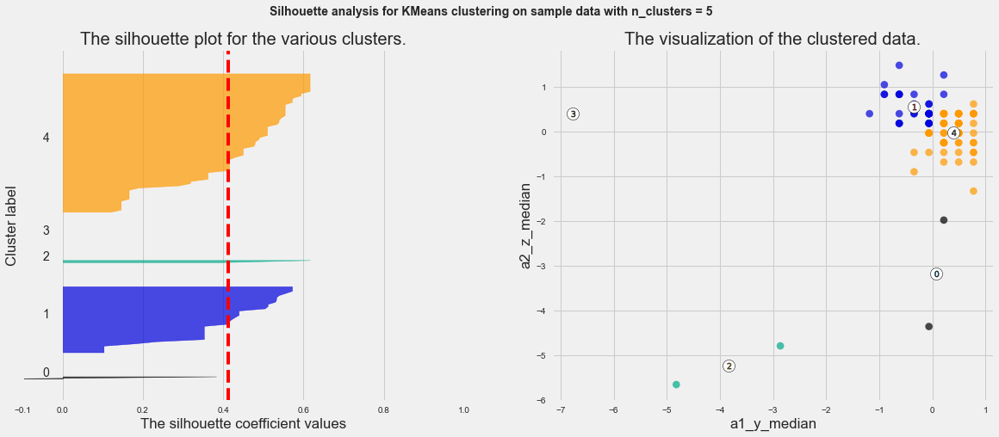

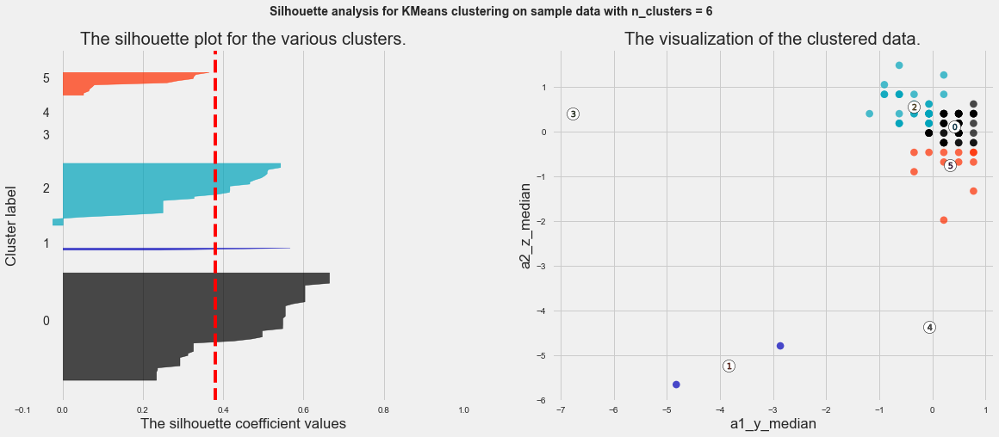

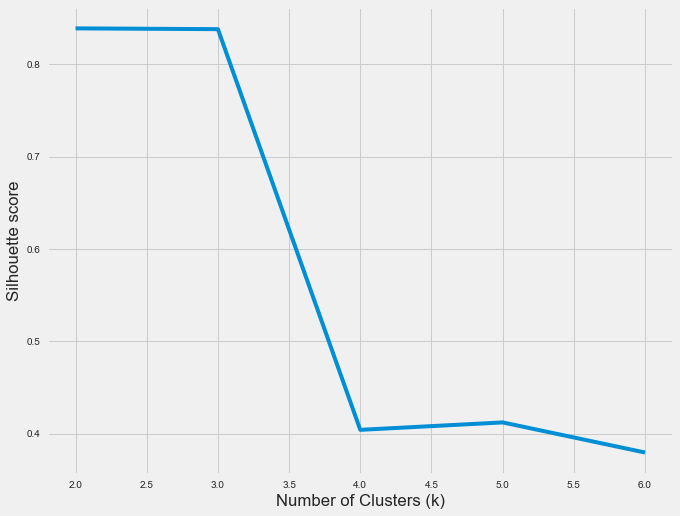

With 2-features combination of: a1_y_median, hert_median
for n_clusters = 2 The average silhouette_score is : 0.7799821692066644
for n_clusters = 3 The average silhouette_score is : 0.7182633854545872
for n_clusters = 4 The average silhouette_score is : 0.7720714205797446
for n_clusters = 5 The average silhouette_score is : 0.6565109320143239
for n_clusters = 6 The average silhouette_score is : 0.6503716922473555


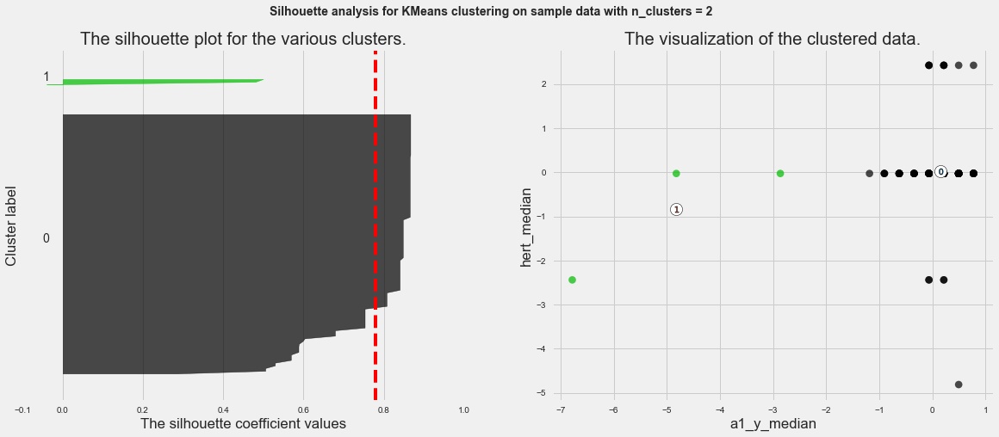

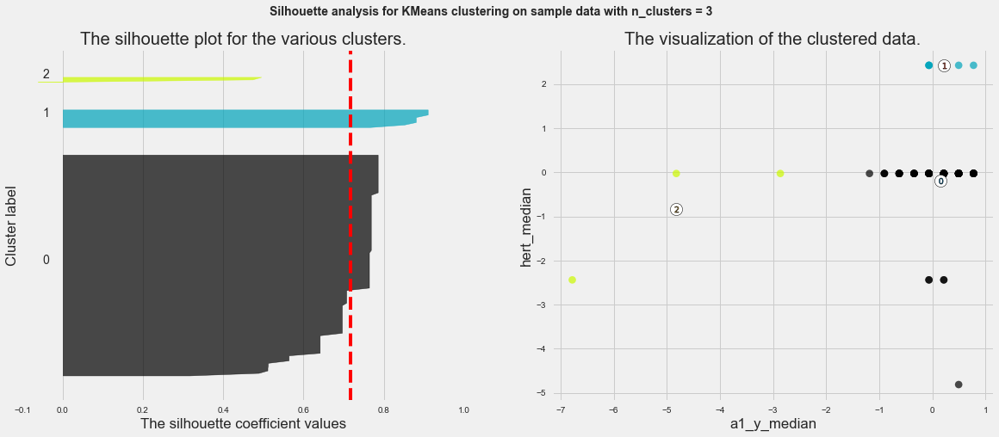

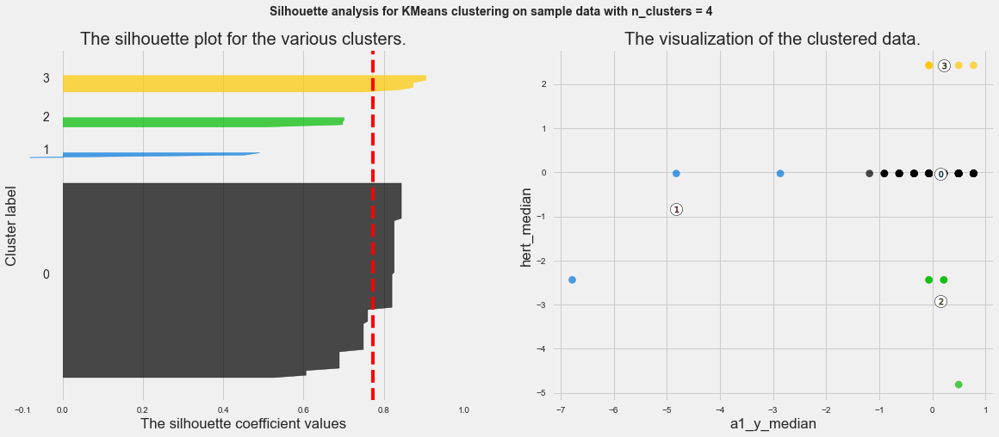

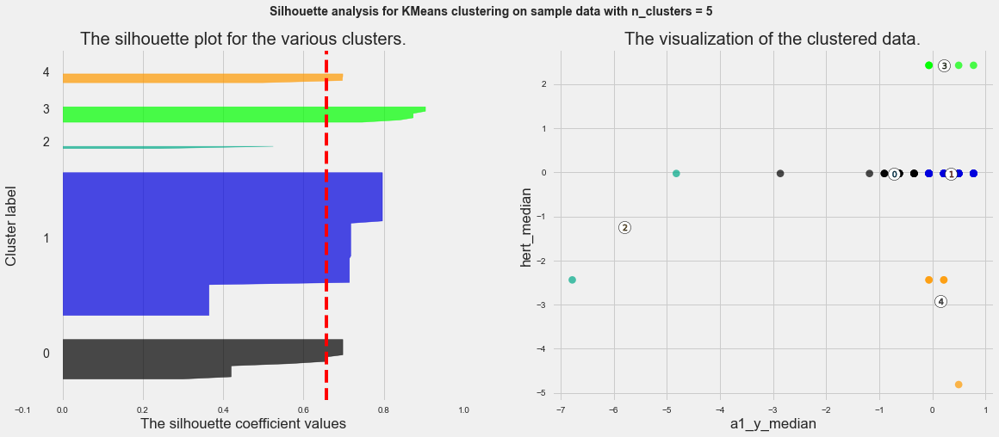

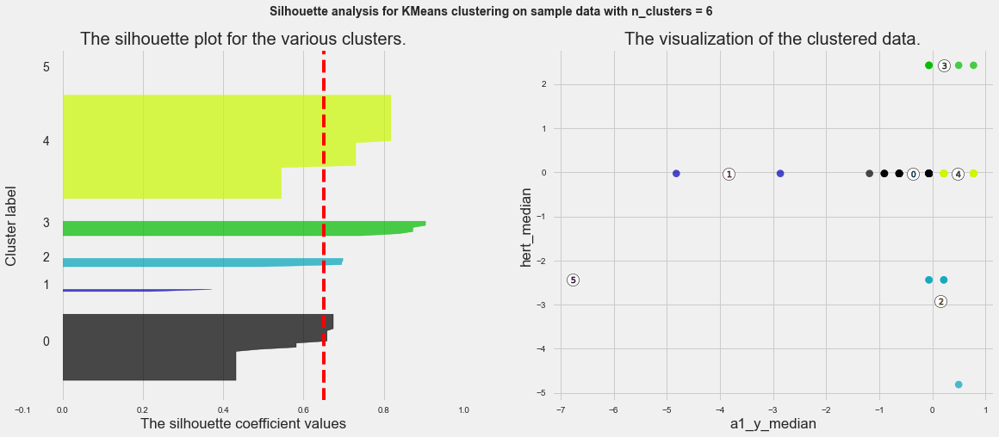

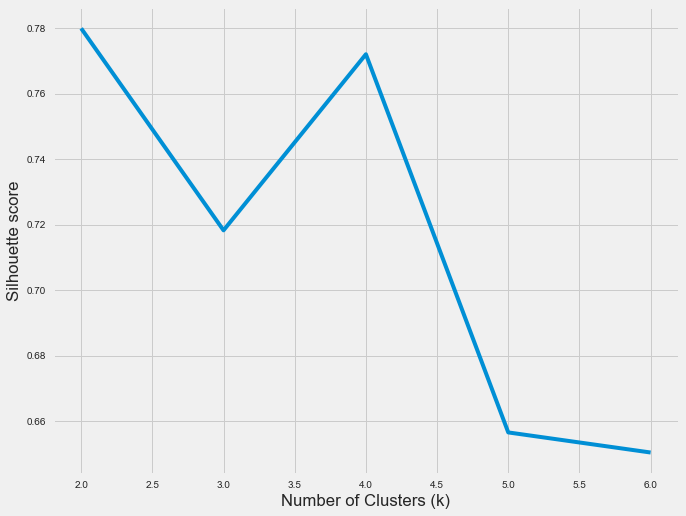

With 2-features combination of: a1_y_median, w_median
for n_clusters = 2 The average silhouette_score is : 0.7521940333721221
for n_clusters = 3 The average silhouette_score is : 0.5251406070552196
for n_clusters = 4 The average silhouette_score is : 0.4399388398790159
for n_clusters = 5 The average silhouette_score is : 0.444059521563867
for n_clusters = 6 The average silhouette_score is : 0.4968832459667917


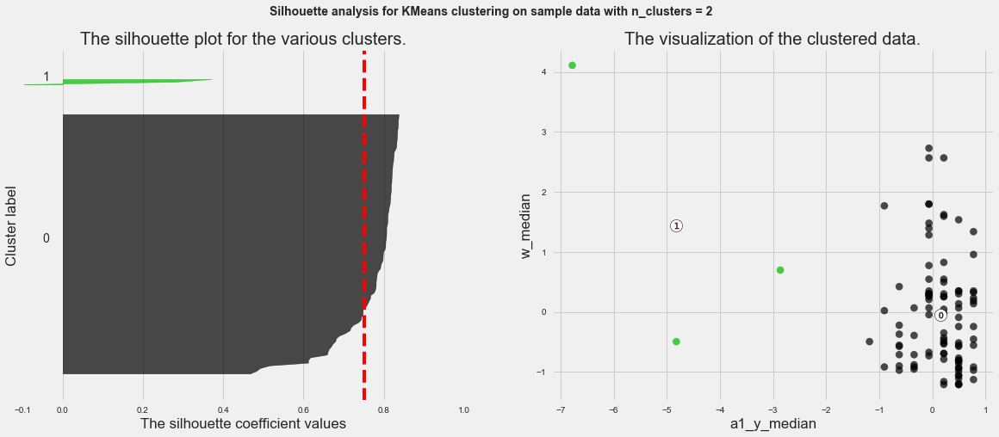

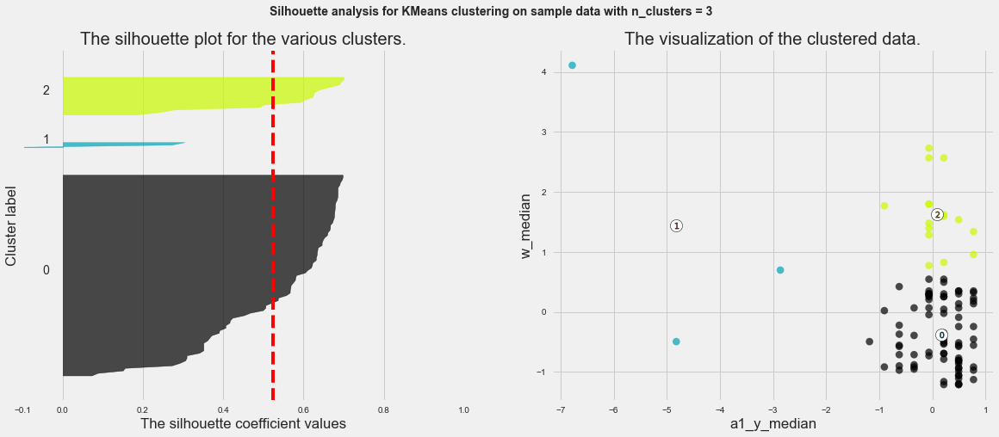

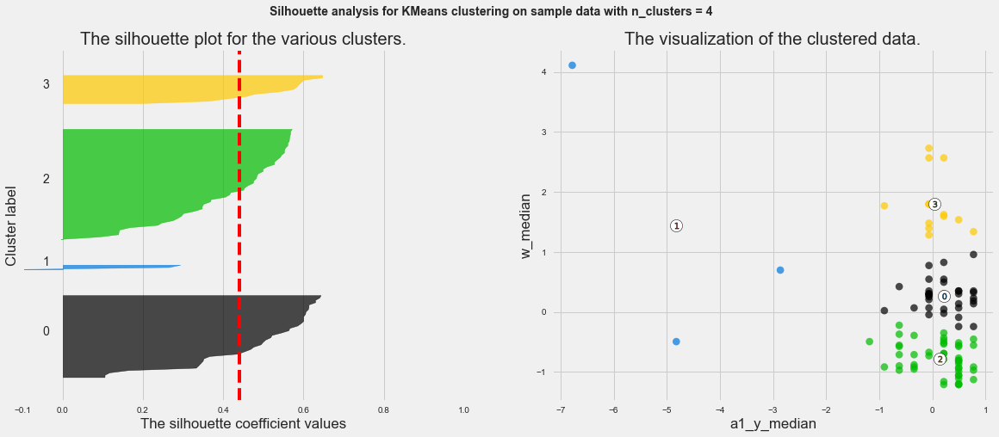

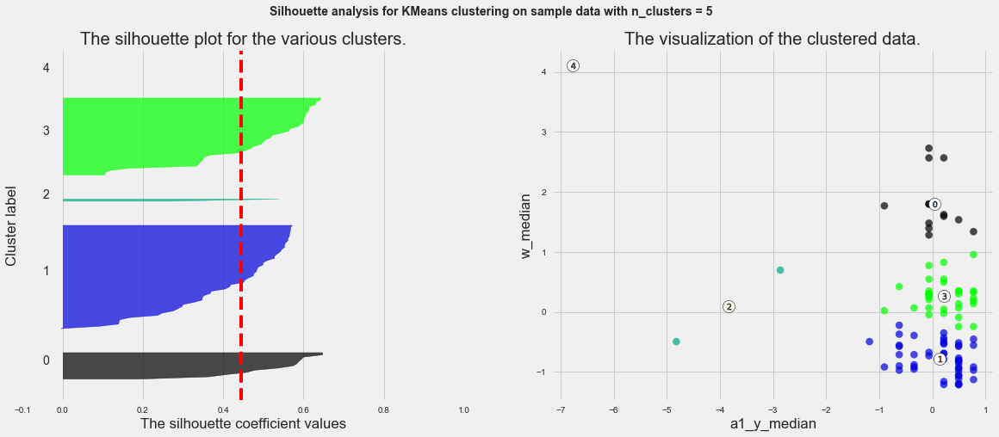

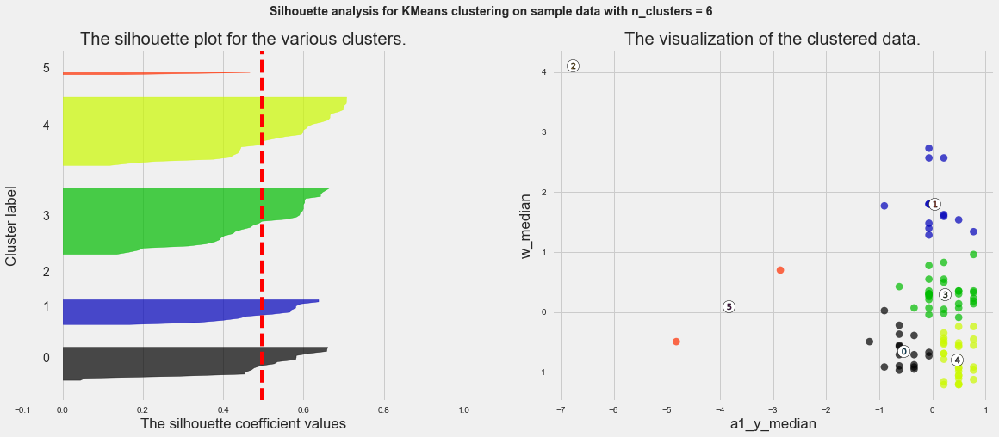

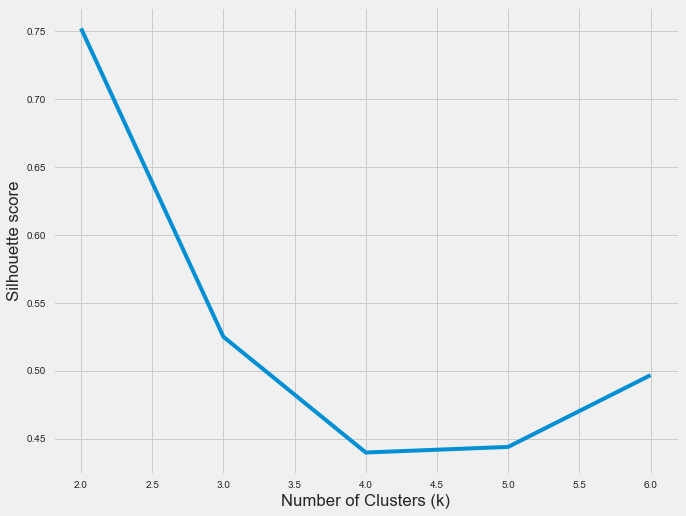

With 2-features combination of: a1_z_median, a2_x_median
for n_clusters = 2 The average silhouette_score is : 0.37417369489554375
for n_clusters = 3 The average silhouette_score is : 0.3943020427442162
for n_clusters = 4 The average silhouette_score is : 0.41864140350457313
for n_clusters = 5 The average silhouette_score is : 0.40972435900998844
for n_clusters = 6 The average silhouette_score is : 0.41991031774966153


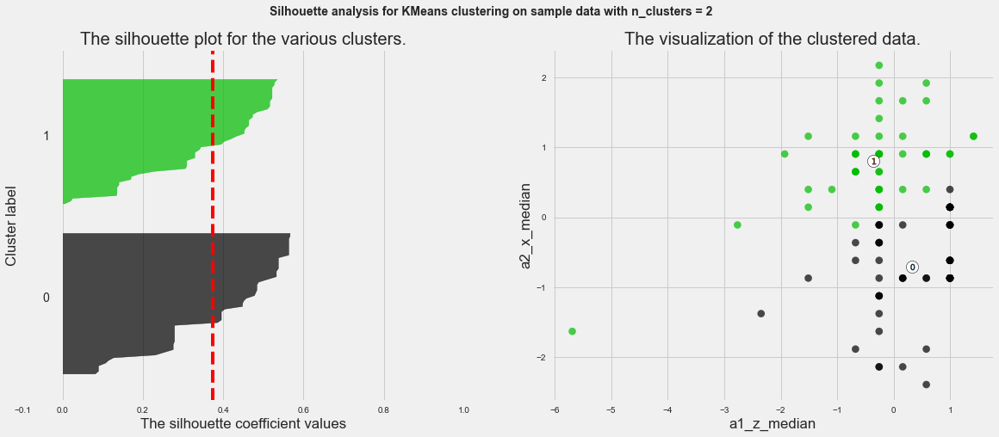

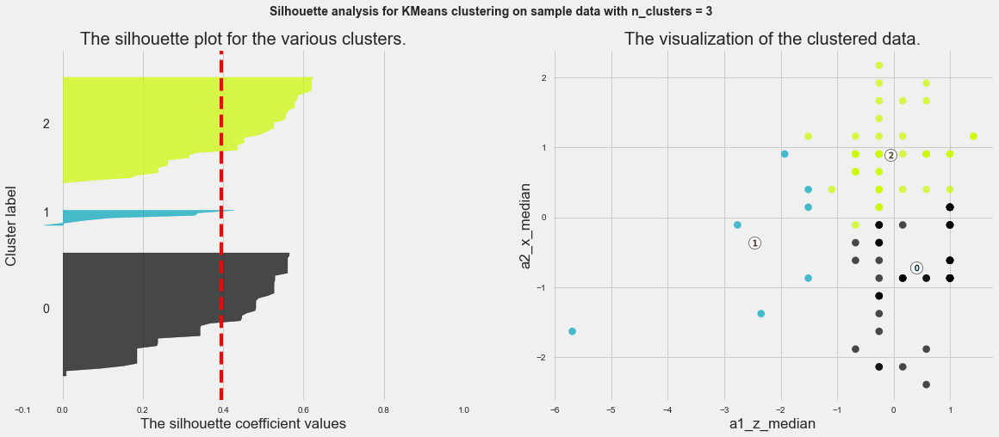

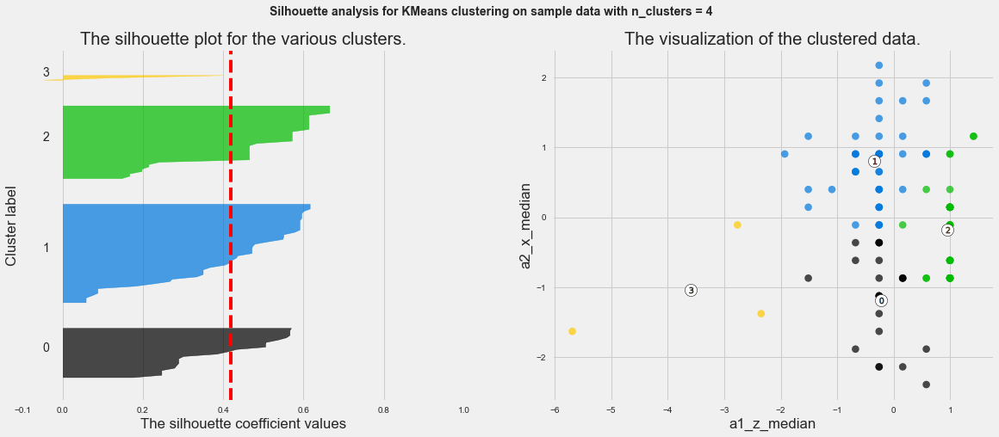

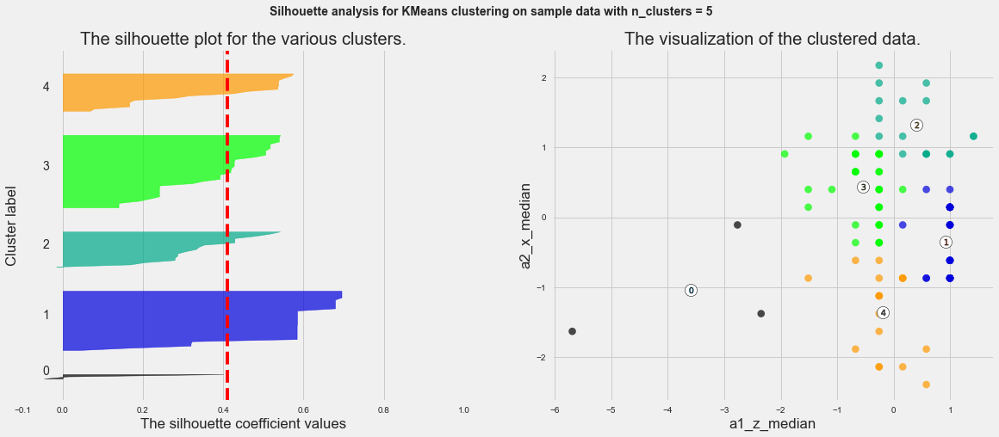

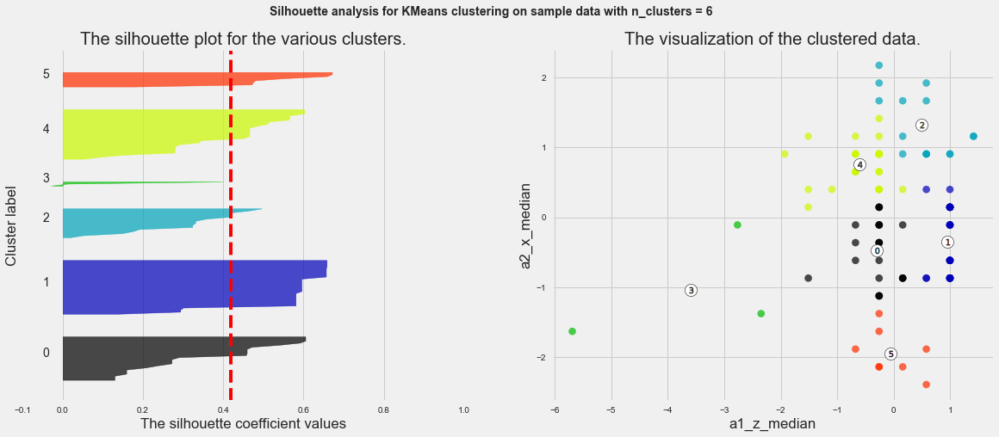

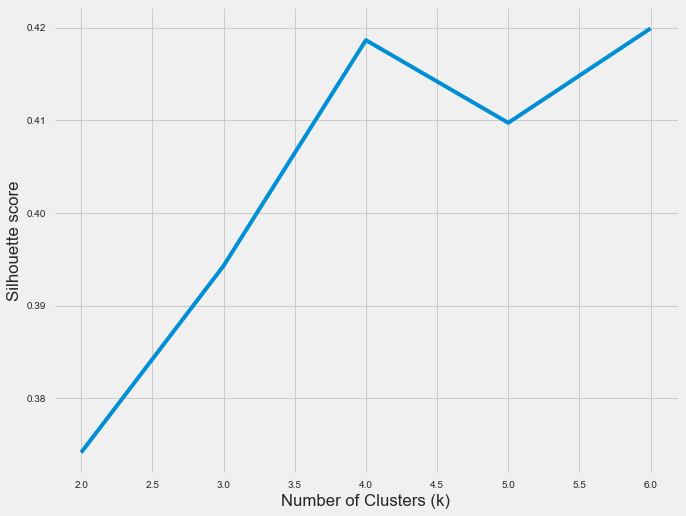

With 2-features combination of: a1_z_median, a2_y_median
for n_clusters = 2 The average silhouette_score is : 0.8231353859436669
for n_clusters = 3 The average silhouette_score is : 0.5666911457022182
for n_clusters = 4 The average silhouette_score is : 0.5624454476970747
for n_clusters = 5 The average silhouette_score is : 0.551053453129391
for n_clusters = 6 The average silhouette_score is : 0.5173136087649519


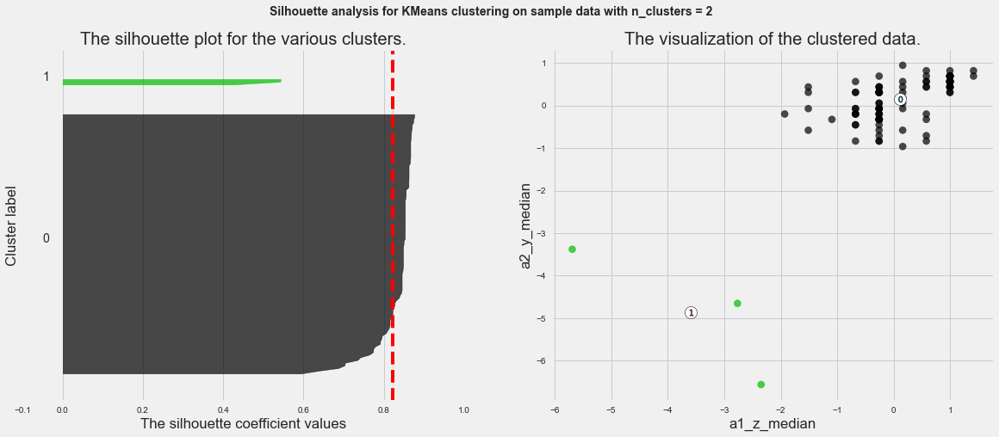

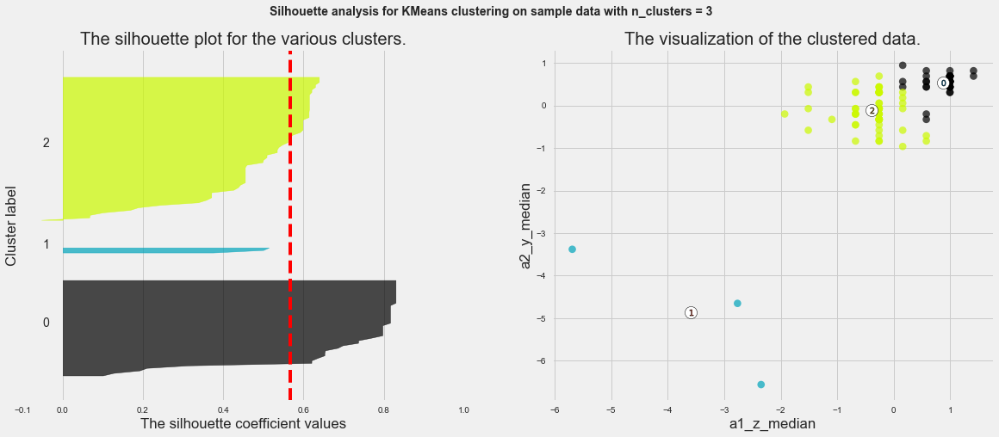

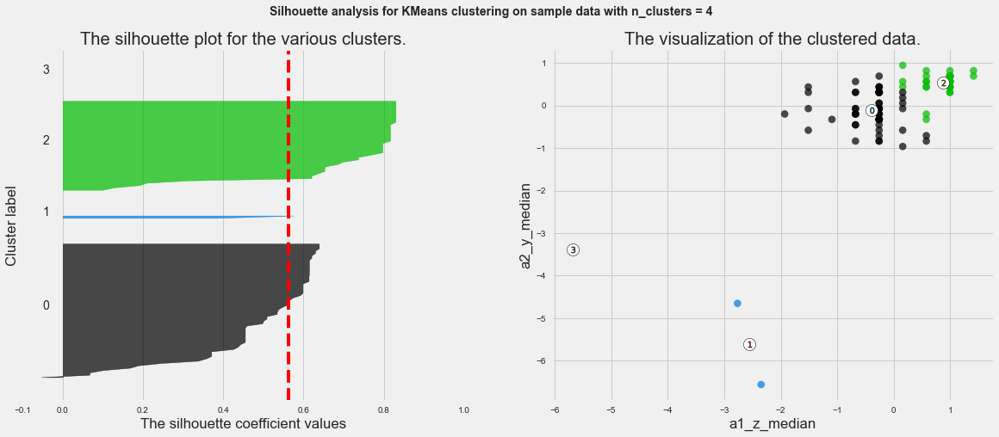

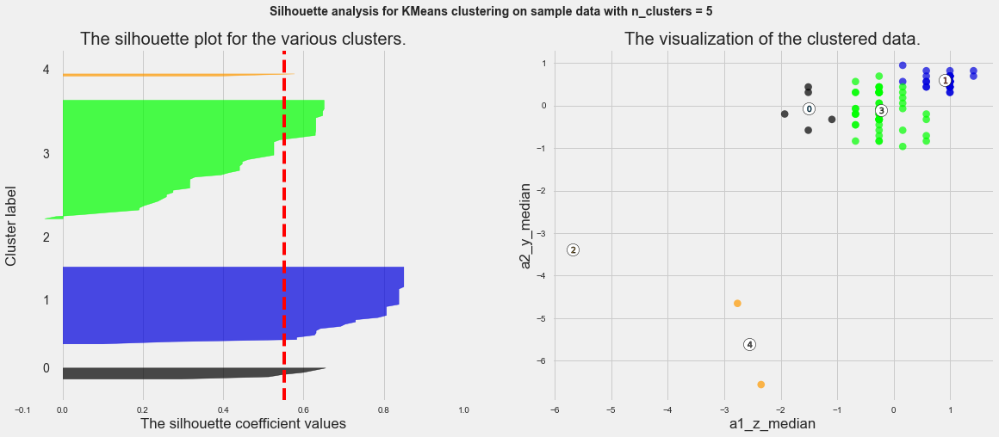

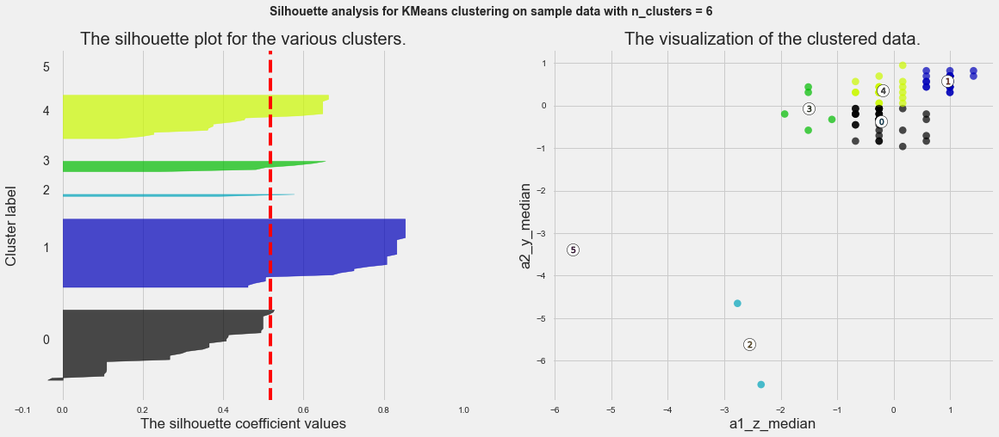

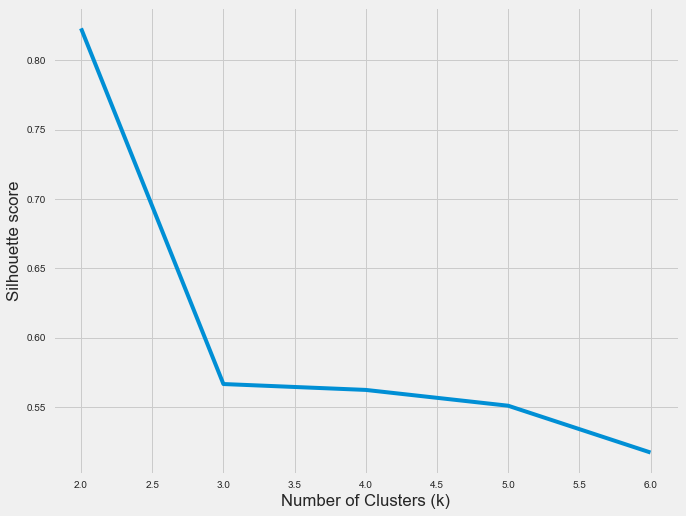

With 2-features combination of: a1_z_median, a2_z_median
for n_clusters = 2 The average silhouette_score is : 0.8083492140778601
for n_clusters = 3 The average silhouette_score is : 0.4850990349395504
for n_clusters = 4 The average silhouette_score is : 0.49007599536006424
for n_clusters = 5 The average silhouette_score is : 0.48872201333857246
for n_clusters = 6 The average silhouette_score is : 0.4201098287495092


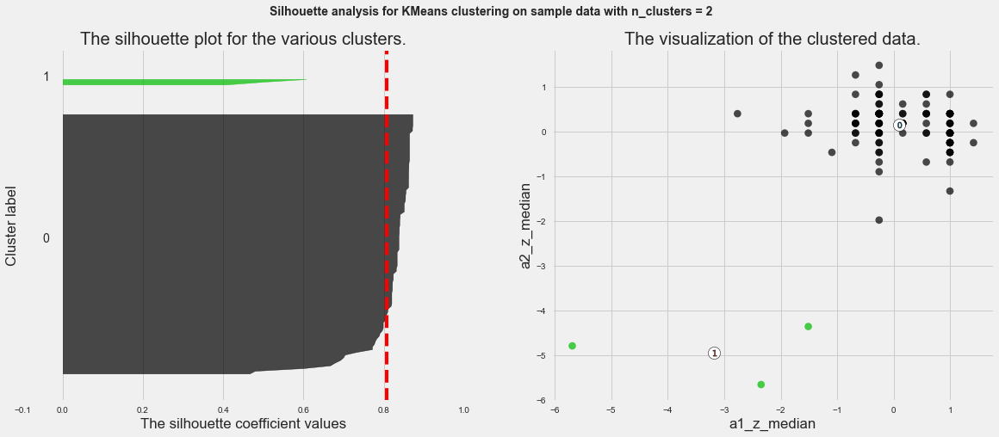

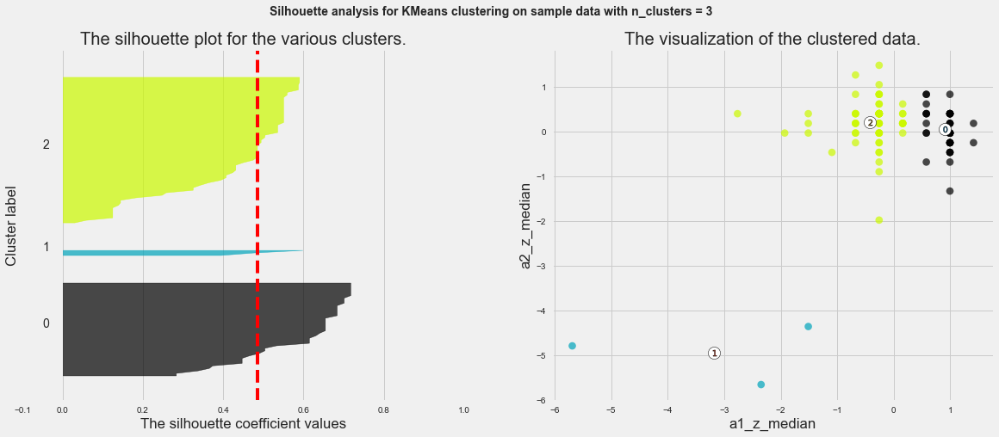

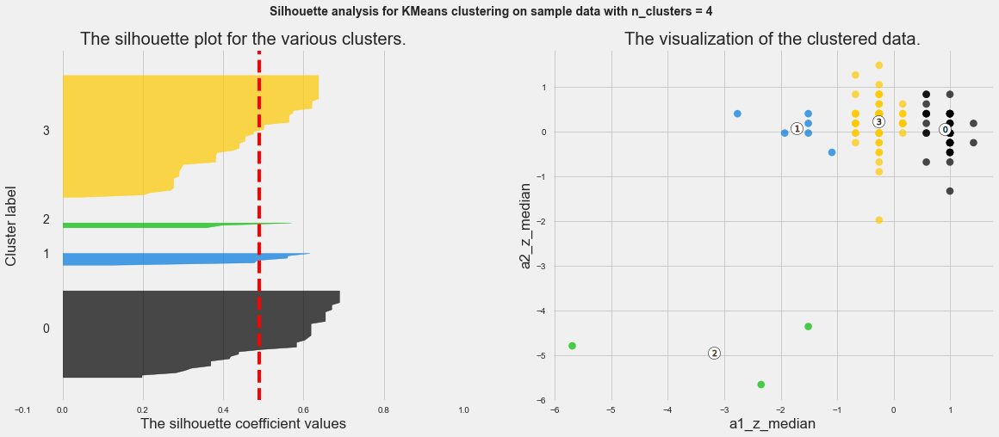

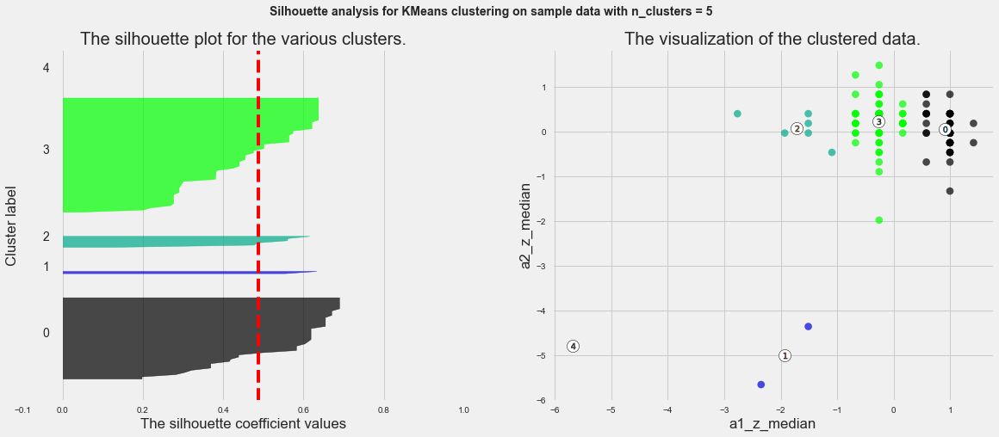

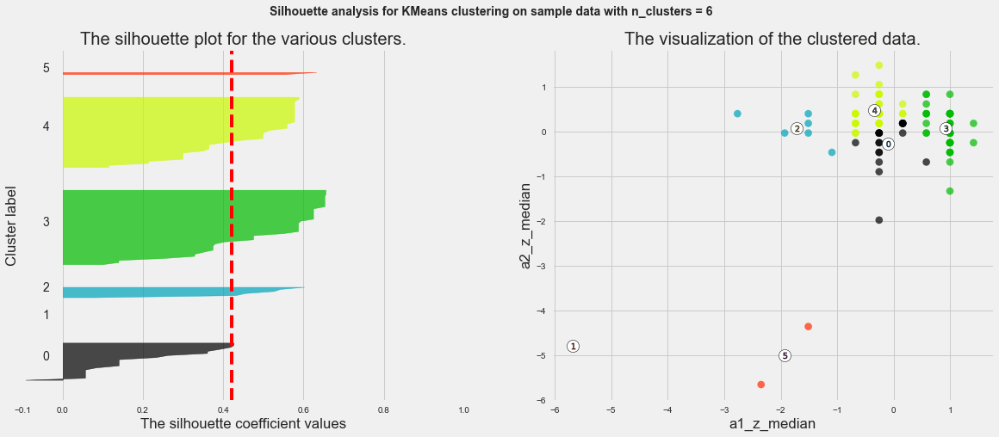

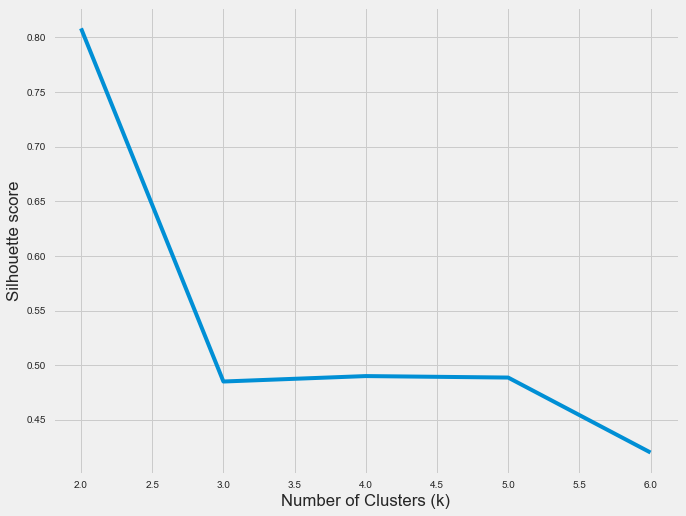

With 2-features combination of: a1_z_median, hert_median
for n_clusters = 2 The average silhouette_score is : 0.6521665851127554
for n_clusters = 3 The average silhouette_score is : 0.6478341537949868
for n_clusters = 4 The average silhouette_score is : 0.6128996737618726
for n_clusters = 5 The average silhouette_score is : 0.6748910966390502
for n_clusters = 6 The average silhouette_score is : 0.7020833789832863


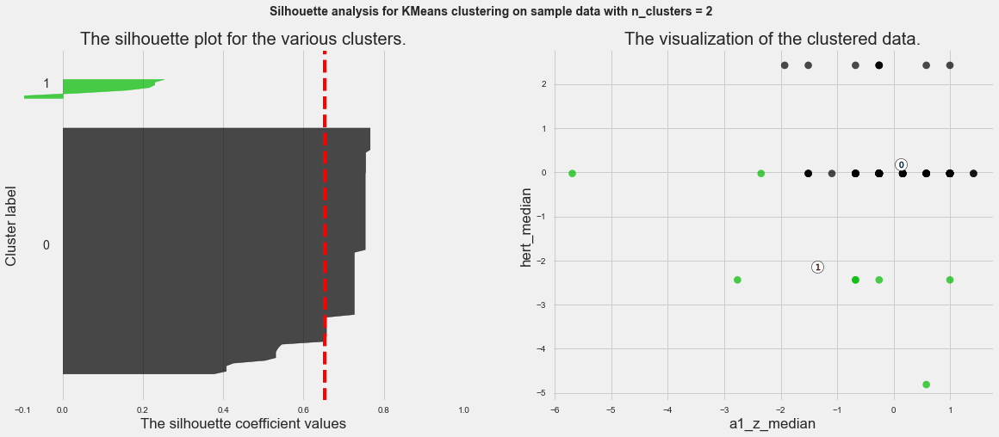

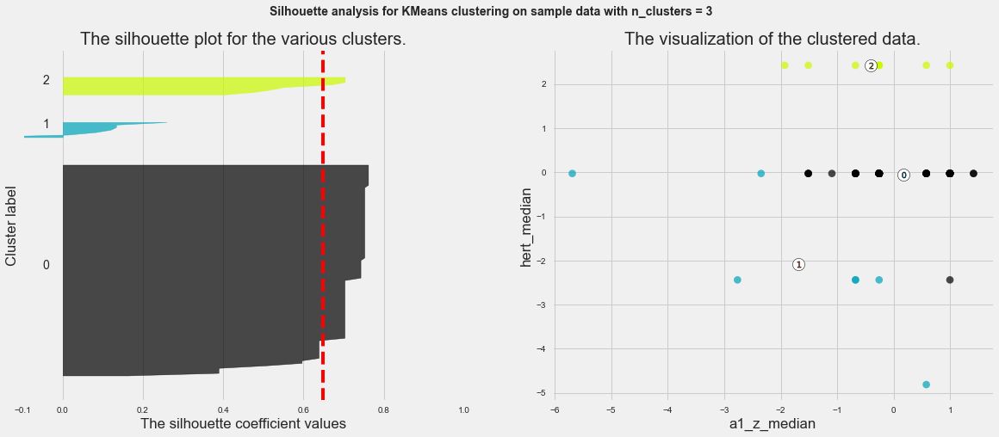

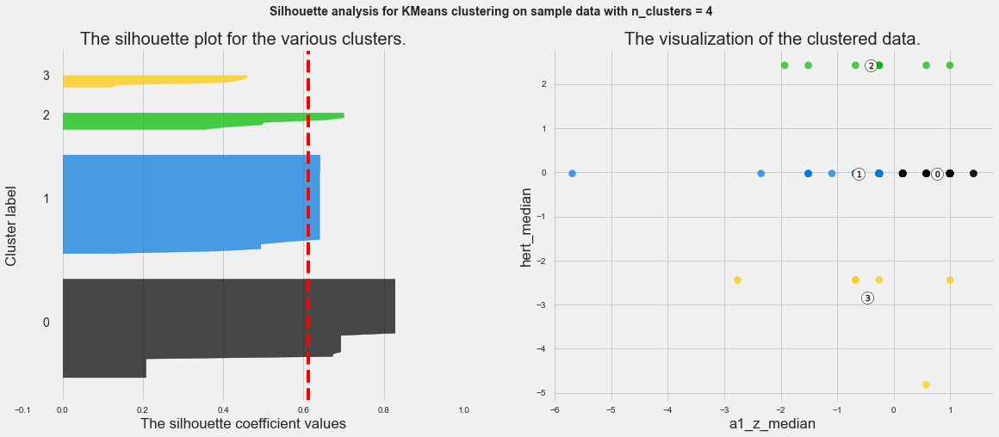

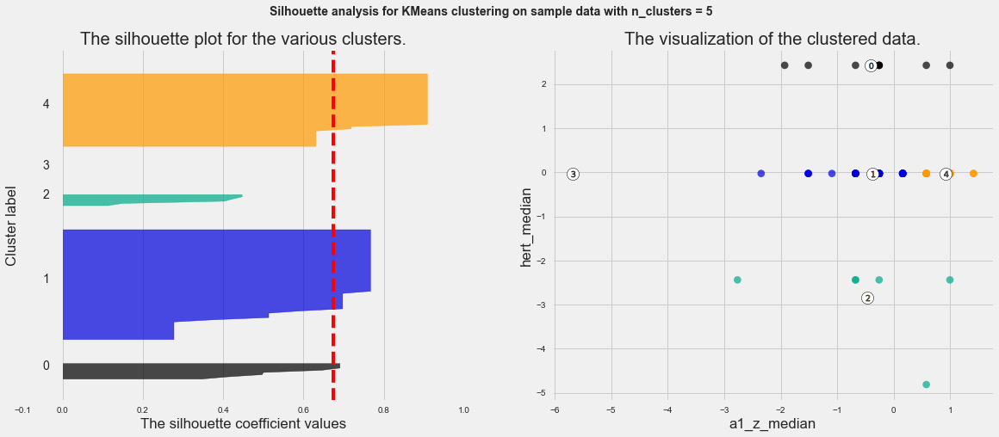

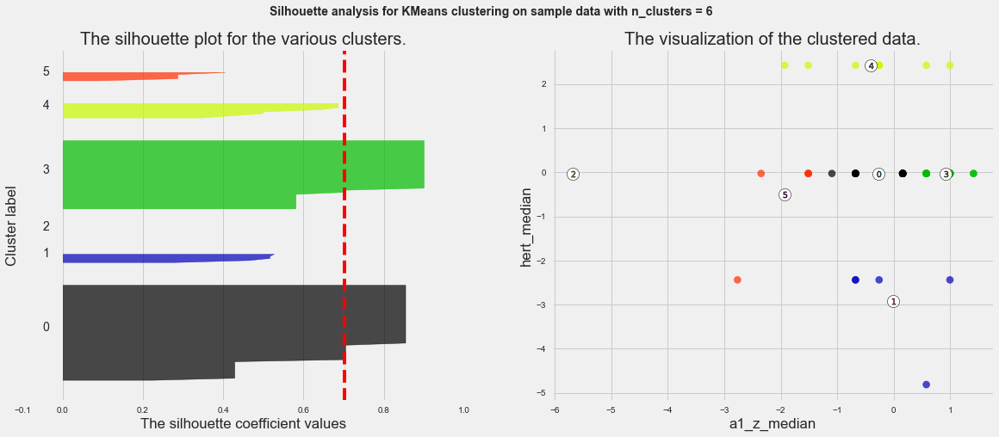

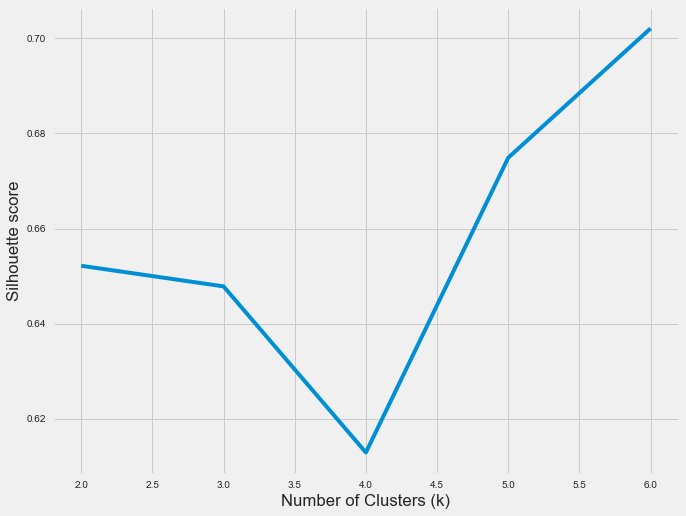

With 2-features combination of: a1_z_median, w_median
for n_clusters = 2 The average silhouette_score is : 0.47106461093542057
for n_clusters = 3 The average silhouette_score is : 0.4393895752199384
for n_clusters = 4 The average silhouette_score is : 0.4785788978178149
for n_clusters = 5 The average silhouette_score is : 0.4473603973516348
for n_clusters = 6 The average silhouette_score is : 0.4680684912895196


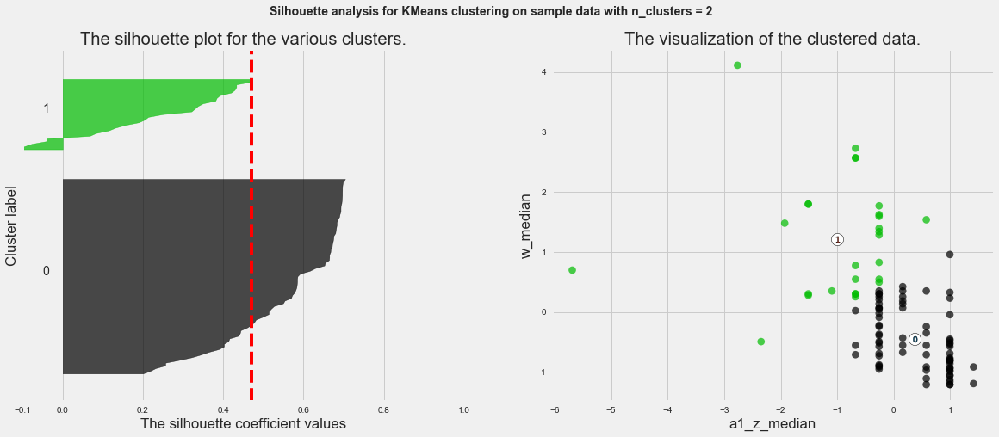

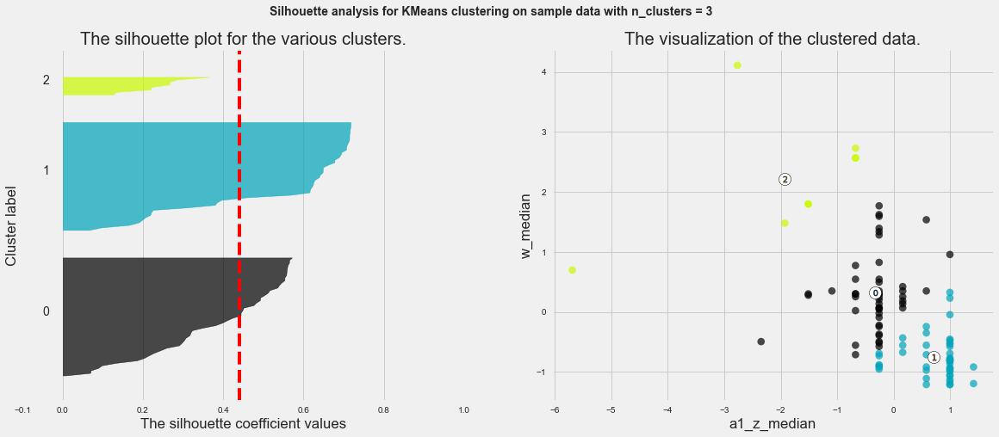

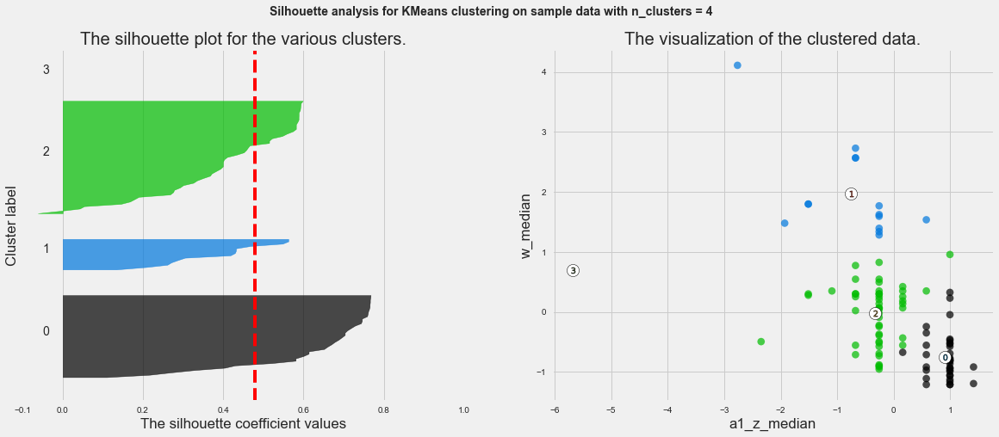

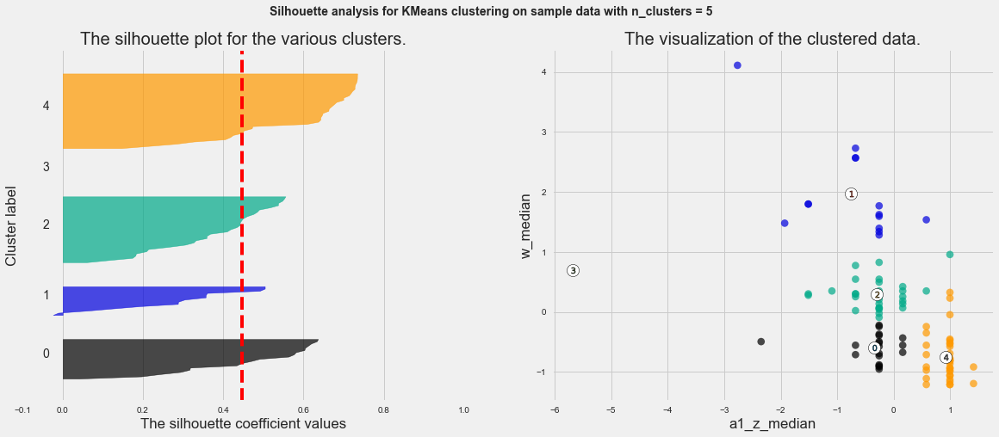

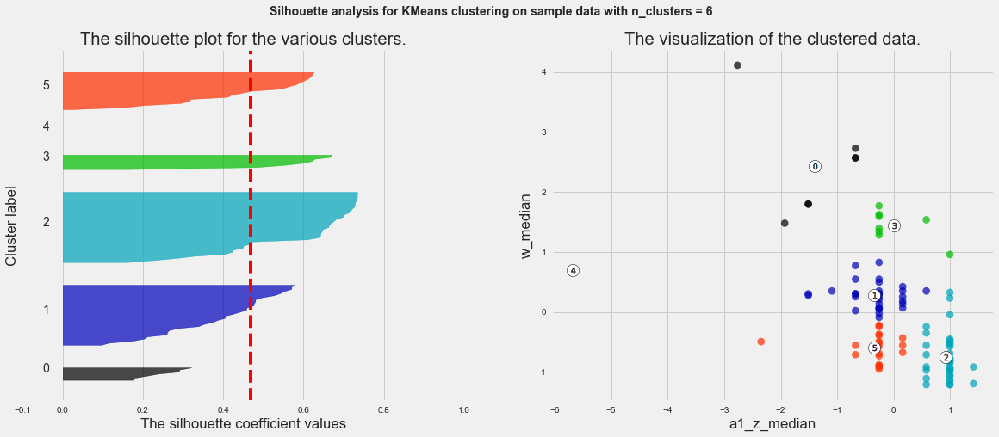

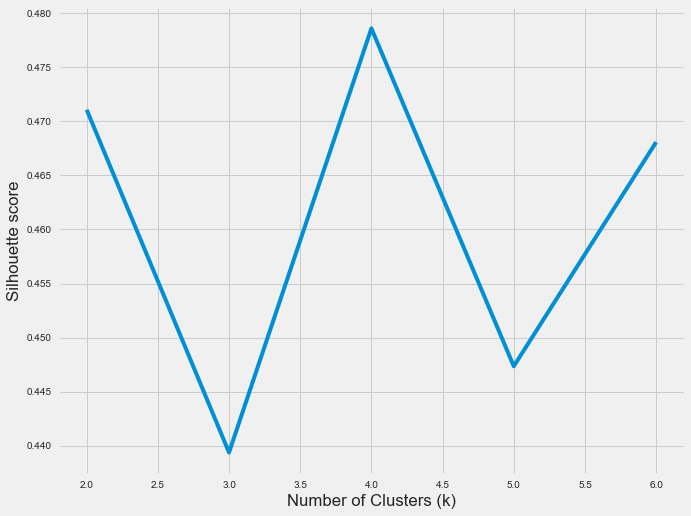

With 2-features combination of: a2_x_median, a2_y_median
for n_clusters = 2 The average silhouette_score is : 0.4336153154590667
for n_clusters = 3 The average silhouette_score is : 0.4701927645778233
for n_clusters = 4 The average silhouette_score is : 0.40935990543128364
for n_clusters = 5 The average silhouette_score is : 0.40570486628743374
for n_clusters = 6 The average silhouette_score is : 0.4268060170298613


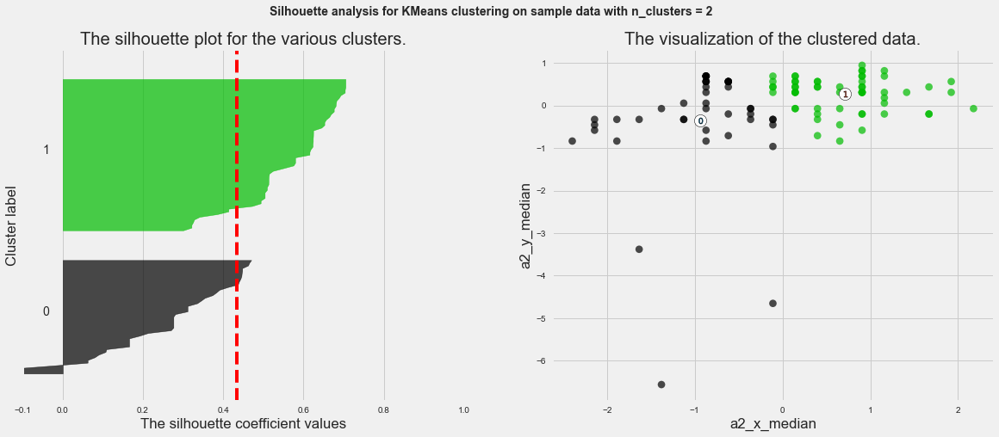

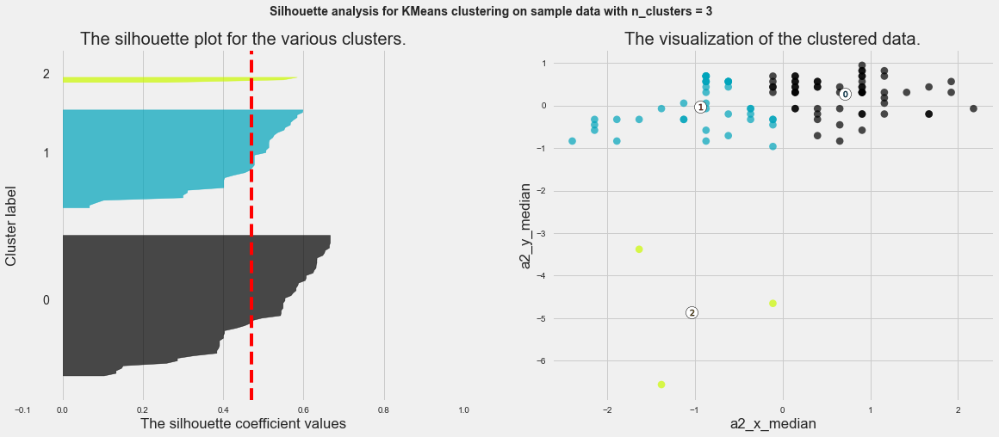

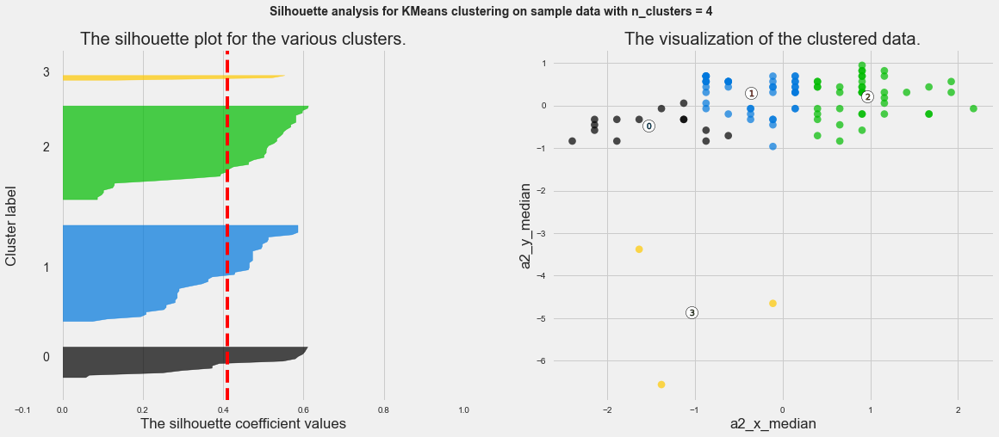

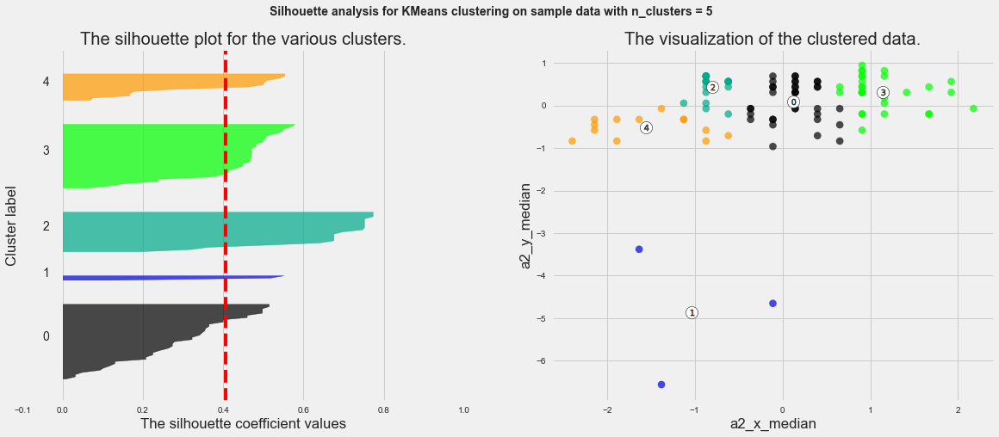

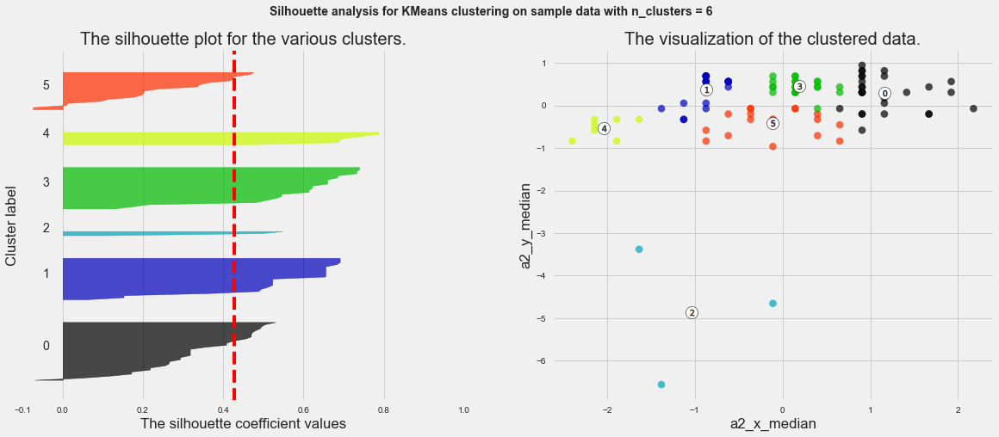

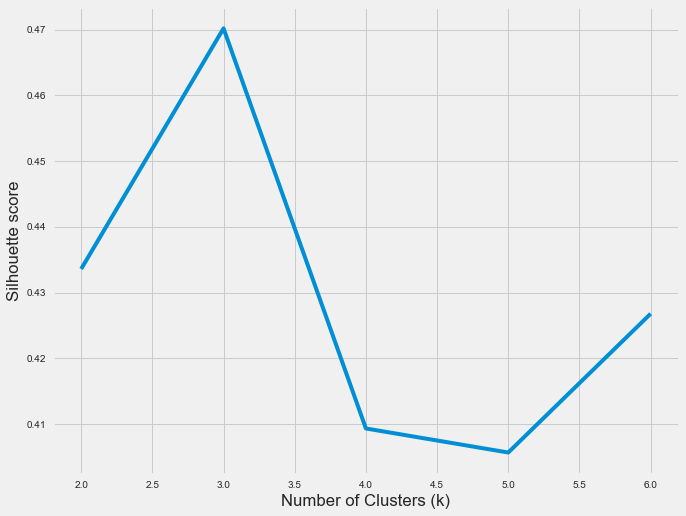

With 2-features combination of: a2_x_median, a2_z_median
for n_clusters = 2 The average silhouette_score is : 0.7445488102622804
for n_clusters = 3 The average silhouette_score is : 0.47841268542578225
for n_clusters = 4 The average silhouette_score is : 0.38161865542988666
for n_clusters = 5 The average silhouette_score is : 0.39362353229958025
for n_clusters = 6 The average silhouette_score is : 0.41434184831577403


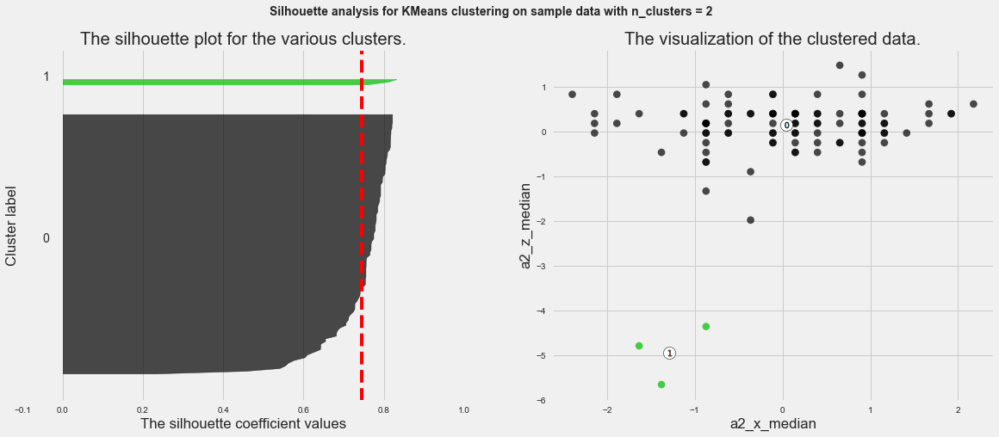

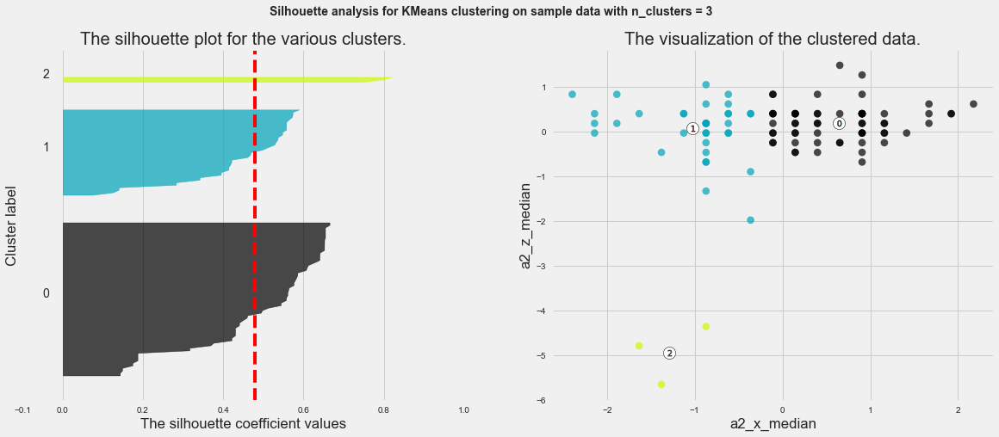

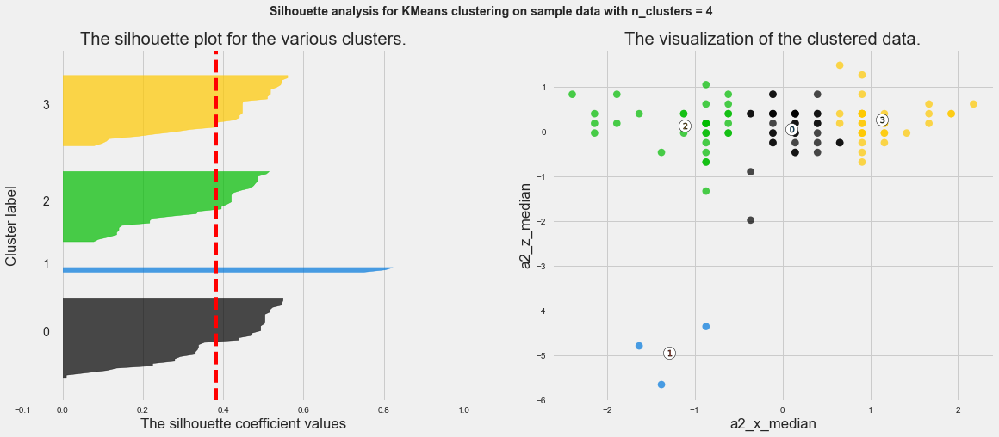

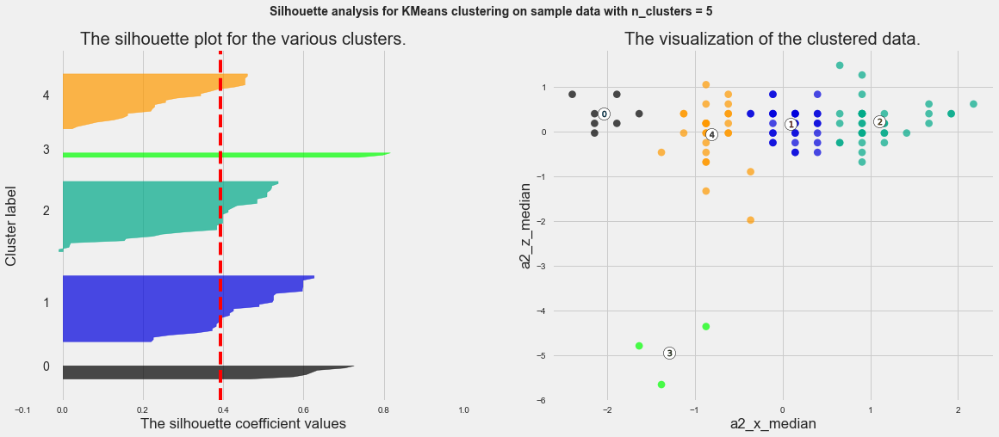

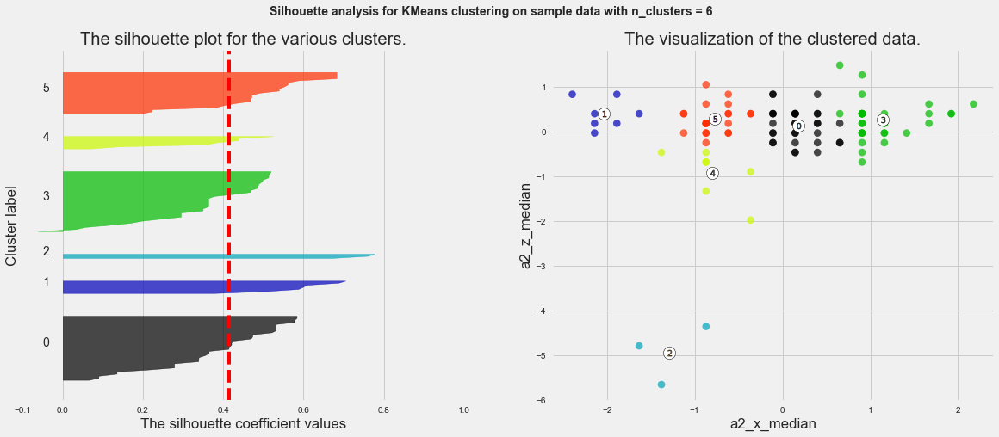

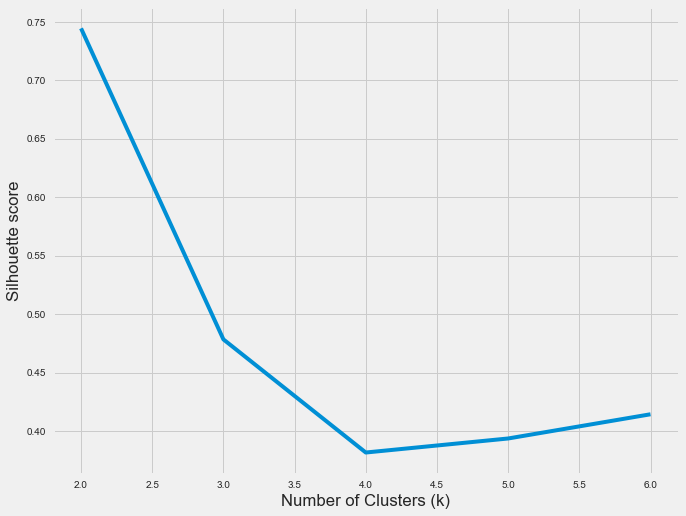

With 2-features combination of: a2_x_median, hert_median
for n_clusters = 2 The average silhouette_score is : 0.4421270382167847
for n_clusters = 3 The average silhouette_score is : 0.5072502628254982
for n_clusters = 4 The average silhouette_score is : 0.6253937571869804
for n_clusters = 5 The average silhouette_score is : 0.5880308745491258
for n_clusters = 6 The average silhouette_score is : 0.6243303289631874


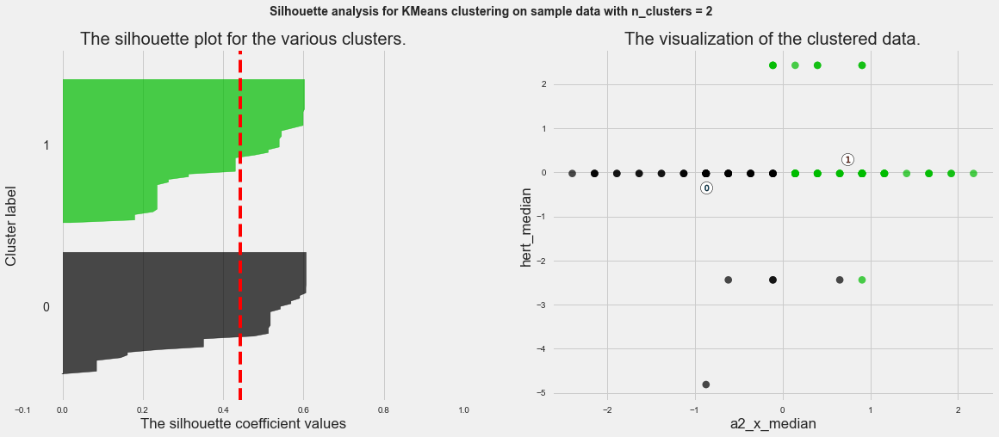

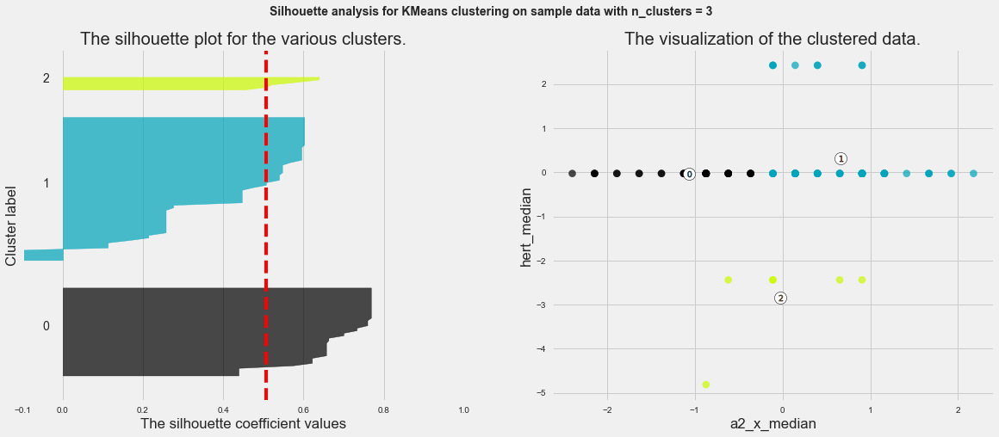

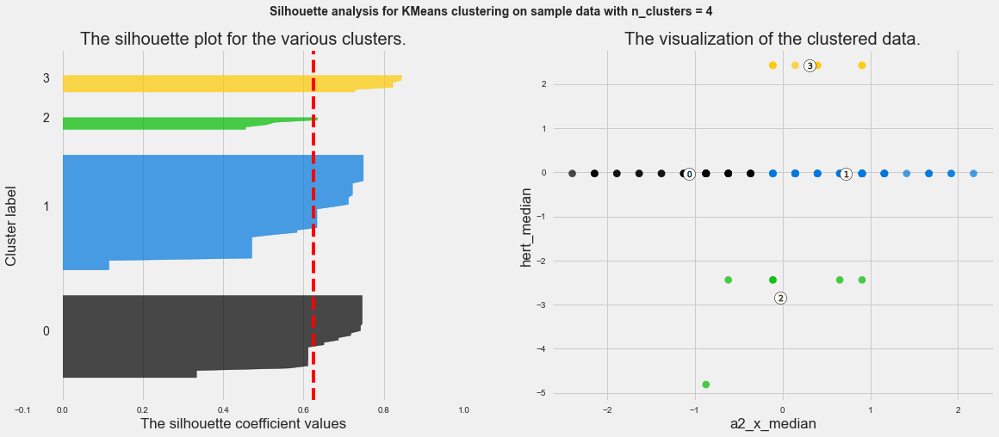

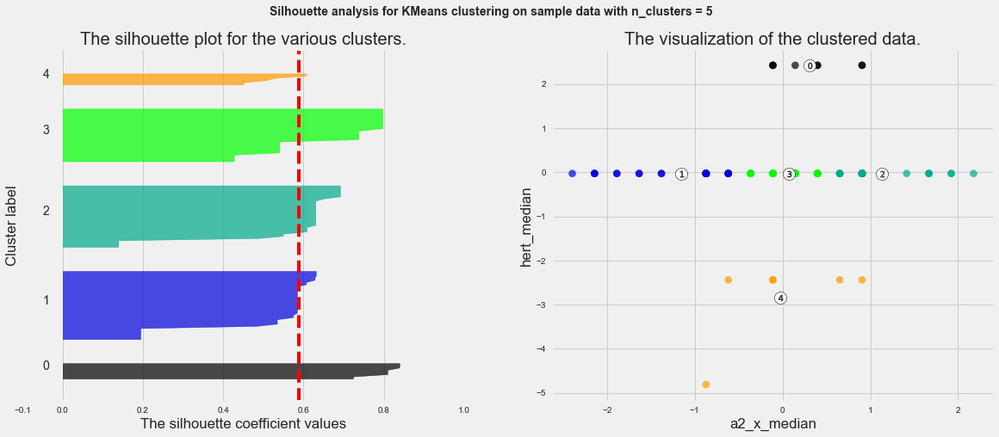

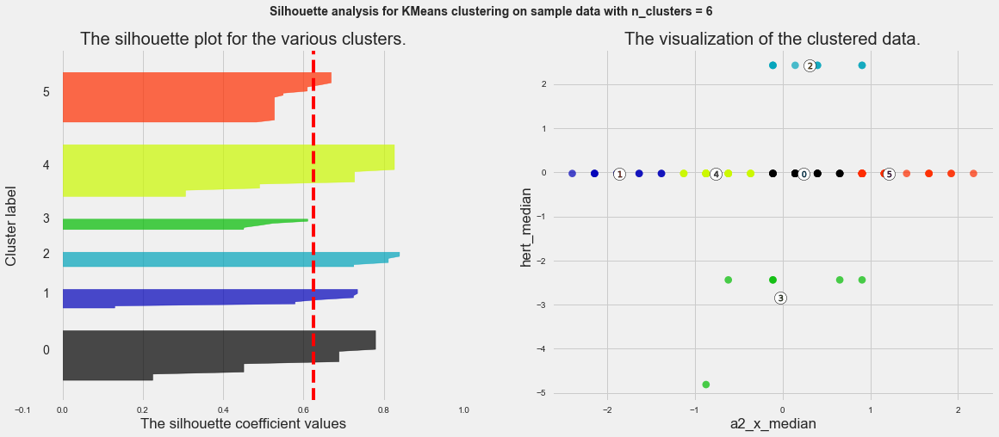

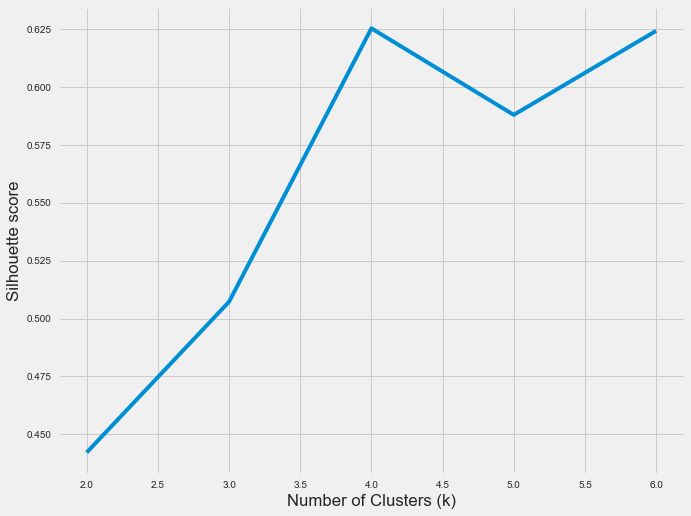

With 2-features combination of: a2_x_median, w_median
for n_clusters = 2 The average silhouette_score is : 0.40797735706490457
for n_clusters = 3 The average silhouette_score is : 0.4225153246859365
for n_clusters = 4 The average silhouette_score is : 0.3576153830456396
for n_clusters = 5 The average silhouette_score is : 0.3694031409367643
for n_clusters = 6 The average silhouette_score is : 0.40256979038783614


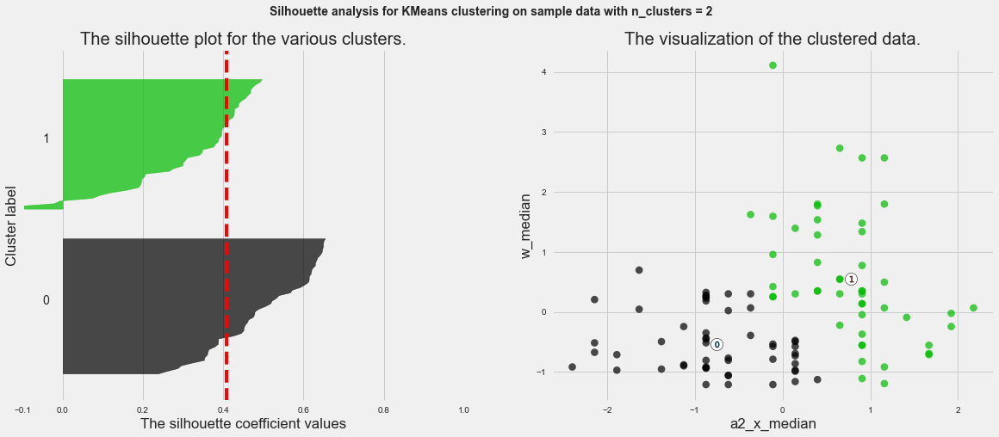

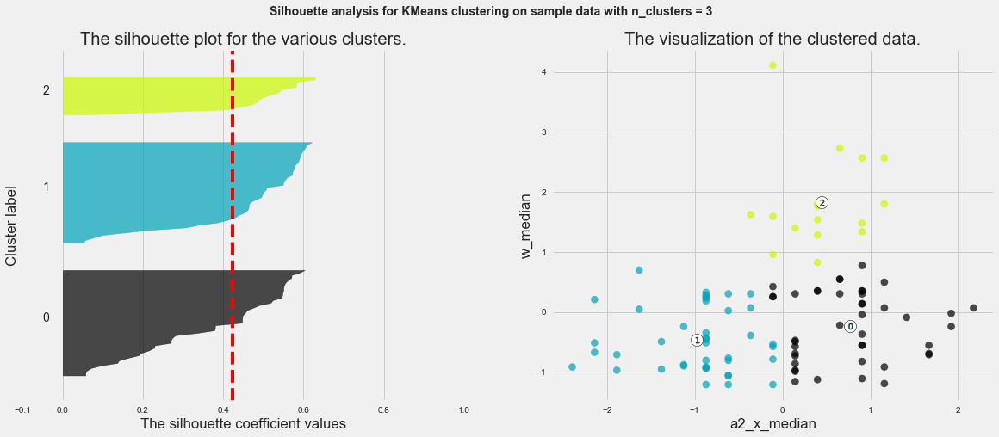

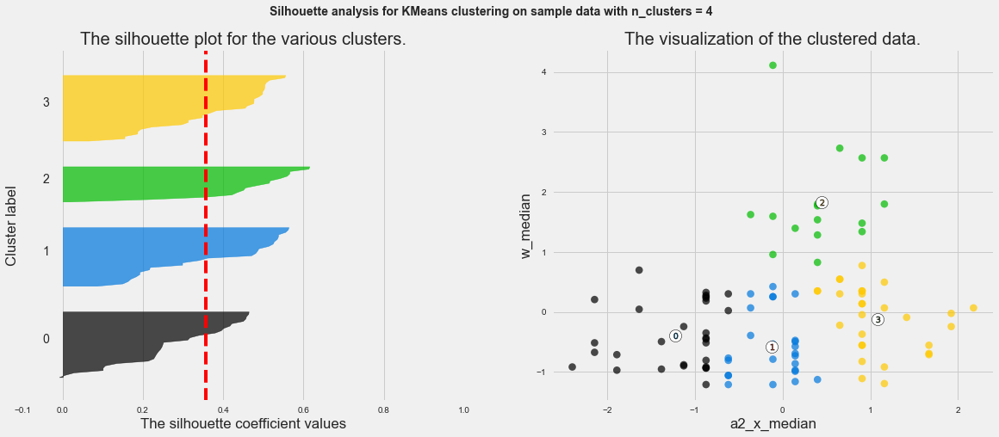

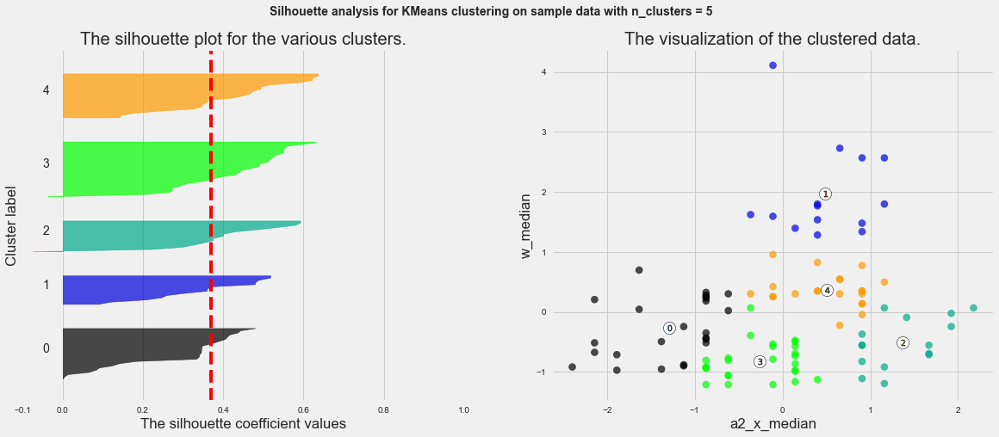

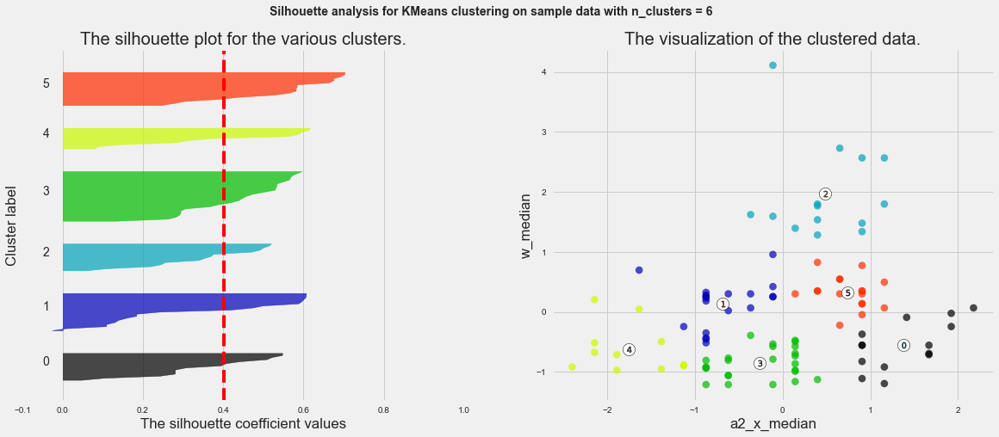

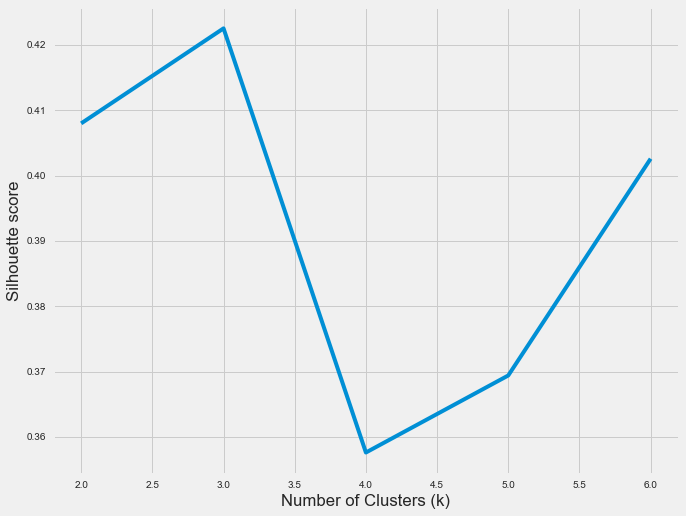

With 2-features combination of: a2_y_median, a2_z_median
for n_clusters = 2 The average silhouette_score is : 0.8318965123925095
for n_clusters = 3 The average silhouette_score is : 0.4071833450989086
for n_clusters = 4 The average silhouette_score is : 0.4072644148744594
for n_clusters = 5 The average silhouette_score is : 0.39482612890847446
for n_clusters = 6 The average silhouette_score is : 0.38245701098417945


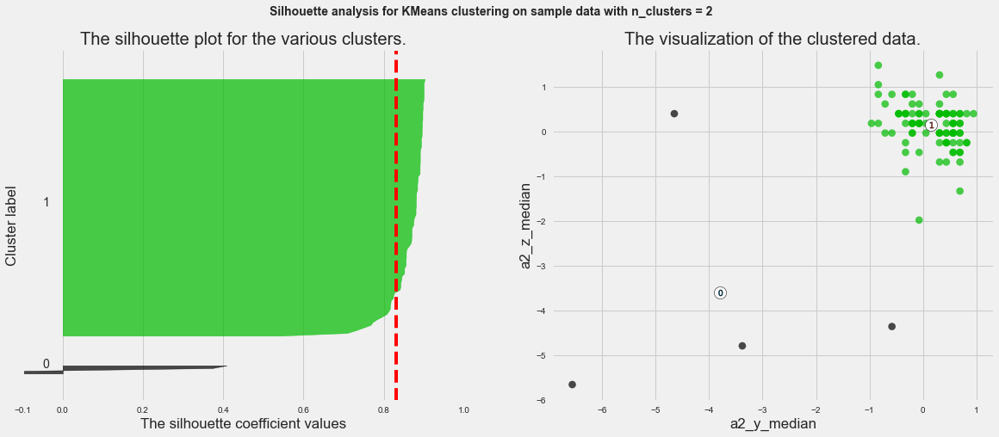

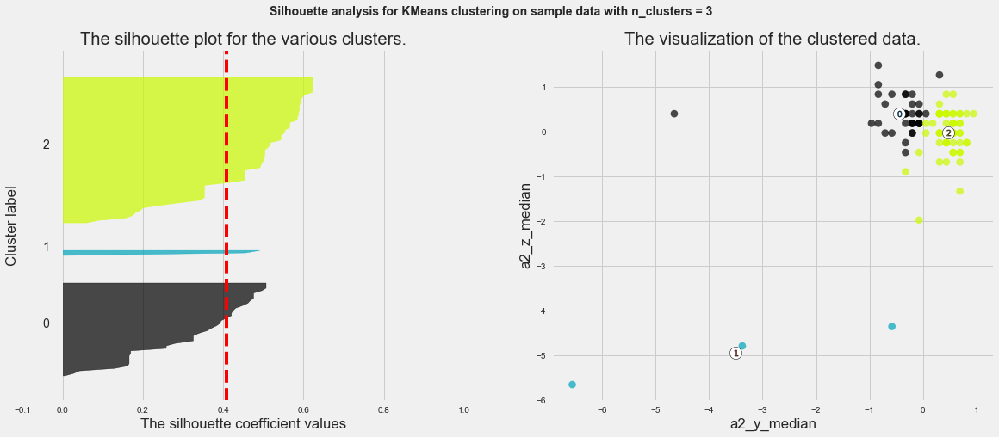

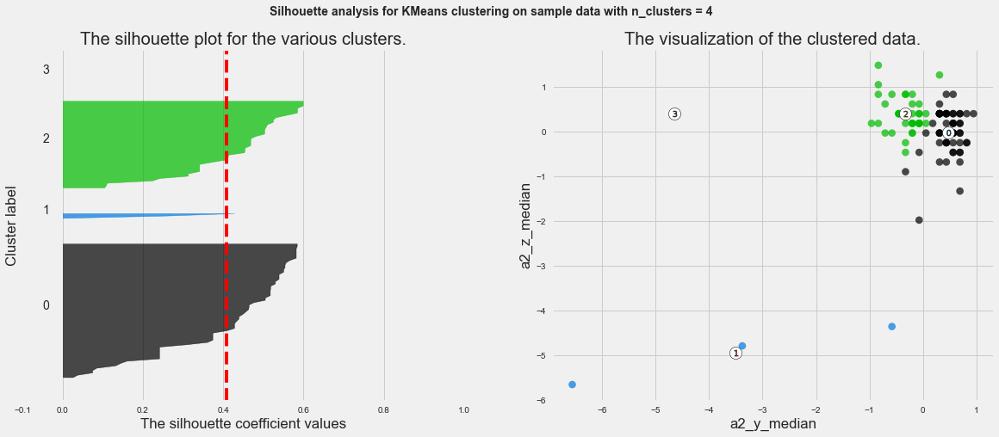

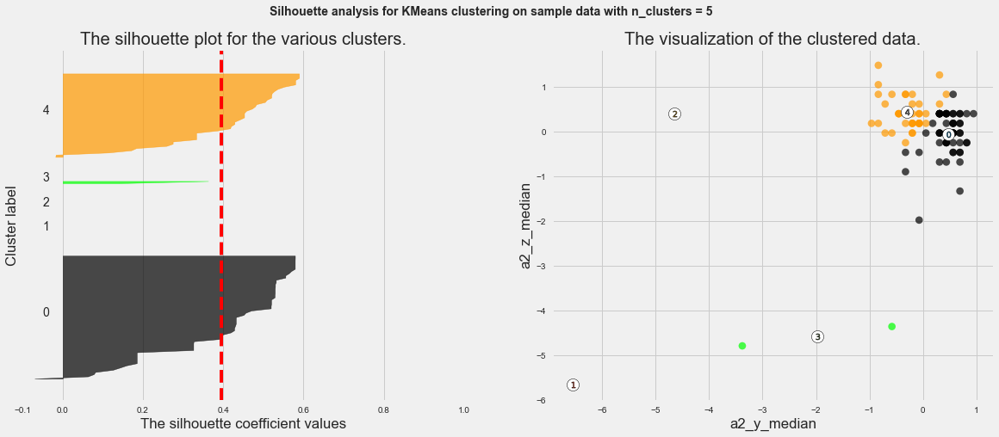

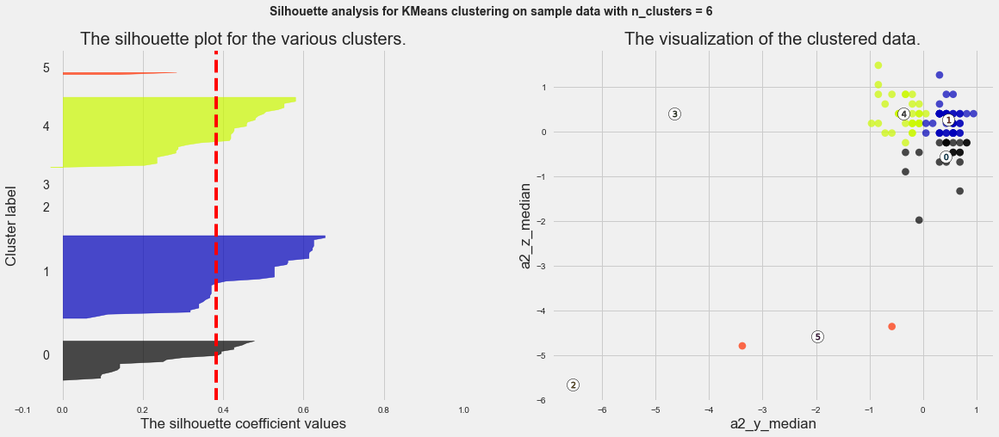

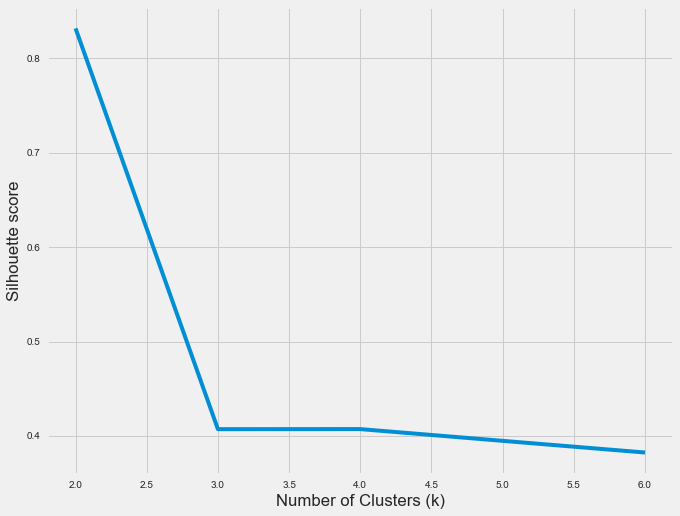

With 2-features combination of: a2_y_median, hert_median
for n_clusters = 2 The average silhouette_score is : 0.7841056979409047
for n_clusters = 3 The average silhouette_score is : 0.7145243185269203
for n_clusters = 4 The average silhouette_score is : 0.7629668737678154
for n_clusters = 5 The average silhouette_score is : 0.6857311414370728
for n_clusters = 6 The average silhouette_score is : 0.6786015518071052


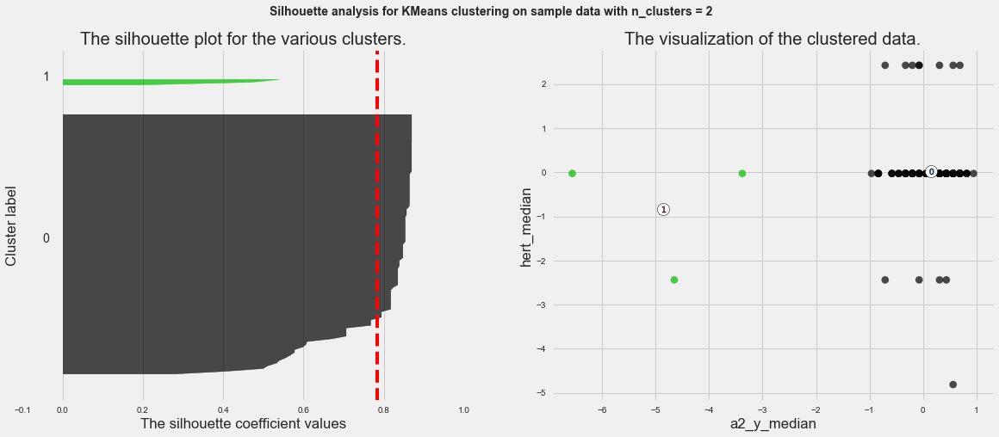

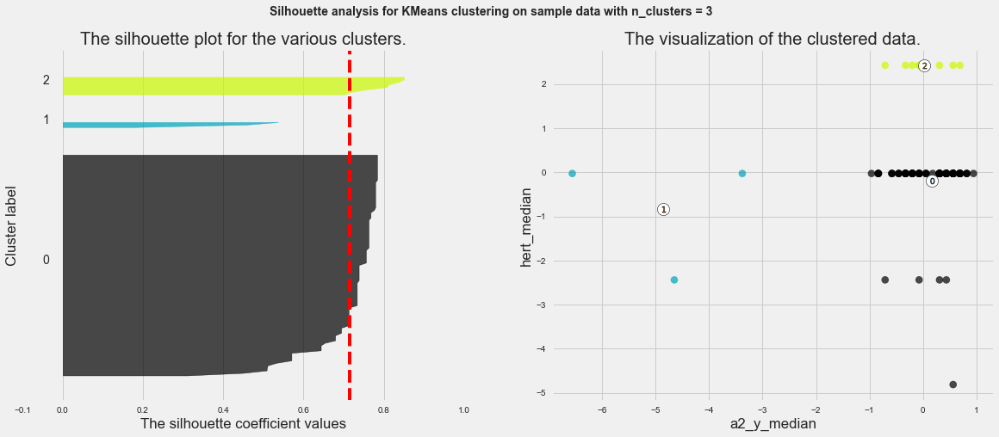

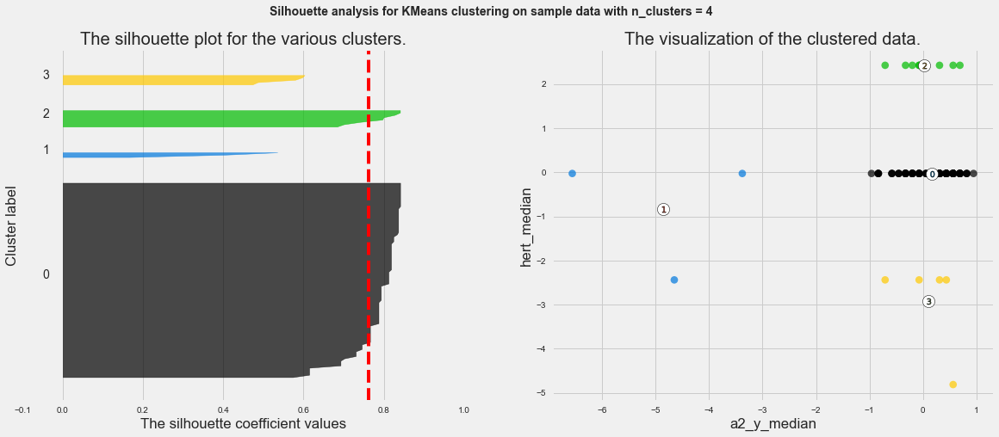

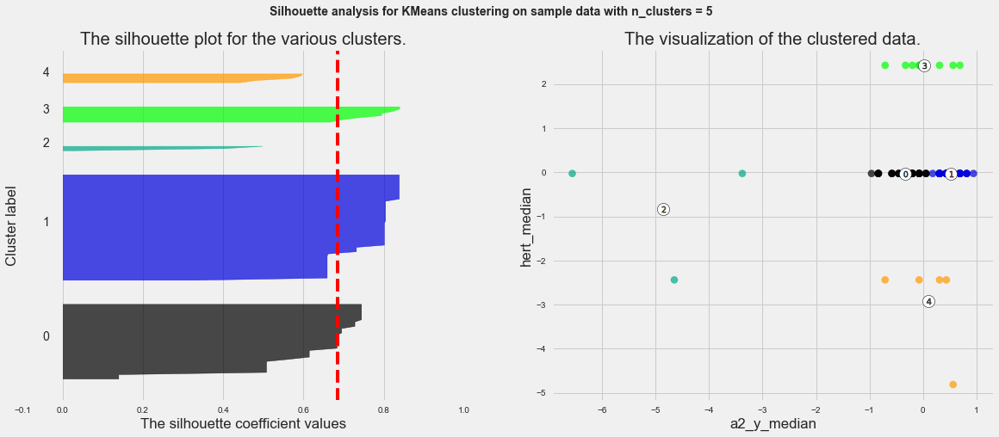

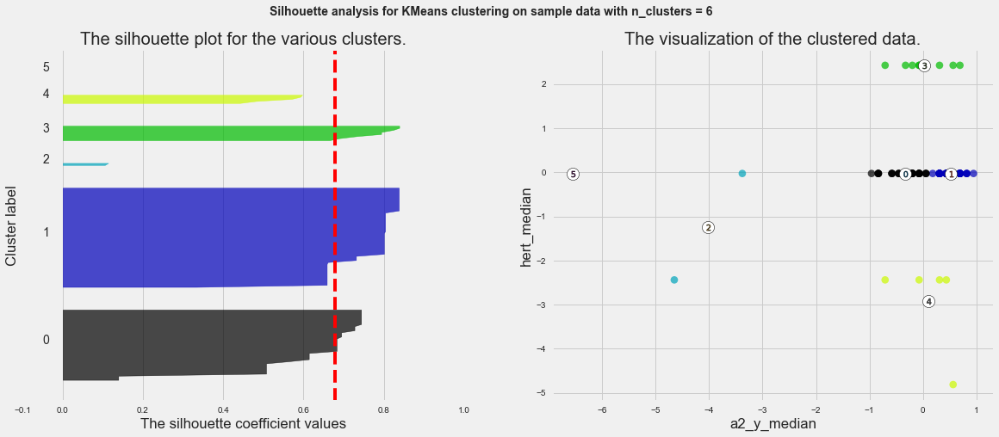

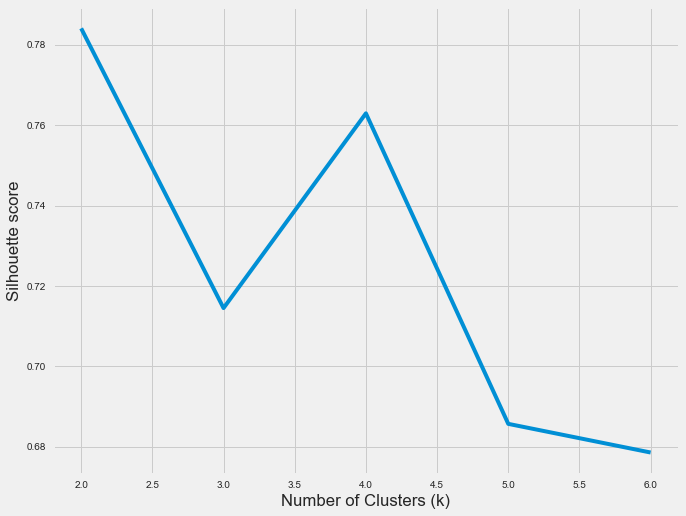

With 2-features combination of: a2_y_median, w_median
for n_clusters = 2 The average silhouette_score is : 0.7585743358676527
for n_clusters = 3 The average silhouette_score is : 0.522922642976262
for n_clusters = 4 The average silhouette_score is : 0.4322959932311048
for n_clusters = 5 The average silhouette_score is : 0.4303098791553394
for n_clusters = 6 The average silhouette_score is : 0.4766689348913581


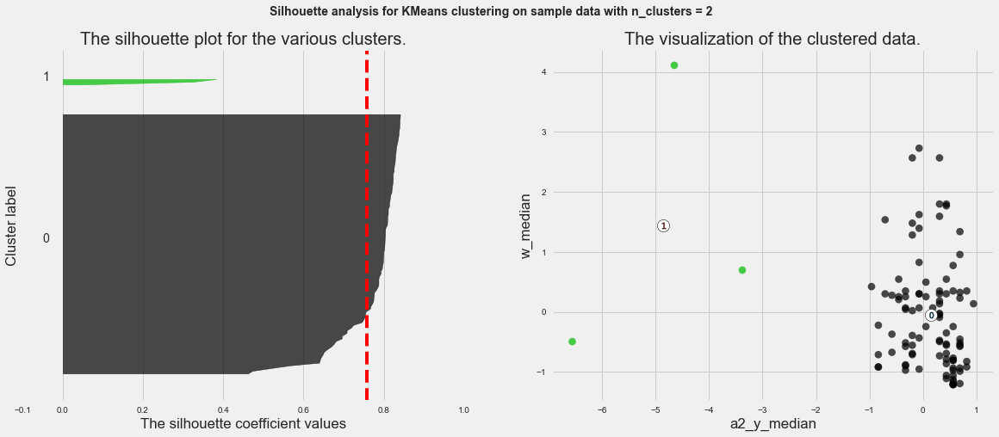

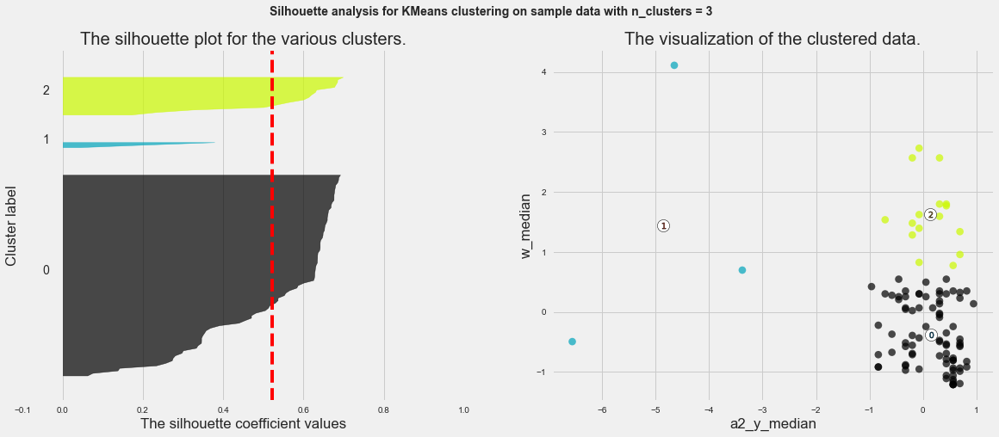

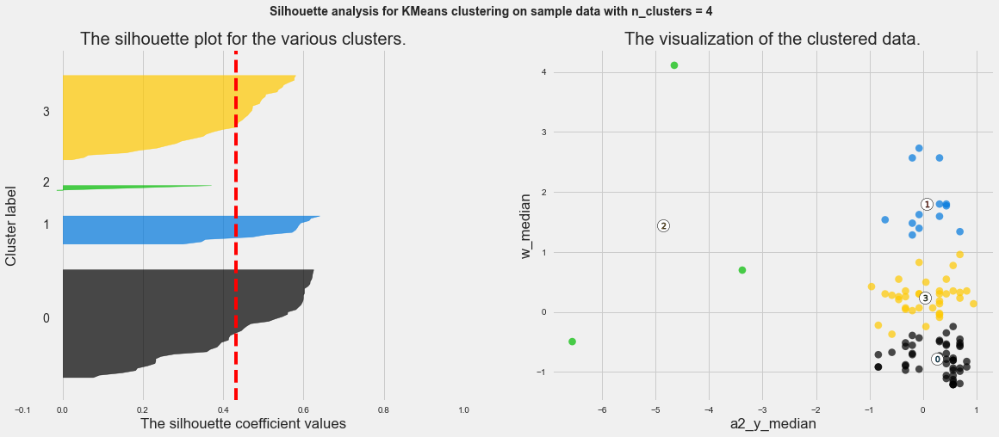

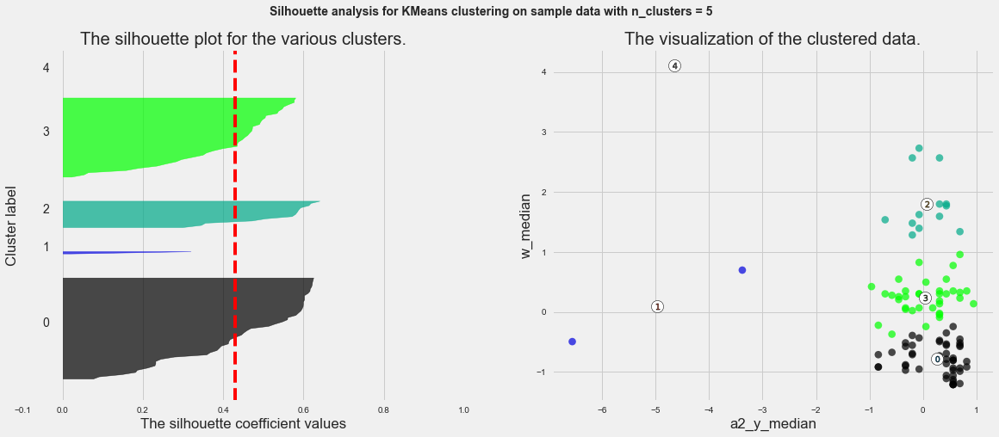

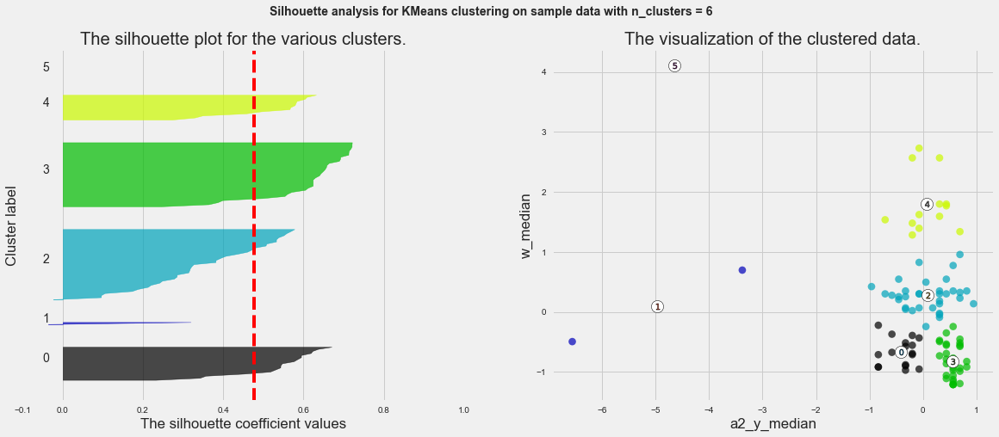

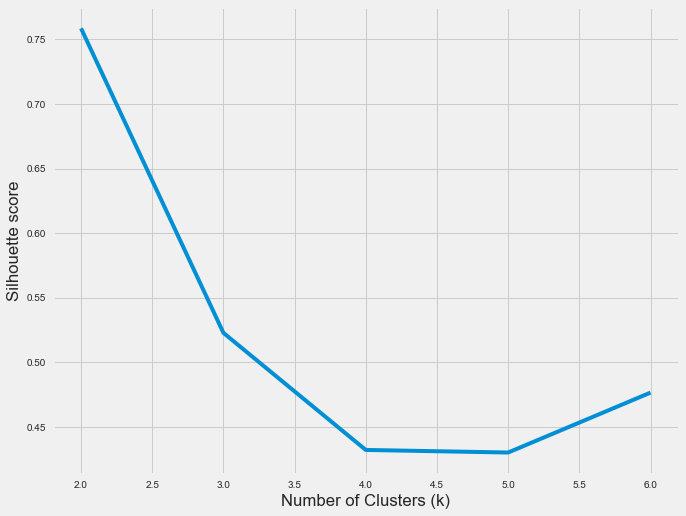

With 2-features combination of: a2_z_median, hert_median
for n_clusters = 2 The average silhouette_score is : 0.784988254025859
for n_clusters = 3 The average silhouette_score is : 0.7321488162000552
for n_clusters = 4 The average silhouette_score is : 0.7847490076632379
for n_clusters = 5 The average silhouette_score is : 0.6147025157242213
for n_clusters = 6 The average silhouette_score is : 0.6168856393733261


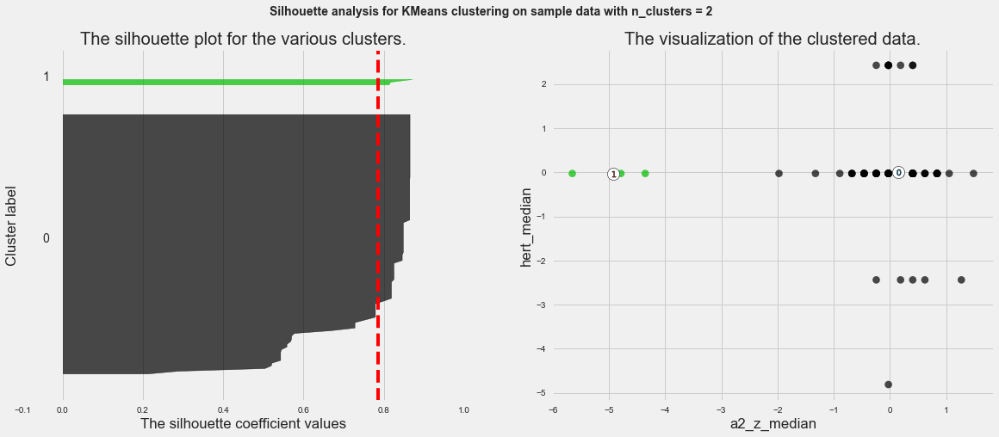

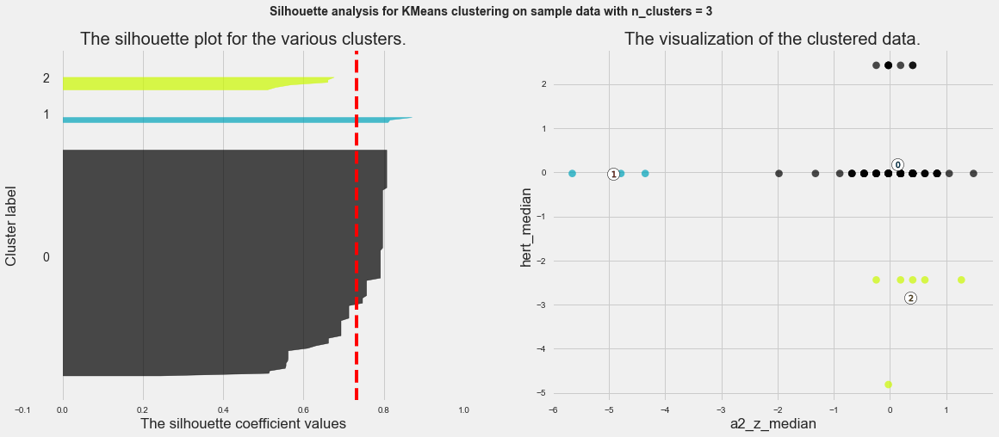

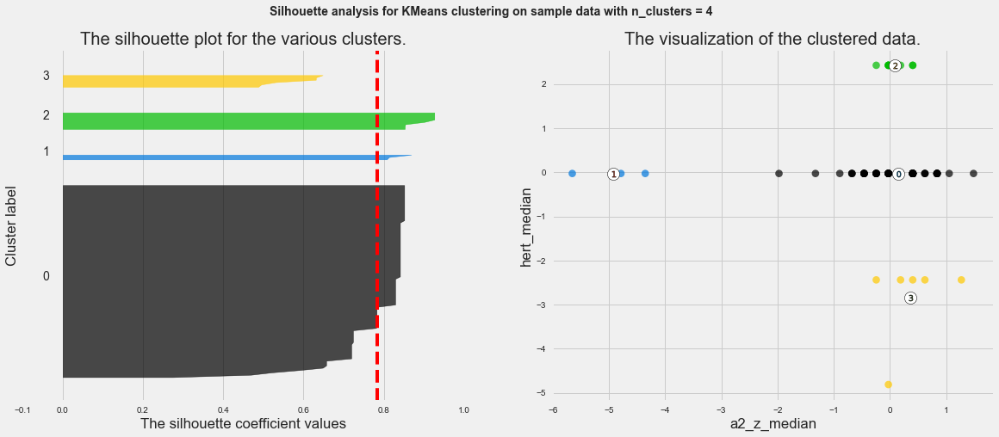

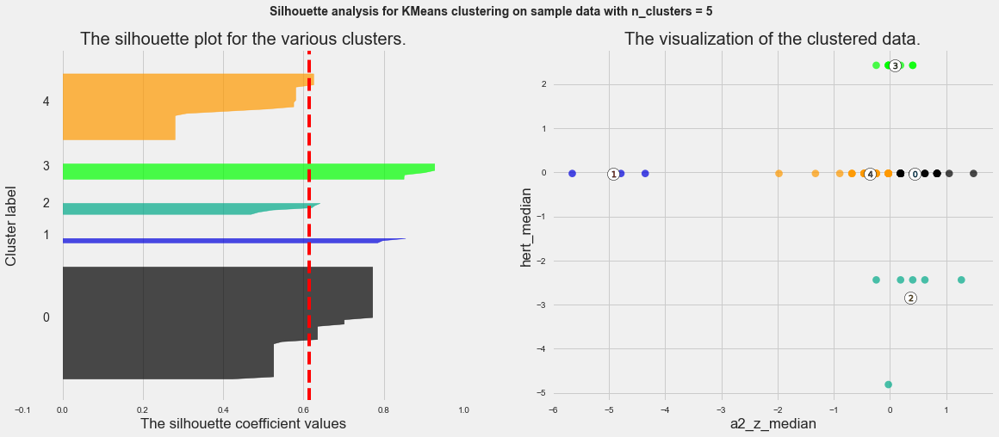

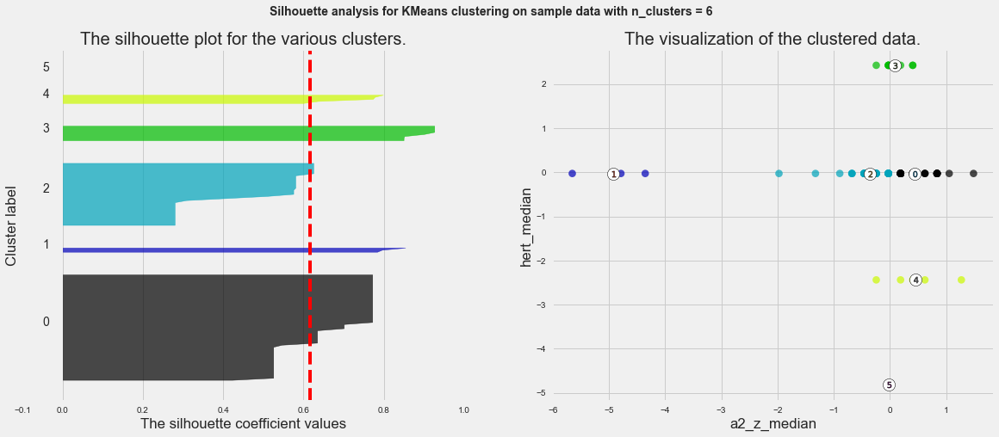

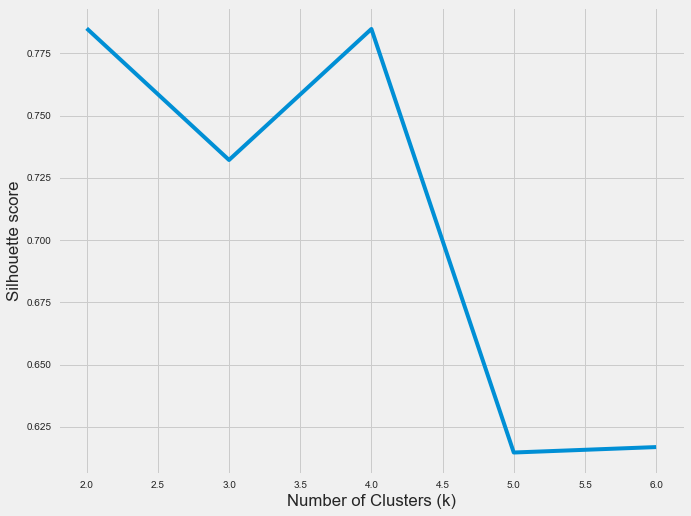

With 2-features combination of: a2_z_median, w_median
for n_clusters = 2 The average silhouette_score is : 0.7463334445844751
for n_clusters = 3 The average silhouette_score is : 0.5673844056988563
for n_clusters = 4 The average silhouette_score is : 0.4484902532579466
for n_clusters = 5 The average silhouette_score is : 0.4577010527046695
for n_clusters = 6 The average silhouette_score is : 0.43773000742195295


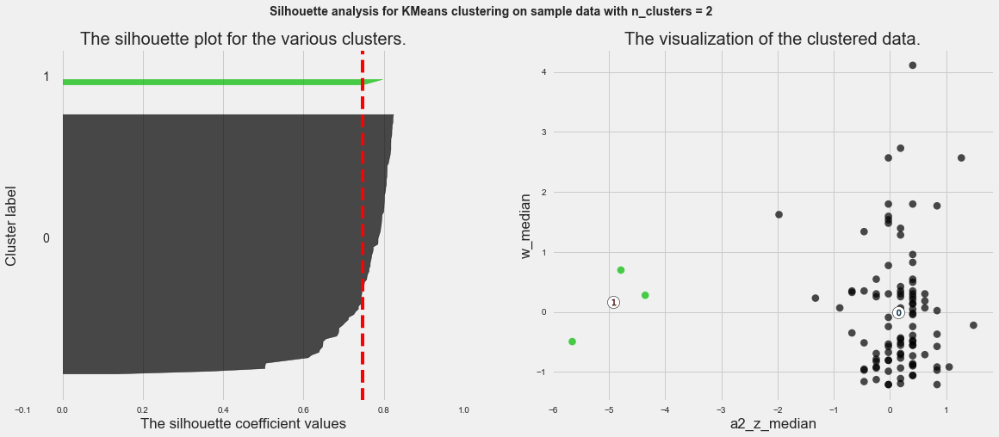

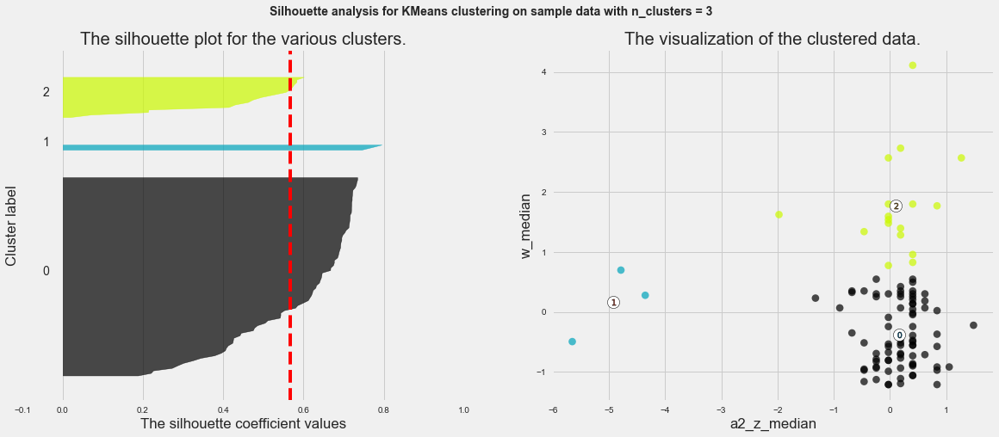

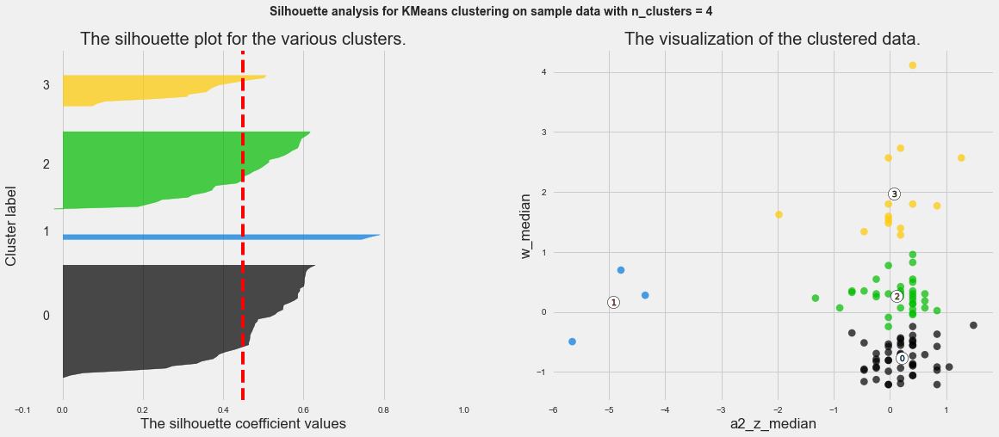

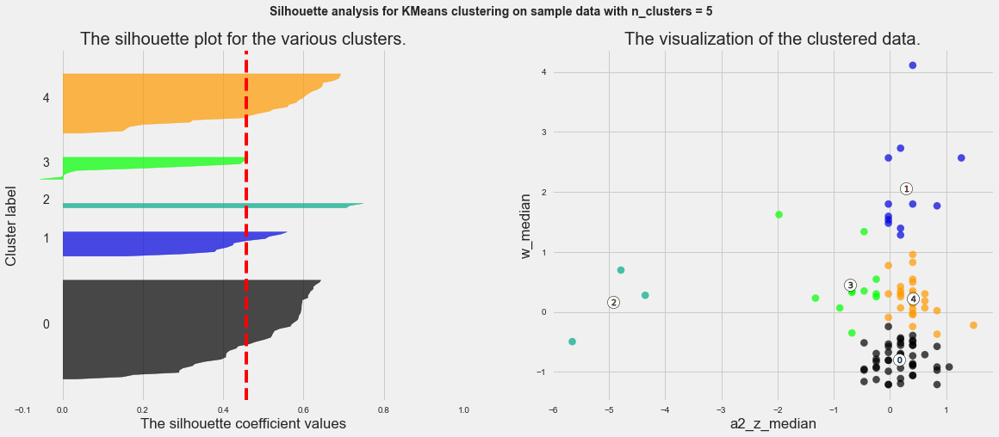

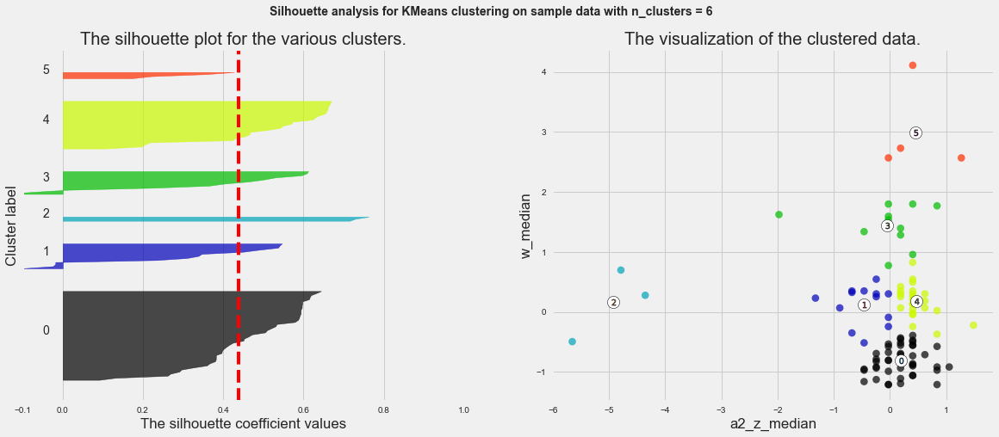

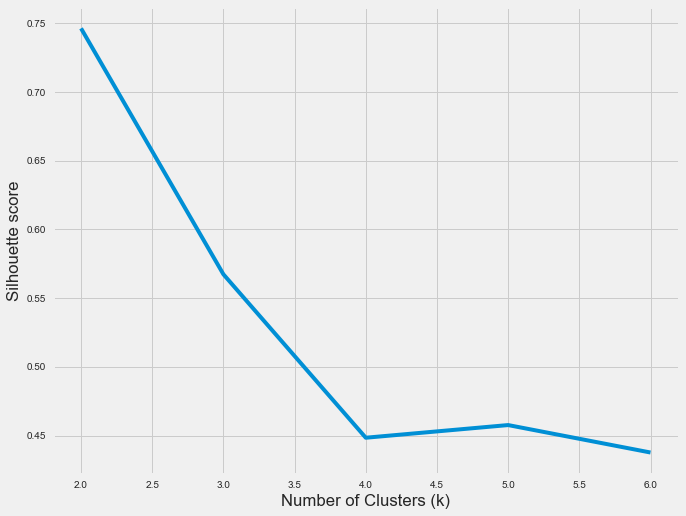

With 2-features combination of: hert_median, w_median
for n_clusters = 2 The average silhouette_score is : 0.6098866401529265
for n_clusters = 3 The average silhouette_score is : 0.670095657298674
for n_clusters = 4 The average silhouette_score is : 0.6019176206595677
for n_clusters = 5 The average silhouette_score is : 0.6252259632607362
for n_clusters = 6 The average silhouette_score is : 0.6765988777723533


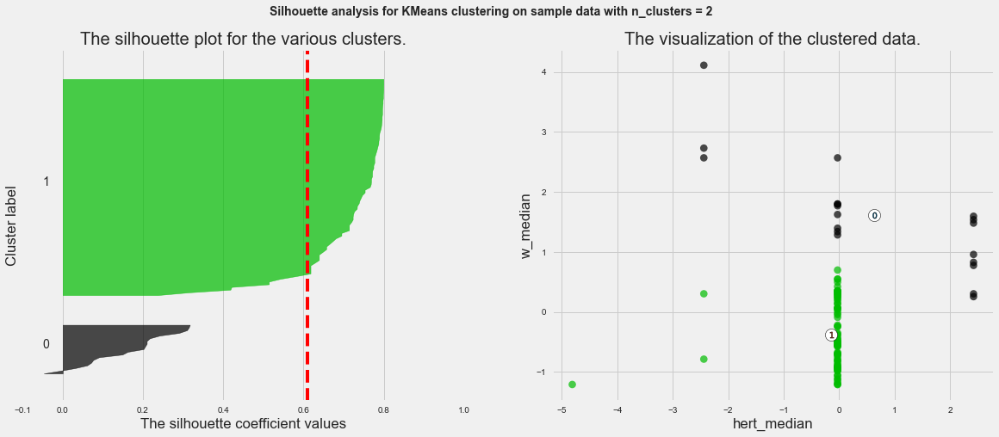

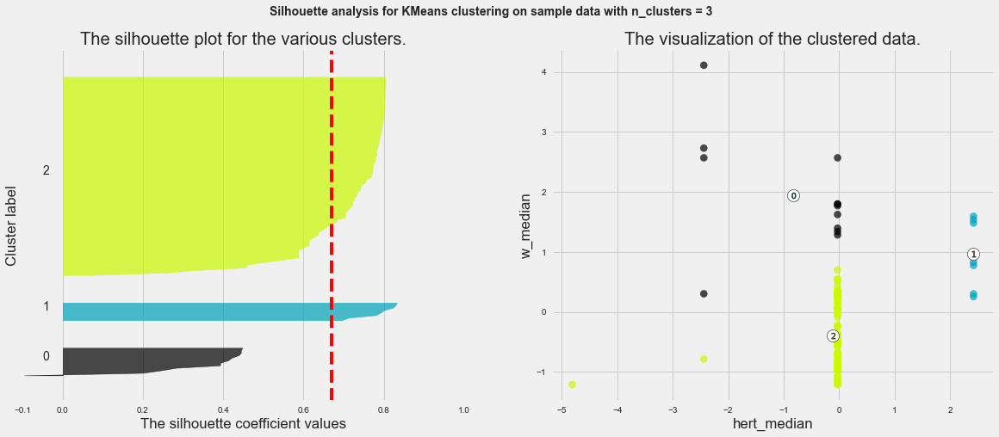

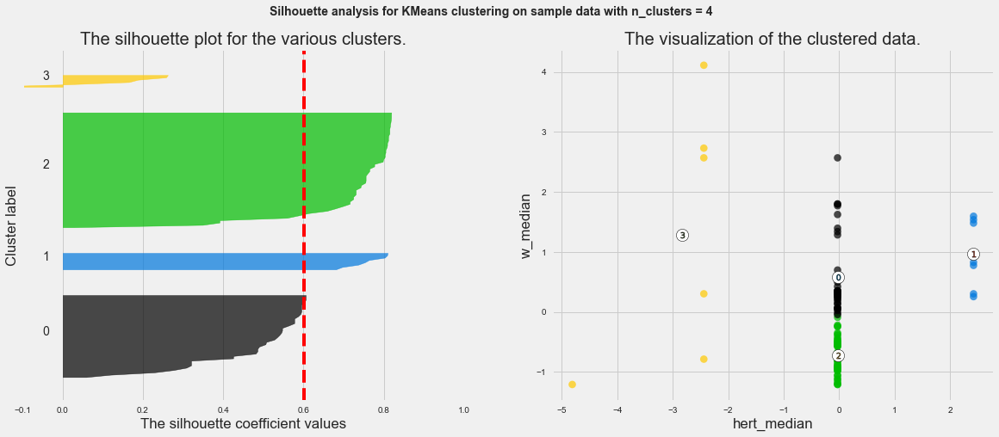

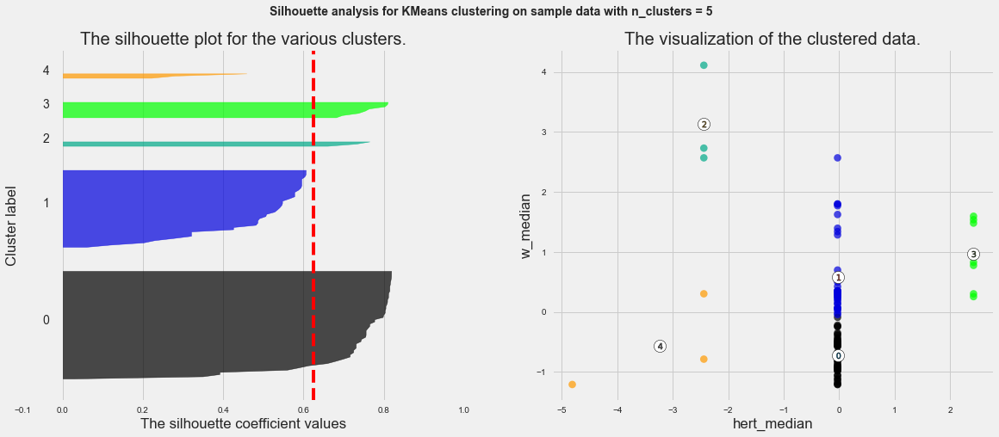

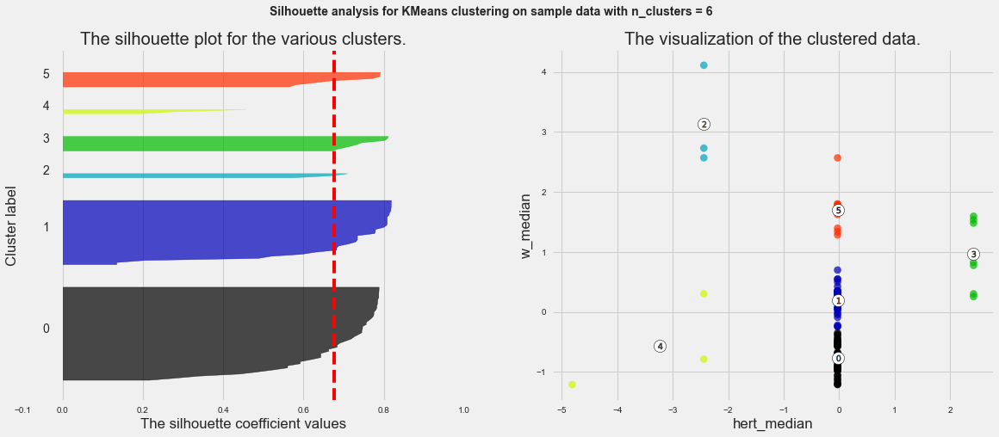

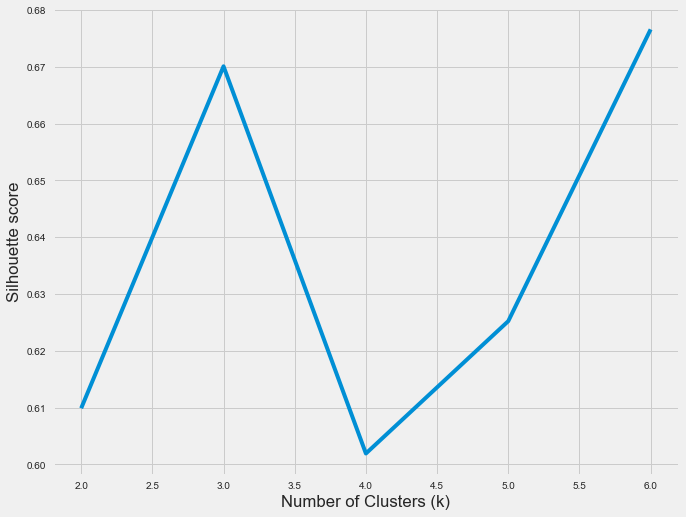

In [20]:
#Get pair combination of two columns in subdataset
combinations = list(itertools.combinations(df_median.columns,2))
print(combinations)

#Standardize the features
bearing = df_median
scaler = StandardScaler()
bearing = pd.DataFrame(scaler.fit_transform(bearing), index=bearing.index, columns=bearing.columns)

for feature1,feature2 in combinations:    
    X = bearing[[feature1, feature2]].values
    range_n_clusters = [2, 3, 4, 5, 6]
    silhouette_avg_n_clusters = []
    
    print(f'With 2-features combination of: {feature1}, {feature2}')
    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, random_state=42)
        cluster_labels = clusterer.fit_predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print("for n_clusters =", n_clusters, 
              "The average silhouette_score is :", silhouette_avg)

        silhouette_avg_n_clusters.append(silhouette_avg)
        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(X[:, 0], X[:, 1], marker='.', s=300, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

        # Labeling the clusters
        centers = clusterer.cluster_centers_
        # Draw white circles at cluster centers
        ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                    c="white", alpha=1, s=200, edgecolor='k')

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                        s=50, edgecolor='k')

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel(feature1)
        ax2.set_ylabel(feature2)

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')
    plt.show()

    style.use("fivethirtyeight")
    plt.plot(range_n_clusters, silhouette_avg_n_clusters)
    plt.xlabel("Number of Clusters (k)")
    plt.ylabel("Silhouette score")
    plt.show()

- With the dataset 'df_median'.I found the maximum of average_silhouette is **0.8732143955216094**
    + 2-features combination of: **a1_y_median**, **a2_y_median**
        - for n_clusters = 2 The average silhouette_score is : 0.8732143955216094
        - for n_clusters = 3 The average silhouette_score is : 0.5507969392577704
        - for n_clusters = 4 The average silhouette_score is : 0.5450956820078522
        - for n_clusters = 5 The average silhouette_score is : 0.539056614069156
        - for n_clusters = 6 The average silhouette_score is : 0.4682222311009865


In [ ]:
combinations = list(itertools.combinations(df_mean_square_frequency.columns,2))
print(combinations)

bearing = df_mean_square_frequency
scaler = StandardScaler()
bearing = pd.DataFrame(scaler.fit_transform(bearing), index=bearing.index, columns=bearing.columns)

for feature1,feature2 in combinations:    
    X = bearing[[feature1, feature2]].values
    range_n_clusters = [2, 3, 4, 5, 6]
    silhouette_avg_n_clusters = []
    
    print(f'With 2-features combination of: {feature1}, {feature2}')
    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, random_state=42)
        cluster_labels = clusterer.fit_predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print("for n_clusters =", n_clusters, 
              "The average silhouette_score is :", silhouette_avg)

        silhouette_avg_n_clusters.append(silhouette_avg)
        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(X[:, 0], X[:, 1], marker='.', s=300, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

        # Labeling the clusters
        centers = clusterer.cluster_centers_
        # Draw white circles at cluster centers
        ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                    c="white", alpha=1, s=200, edgecolor='k')

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                        s=50, edgecolor='k')

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel(feature1)
        ax2.set_ylabel(feature2)

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')
    plt.show()

    style.use("fivethirtyeight")
    plt.plot(range_n_clusters, silhouette_avg_n_clusters)
    plt.xlabel("Number of Clusters (k)")
    plt.ylabel("Silhouette score")
    plt.show()

- With the dataset 'df_mean_square_frequency'.I found the maximum of average_silhouette is **0.8032666648672354**
    + With 2-features combination of: a1_x_MS_F, a2_x_MS_F
           - for n_clusters = 2 The average silhouette_score is : **0.8032666648672354**
           - for n_clusters = 3 The average silhouette_score is : 0.5893870848607589
           - for n_clusters = 4 The average silhouette_score is : 0.5947925775218296 
           - for n_clusters = 5 The average silhouette_score is : 0.5057374981395187
           - for n_clusters = 6 The average silhouette_score is : 0.5062820608662084


In [ ]:
combinations = list(itertools.combinations(df_entropy.columns,2))
print(combinations)

bearing = df_entropy
scaler = StandardScaler()
bearing = pd.DataFrame(scaler.fit_transform(bearing), index=bearing.index, columns=bearing.columns)

for feature1,feature2 in combinations:    
    X = bearing[[feature1, feature2]].values
    range_n_clusters = [2, 3, 4, 5, 6]
    silhouette_avg_n_clusters = []
    
    print(f'\nWith 2-features combination of: {feature1}, {feature2}')
    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, random_state=42)
        cluster_labels = clusterer.fit_predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print("for n_clusters =", n_clusters, 
              "The average silhouette_score is :", silhouette_avg)

        silhouette_avg_n_clusters.append(silhouette_avg)
        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(X[:, 0], X[:, 1], marker='.', s=300, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

        # Labeling the clusters
        centers = clusterer.cluster_centers_
        # Draw white circles at cluster centers
        ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                    c="white", alpha=1, s=200, edgecolor='k')

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                        s=50, edgecolor='k')

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel(feature1)
        ax2.set_ylabel(feature2)

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')
    plt.show()

    style.use("fivethirtyeight")
    plt.plot(range_n_clusters, silhouette_avg_n_clusters)
    plt.xlabel("Number of Clusters (k)")
    plt.ylabel("Silhouette score")
    plt.show()

- With the dataset 'df_entropy'.I found the maximum of average_silhouette is **0.5914688510144367**
    + 2-features combination of: **a1_x_entropy**, **a1_y_entropy**
        - for n_clusters = 2 The average silhouette_score is : 0.5914688510144367
        - for n_clusters = 3 The average silhouette_score is : 0.4960797225870924
        - for n_clusters = 4 The average silhouette_score is : 0.4166127393543912
        - for n_clusters = 5 The average silhouette_score is : 0.42132354311966547
        - for n_clusters = 6 The average silhouette_score is : 0.39968280380398163


### 3 features models


In [32]:
from sklearn.cluster import KMeans

# number of clusters
team_size = 2

#Select the features:
df_metrics = df96f_false[['a1_y_median', 'a2_y_median','hert_median']]
#df_metrics = df96f_false[['a1_y_max', 'a2_y_max','hert_max']]

scaler = StandardScaler()
df_metrics_normalized = pd.DataFrame(scaler.fit_transform(df_metrics), index=df_metrics.index, columns=df_metrics.columns)

# fit a kmeans object to the dataset
kmeans = KMeans(n_clusters=team_size, init='k-means++', random_state = 42).fit(df_metrics_normalized)

# clusters is an attribute of the object
cluster_centers = kmeans.cluster_centers_

# add cluster index to dataframe
cluster_labels = pd.Series(kmeans.labels_, name='cluster')
df_metrics_normalized = df_metrics_normalized.join(cluster_labels.to_frame())

Text(0.5, 11.119999999999997, 'Max values in Y-axis of bearing 1')

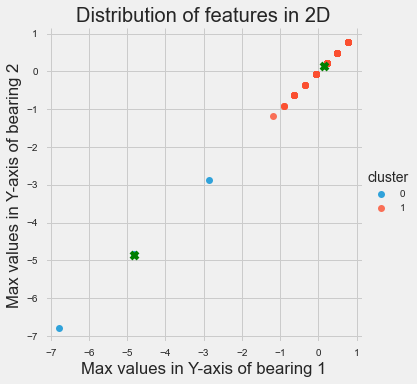

In [33]:
sns.lmplot(x='a1_y_median', y='a1_y_median', data=df_metrics_normalized,
#sns.lmplot(x='a1_y_max', y='a2_y_max', data=df_metrics_normalized,
           fit_reg=False, hue='cluster')
plt.scatter(cluster_centers[:,0],cluster_centers[:,1], c='g', marker ='x') # centroides
plt.title('Distribution of features in 2D')
plt.ylabel('Max values in Y-axis of bearing 2')
plt.xlabel('Max values in Y-axis of bearing 1')

In [30]:
import plotly.express as px

fig = px.scatter_matrix((df_metrics_normalized),
width=1200, height=1600)
fig.show()

In [73]:
#['a1_y_median', 'a2_y_median','hert_median']

df_mean_3d = df_metrics_normalized
kmeans = KMeans(n_clusters=3, init="k-means++",n_init=100, tol=1e-04, random_state=42)
X = df_mean_3d
kmeans.fit(X)
clusters=pd.DataFrame(X,columns=df_mean_3d.columns)
clusters['label']=kmeans.labels_
score = silhouette_score(df_mean_3d, kmeans.labels_, metric='euclidean')
fig3 = px.scatter_3d(clusters, x='a1_y_median', y="a2_y_median", z="hert_median", color = 'label',symbol='label')
fig3.update_layout(title=f" Distribution in 3D of a1_y_median, a2_y_median, hert_median")
fig3.show()

### 4 features models


In [41]:
def plot_inertia_syl_coeff(k_range, inertia, syl_coef_):
    
    plt.figure(figsize=(5,3))
    plt.plot(k_range, inertia,label='inertia')
    plt.legend()
    plt.grid(True)
    plt.xlabel('number clusters')
    plt.ylabel('Cost of model (Inertia)')
    plt.show()
    
    plt.figure(figsize=(5,3))
    plt.plot(k_range, syl_coef_,c='g',label='sylhouette_coefficient')
    plt.legend()
    plt.grid(True)
    plt.xlabel('number clusters')
    plt.ylabel('sylhouette coefficience')
    plt.show()

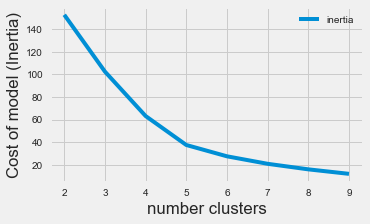

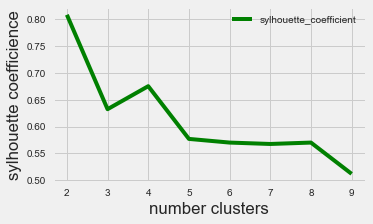

[0.8081011371734524, 0.6323084353908015, 0.675145083864852, 0.5769683324323972, 0.5701344636555831, 0.5675362116990368, 0.5701339203889193, 0.5118935792172483]


In [71]:
from sklearn.cluster import KMeans

#Select the features:
#df_metrics = df96f_false[['a1_y_median', 'a2_y_median','hert_median']]
df_metrics = df96f_false[['a1_y_median', 'a2_y_median','hert_median', 'a1_x_median']]
#df_metrics = df96f_false[['a1_y_median', 'a2_y_median','a1_y_max', 'a2_y_max']]  #0.623 at 3 clusters

scaler = StandardScaler()
df_metrics_normalized = pd.DataFrame(scaler.fit_transform(df_metrics), index=df_metrics.index, columns=df_metrics.columns)

# number of clusters
clusters = 2

# fit a kmeans object to the dataset
# KMeans: Elbow Methode: determine k on Elbow
inertia = []
syl_coef_ = []
k_range = range(2, 10)
for k in k_range:
    kmeans = KMeans(n_clusters=k, init='k-means++').fit(df_metrics_normalized)
    # clusters is an attribute of the object
    cluster_centers = kmeans.cluster_centers_
    labels = kmeans.labels_
    predict= kmeans.predict(df_metrics_normalized) 
    inertia.append(kmeans.inertia_)
    silhouette_coeff=metrics.silhouette_score(df_metrics_normalized, labels)
    syl_coef_.append(silhouette_coeff)
   
plot_inertia_syl_coeff(k_range, inertia, syl_coef_)
print(syl_coef_)


Text(0.5, 11.119999999999997, 'Max values in Y-axis of bearing 1')

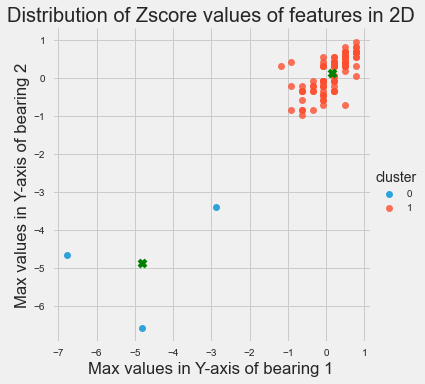

In [39]:
sns.lmplot(x='a1_y_median', y='a2_y_median', data=df_metrics_normalized,
           fit_reg=False, hue='cluster')
plt.scatter(cluster_centers[:,0],cluster_centers[:,1], c='g', marker ='x') # centroides
plt.title('Distribution of features in 2D')
plt.ylabel('Max values in Y-axis of bearing 2')
plt.xlabel('Max values in Y-axis of bearing 1')

### 5 features


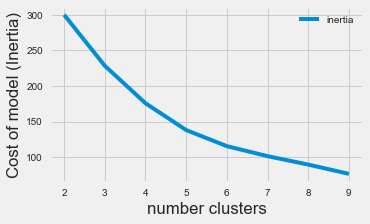

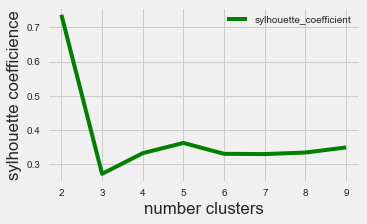

[0.7371708755387815, 0.2706666767134307, 0.3312959613862273, 0.36137716149634547, 0.32933980525456774, 0.32864844288430384, 0.33320018331618073, 0.34813003575100454]


In [53]:
from sklearn.cluster import KMeans

#df_metrics = df96f_false[['a1_y_max', 'a2_y_max','a1_y_median','a2_y_median', 'hert_median']]  #0.575 at 6 clusters
df_metrics = df96f_false[['a1_x_median', 'a2_x_median','a1_y_median','a2_y_median', 'hert_median']] #0.737 at 2 clusters

scaler = StandardScaler()
df_metrics_normalized = pd.DataFrame(scaler.fit_transform(df_metrics), index=df_metrics.index, columns=df_metrics.columns)

# number of clusters
clusters = 2

# fit a kmeans object to the dataset
# KMeans: Elbow Methode: determine k on Elbow
inertia = []
syl_coef_ = []
k_range = range(2, 10)
for k in k_range:
    kmeans = KMeans(n_clusters=k, init='k-means++').fit(df_metrics_normalized)
    # clusters is an attribute of the object
    cluster_centers = kmeans.cluster_centers_
    labels = kmeans.labels_
    predict= kmeans.predict(df_metrics_normalized) 
    inertia.append(kmeans.inertia_)
    silhouette_coeff=metrics.silhouette_score(df_metrics_normalized, labels)
    syl_coef_.append(silhouette_coeff)
   
plot_inertia_syl_coeff(k_range, inertia, syl_coef_)
print(syl_coef_)

### 6 features

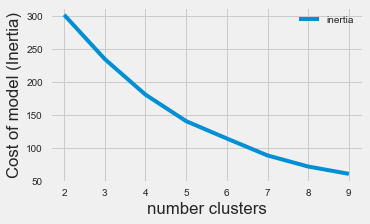

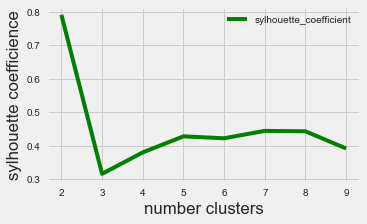

[0.7911983956371388, 0.31649947416458124, 0.38051020835584715, 0.4284053919956589, 0.42266863757636597, 0.44472666365215163, 0.4434530705693724, 0.3922225876353462]


In [56]:
from sklearn.cluster import KMeans

#df_metrics = df96f_false[['a1_y_max', 'a2_y_max','a1_y_median','a2_y_median', 'a1_x_MS_F', 'a2_x_MS_F']]
df_metrics = df96f_false[['a1_y_median', 'a2_y_median','a1_y_median','a2_y_median', 'hert_median', 'w_median']]

scaler = StandardScaler()
df_metrics_normalized = pd.DataFrame(scaler.fit_transform(df_metrics), index=df_metrics.index, columns=df_metrics.columns)

# number of clusters
clusters = 2

# fit a kmeans object to the dataset
# KMeans: Elbow Methode: determine k on Elbow
inertia = []
syl_coef_ = []
k_range = range(2, 10)
for k in k_range:
    kmeans = KMeans(n_clusters=k, init='k-means++').fit(df_metrics_normalized)
    # clusters is an attribute of the object
    cluster_centers = kmeans.cluster_centers_
    labels = kmeans.labels_
    predict= kmeans.predict(df_metrics_normalized) 
    inertia.append(kmeans.inertia_)
    silhouette_coeff=metrics.silhouette_score(df_metrics_normalized, labels)
    syl_coef_.append(silhouette_coeff)
   
plot_inertia_syl_coeff(k_range, inertia, syl_coef_)
print(syl_coef_)

In [ ]:
sns.lmplot(x='a1_y_max', y='a2_y_max', data=df_metrics_normalized,
           fit_reg=False, hue='cluster')
plt.scatter(cluster_centers[:,0],cluster_centers[:,1], c='g', marker ='x') # centroides
plt.title('Distribution of features in 2D')
plt.ylabel('Max values in Y-axis of bearing 2')
plt.xlabel('Max values in Y-axis of bearing 1')

In [ ]:
sns.lmplot(x='a1_y_median', y='a2_y_median', data=df_metrics_normalized,
           fit_reg=False, hue='cluster')
plt.scatter(cluster_centers[:,0],cluster_centers[:,1], c='g', marker ='x') # centroides
plt.title('Distribution of features in 2D')
plt.ylabel('Median values in Y-axis of bearing 2')
plt.xlabel('Median values in Y-axis of bearing 1')

In [84]:
#df_metrics = df96f_false[['a1_y_max', 'a2_y_max','a1_y_median','a2_y_median', 'a1_x_MS_F', 'a2_x_MS_F']]
df_metrics = df96f_false[['a1_x_median', 'a2_x_median','a1_y_median','a2_y_median', 'hert_median', 'w_median']]

scaler = StandardScaler()
df_metrics_normalized = pd.DataFrame(scaler.fit_transform(df_metrics), index=df_metrics.index, columns=df_metrics.columns)


kmeans = KMeans(
        n_clusters=2, init="k-means++",
        n_init=10,
        tol=1e-04, random_state=42
    )
kmeans.fit(X)
clusters=pd.DataFrame(X,columns=df_metrics.columns)
clusters['label']=kmeans.labels_
polar=clusters.groupby("label").mean().reset_index()
polar=pd.melt(polar,id_vars=["label"])
fig4 = px.line_polar(polar, r="value", theta="variable", color="label", line_close=True,height=800,width=1400)


## 2. DBSCAN clustering

In [81]:
import pandas as pd
from sklearn import metrics
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

#df_metrics = df96f_false[['a1_y_max', 'a2_y_max','a1_y_median','a2_y_median', 'a1_x_MS_F', 'a2_x_MS_F']]
#df_metrics = df96f_false[['a1_x_median', 'a2_x_median','a1_y_median','a2_y_median', 'hert_median', 'w_median']]

#df_metrics = df96f_false[['a1_y_median','a2_y_median', 'hert_median', 'w_median']] #1,44,0.24
#df_metrics = df96f_false[['a1_x_median','a1_y_median','a2_y_median', 'hert_median']] #2,42,0.1

#df_metrics = df96f_false[['a1_y_median', 'a2_y_median','hert_median']] #1,18,0.57
df_metrics = df96f_false[['a1_y_median', 'a2_y_median']] #estimate 1, noise5, Score: 0.79, eps=0.5

scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(df_metrics), index=df_metrics.index, columns=df_metrics.columns)

bearing_dbscan = DBSCAN(eps=0.5, min_samples=10)
bearing_dbscan.fit(X)
labels = bearing_dbscan.labels_
# label=-1 means the point is an outlier. Rest of the values represent the label/cluster number starting from 0
print(labels)
# Creating a numpy array with all values set to false by default
core_samples_mask = np.zeros_like(labels, dtype=bool)
# Setting core and border points (all points that are not -1) to True
core_samples_mask[bearing_dbscan.core_sample_indices_] = True
# Finding the number of clusters in labels (ignoring noise if present)
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
# Printing the number of clusters and number of noise points (outliers)
print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)
# Evaluating the quality of clusters
s = metrics.silhouette_score(X, bearing_dbscan.labels_)
print(f"Silhouette Coefficient for the Bearing Dataset Clusters: {s:.2f}")

[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0 -1  0 -1  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0]
Estimated number of clusters: 1
Estimated number of noise points: 5
Silhouette Coefficient for the Bearing Dataset Clusters: 0.79


In [76]:
print(labels)

[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0 -1  0 -1  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0]


In [ ]:
#Finding Optimal Value of EPS (Knee Method)

from sklearn.neighbors import NearestNeighbors
nearest_neighbors = NearestNeighbors(n_neighbors=10)
nearest_neighbors.fit(X)
distances, indices = nearest_neighbors.kneighbors(X)
distances = np.sort(distances, axis=0)[:, 1]
print(distances)
plt.plot(distances)
plt.show()

## 3. SpectralClustering


Estimated number of clusters: 2
Estimated number of noise points: 0
Silhouette Coefficient: 0.884
Estimated number of clusters: 3
Estimated number of noise points: 0
Silhouette Coefficient: 0.535
Estimated number of clusters: 4
Estimated number of noise points: 0
Silhouette Coefficient: 0.545
Estimated number of clusters: 5
Estimated number of noise points: 0
Silhouette Coefficient: 0.480
Estimated number of clusters: 5
Estimated number of noise points: 0
Silhouette Coefficient: 0.519
Estimated number of clusters: 5
Estimated number of noise points: 0
Silhouette Coefficient: 0.519
Estimated number of clusters: 5
Estimated number of noise points: 0
Silhouette Coefficient: 0.519
Estimated number of clusters: 5
Estimated number of noise points: 0
Silhouette Coefficient: 0.519


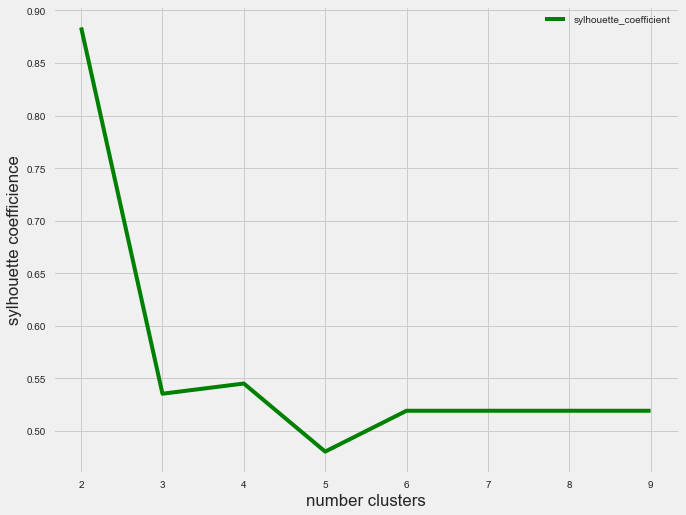

In [85]:
from sklearn.cluster import SpectralClustering

# Select Features 

#df_metrics = df96f_false[['a1_y_max', 'a2_y_max','a1_y_median','a2_y_median', 'a1_x_MS_F', 'a2_x_MS_F']]
#df_metrics = df96f_false[['a1_x_median', 'a2_x_median','a1_y_median','a2_y_median', 'hert_median', 'w_median']]

#5 features
#df_metrics = df96f_false[['a1_x_median','a2_x_median','a1_y_median','a2_y_median', 'hert_median']] #highest score: 0.814, clusters: 2

#4 features
#df_metrics = df96f_false[['a1_y_median','a2_y_median', 'hert_median', 'w_median']] #highest score: 0.501, clusters: 5
#df_metrics = df96f_false[['a1_x_median','a1_y_median','a2_y_median', 'hert_median']] #highest score: 0.814, clusters: 2

#df_metrics = df96f_false[['a1_y_median', 'a2_y_median','hert_median']] #highest score: 0.66, clusters: 4
df_metrics = df96f_false[['a1_y_median', 'a2_y_median']] #highest score: 0.884, clusters: 2

scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(df_metrics), index=df_metrics.index, columns=df_metrics.columns)

syl_coef_ = []
k_range = range(2, 10)
for k in k_range:
    clustering = SpectralClustering(n_clusters=k, 
                                assign_labels='discretize',
                                random_state=0).fit(X)
    labels = clustering.labels_
    #print(labels)

    # Number of clusters in labels, ignoring noise if present.
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = labels.tolist().count(-1)
    silhouette_coeff=metrics.silhouette_score(X, labels)
    syl_coef_.append(silhouette_coeff)
    print('Estimated number of clusters: %d' % n_clusters_)
    print('Estimated number of noise points: %d' % n_noise_)
    print("Silhouette Coefficient: %0.3f"% metrics.silhouette_score(X, labels))
plt.plot(k_range, syl_coef_,c='g',label='sylhouette_coefficient')
plt.legend()
plt.grid(True)
plt.xlabel('number clusters')
plt.ylabel('sylhouette coefficience')
plt.show()